## Setup dependencies

# Coursework - Daniel Sikar - MSc Data Science PT2
# City User ID: ACZD097

daniel.sikar@city.ac.uk
## Module INM378 — Digital Signal Processing and Audio Programming 2019/20 Period 2 


# Signal filtering and analysis - Report

## 1. Common DSP - controllable FIR filter  

A controllable FIR filter, with coefficients changing over time in response to a control signal, is implemented with a few methods.  

Two static FIR finite input response filters are defined, one low pass, one high pass, with 51 taps each.   
  
The input signal, to be convolved with the dynamic filter, is zero padded at start and end by function **padaudio**, with each section of padding equal to the length of FIR filter minus one.  
  
Function **sinewave** generates the control signal, which is a sine wave of amplitude equal to one, plus a y axis offset such that values range between 0 and 1, and of length equal to the length of input signal minus length of FIR filter minus one, such that the length of the input signal to be convolved matches the length of the control signal.
  
The coefficients of dynamic FIR filter $B$ are found by interpolating coefficients of static FIR filters $B^1, B^2$, combined by a factor of control signal $x$ at a given index $i$:

$ B(x_i)=\Big[(x_i)B_{1}^1+(1−x_i)B_{1}^2, (x_i)B_{2}^1+(1−x_i)B_{2}^2 , \cdots , (x_i)B_{n}^1+(1−x_i)B_{n}^2\Big]$   
  
as implemented in function **adjust_filter**.  
   
Once set, the adjusted filter can be convolved with a section of equal length of input signal using function **convolve_section**.  

Function **progfir** processes any input signal, of arbitrary length, sample by sample.  
  
Two examples are given, both using the same set of filters. One with audio file rockA.wav, and one with a series of added sinusoids forming a chord progression.  
  
## 2b. Digit recognition

For this task, we use function **sumelemwisemult**, which performs the sum of element wise multiplication of 2D image arrays being compared, and function **match_labels** which finds the best match of a given test image with respect to all training images, storing the highest correlation. Function **matches** computes the accurary from results array returned by **match_labels**. 
  
The two-dimensional correlation function [`signal.correlate2d`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.correlate2d.html) is used to obtain a maximum correlation, which is the highest value from the discrete linear cross-correlation, of a given test image with respect to all training images, for all offsets.  

Additional helper functions **getsample**, **invert** and **addnoise** are used to generate new training sets for negative, rotated and noisy images, which are modified (negative) or augmented (rotated, noisy) versions of the original training set. The code for each set is run by scripts, indicated by comments.

For comparison completeness both methods are used for all datasets. Results are displayed in table below:

 Method        | Data          | Training set size | Accuracy ratio | Accuracy  
--- | --- | --- | --- | ----
 Correlation      | Original | 1934 | 850/943 |  0.90 
 correlation2d      | Original  |   1934 | 865/943 |  0.92 
 Correlation | Negative      | 1934  | 857/943 |   0.91 
 correlation2d | Negative      | 1934  | 857/943 |   0.91  
 Correlation | Rotated      | 2334  | 853/943 | 0.90
 correlation2d | Rotated      | 2334  | 864/943 |   0.92  
 Correlation | Added noise      | 2134  | 850/943 |  0.90
 correlation2d | Added noise      | 2134  |  865/943 |  0.92   

It is clear that in most cases, 2D correlation outperforms correlation by a small margin. For the transformed negative training set, both methods have the same performance. Further work is need to investigate this outcome, though a possible conjecture is that a greater number of zeroes in the image arrays may result in smaller maximum 2D correlation values, reducing the resolution of this metric, and leading to more misclassified images by 2D correlation. The better performance of correlation with the negative dataset also needs further investigation, and no conjectures to explain this result are made at this stage. 
  
For the rotated training set, 400 random images are selected and a rotation angle ranging from -10 to 10, excluding 0, is applied, each discrete rotation angle, to a group of 20 images. The rotated set is then added to the original training set, and the corresponding labels added to the training labels. 
  
For the noisy training set, 200 random images are selected and 5% of salt and pepper noise applied. The resulting set is added to the training set, and corresponding labels added to training labels.  
  
For both the rotated and noisy images, we observe almost identical accuracies with respect to the original dataset and both methods. 2D correlation outperforms correlation by a small margin. Adding additional images, rotated or noisy, does not improve the accuracy. Further work with larger datasets could determine if the issue is insufficient data. It is also noted that 400 rotated images are added to training set, while 200 noisy images are added to training set, with in the majority of cases identical accuracies (as seen in Accuracy ratio column).

## 2b. Time series prediction with financial data 

To find long term trends, for each attribute (excluding date attributes) we look at a series of plots, showing the original financial data, detrended data using [`scipy.signal.detrend`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.detrend.html), one set with mean removed and another with linear least-squares fit subtracted from data, and one set with log data.  

Plots are constructed using function **plot_data**, which also substitutes missing values by interpolated values. Signals are investigated with function **signalofinterest** which looks at original and detrended data, plus harmonic models and predictions.

We observe a number of plots (SP_Comp_P, Dividend, Earnings and Consumer Price Index) showing some form of slow decaying trend until near 1980, then an upward trend which we assume to be due to a change in the method to compute each metric.  

To calculate the FFT of our signals of interest and estimate possible periodicities, we use functions **sginalofinterest** and predict_signal with empirical results that guide which parameter values to work with such as threshold, date offset and excerpt length.  

We then refine the analysis by adjust parameters programatically with function **kitchen_sink**, where we look at all datasets, using a ten-year sliding date window, from 1940 to 1990, using 3, 6 and 9 year excerpts. We use threshold values of 1, 2 and 3 and loop through all combinations.

The resulting plots show a similar pattern of those obtained by the initial analysis, that our initial predictions are a repeat of the used excerpt, and if the true signal does not show the periodicity of the periodic prediction, graphically it is suggested the model will perform poorly. This seems to be a general case, drawing to the conclusion that if there is periodicity in the financial data, more work is needed to determine the correct parameters, perhaps further data transformation as already used in this coursework such as removing the mean, linear least-squares fit subtracted from data and using logarithmic data representations.

To address these shortcommings, future work could parameterize function **kitchen_sink** and perhaps find a more suitable name, use windows to avoid spectral leaking and consider more transformations on data to find periodicities.

A reduced output table is given with some results suggesting a wide range of performances although graphically, as stated, the models do not seem to have perfomed well. The full output is given in the appendix at the end of this notebook.

Data | Start Year | Threshold | Excerpt length (years) | RMSE 
 --- | --- | --- | --- | --- 
long_interest_rate | 1960 | 2 | 3 | 0.95 
long_interest_rate | 1960 | 2 | 6 | 2.75 
long_interest_rate | 1960 | 2 | 9 | 5.23 
snp_comp | 1960 | 3 | 3 | 26.18 
snp_comp | 1960 | 3 | 6 | 28.74 
snp_comp | 1960 | 3 | 9 | 56.12
dividend | 1970 | 2 | 3 | 0.99 
dividend | 1970 | 2 | 6 | 3.36 
dividend | 1970 | 2 | 9 | 6.49 
real_price | 1970 | 3 | 3 | 194.05 
real_price | 1970 | 3 | 6 | 195.30 
real_price | 1970 | 3 | 9 | 278.63 
earnings | 1980 | 1 | 3 | 3.36 
earnings | 1980 | 1 | 6 | 12.38 
earnings | 1980 | 1 | 9 | 26.22 
real_earnings | 1980 | 3 | 3 | 8.76 
real_earnings | 1980 | 3 | 6 | 14.00 
real_earnings | 1980 | 3 | 9 | 23.58 
cape | 1990 | 3 | 3 | 9.81 
cape | 1990 | 3 | 6 | 12.29 
cape | 1990 | 3 | 9 | 9.86 
cpi | 1990 | 1 | 3 | 19.48 
cpi | 1990 | 1 | 6 | 39.78 
cpi | 1990 | 1 | 9 | 62.39 

One final observation, seen while investigating the data, is shown by plotting CAPE and Long Term Interest Rate on Y axis, and how periods where the economy was most depressed coincided with periods with highest interest rates.


  








In [2]:
try:
    import google.colab
    import subprocess
    import os.path
    p = subprocess.run(['git', 'rev-parse', '--is-inside-work-tree'], stdout=subprocess.PIPE, universal_newlines=True)
    if p.stdout == 'true\n':
        !git pull
    else:
        if not os.path.isdir('city_dsp_ap'):
            !git clone --depth 1 -q https://github.com/jpauwels/city_dsp_ap.git
        %cd city_dsp_ap
except:
    %cd city_dsp_ap

/content/city_dsp_ap


In [0]:
import numpy as np
from scipy import fft, signal
from scipy.io import wavfile
import matplotlib.pyplot as plt
from skimage.transform import rotate
from skimage.util import random_noise
from IPython.display import Audio, display

## Controllable delay line (UG) or filter (PG)

You will need to create a function that applies the desired effect to any input signal, where the effect can be dynamically modified by a control signal. The functions only need to be implemented for offline use, so you don't need to be handle input buffers of arbitrary sizes like in lab 6. It suffices to use a single for loop to run over all samples of the input and control signals, and create the output sample-by-sample.

In both cases, the control signal will be a sine of 2Hz. Create one of the required length yourself. Any signal should work as input signal. You can learn how to [upload your own files](https://colab.research.google.com/notebooks/io.ipynb) into Google Colab, but the easiest will be to use one of the wave files available in the `audio` directory. If you're loading a stereo file, it is allowed to mix it down into a single mono channel before passing it to the effect to simplify processing.

In [181]:
%ls audio/*.wav

audio/carrier.wav*  audio/rockA.wav  audio/rockB.wav


#### UG
Program a controllable delay line. Mix the output with the original input to create a flanging effect. Use the control signal to vary the amount of delay between zero and a maximum value (1 millisecond would be a good default for this, use the samplerate to calculate how much samples this is).

#### PG
Program a controllable FIR filter, i.e. a filter that changes its characteristics over time in response to a control signal. Apply the filter to the signal by implementing a convolution with the filter coefficients in a loop over the samples, just like in lab 6. In order to make the filter respond to the control signal, you can either design two static filters and interpolate between them (like in lab 6), or you can directly manipulate the filter characteristics in the filter design function [`firls`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firls.html) and call it for every iteration.

In [184]:
# Helper functions                                             

from dsp_ap.signals import *
import numpy as np

def padaudio(audiofile, filt):
  """
  Pad audio file with zeros, the size of filter minus 1, at both ends

  Parameters
  ----------
  audiofile : array_like
    The file to pad.

  filter : array_like
    The filter that is referenced for size 

  Returns
  -------
  zero_padded_filter : array_like
    Zero padded file

  Example
  -------
  >>> padaudio([1,2,3], [3,2])
  array([0., 1., 2., 3., 0.])
  """
  # set padding size
  zero_padding = np.zeros(np.size(filt) - 1);
  # Concatenate zero padding to file 
  zero_padded_file = np.concatenate((zero_padding, audiofile, zero_padding));
  return zero_padded_file;

def convolve_section(audiosection, filt):
  """
  Convolve a section of audio file and filter, i.e. without sliding

  Parameters
  ----------
  audiosection : array_like
    The section of audio being convolved
  filter :
    The filter we are using for the convolution

  Returns
  -------
  result : int
    Sum of pointwise multiplication
  
  Example
  -------
  >>> convolve_section([2,3],[3,2])
  13
  """
  result = np.sum(np.multiply(audiosection, np.flip(filt, axis=0)));
  return result;

def sinewave(size,samplerate,freq,amp,yoffset):
  """
  Generate a control signal sine wave based on parameters.

  Parameters
  ----------
  size : int
    Size, number of data points or input signal.
  samplerate : int
    Sample rate of input signal.
  freq : int
    Frequency of input control sine wave.
  amp : int
    Amplitude of input control sine wave.
  yoffset : int
    Y offset for the input control sine wave.

  Returns
  -------
  control_signal : array_like
    The control signal sine wave sequence.

  Example
  -------
  Generate a sinewave over 34616 points sampled at 12000Hz
  (2.9s length), at 2Hz frequency, 0.5 amplitude and +0.5 y axis offset.

  >>> samples1 = sinewave(34616,12000,2,0.5,0.5);
  """
  # Timepoints t - scale by samplerate
  t = np.arange(size) / samplerate;
  control_signal = amp * np.sin(2 * np.pi * freq * t) + yoffset;
  return control_signal;

def adjust_filter(filter1, filter2, scale):
  """
  Create a filter based on sum of two filters, weighted by scale and 1 - scale.

  Parameters
  ----------
  filter1, filter2 : array_like
    Filters to be weighted and summed.

  scale : double
    Scaling factor to be applied to coefficients.

  Returns
  -------
  filt : array_like
    Adjusted filter.

  Example
  ------- 
  >>> filter1 = np.asarray([2,2,2]);
  >>> filter2 = np.asarray([4,4,4]);
  >>> adjust_filter(filter1, filter2, 0.5)
  array([3., 3., 3.])
  """
  return (scale) * filter1 + (1 - scale) * filter2;

def progfir(filter1, filter2, audiosignal, samplerate):
  """
  Use a programmable fir, interpolating between two filters, to process mono 
  audio file.

  Parameters
  ----------
  filter1, filter1 : array_like
    FIR filters to interpolate.
  audiosignal : array_like
    Audio signal.
  samplerate : int
    Audio signal sample rate.

  Returns
  -------
  processed_audio : array_like
    The result of convolving audio input signal with programmable fir.

  Example
  -------
  >>> samplerate = 12000
  >>> filter1 = signal.firls(51, [0, 2000, 3000, samplerate/2], [0, 0, 1, 1], fs=samplerate)
  >>> filter2 = signal.firls(51, [0, 2000, 3000, samplerate/2], [1, 1, 0, 0], fs=samplerate)
  >>> audiopath = 'audio/rockB.wav'
  >>> processed_audio = progfir(audiopath, filter1, filter2)
  """

  # 1. check if filters are of the same size
  if len(filter1) != len(filter2):
    raise ValueError('Filters must be the same length, terminating execution.');

  # 2. Turn stereo to mono signal
  if (audiosignal.ndim == 2):
    # stereo signal, turn to mono
    dc_offset = np.mean(audiosignal, axis=0);
    offset_removed = audiosignal - dc_offset;
    audiosignal = np.sum(offset_removed, axis=1) / 2;

  # 3. Pad audio file
  audio_samples = padaudio(audiosignal, filter1);

  # 4. Generate control signal sine wave, size of interval covered by sliding window
  # e.g. with 51 tap filter, 50 zeroes added at each end, interval covered by 
  # sliding window is size of unpaded signal + 50
  start_offset = len(filter1) - 1;
  size = len(audio_samples) - start_offset; 
  frequency = 2;
  amplitude = 0.5;
  yoffset = 0.5;
  control_signal = sinewave(size,samplerate,frequency,amplitude,yoffset);

  # 5. Iterate through signal, convolve at every index and append result to audio array.
  # initialise array to hold audio samples, same size as original signal.
  processed_audio = np.zeros(np.size(audiosignal)); 
  end = len(audio_samples);
  # start after initial zero padding and go to end of file
  for i in range(start_offset, size):
    idx = i - start_offset;
    # get the working slice
    audiosection = audio_samples[i-start_offset:i+1];
    # adjust_filter
    filt = adjust_filter(filter1, filter2, control_signal[idx]);
    # process one sample and append to output
    processed_audio[idx] = convolve_section(audiosection, filt);

  return processed_audio;

# Example 1
# Audio file

# load audio file
audiopath = 'audio/rockA.wav'
samplerate, audiosignal = wavfile.read(audiopath)
# highpass_fir 
filter1 = signal.firls(51, [0, 2000, 3000, samplerate/2], [0, 0, 1, 1], fs=samplerate)
# lowpass_fir 
filter2 = signal.firls(51, [0, 2000, 3000, samplerate/2], [1, 1, 0, 0], fs=samplerate)
# process signal
processed_audio = progfir(filter1, filter2, audiosignal, samplerate)
# playback
print("audio/rockA.wav - after processing")
signal1 = AudioSignal(processed_audio, samplerate)
signal1.play()
signal1.display(x_range=(0, 12))

# Example 2 
# Chord progression

size = 1000;
samplerate = 1000;
t = np.arange(size) / samplerate;

# Chords and frequencies
# Em Emadd9 Em C Cadd9 G Gsus4
# Em - E (329.6Hz) G (392Hz) B (493.9Hz)
E = 329.6
G = 392
B = 493.9
# Emadd9 - E (329.6Hz) Gb (370Hz) G (392Hz) B (493.9Hz)
Gb = 370
# C - C (261.6Hz) + E (329.6Hz) + G (392Hz) 
C = 261.6
# Cadd9 - C (261.6Hz) + D (293.7Hz) + E (329.6Hz) + G (392Hz) 
D = 293.7
# G - G (392Hz) + B (493.9Hz) + D (293.7Hz)
# Gsus4 - G (392Hz) + C (261.6Hz) + D (293.7Hz)

sigE = np.sin(2*np.pi*E*t);
sigG = np.sin(2*np.pi*G*t);
sigB = np.sin(2*np.pi*B*t);
sigGb = np.sin(2*np.pi*Gb*t);
sigC = np.sin(2*np.pi*C*t);
sigD = np.sin(2*np.pi*D*t);

Em = (sigE + sigG + sigB) / 3;
Emadd9 = (sigE + sigGb + sigG + sigB) / 4;
C_chord = (sigC + sigE + sigG) / 3;
Cadd9 = (sigC + sigD + sigE + sigG) / 4;
G_chord = (sigG + sigB + sigD) / 3;
Gsus4 = (sigG + sigC + sigD) / 3;

# Pink - What about us, intro
#Em Emadd9 Em C Cadd9 C G Gsus4 G G Gsus4 G
chordProg = np.concatenate((Em,Emadd9,Em,C_chord,Cadd9,C_chord,Gsus4,G_chord,G_chord,Gsus4,G_chord))

# before processing
# Soundcloud link - https://bit.ly/39sB0Jw
print("What About Us - before processing")
signal1 = AudioSignal(chordProg, samplerate)
signal1.play()
signal1.display(x_range=(0, 11))

# after processing
# Soundcloud link - https://bit.ly/2Urtlqz
print("What About Us - after processing")
processed_audio = progfir(filter1, filter2, chordProg, samplerate)
# playback
signal2 = AudioSignal(processed_audio, samplerate)
signal2.play()
signal2.display(x_range=(0, 11))

audio/rockA.wav - after processing


What About Us - before processing


What About Us - after processing


## Digit recognition (UG & PG)

In this part, you're going to use images of handwritten digits ranging from 0 to 9. They are split in a training set and a test set and stored as text files in `data/digits-training.txt` and `data/digits-test.txt`.

In [0]:
!ls data/digits-*.txt

data/digits-test.txt  data/digits-training.txt


In [0]:
from itertools import islice
import re
def read_digit_pixels_and_labels(path):
    with open(path) as f:
        header = list(islice(f, 21))
        pixel_height = [int(x[1]) for x in map(lambda r: re.match('entheight = (\d+)', r), header) if x][0]
        num_digits = [int(x[1]) for x in map(lambda r: re.match('ntot = (\d+)', r), header) if x][0]
        digit_pixels = []
        labels = []
        for _ in range(num_digits):
            chunk = list(islice(f, pixel_height+1))
            digit_pixels.append(np.loadtxt(chunk[:-1]))
            labels.append(int(chunk[-1]))
    return digit_pixels, labels

Since the text files have a custom format, a loader function `read_digit_pixels_and_labels` is provided.

In [0]:
training_digits, training_labels = read_digit_pixels_and_labels('data/digits-training.txt')
test_digits, test_labels = read_digit_pixels_and_labels('data/digits-test.txt')

# len(training_digits), len(training_labels), len(test_digits), len(test_labels) 
# (1934, 1934, 943, 943)

# digit
# size
print(np.size(test_digits[0]))
# shape
print(np.shape(test_digits[0]))
# data type
print(type(test_digits[0]))

# label
# data type
print(type(test_labels[0]))

1024
(32, 32)
<class 'numpy.ndarray'>
<class 'int'>


All digits and their associated labels have now been read into lists, so we can use list indexing to access them and, for instance, display them as below.

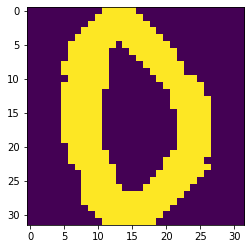

Image of digit 0


In [0]:
index = 1
plt.figure()
plt.imshow(training_digits[index])
plt.show()
print('Image of digit {}'.format(training_labels[index]))

Using this data, your task is to:

1. Create a function for comparing each test image with the collection of training images, using the correlation with each training image without offset (i.e. calculate the sum of the element-wise multiplied images).
2. Estimate the most likely label for each test image by matching with the training image that has maximal correlation.
3. Estimate the accuracy of your system, as a fraction of the correctly estimated test labels over the total number of test images.
4. Use the two-dimensional correlation function [`signal.correlate2d`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.correlate2d.html) to find the best match over all image offsets. For efficiency you can use a subset of the training images, or calculate an average of the training images.
5. Implement variants of the digit recognition system, e.g.
    - use the negatives of the training and test images instead of the positive images
    - use images that are slightly rotated in your training set (using [`rotate`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.rotate) from the `scikit-image.transform` library)
    - use images with some noise added in your training set (using [`random_noise`](https://scikit-image.org/docs/dev/api/skimage.util.html#random-noise) from the `scikit-image.util` library)
6. Report the accuracy of the new system and compare with the accuracy of the previous systems.
7. In the written report, discuss and reason about the different performances of your classifiers.

### 1. Create a function for comparing each test image with the collection of training images, using the correlation with each training image without offset (i.e. calculate the sum of the element-wise multiplied images).

In [0]:
# write your code here

def sumelemwisemult(img1, img2):
  """
  Calculate the sum of the element-wise multiplied image arrays

  Parameters
  ----------
  img1 : (N,) array_like
      First one-dimensional input array - image 1.
  img2) : (M,) array_like
      Second one-dimensional input array - image2. 

  Returns
  -------
  i : int
      Sum of the element-wise multiplied arrays.

  Examples
  --------     
  >>> sumelemwisemult(training_digits[0], test_digits[1])
  110.0

  Note - this is similar numpy.correlate, except
  return data type
  >>> numpy.correlate(training_digits[0].flatten(), test_digits[0].flatten())
  [110.]
  """  
  return np.sum(np.multiply(img1, img2));

In [0]:
# sanity check
print(sumelemwisemult(training_digits[0], test_digits[0]))
print(np.correlate(training_digits[0].flatten(), test_digits[0].flatten()))
print(sumelemwisemult(training_digits[0], test_digits[0]))
print(np.correlate(training_digits[0].flatten(), test_digits[0].flatten()))

110.0
[110.]
110.0
[110.]


### 2. Estimate the most likely label for each test image by matching with the training image that has maximal correlation.

In [0]:
def matchlabels(test_digits, test_labels, training_digits, training_labels):
  """
  Estimate the most likely label for each test image by matching with the 
  training image that has maximal correlation.

  Parameters
  ----------
  test_digits, test_labels, training_digits, training_labels : array_like
    Data and labels input sequences.

  Returns
  -------
  results : (P,5) array_like
    First five-dimensional output array : [test image index, test image label, training image index, training image label, max correlation] 

  Examples
  --------     
  >>> results = matchlabels(test_digits, test_labels, training_digits, training_labels);
  >>> results[0]
  array([  0,   1, 900,   1, 284])
  """   
   
  results = np.zeros((len(test_digits), 5),dtype=int); # [0 0 0 0 0] - test image index, test image label, training image index, training image label, max correlation
  for i in range(0,len(test_digits)):
    maxcorr = 0; 
    for k in range(0,len(training_digits)):
      corr = sumelemwisemult(test_digits[i], training_digits[k]);
      if corr > maxcorr:
        maxcorr = corr;
        results[i] = [i, test_labels[i], k, training_labels[k], maxcorr]; 
  return results;

results = matchlabels(test_digits, test_labels, training_digits, training_labels);

### 3. Estimate the accuracy of your system, as a fraction of the correctly estimated test labels over the total number of test images.

In [0]:
def matches(arr1, arr2):
  """
  Sum of matching values between arr1 and arr2

  Parameters
  ----------
  arr1, arr2 : array_like
    Input arrays. 

  Returns
  -------
  correct : int
    Sum of matches.

  Examples
  --------     
  >>> correct = matches(results[:,1], results[:,3]); 

  """
  correct = sum(arr1 == arr2);
  return correct;

correct = matches(results[:,1], results[:,3]);
total = len(results);
acc = correct/total;
print('Accuracy = {}/{} ({})'.format(correct, total, acc))
# Accuracy = 850/943 (0.9013785790031813)

Accuracy = 850/943 (0.9013785790031813)


### 4. Use the two-dimensional correlation function signal.correlate2d to find the best match over all image offsets. For efficiency you can use a subset of the training images, or calculate an average of the training images.

In [0]:
def matchlabelscorr2d(test_digits, test_labels, training_digits, training_labels):
  """
  Estimate the most likely label for each test image using signal.correlate2d.

  Parameters
  ----------
  test_digits : (N,) array_like
      First one-dimensional input array - test digits array.
  test_labels : (M,) array_like
      Second one-dimensional input array - test labels array. 
  test_digits : (O,) array_like
      Third one-dimensional input array - training digits array.
  test_labels : (P,) array_like
      Fourth one-dimensional input array - training labels array. 

  Returns
  -------
  results : (P,5) array_like
      First five-dimensional output array : [test image index, test image label, training image index, training image label, max correlation] 

  Examples
  --------     
  >>> results = matchlabelscorr2d(test_digits, test_labels, training_digits, training_labels);
  """   

  # [0 0 0 0 0] - test image index, test image label, training image index, training image label, max correlation
  results = np.zeros((len(test_digits), 5),dtype=int); 
  for i in range(0,len(test_digits)): 
    maxxcorr = 0; 
    for k in range(0,len(training_digits)):
      corr2d = signal.correlate2d(test_digits[i], training_digits[k]);
      xcorr = np.max(corr2d);
      if xcorr > maxxcorr:
        maxxcorr = xcorr;
        results[i] = [i, test_labels[i], k, training_labels[k], maxxcorr];   
  return results;

# results_c2d = matchlabelscorr2d(test_digits, test_labels, training_digits, training_labels);
# correct = matches(results_c2d[:,1], results_c2d[:,3]);
# total = len(results_c2d);
# acc = correct/total;
# print('Accuracy using signal.correlate2d = {}/{} ({})'.format(correct, total, acc))
# Accuracy using signal.correlate2d = 865/943 (0.9172852598091198)

# 5. Implement variants of the digit recognition system, e.g.
  ## use the negatives of the training and test images instead of the positive images

In [0]:
def invert(digits):
  """
  Invert a binary array.
  
  Parameters
  ----------
  digits : array_like
    The binary array to be inverted

  Returns
  -------
  digits_neg : array_like
    List with inverted values.
    
  Example
  -------
  >>> training_digits_neg = invert(training_digits);
  >>> test_digits_neg = invert(test_digits);  
  """
  # get count
  x, y, z = np.shape(digits); # expect (1934, 32, 32)
  # initialize empty list
  digits_neg = [];
  for i in range(0,x):
    digits_neg.append(1 - digits[i]);
  return digits_neg;

# Helper function

def getsample(training_digits, training_labels, k):
  """
  Get k random sample from training_digits
  
  Parameters
  ----------
  training_digits, training_labels : array_like
    Data and class labels to be sampled from.
  k : int
    Number of samples.
    
  Returns
  -------
  training_digits_sample, training_labels_sample : array_like
    Original data and labels, plus appended samples.
    
  Example
  -------
  >>> # get 500 samples
  >>> training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, 500);
  """
  from random import sample, randrange
  # create sample index
  sampleidx = np.arange(0,np.size(training_labels), 1)
  # convert to list
  sampleidx = np.ndarray.tolist(sampleidx)
  # sample
  sampleidx = sample(sampleidx, k) 
  # initlialise empty lists
  training_labels_sample = [];
  training_digits_sample = [];

  for i in range(0,k):
    # append random images and labels
    training_labels_sample.append(training_labels[sampleidx[i]]);
    training_digits_sample.append(training_digits[sampleidx[i]]);

  return training_digits_sample, training_labels_sample;

In [0]:
# Run - 5 total, with samples and full dataset 

import datetime

samplesize = 200;
training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, samplesize);
#training_digits_neg = invert(training_digits_sample);
#test_digits_neg = invert(test_digits);

# full dataset
training_digits_neg = invert(training_digits);
test_digits_neg = invert(test_digits);

now = datetime.datetime.now()
print ("Started correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# results_c2d = matchlabelscorr2d(test_digits_neg, test_labels, training_digits_neg, training_labels_sample);
# full dataset
# results_c2d = matchlabelscorr2d(test_digits_neg, test_labels, training_digits_neg, training_labels);
# Use correaltion
results = matchlabels(test_digits_neg, test_labels, training_digits_neg, training_labels);

now = datetime.datetime.now()
print ("Ended correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# correct = matches(results_c2d[:,1], results_c2d[:,3]);
# correlation
correct = matches(results[:,1], results[:,3]);
total = len(results);
acc = correct/total;
print('Accuracy for negative images = {}/{} ({})'.format(correct, total, acc))

# 10 images
# Accuracy for negative images = 295/943 (0.31283138918345704)

# 50 images
# Accuracy for negative images = 736/943 (0.7804878048780488)

# 100 images - 14 minutes
# Accuracy for negative images = 728/943 (0.7720042417815483)

# 200 images
# Accuracy for negative images = 764/943 (0.8101802757158006)

# Full dataset
# Started correlation2d : 
# 2020-03-22 21:53:00
# Ended correlation2d : 
# 2020-03-23 02:22:19
# Accuracy for negative images = 857/943 (0.9088016967126193)

# Correlation
# Accuracy for negative images = 857/943 (0.9088016967126193)

Started correlation2d : 
2020-03-30 10:42:35
Ended correlation2d : 
2020-03-30 10:42:49
Accuracy for negative images = 857/943 (0.9088016967126193)


## use images that are slightly rotated in your training set (using rotate from the scikit-image.transform library)



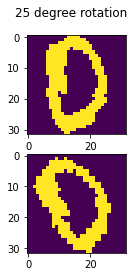

In [0]:
# NB this function was only used to test rotation
def img_rotate(digits, angle):
  """
  Rotate an array of images, each by then given angle.
  
  Parameters
  ----------
  digits : array_like
    The list of images to be rotated.
  angle : int
    The angle to rotate each image by.
    
  Returns
  -------
  digits_rot : the list of rotated images.
  
  Example
  -------
  >>> angle = 25
  >>> digits_rot = img_rotate(training_digits, angle)  
  """
  from skimage.transform import rotate
  # get image count
  x, y, z = np.shape(digits); # expect (1934, 32, 32)
  # initialize empty list
  digits_rot = [];
  for i in range(0,x):
    # rotate using order equal 0 to avoid aliasing on 0/1 edges
    # append to returned list
    digits_rot.append(rotate(digits[i], angle, order=0));
  return digits_rot;

# Test 
angle = 25
digits_rot = img_rotate(training_digits, angle)
index = 0;

plt.figure()
plt.subplot(211)
plt.imshow(training_digits[index])

plt.subplot(212)
plt.imshow(digits_rot[index])
plt.suptitle('25 degree rotation')
plt.show()

In [0]:
# Run
import datetime
from random import choices
from skimage.transform import rotate

# reload data
training_digits, training_labels = read_digit_pixels_and_labels('data/digits-training.txt')
test_digits, test_labels = read_digit_pixels_and_labels('data/digits-test.txt')

# set sample size of rotated images to be appended to data
samplesize = 400;
# rotation angles to use between -10 +10
degs = np.concatenate((np.arange(-10,0,1), np.arange(1,11,1)))
# sample with replacement to create index
degs = choices(degs,k=samplesize)
# get images to be rotated
training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, samplesize);
# initialise rotated image list
image_rot = [];

# loop through sample
for i in range(0,samplesize):
  # append rotated image to list
  image_rot.append( rotate(training_digits_sample[i], degs[i], order=0 ));

# append rotate images to training data
training_digits = training_digits + image_rot
# append sample label to training labels
training_labels = training_labels + training_labels_sample;

# next we sample from new dataset, including rotated images that have been added in previous section
samplesize = 200;
training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, samplesize);

now = datetime.datetime.now()
print ("Started correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# Run on samples
# results_c2d = matchlabelscorr2d(test_digits, test_labels, training_digits_sample, training_labels_sample);

# use full dataset
# results_c2d = matchlabelscorr2d(test_digits, test_labels, training_digits, training_labels);
# Use correaltion
results = matchlabels(test_digits, test_labels, training_digits, training_labels);

now = datetime.datetime.now()
print ("Ended correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# correct = matches(results_c2d[:,1], results_c2d[:,3]);
# User correlation
correct = matches(results[:,1], results[:,3]);
total = len(results);
acc = correct/total;
print('Accuracy for training set with rotated images = {}/{} ({})'.format(correct, total, acc))

# 10 images
# Accuracy for negative images = 295/943 (0.31283138918345704)
# Accuracy for training set with rotated images = 415/943 (0.440084835630965)

# 50 images - 7 minutes
# Accuracy for negative images = 736/943 (0.7804878048780488)
# Accuracy for training set with rotated images = 731/943 (0.7751855779427359)

# 100 images - 14 minutes
# Accuracy for negative images = 728/943 (0.7720042417815483)
# Accuracy for training set with rotated images = 742/943 (0.7868504772004242)

# 200 images
# Accuracy for negative images = 764/943 (0.8101802757158006)
# Accuracy for training set with rotated images = 804/943 (0.8525980911983033)

# full dataset
# Started correlation2d : 
# 2020-03-23 21:05:02
# Ended correlation2d : 
# 2020-03-24 02:32:12

# Accuracy for training set with rotated images = 864/943 (0.9162248144220573)

# Correlation
# Accuracy for training set with rotated images = 853/943 (0.9045599151643691)

Started correlation2d : 
2020-03-30 10:46:39
Ended correlation2d : 
2020-03-30 10:46:56
Accuracy for training set with rotated images = 853/943 (0.9045599151643691)


## use images with some noise added in your training set (using random_noise from the scikit-image.util library)

In [0]:
def addspnoise(samplesize, nz):
  """
  Add salt and pepper noise to training digits

  Parameters
  ----------
  samplesize : int
    Sample size to add noise to
  nz : double
    Amount of noise to be added e.g. 0.05 (5%)
  
  Returns
  training_digits, traning labels : array_like
    Data with added noisy samples plus labels with appended sample labels 

  Example:
  >>> # add 200 noisy images to dataset
  >>> [training_digits, training_labels] = addspnoise(200, 0.05);
  """
  from skimage.util import random_noise

  # load
  training_digits, training_labels = read_digit_pixels_and_labels('data/digits-training.txt')
  test_digits, test_labels = read_digit_pixels_and_labels('data/digits-test.txt')

  # training samples
  training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, samplesize);
  # initialise noisy image list
  image_noise = [];
  # loop through sample
  for i in range(0,samplesize):
    # append rotated image to list
    image_noise.append( random_noise(training_digits_sample[i], mode='s&p', amount=0.05 ));

  # append rotate images to training data
  training_digits = training_digits + image_noise;
  # append sample label to training labels
  training_labels = training_labels + training_labels_sample;

  return training_digits, training_labels;

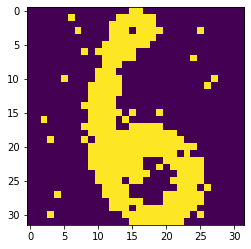

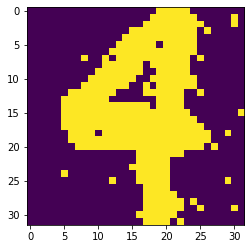

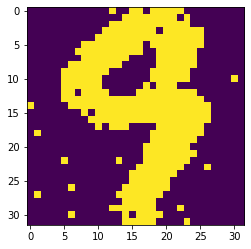

In [0]:
# Sanity check - noisy images

# reload to get count
training_digits, training_labels = read_digit_pixels_and_labels('data/digits-training.txt')
# print(len(training_digits))
# 1934

# We append 400 noisy images so any index greater or equal to 1934 will be noisy
[image_noise, image_noise_label] = addspnoise(400, 0.05);

# display some

index = 1934;
plt.imshow(image_noise[index])
plt.show()

index = 1935;
plt.imshow(image_noise[index])
plt.show()

index = 1936;
plt.imshow(image_noise[index])
plt.show()

In [0]:
# Run

import datetime
# add 200 noisy salt & pepper images to dataset
[training_digits, training_labels] = addspnoise(200, 0.05);

# Sample for new noisy dataset
# samplesize = 200;
# training_digits_sample, training_labels_sample = getsample(training_digits, training_labels, samplesize);

now = datetime.datetime.now()
print ("Started correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# Sample dataset
# results_c2d = matchlabelscorr2d(test_digits, test_labels, training_digits_sample, training_labels_sample);

# full dataset
# results_c2d = matchlabelscorr2d(test_digits, test_labels, training_digits, training_labels);
# Correlatiion
results = matchlabels(test_digits, test_labels, training_digits, training_labels);

now = datetime.datetime.now()
print ("Ended correlation2d : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

correct = matches(results[:,1], results[:,3]);
total = len(results);
acc = correct/total;
print('Accuracy for training set with noisy images = {}/{} ({})'.format(correct, total, acc))

# 10 images
# Accuracy for negative images = 295/943 (0.31283138918345704)
# Accuracy for training set with rotated images = 415/943 (0.440084835630965)
# Accuracy for training set with rotated images = 323/943 (0.3425238600212089) # 7% salt & pepper noisy
# Accuracy for training set with noisy images = 359/943 (0.3806998939554613)  # 5% salt & pepper noisy
# Accuracy for training set with noisy images = 451/943 (0.4782608695652174)  # 5% salt & pepper noisy
# Accuracy for training set with noisy images = 440/943 (0.46659597030752914) # 4% salt & pepper noisy
# Accuracy for training set with noisy images = 405/943 (0.42948038176033937) # 3% salt & pepper noisy
# Accuracy for training set with noisy images = 537/943 (0.5694591728525981)# 2% salt & pepper noisy

# 50 images - 7 minutes
# Accuracy for negative images = 736/943 (0.7804878048780488)
# Accuracy for training set with noisy images = 661/943 (0.7009544008483564)
# Accuracy for training set with rotated images = 731/943 (0.7751855779427359)

# 100 images - 14 minutes
# Accuracy for negative images = 728/943 (0.7720042417815483)
# Accuracy for training set with rotated images = 742/943 (0.7868504772004242)
# Accuracy for training set with noisy images = 710/943 (0.7529162248144221) % 5% salt & pepper noise

# 200 images
# Accuracy for negative images = 764/943 (0.8101802757158006)
# Accuracy for training set with rotated images = 804/943 (0.8525980911983033)
# Accuracy for training set with noisy images = 853/943 (0.9045599151643691)

# write-up ~ Noise images seem to perfom best - to be confirmed by overnight runs
# Started correlation2d : 
# 2020-03-24 08:54:35
# Ended correlation2d : 
# 2020-03-24 13:48:31

# Accuracy for training set with noisy images = 865/943 (0.9172852598091198)

# Correlation
# Accuracy for training set with noisy images = 850/943 (0.9013785790031813)

Started correlation2d : 
2020-03-30 10:50:03
Ended correlation2d : 
2020-03-30 10:50:18
Accuracy for training set with noisy images = 850/943 (0.9013785790031813)


## Time series prediction with financial data (UG pairs & PG)

In this part, you're going to use long term US stock market data (monthly indices, dividends, earnings, etc. since 1871). Information about the data provenance and references can be found at http://www.econ.yale.edu/~shiller/data.htm (especially the 2nd paragraph). The data is available in the file `data/financial_data.csv`.

It is stored as comma-separated numerical values, with a header containing column names. Therefore we can use [`np.genfromtxt`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.genfromtxt.html#numpy.genfromtxt) to read it.

In [0]:
import numpy as np
# from http://www.econ.yale.edu/~shiller/data/ie_data.xls
financial = np.genfromtxt('data/financial_data.csv', delimiter=',', skip_header=2, names=True)
#! tail data/financial_data.csv
# financial.dtype.names
#for i,a in enumerate(financial.dtype.names):
#    print(" = financial['" + a + "']")

The result is a structured array, which means that we can access each of the columns in the table by its name. The list of all colums can be found below.

You can access the columns using their names between square brackets, like you would for a dictionary. It's advised to store the columns you need in helper variables, to avoid long statements resulting from the long column names.

In [0]:
date = financial['Date']
snp_comp = financial['SP_Comp_P']
dividend = financial['Dividend_D'] 
earnings = financial['Earnings_E']
cpi = financial['Consumer_Price_Index_CPI']
date_fraction = financial['Date_Fraction']
long_interest_rate = financial['Long_Interest_Rate_GS10']
real_price = financial['Real_Price']
real_dividend = financial['Real_Dividend']
real_earnings = financial['Real_Earnings']
cape = financial['Cyclically_Adjusted_Price_Earnings_Ratio_PE10_or_CAPE']

Now you can easily use the data, for instance to plot it.

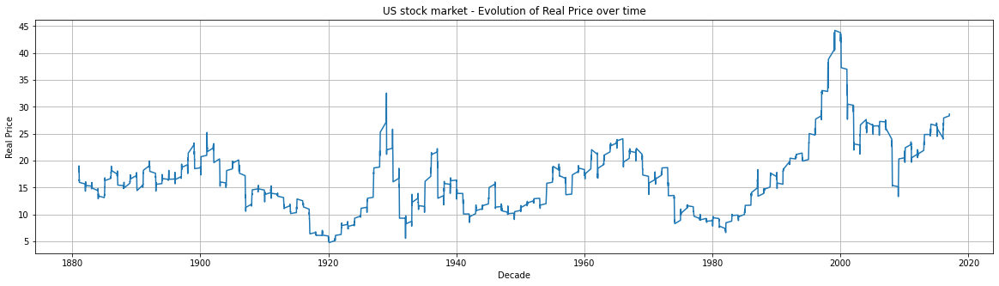

In [0]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,5))
plt.grid()
plt.plot(date, cape)
plt.title('US stock market - Evolution of Real Price over time')
plt.xlabel('Decade')
plt.ylabel('Real Price')
plt.show()

# Using this data, your task is to:

1. Look for long term trends on a linear and log scale and de-trend the data first.
2. Calculate the FFT of the signal of interest, to estimate possible periodicities. You can use a window to avoid spectral leaking.
3. Refine your analysis by adjusting the size of the dataset (e.g. if you model annual patterns, make sure your dataset size is a multiple of 12).

## 1. Look for long term trends on a linear and log scale and de-trend the data first.

In [0]:
# write your code here

# Helper functions

import numpy as np
import scipy

def plot_data(x, y, title, xlabel, ylabel, detrend='none'):
  """
  Helper function to start initial analysis. Plot data with options to detrend.

  Parameters
  ----------
  x, y : array_like
    The time series financial data.
  title, xlabel, ylabel : string
    Graph info.
  detrend : {'none', 'linear', 'constant', 'log'}, optional
    The type of detrending. none (default) will plot data as is, 'linear' and 
    'constant' make use of scipy.signal.detrend type option, 'log' with convert
    x values to log base 10.

  Returns
  -------
  void

  Example
  -------
  >>> plot_data(date, cape, 'US stock market - Evolution of Real Price over time', 'Decade', 'Real Price', detrend='none')
  """
  # detrend validation
  if detrend not in ['none', 'linear',  'constant', 'log']:
    raise ValueError("Trend type must be 'none', 'linear' , 'constant' or 'log'.")

  # Remove nans
  nans, x2 = nan_helper(y)
  y[nans]= np.interp(x2(nans), x2(~nans), y[~nans])  

  # parse detrend option
  if detrend == 'linear':
    y = scipy.signal.detrend(y, type == 'linear');

  if detrend == 'constant':
    y = scipy.signal.detrend(y, type == 'constant');

  if detrend == 'log':
    y = np.log10(y);

  # plot  
  plt.figure(figsize=(20,5))
  plt.grid()
  plt.plot(x, y)
  plt.title(title)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  plt.show()

# from https://stackoverflow.com/questions/6518811/interpolate-nan-values-in-a-numpy-array
def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """
    return np.isnan(y), lambda z: z.nonzero()[0]

def prep_data(y, detrend='none'):
  """
  Prepare data data according to parameters, at least remove nans
 
  Parameters
  ----------
  y : array_like
    Data to be detrended and clean

  detrend : {'none', 'linear', 'constant', 'log'}, optional
    The type of detrending. none (default) will plot data as is, 'linear' and 
    'constant' make use of scipy.signal.detrend type option, 'log' with convert
    x values to log base 10.
  
  Returns
  -------
  y : array_like
    Detrended data with missing values replaced by interpolated values.

  Example
  -------
  >>> cpi_log = pre_data(cpi, 'log')
  """
  # detrend validation
  if detrend not in ['none', 'linear',  'constant', 'log']:
    raise ValueError("Trend type must be 'none', 'linear' , 'constant' or 'log'.")

  # Remove nans
  nans, x2 = nan_helper(y)
  y[nans]= np.interp(x2(nans), x2(~nans), y[~nans])  

  # parse detrend option
  if detrend == 'linear':
    y = scipy.signal.detrend(y, type == 'linear');

  if detrend == 'constant':
    y = scipy.signal.detrend(y, type == 'constant');

  if detrend == 'log':
    y = np.log10(y);  

  return y;

*************************************
* Standard and Poor Composite Price *
*************************************


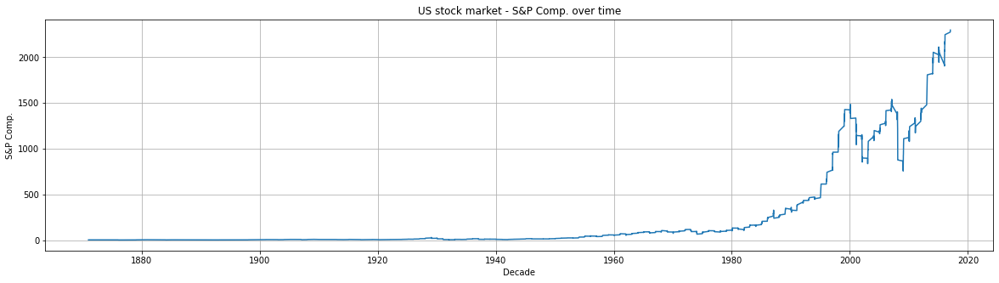

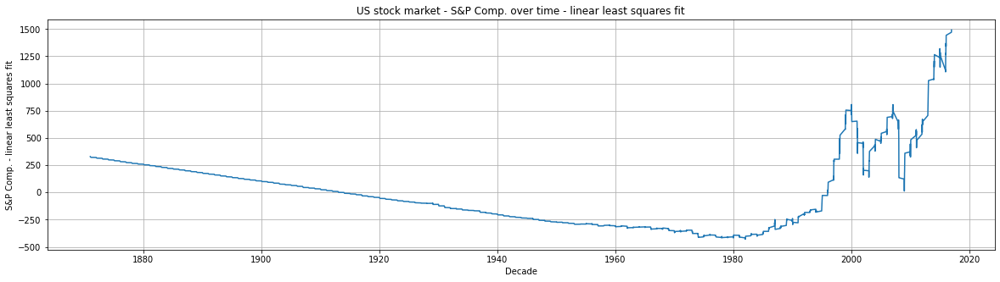

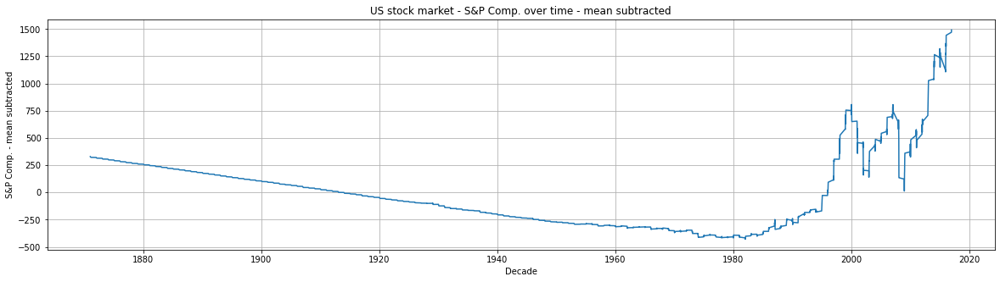

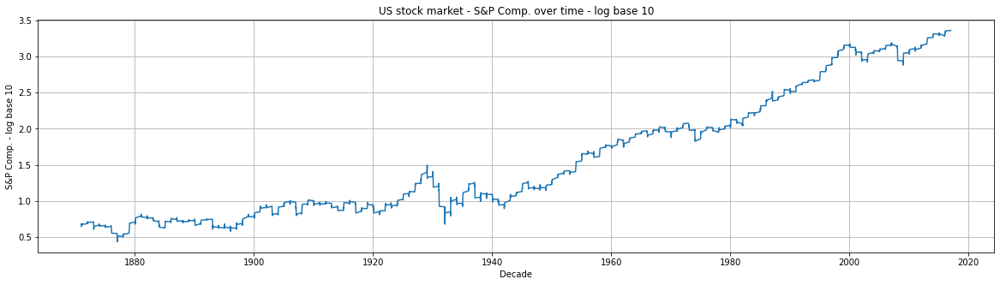

************
* Dividend *
************


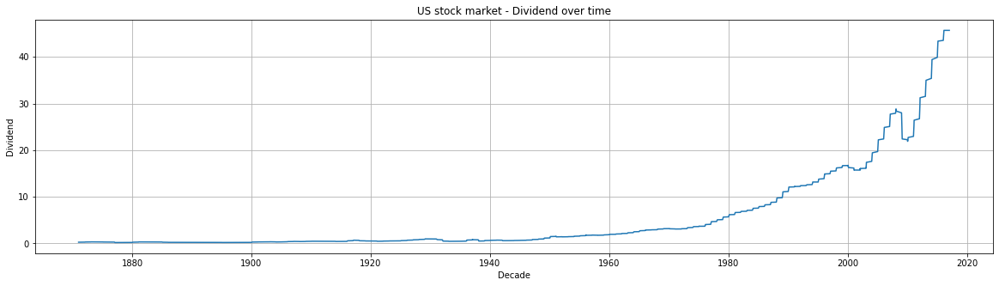

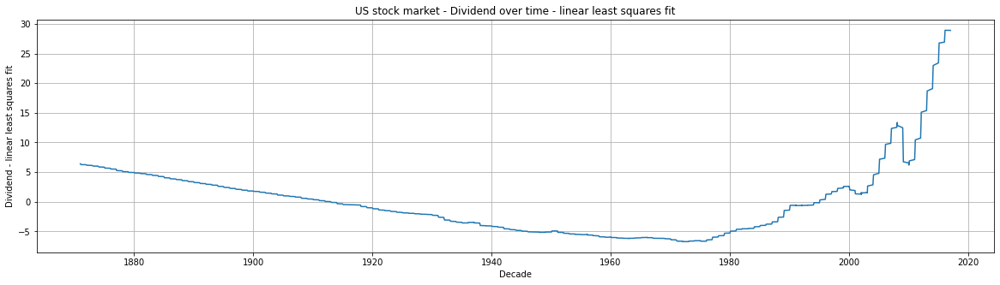

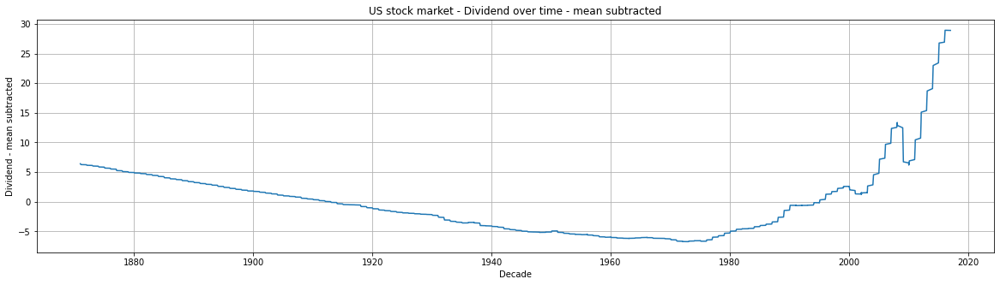

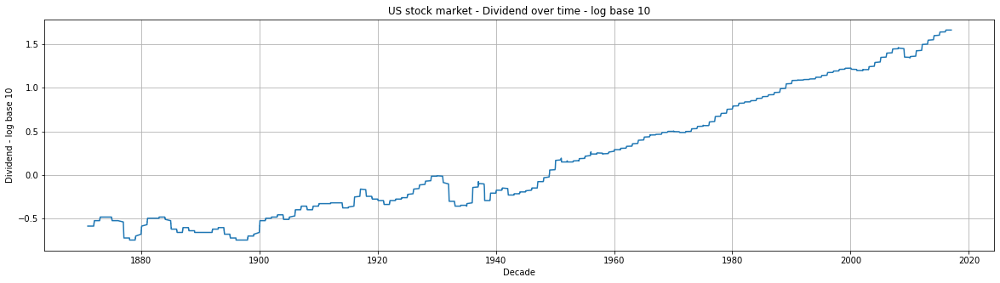

************
* Earnings *
************


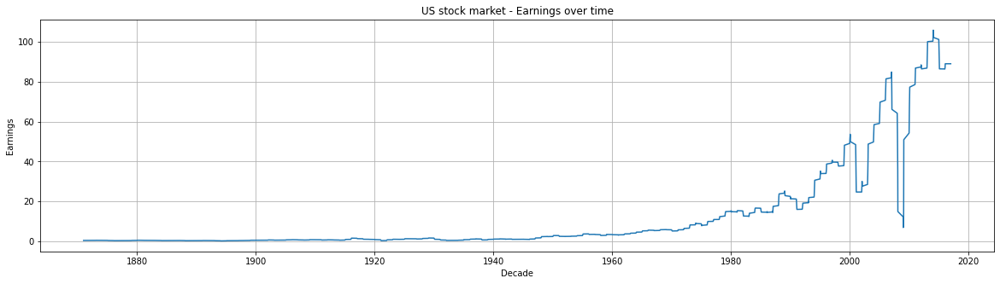

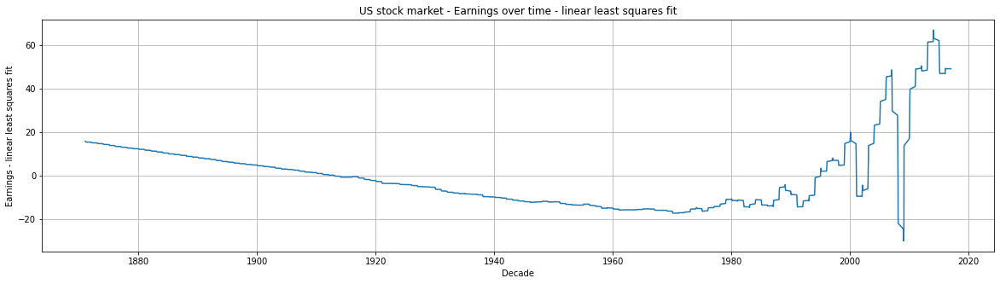

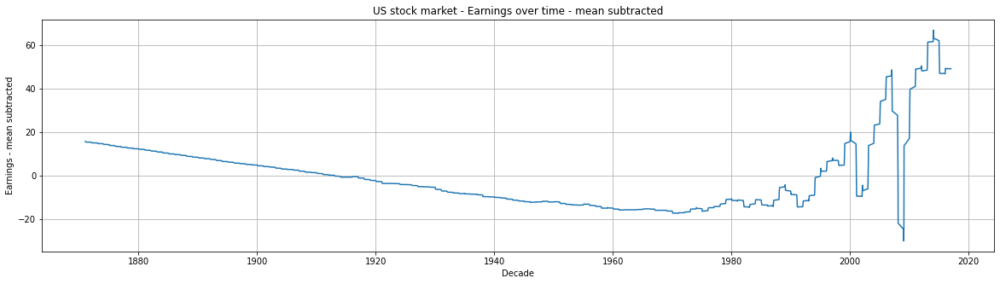

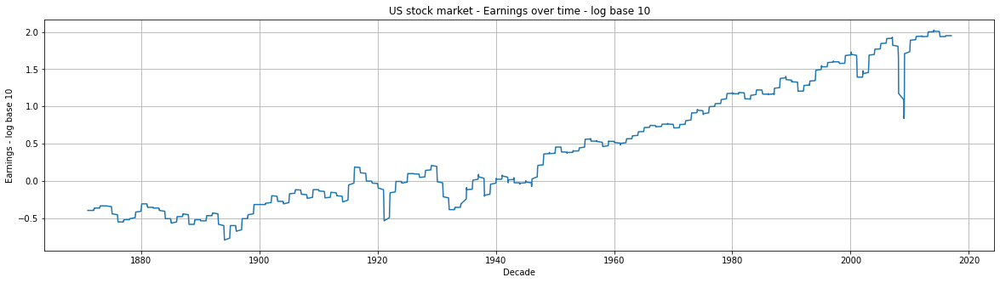

************************
* Consumer Price Index *
************************


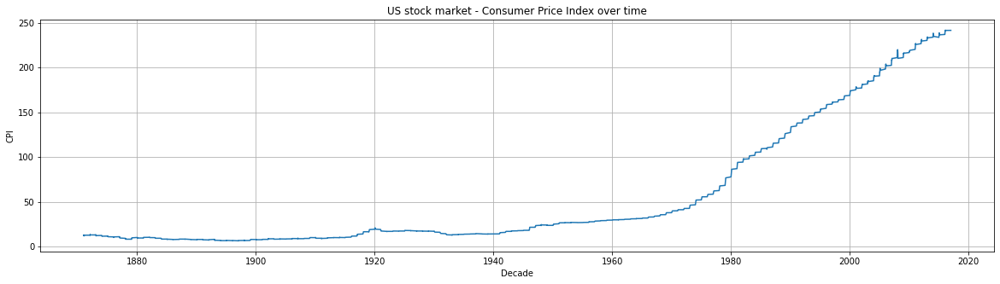

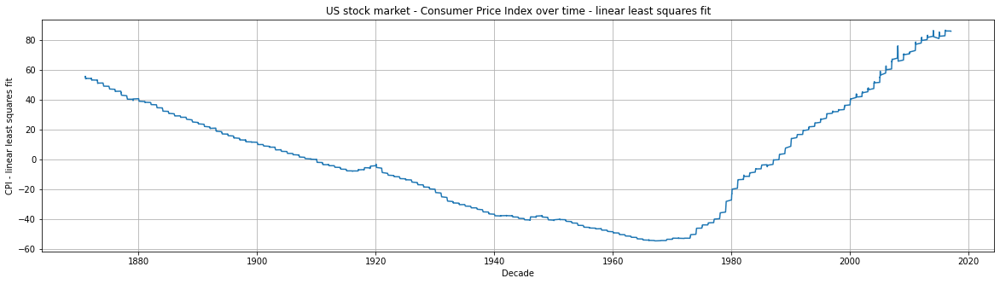

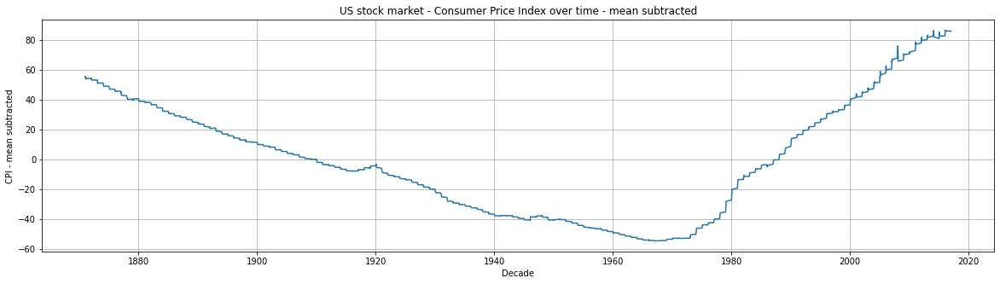

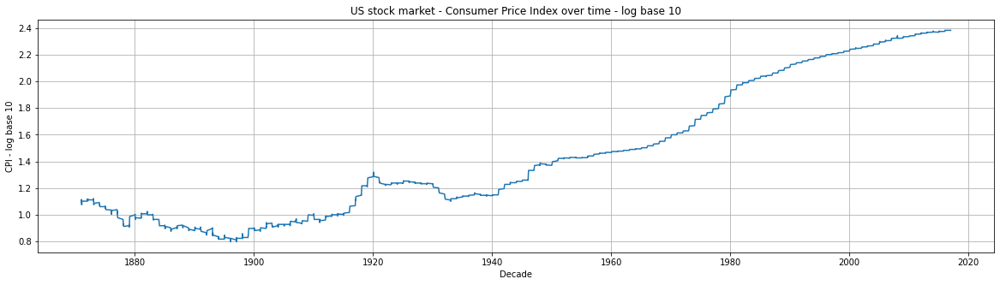

**********************
* Long Interest Rate *
**********************


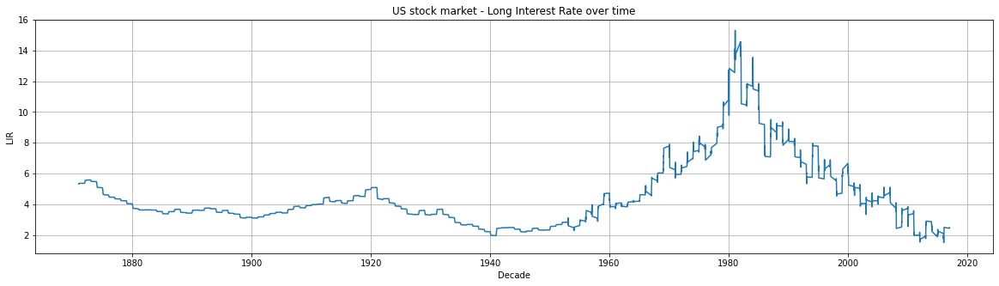

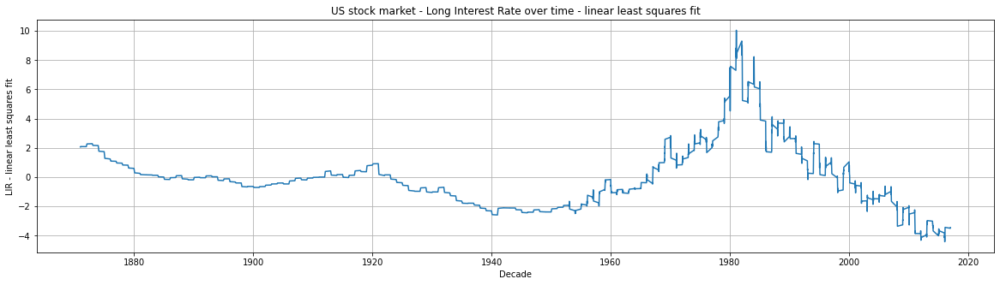

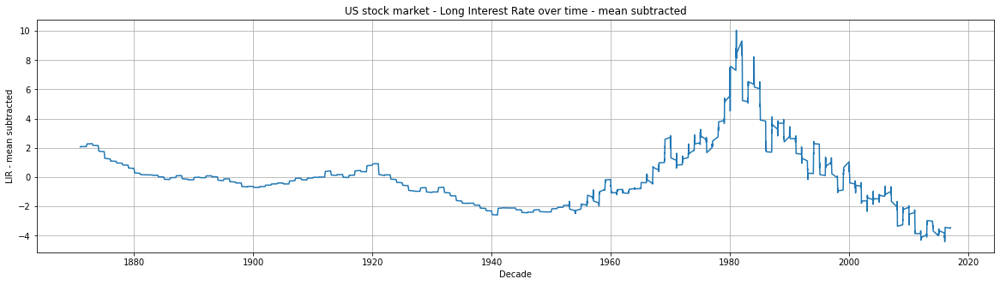

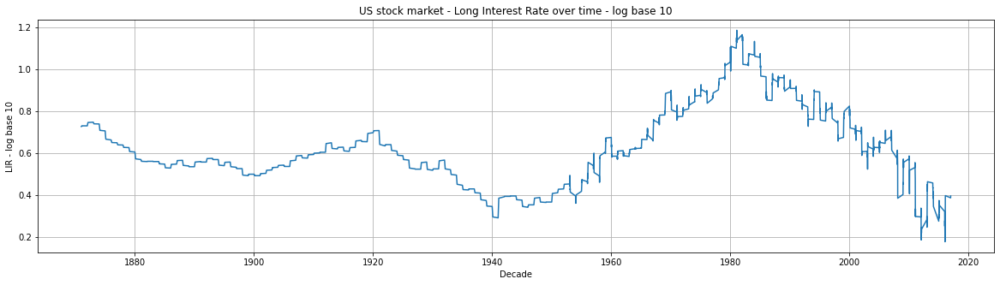

**************
* Real Price *
**************


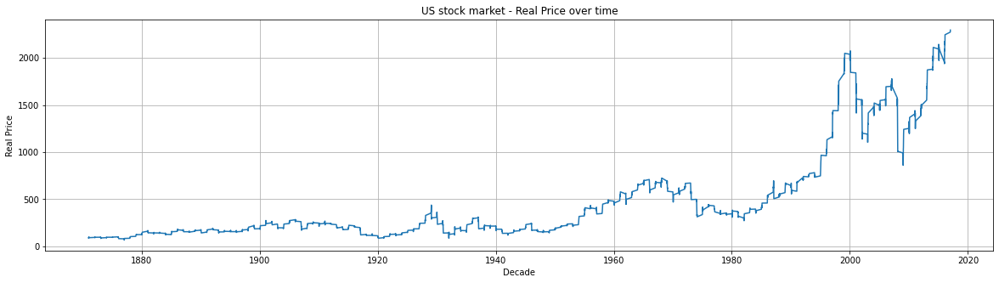

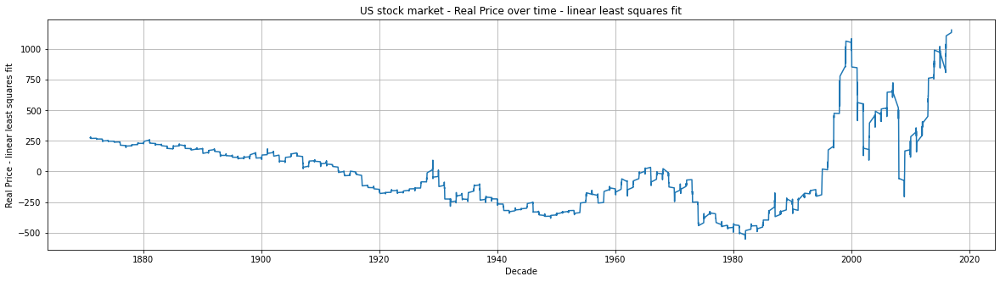

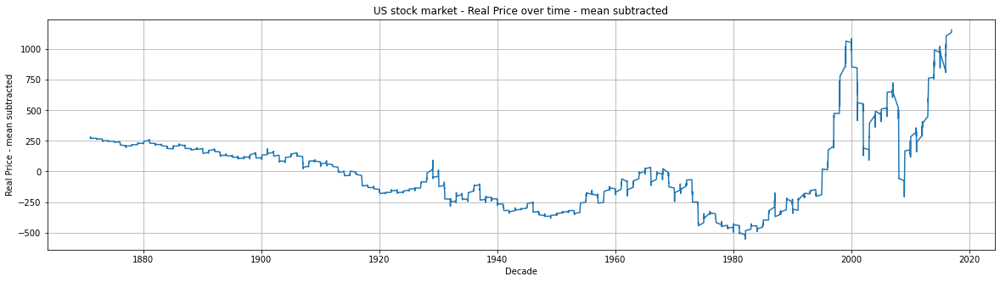

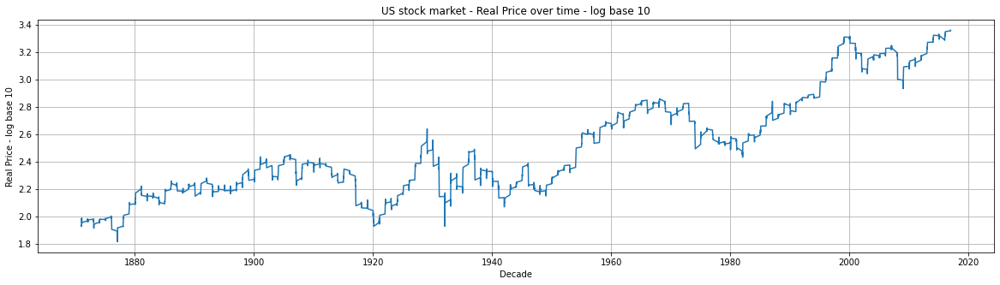

*****************
* Real Dividend *
*****************


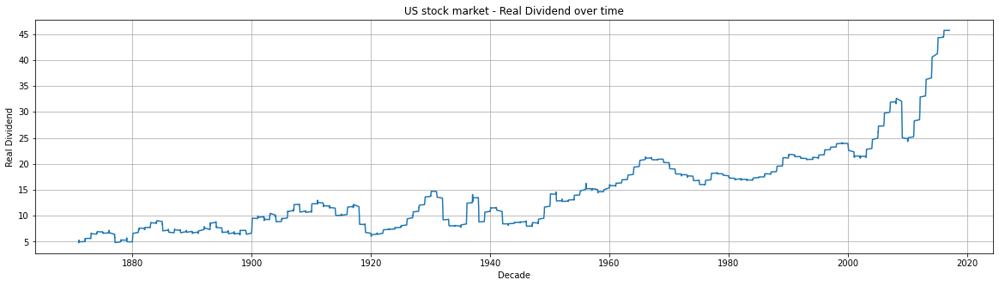

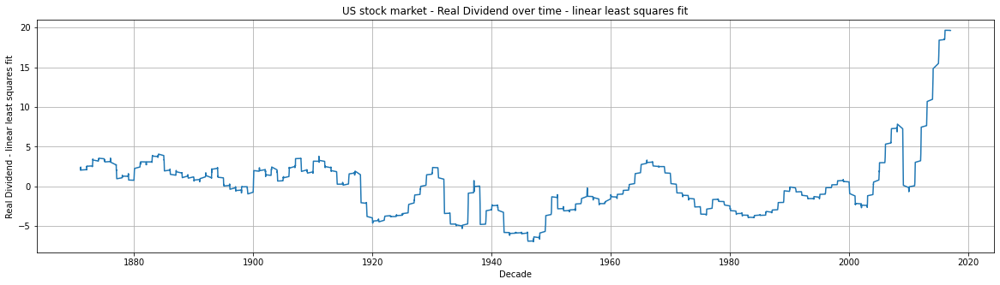

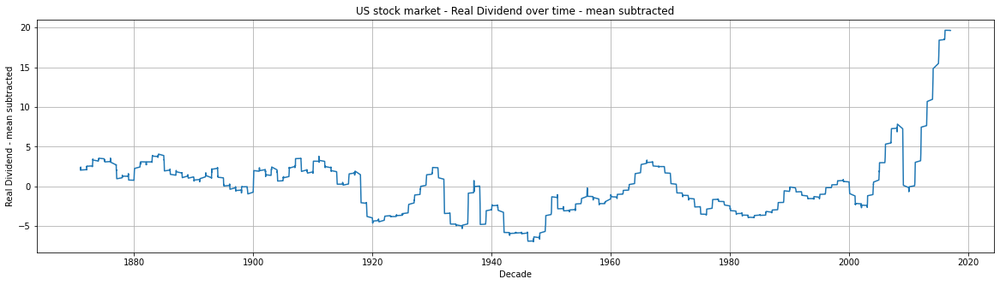

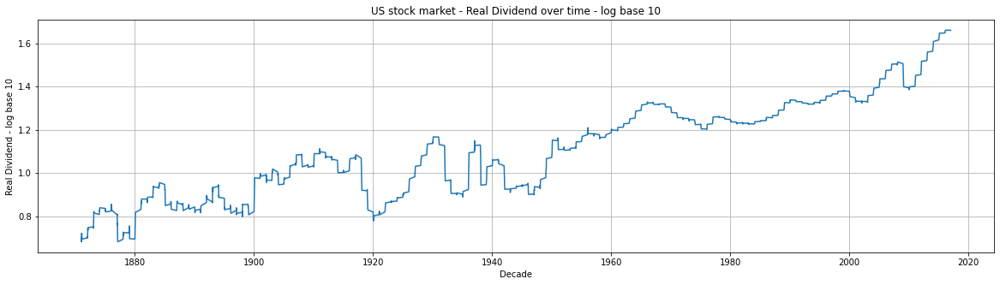

*****************
* Real Earnings *
*****************


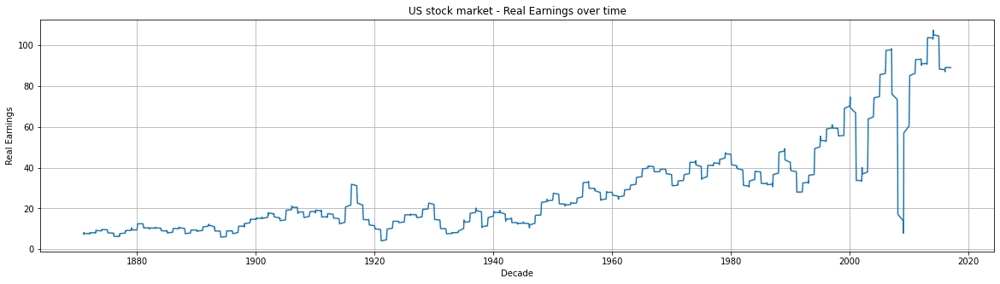

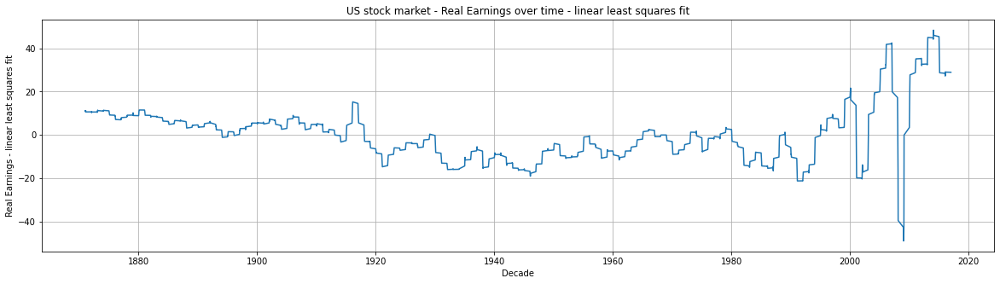

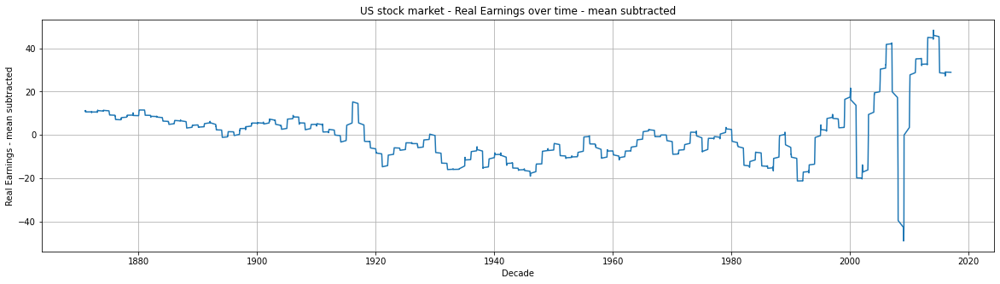

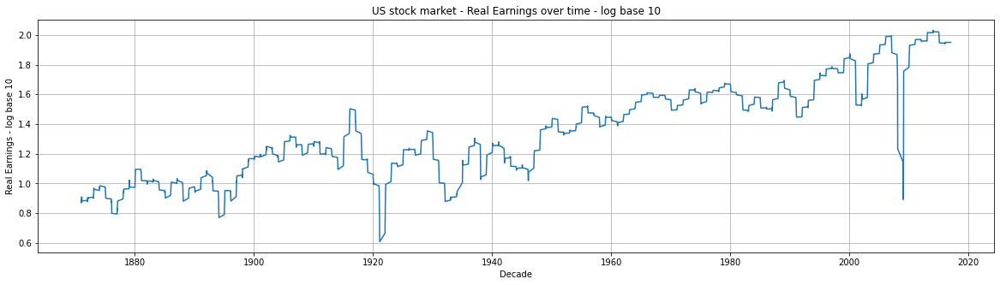

********************************************
* Cyclically Adjusted Price Earnings Ratio *
********************************************


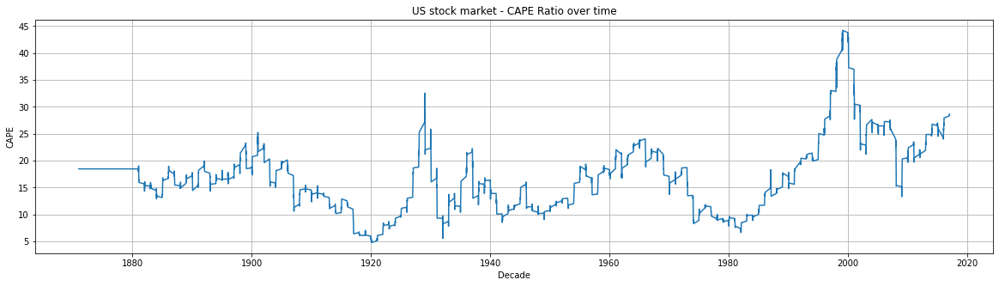

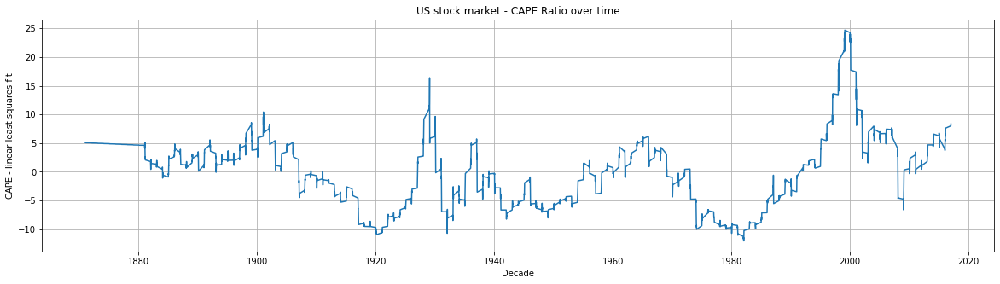

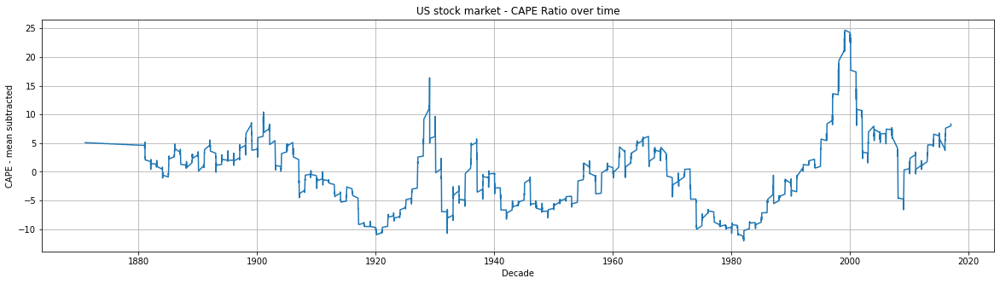

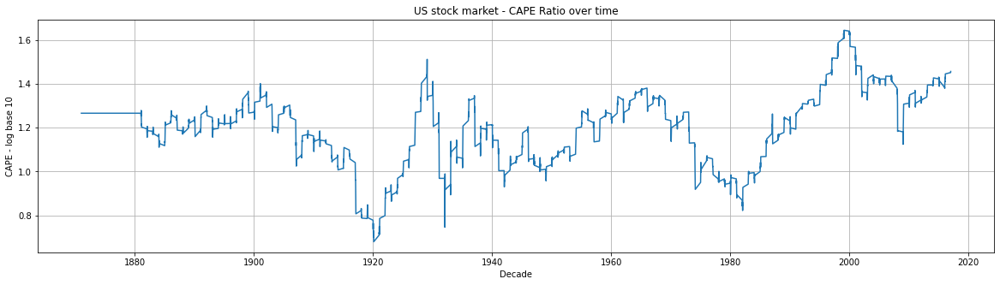

In [0]:
# Initial investigation, plot all data

# Load data
date = financial['Date']
snp_comp = financial['SP_Comp_P']
dividend = financial['Dividend_D'] 
earnings = financial['Earnings_E']
cpi = financial['Consumer_Price_Index_CPI']
date_fraction = financial['Date_Fraction']
long_interest_rate = financial['Long_Interest_Rate_GS10']
real_price = financial['Real_Price']
real_dividend = financial['Real_Dividend']
real_earnings = financial['Real_Earnings']
cape = financial['Cyclically_Adjusted_Price_Earnings_Ratio_PE10_or_CAPE']

# Plot

# Standard and Poor Composite Price
print('*************************************')
print('* Standard and Poor Composite Price *')
print('*************************************')
plot_data(date, snp_comp, 'US stock market - S&P Comp. over time', 'Decade', 'S&P Comp.', detrend='none')
plot_data(date, snp_comp, 'US stock market - S&P Comp. over time - linear least squares fit', 'Decade', 'S&P Comp. - linear least squares fit', detrend='linear')
plot_data(date, snp_comp, 'US stock market - S&P Comp. over time - mean subtracted', 'Decade', 'S&P Comp. - mean subtracted', detrend='constant')
plot_data(date, snp_comp, 'US stock market - S&P Comp. over time - log base 10', 'Decade', 'S&P Comp. - log base 10', detrend='log')

# Dividend
print('************')
print('* Dividend *')
print('************')
plot_data(date, dividend, 'US stock market - Dividend over time', 'Decade', 'Dividend', detrend='none')
plot_data(date, dividend, 'US stock market - Dividend over time - linear least squares fit', 'Decade', 'Dividend - linear least squares fit', detrend='linear')
plot_data(date, dividend, 'US stock market - Dividend over time - mean subtracted', 'Decade', 'Dividend - mean subtracted', detrend='constant')
plot_data(date, dividend, 'US stock market - Dividend over time - log base 10', 'Decade', 'Dividend - log base 10', detrend='log')

# Earnings
print('************')
print('* Earnings *')
print('************')
plot_data(date, earnings, 'US stock market - Earnings over time', 'Decade', 'Earnings', detrend='none')
plot_data(date, earnings, 'US stock market - Earnings over time - linear least squares fit', 'Decade', 'Earnings - linear least squares fit', detrend='linear')
plot_data(date, earnings, 'US stock market - Earnings over time - mean subtracted', 'Decade', 'Earnings - mean subtracted', detrend='constant')
plot_data(date, earnings, 'US stock market - Earnings over time - log base 10', 'Decade', 'Earnings - log base 10', detrend='log')

# Earnings
print('************************')
print('* Consumer Price Index *')
print('************************')
plot_data(date, cpi, 'US stock market - Consumer Price Index over time', 'Decade', 'CPI', detrend='none')
plot_data(date, cpi, 'US stock market - Consumer Price Index over time - linear least squares fit', 'Decade', 'CPI - linear least squares fit', detrend='linear')
plot_data(date, cpi, 'US stock market - Consumer Price Index over time - mean subtracted', 'Decade', 'CPI - mean subtracted', detrend='constant')
plot_data(date, cpi, 'US stock market - Consumer Price Index over time - log base 10', 'Decade', 'CPI - log base 10', detrend='log')

# Long Interest Rate
print('**********************')
print('* Long Interest Rate *')
print('**********************')
plot_data(date, long_interest_rate, 'US stock market - Long Interest Rate over time', 'Decade', 'LIR', detrend='none')
plot_data(date, long_interest_rate, 'US stock market - Long Interest Rate over time - linear least squares fit', 'Decade', 'LIR - linear least squares fit', detrend='linear')
plot_data(date, long_interest_rate, 'US stock market - Long Interest Rate over time - mean subtracted', 'Decade', 'LIR - mean subtracted', detrend='constant')
plot_data(date, long_interest_rate, 'US stock market - Long Interest Rate over time - log base 10', 'Decade', 'LIR - log base 10', detrend='log')

# Real Price
print('**************')
print('* Real Price *')
print('**************')
plot_data(date, real_price, 'US stock market - Real Price over time', 'Decade', 'Real Price', detrend='none')
plot_data(date, real_price, 'US stock market - Real Price over time - linear least squares fit', 'Decade', 'Real Price - linear least squares fit', detrend='linear')
plot_data(date, real_price, 'US stock market - Real Price over time - mean subtracted', 'Decade', 'Real Price - mean subtracted', detrend='constant')
plot_data(date, real_price, 'US stock market - Real Price over time - log base 10', 'Decade', 'Real Price - log base 10', detrend='log')

# Real Dividends
print('*****************')
print('* Real Dividend *')
print('*****************')
plot_data(date, real_dividend, 'US stock market - Real Dividend over time', 'Decade', 'Real Dividend', detrend='none')
plot_data(date, real_dividend, 'US stock market - Real Dividend over time - linear least squares fit', 'Decade', 'Real Dividend - linear least squares fit', detrend='linear')
plot_data(date, real_dividend, 'US stock market - Real Dividend over time - mean subtracted', 'Decade', 'Real Dividend - mean subtracted', detrend='constant')
plot_data(date, real_dividend, 'US stock market - Real Dividend over time - log base 10', 'Decade', 'Real Dividend - log base 10', detrend='log')

# Real Earnings
print('*****************')
print('* Real Earnings *')
print('*****************')
plot_data(date, real_earnings, 'US stock market - Real Earnings over time', 'Decade', 'Real Earnings', detrend='none')
plot_data(date, real_earnings, 'US stock market - Real Earnings over time - linear least squares fit', 'Decade', 'Real Earnings - linear least squares fit', detrend='linear')
plot_data(date, real_earnings, 'US stock market - Real Earnings over time - mean subtracted', 'Decade', 'Real Earnings - mean subtracted', detrend='constant')
plot_data(date, real_earnings, 'US stock market - Real Earnings over time - log base 10', 'Decade', 'Real Earnings - log base 10', detrend='log')

#cape
print('********************************************')
print('* Cyclically Adjusted Price Earnings Ratio *')
print('********************************************')
plot_data(date, cape, 'US stock market - CAPE Ratio over time', 'Decade', 'CAPE', detrend='none')
plot_data(date, cape, 'US stock market - CAPE Ratio over time', 'Decade', 'CAPE - linear least squares fit', detrend='linear')
plot_data(date, cape, 'US stock market - CAPE Ratio over time', 'Decade', 'CAPE - mean subtracted', detrend='constant')
plot_data(date, cape, 'US stock market - CAPE Ratio over time', 'Decade', 'CAPE - log base 10', detrend='log')

<Figure size 1440x360 with 0 Axes>

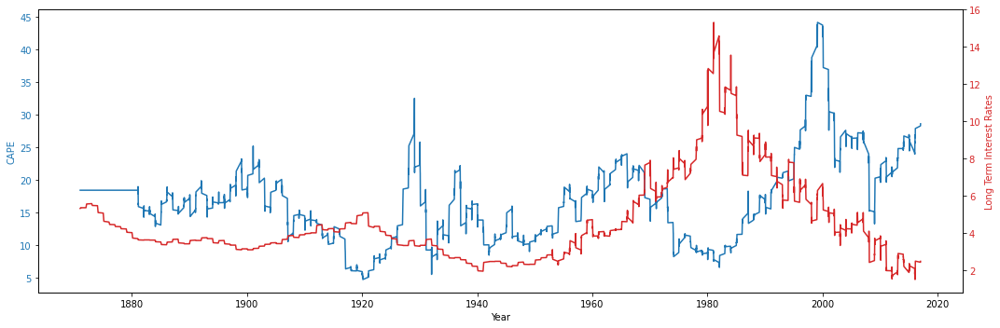

In [0]:
# Off-topic but interesting trend is the CAPE ratio compared to long term interest rates:

t = date
data1 = cape
data2 = long_interest_rate
plt.figure(figsize=(20,5))

fig, ax1 = plt.subplots(1,1,figsize=(15,5))

color = 'tab:blue'
ax1.set_xlabel('Year')
ax1.set_ylabel('CAPE', color=color)
ax1.plot(t, data1, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:red'
ax2.set_ylabel('Long Term Interest Rates', color=color)  # we already handled the x-label with ax1
ax2.plot(t, data2, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

## 2. Calculate the FFT of the signal of interest, to estimate possible periodicities. You can use a window to avoid spectral leaking.

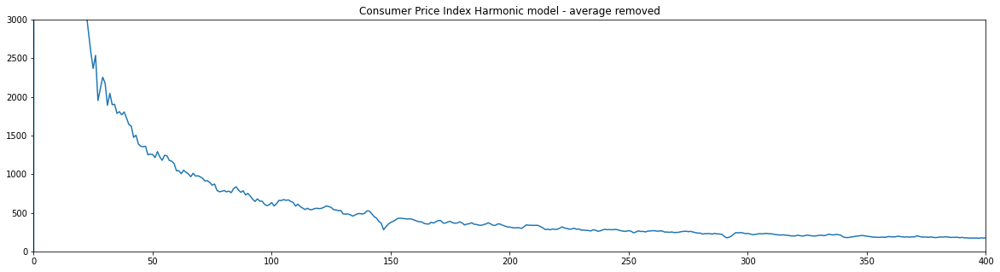

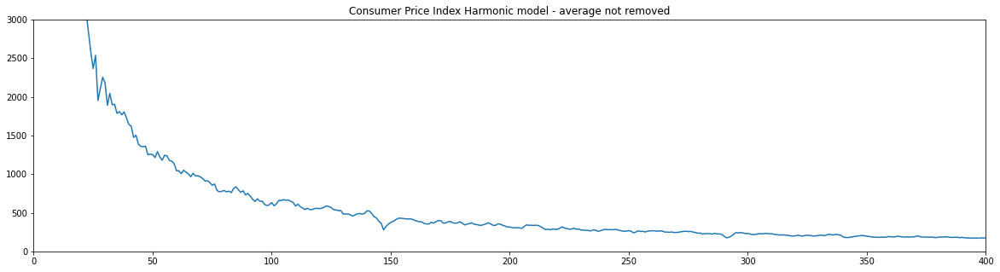

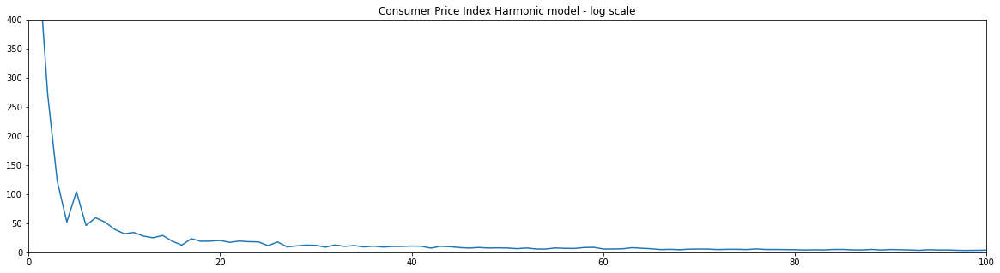

In [105]:
def signalofinterest(sof, label):
  """
  Investigate signal of interest

  Parameters
  ----------
  sof : array_like
    Signal of interest

  label : string
    Descriptive name

  Returns
  -------
  void

  Example
  -------
  >>> signalofinterest(cpi, "Consumer Price Index")
  """

  # Investigating the signal of interest, first on a linear scale

  # Get sequence of interest e.g. long upward trend, 1982 - 2000
  # len(date) #  1754 samples
  from scipy import signal
  import numpy as np

  # remove infs and nans
  nans, x2 = nan_helper(sof)
  sof[nans]= np.interp(x2(nans), x2(~nans), sof[~nans]) 
  avg = np.mean(sof)
  # removing average
  sof_norm = sof - avg
  # tried both ways, graph looks exactly the same, assume mean has been removed either way
  # sof_ct = signal.detrend(sof, type == 'constant'); # mean removed

  harmonic_model_mean_removed = np.fft.rfft(sof_norm)

  plt.figure(figsize=(20,5))
  plt.plot(np.abs(harmonic_model_mean_removed))
  plt.title(label + ' Harmonic model - average removed')
  plt.xlim(0, 400)
  plt.ylim(0, 3000)
  plt.show()

  harmonic_model = np.fft.rfft(sof)

  plt.figure(figsize=(20,5))
  plt.plot(np.abs(harmonic_model))
  plt.title(label + ' Harmonic model - average not removed')
  plt.xlim(0, 400)
  plt.ylim(0, 3000)
  plt.show()

  # Now on log scale
  sof_log = np.log10(sof);
  # sof_ct = scipy.signal.detrend(sof, type == 'constant'); # mean removed

  harmonic_model_log = np.fft.rfft(sof_log);

  plt.figure(figsize=(20,5))
  plt.plot(np.abs(harmonic_model_log))
  plt.title(label + ' Harmonic model - log scale')
  plt.xlim(0, 100)
  plt.ylim(0, 400)
  plt.show()

signalofinterest(cpi, "Consumer Price Index");  

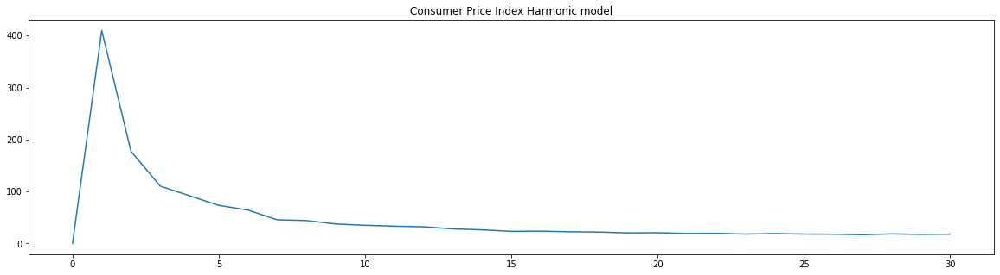

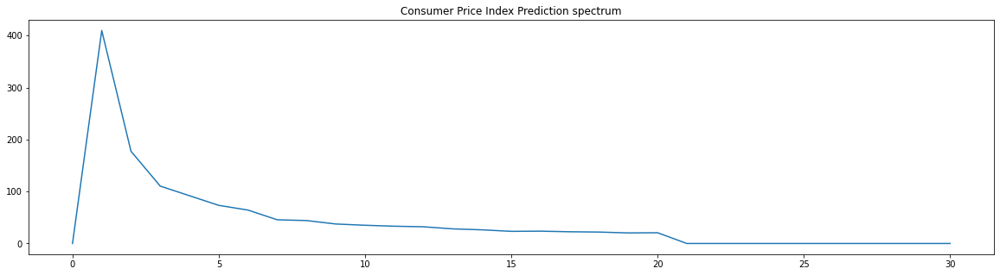

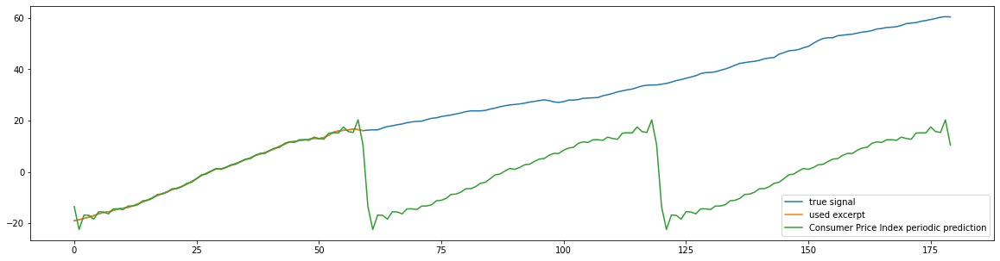

In [119]:
def predict_signal(sof, soflabel, years, threshold, offset, interval=0, detrend='none'):
  """
  Generate prediction for signal of interest

  Parameters
  ----------
  sof : array_like
    Signal of interest

  soflabel : string
    Descriptive name

  years : int
    Length of excerpt

  threshold : int
    Harmonic model threshold

  offset : int
    Year/Month offset, examples:
    828 - Jan 1940 - date[828]
    1284 - Jan 1978 - date[1284]

  interval : int
    Length in years of overal signal being considered.

  detrend : string
    Detrended data. See prep_data
  Returns
  -------
  void

  Example
  -------
  >>> predict_signal(cpi, "Consumer Price Index", 10, 10)
  """

  sof = prep_data(sof, detrend);
  
  if interval == 0:
    sof = sof[offset:];
  else:
    interval = interval * 12; # months 
    sof = sof[offset:offset + interval] 

  excerpt_length = years * 12 # Samples are gathered monthly
  excerpt = sof[:excerpt_length]
  avg = np.mean(excerpt)
  norm_excerpt = excerpt - avg
  harmonic_model = fft.rfft(norm_excerpt)

  plt.figure(figsize=(20,5))
  plt.plot(np.abs(harmonic_model))
  plt.title(soflabel + ' Harmonic model')
  plt.show()   

  # threshold = 500
  predict_spectrum = np.where(np.abs(harmonic_model) < threshold, 0, harmonic_model)

  plt.figure(figsize=(20,5))
  plt.plot(np.abs(predict_spectrum))
  plt.title(soflabel + ' Prediction spectrum')
  plt.show()

  prediction = fft.irfft(predict_spectrum)

  test_length = 2 # expressed as number of times the excerpt length
  total_length = (test_length + 1) * excerpt_length

  true_signal = sof[:total_length] - avg
  periodic_prediction = np.tile(prediction, test_length+1)

  plt.figure(figsize=(20,5))
  plt.plot(true_signal, label='true signal')
  plt.plot(norm_excerpt, label='used excerpt')
  plt.plot(periodic_prediction, label= soflabel + ' periodic prediction')
  plt.legend(loc='lower right')
  plt.show()  

  # rmse = np.sqrt(np.mean(np.power(true_signal[excerpt_length:] - periodic_prediction[excerpt_length:], 2)))
  # print('Print root mean square error = ' + str(rmse))

#date = financial['Date']
#snp_comp = financial['SP_Comp_P']
#dividend = financial['Dividend_D'] 
#earnings = financial['Earnings_E']
#cpi = financial['Consumer_Price_Index_CPI']
#date_fraction = financial['Date_Fraction']
#long_interest_rate = financial['Long_Interest_Rate_GS10']
#real_price = financial['Real_Price']
#real_dividend = financial['Real_Dividend']
#real_earnings = financial['Real_Earnings']
#cape = financial['Cyclically_Adjusted_Price_Earnings_Ratio_PE10_or_CAPE']

# Consumer Price index, 5 year excerpt length from 1978, threshold 5
# predict_signal(cpi, "Consumer Price Index", 5, 5, 1284)  
# predict_signal(cpi, "Consumer Price Index", 5, 5, 1284, 'log') # no good
# predict_signal(cape, "Cyclically Adjusted Price Earnings Ratio", 10, 10, 1284, 30)

# predict_signal(cpi, "Consumer Price Index", 10, 10, 1284, 30)
# predict_signal(cpi, "Consumer Price Index", 5, 2, 1284, 16, 'log')
#predict_signal(cpi, "Consumer Price Index - Log", 5, 2, 1284, 16, 'log')
#predict_signal(cpi, "Consumer Price Index", 5, 20, 1284, 16, 'constant')
#predict_signal(cpi, "Consumer Price Index", 5, 20, 1284, 16)
# (sof, soflabel, years, threshold, offset, interval=0, detrend='none')
#predict_signal(dividend, "Dividend", 10, 8, 1284, 16)
# predict_signal(dividend, "Dividend", 10, 1, 500, 16)
# 
# predict_signal(dividend, "Dividend", 5, 1, 500, 16, 'log')
# Overfitting first cycle
# predict_signal(dividend, "Dividend", 10, 1, 500, 16)
# Overfitting first cycle
# predict_signal(cpi, "Consumer Price Index", 5, 20, 1284, 16)
predict_signal(cpi, "Consumer Price Index", 5, 20, 1284, 16)

## 3. Refine your analysis by adjusting the size of the dataset (e.g. if you model annual patterns, make sure your dataset size is a multiple of 12).

***********************
*** Start at year: 1940***
***********************


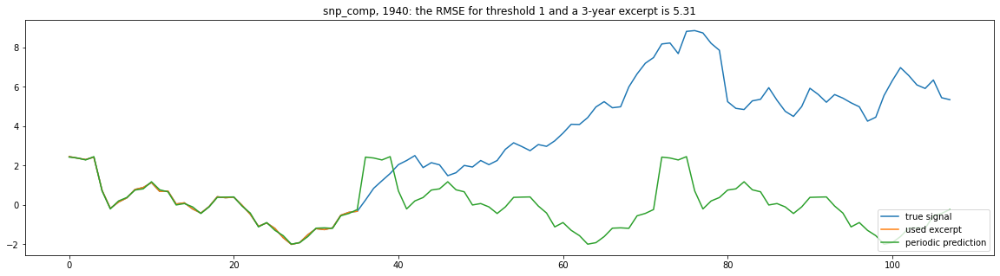

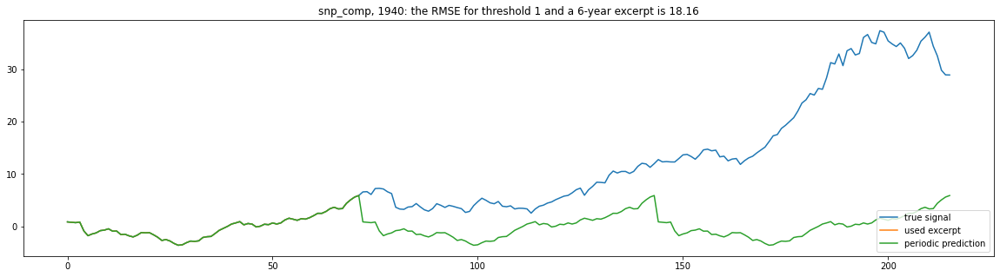

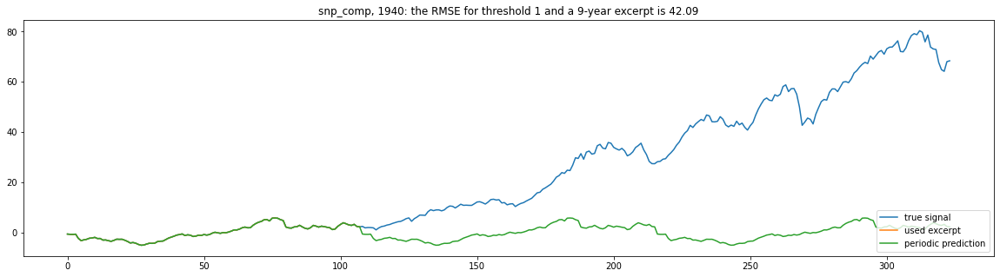

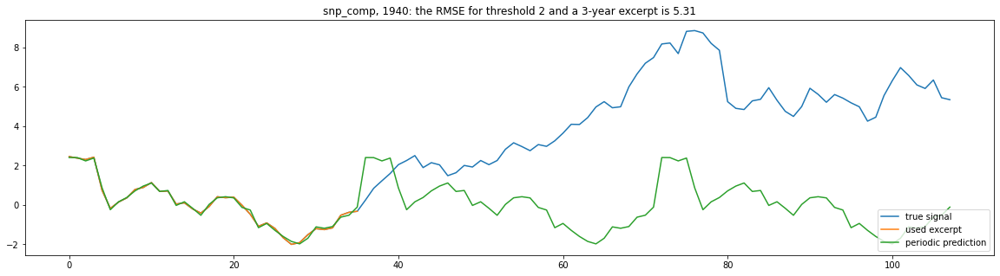

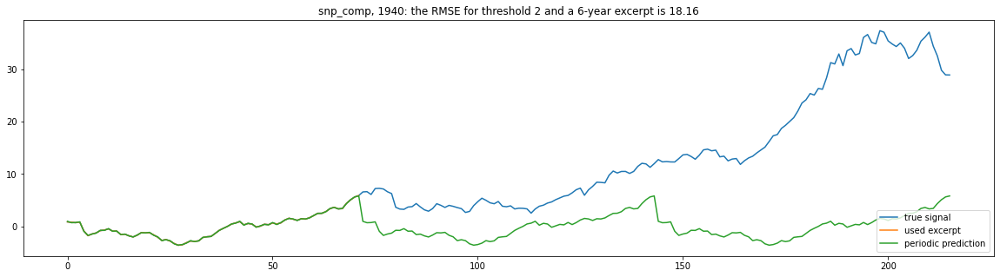

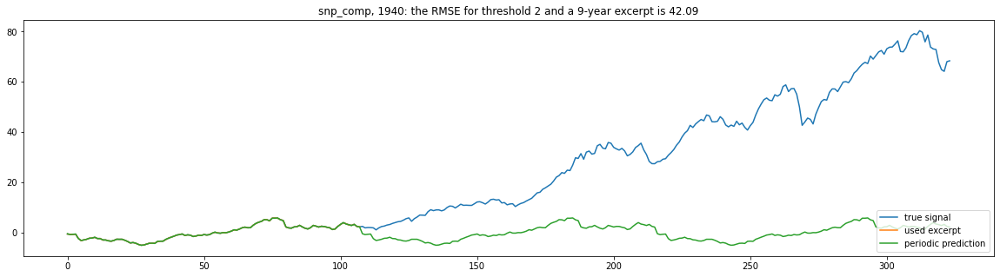

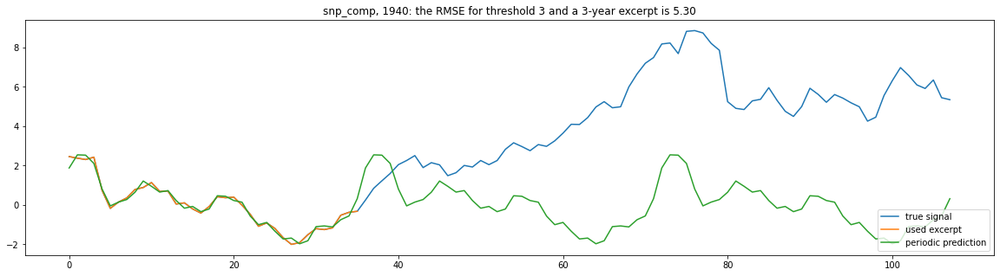

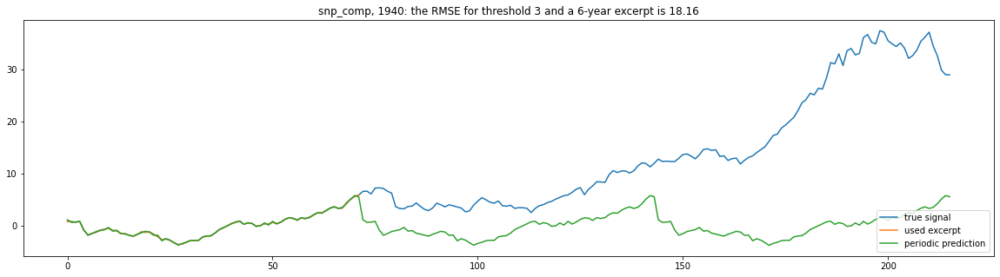

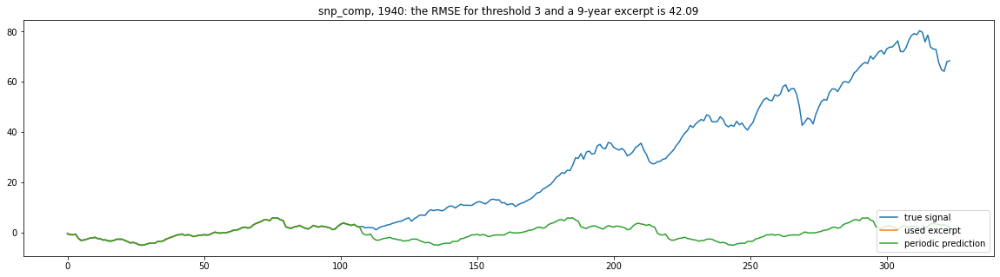

***********************
*** Start at year: 1950***
***********************


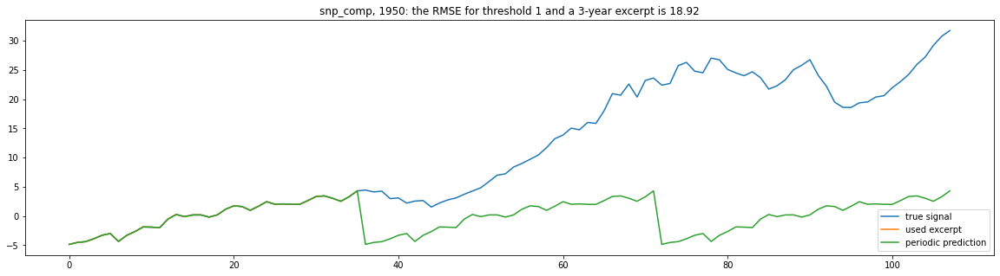

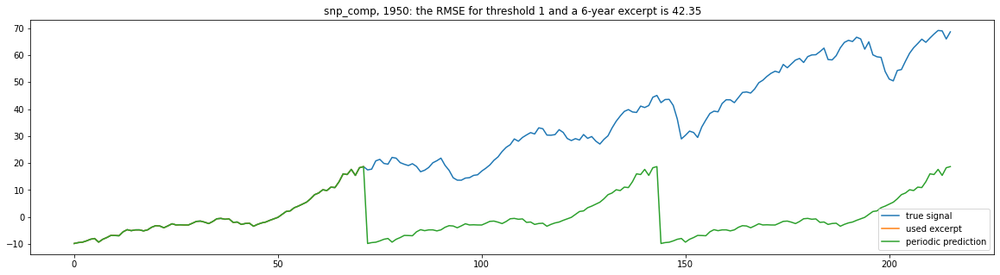

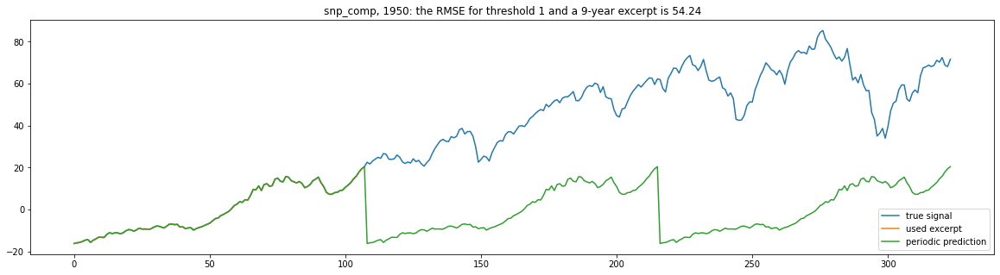

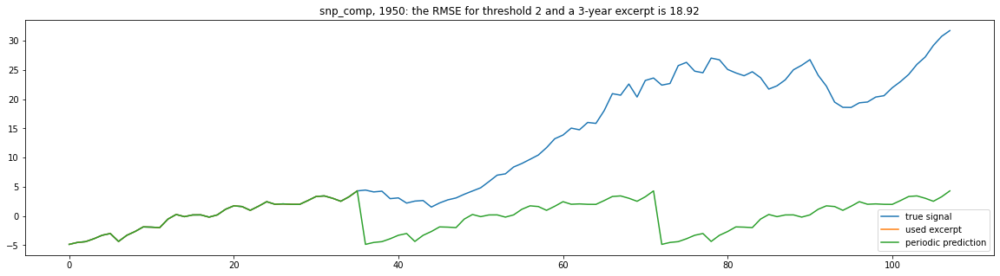

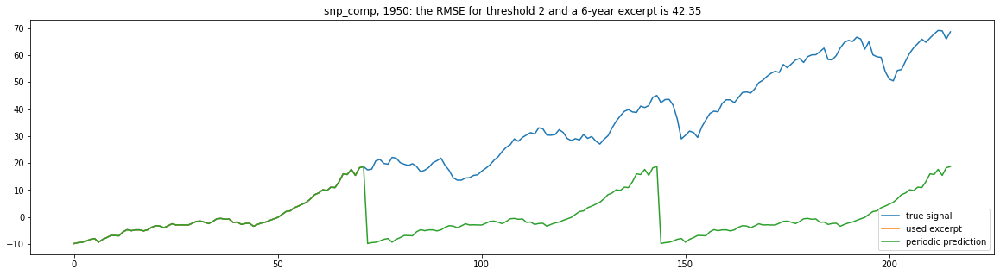

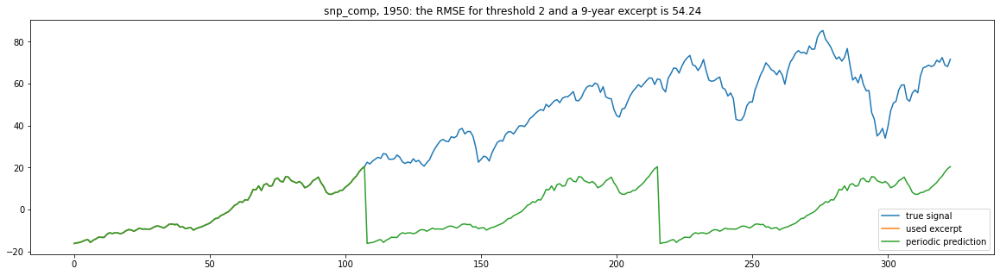

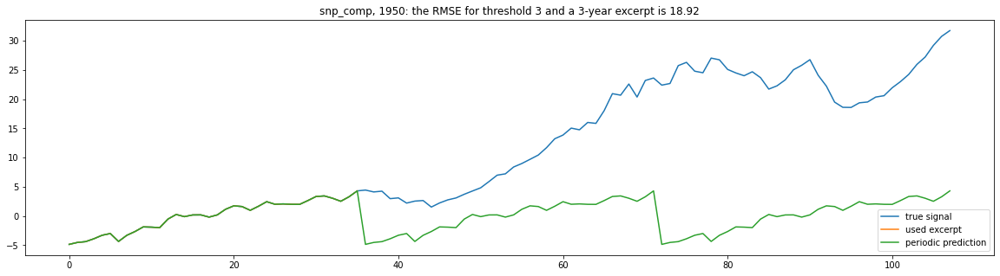

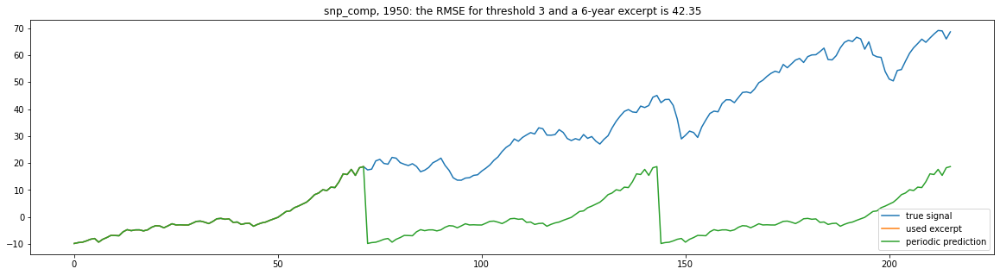

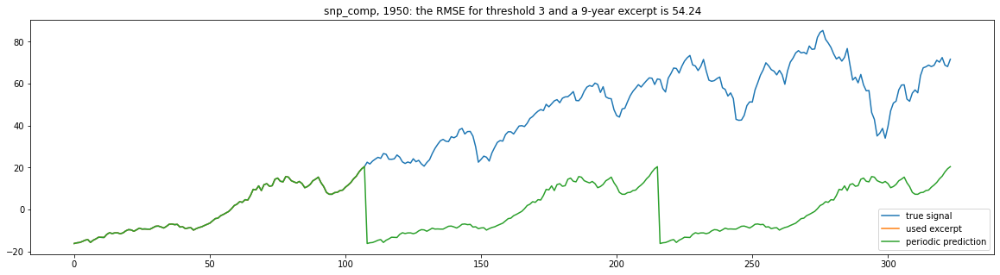

***********************
*** Start at year: 1960***
***********************


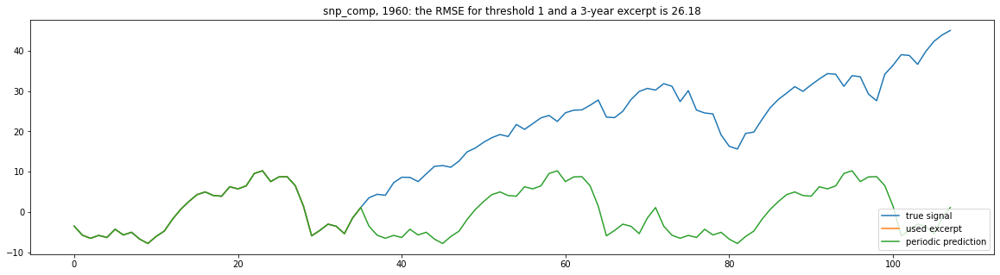

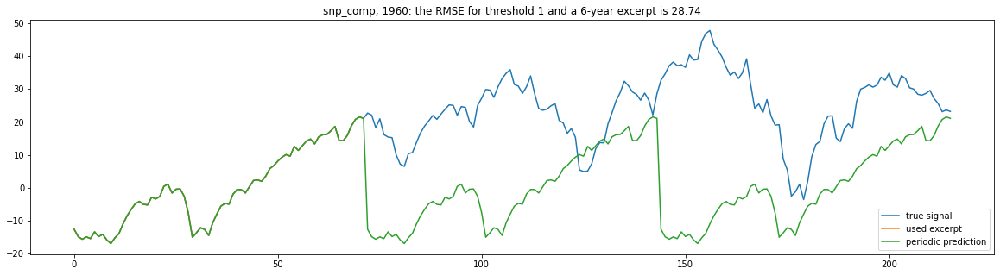

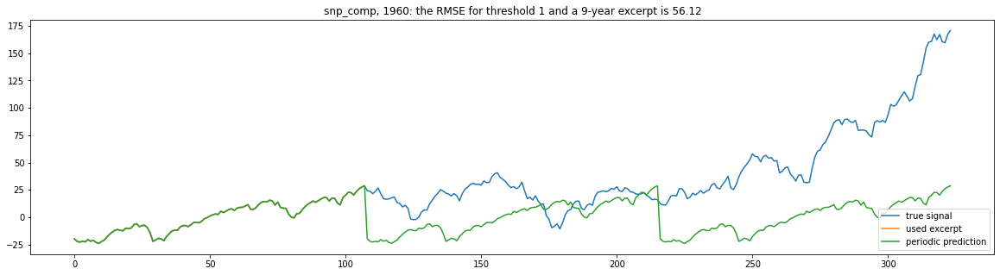

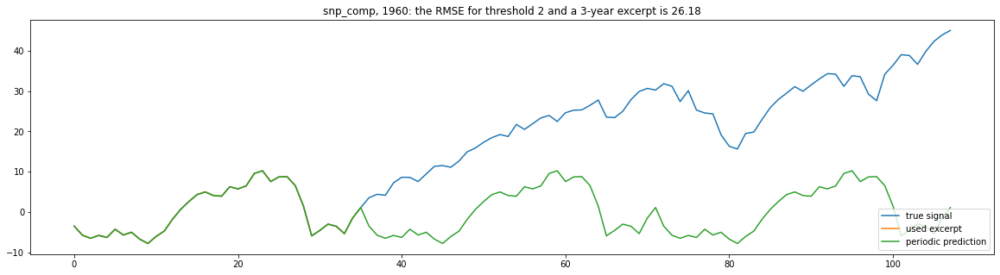

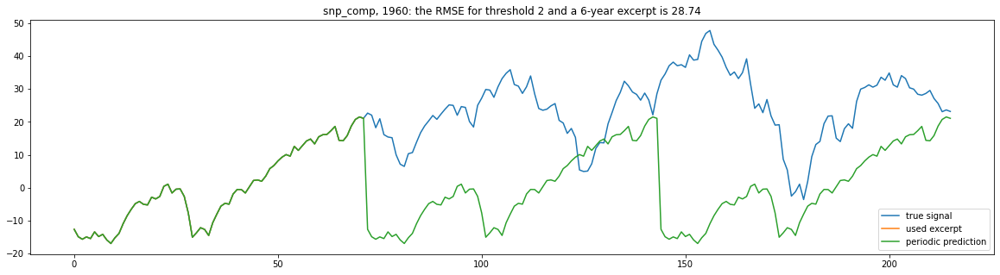

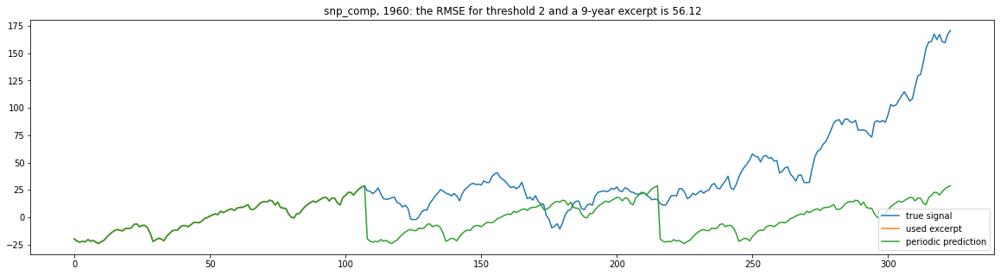

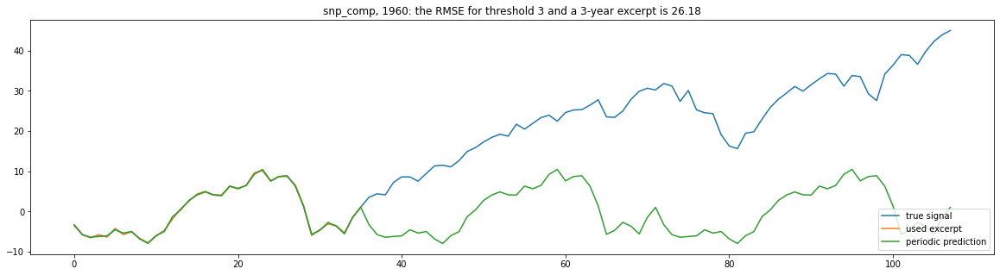

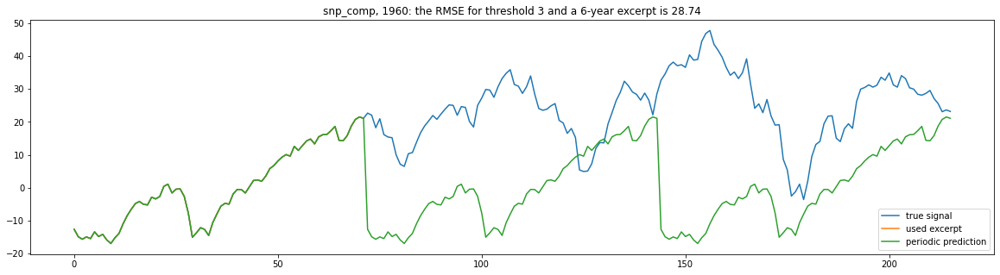

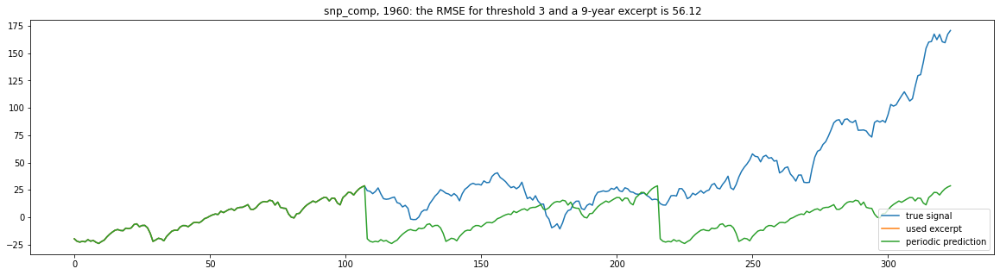

***********************
*** Start at year: 1970***
***********************


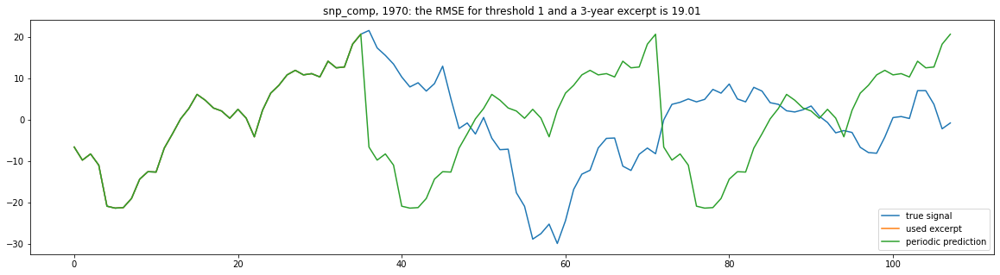

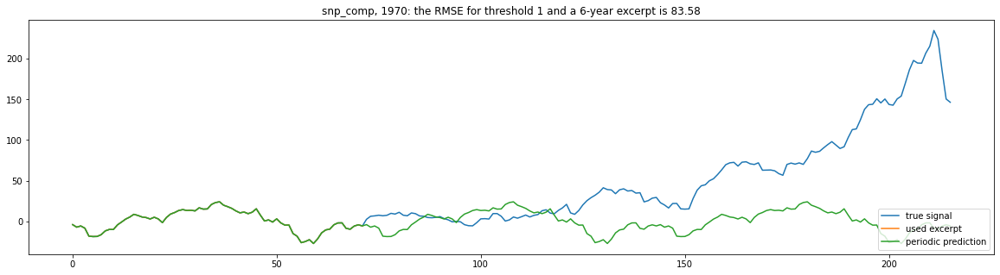

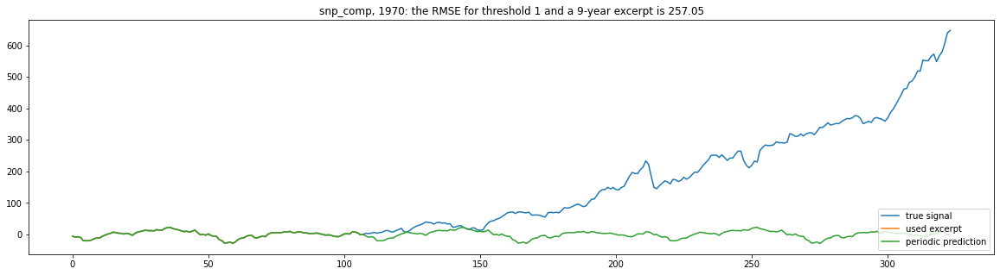

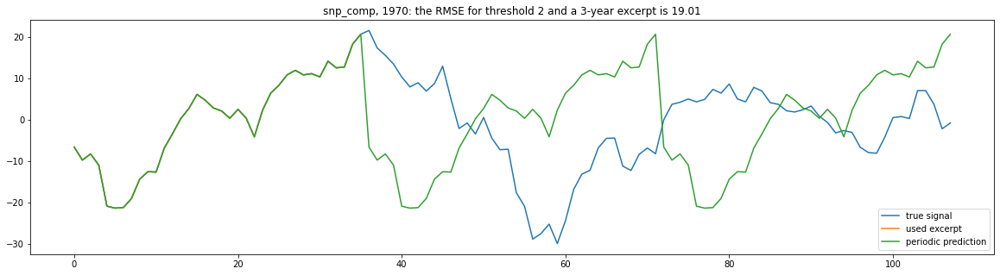

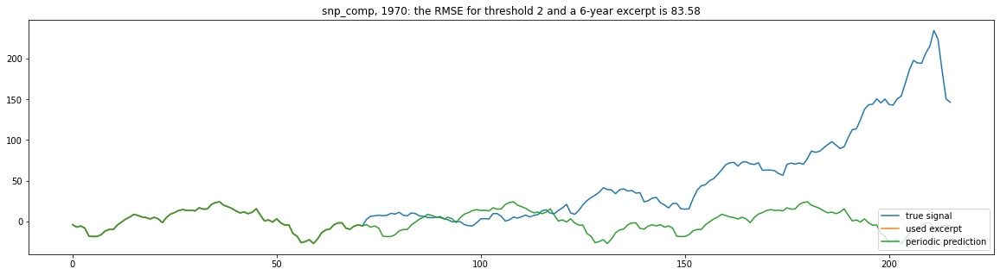

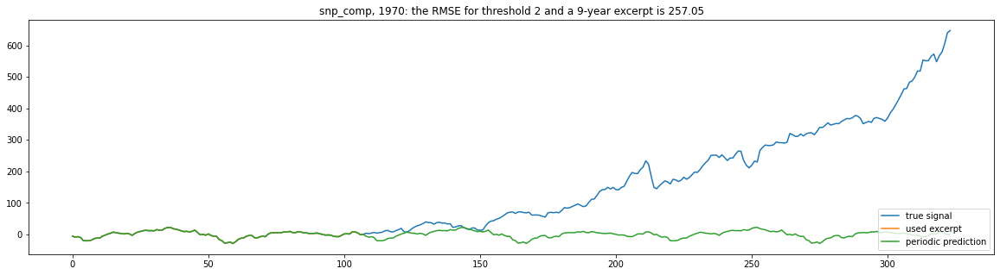

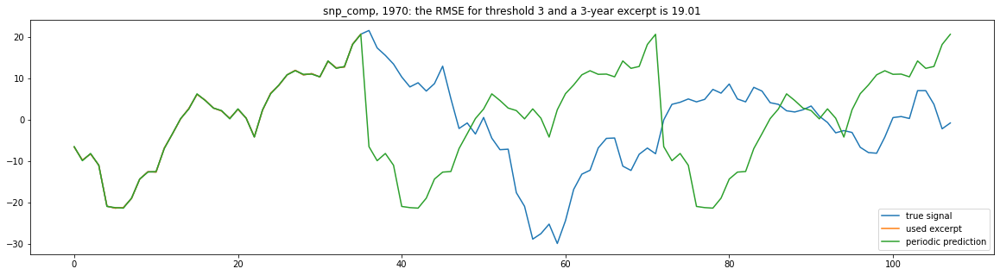

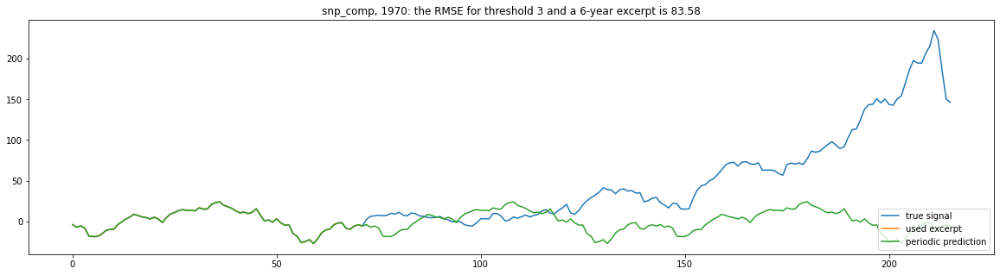

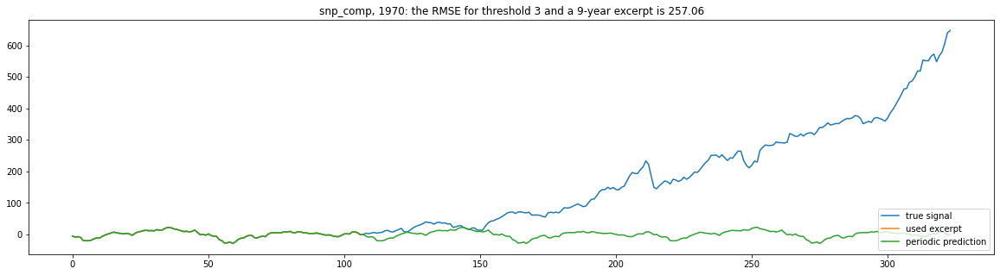

***********************
*** Start at year: 1980***
***********************


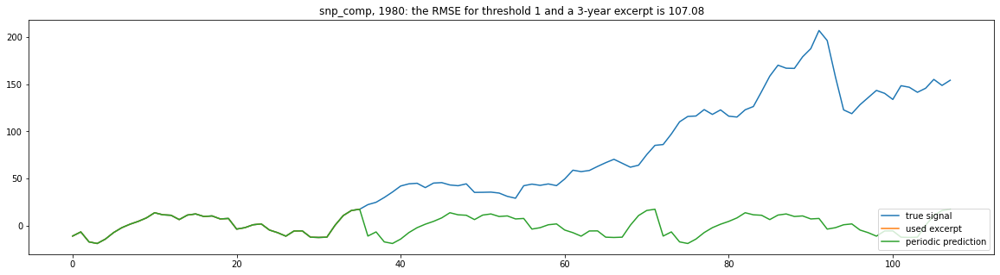

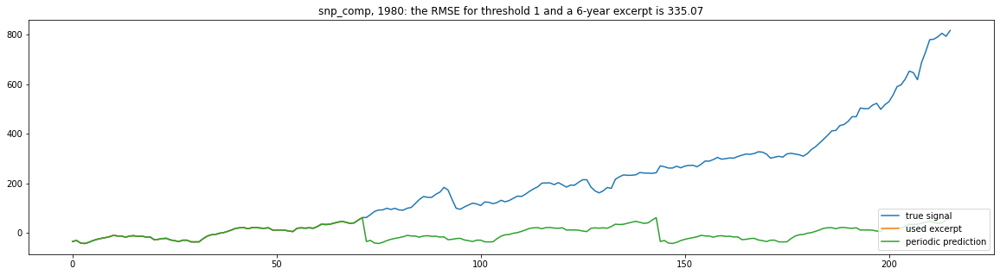

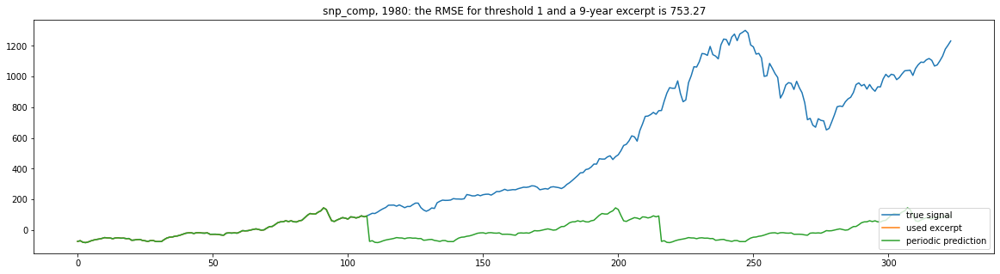

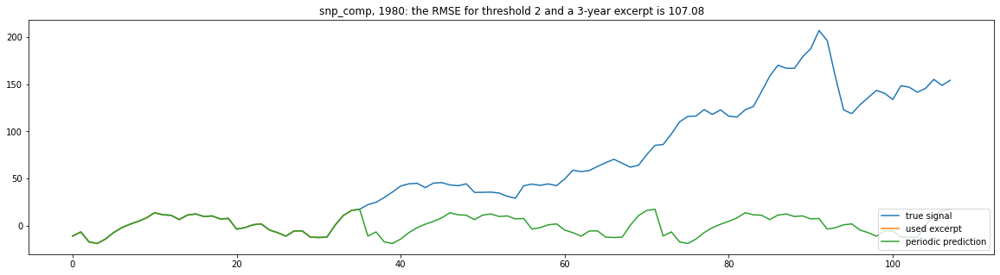

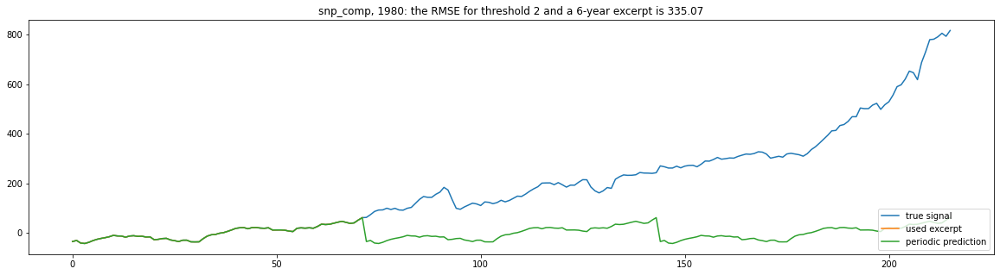

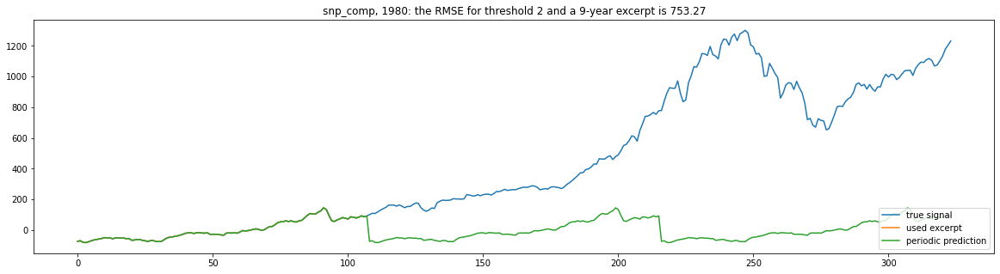

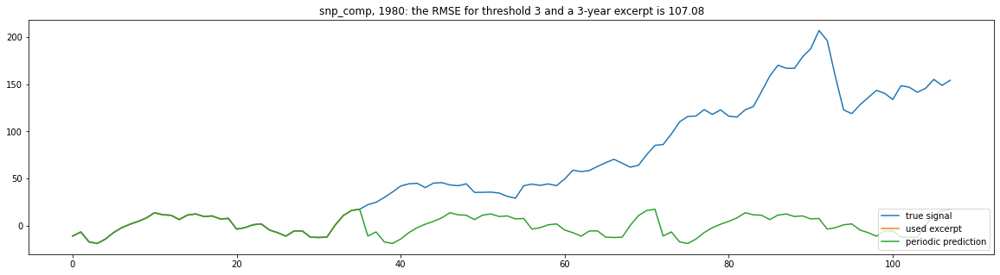

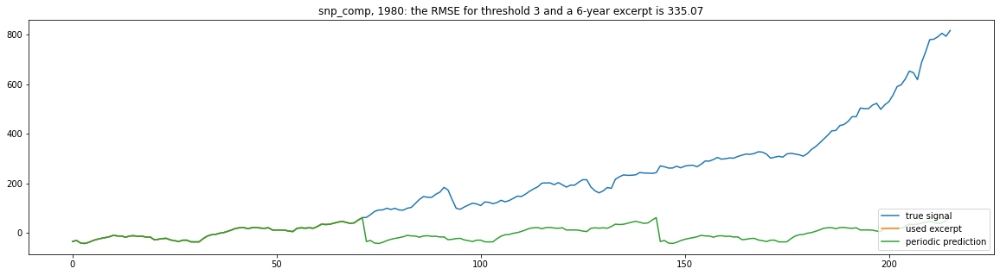

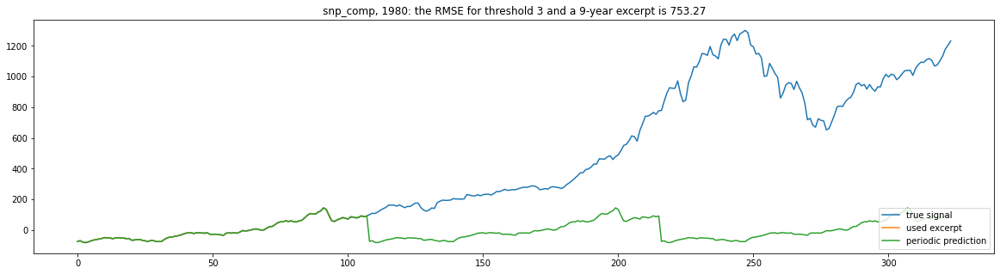

***********************
*** Start at year: 1990***
***********************


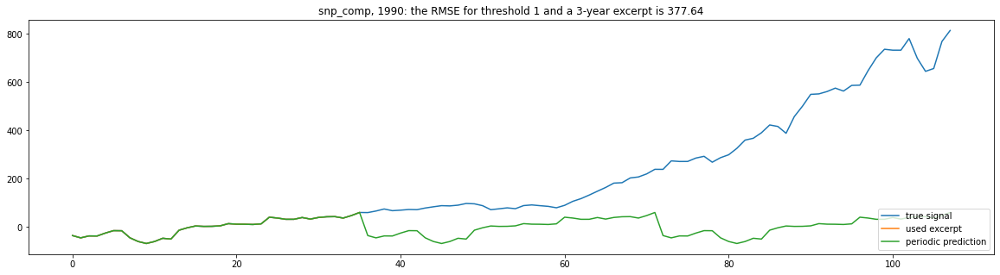

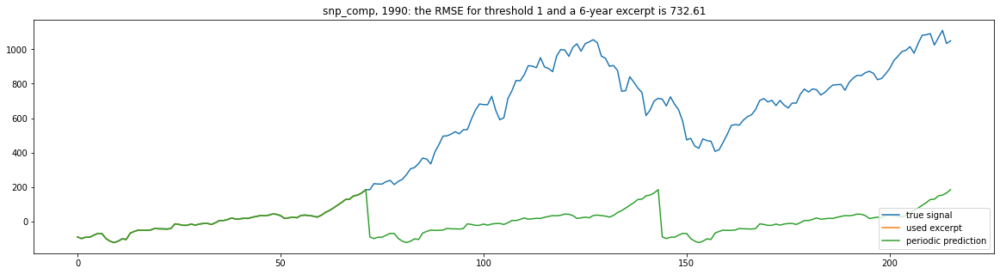

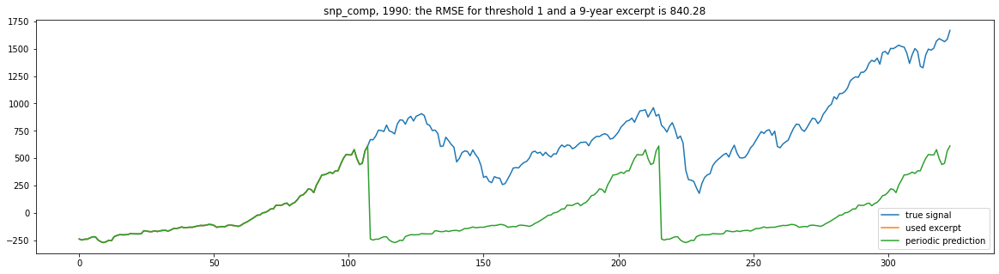

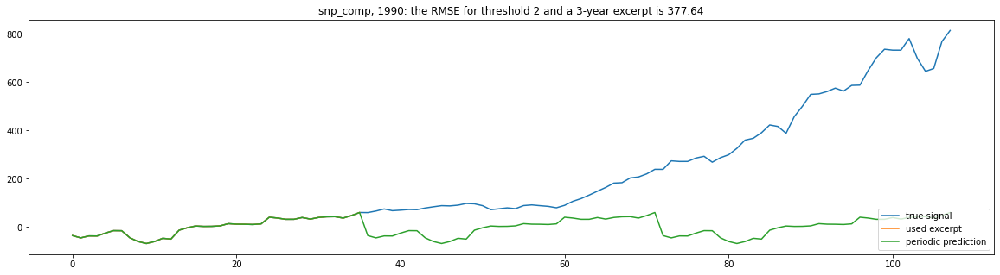

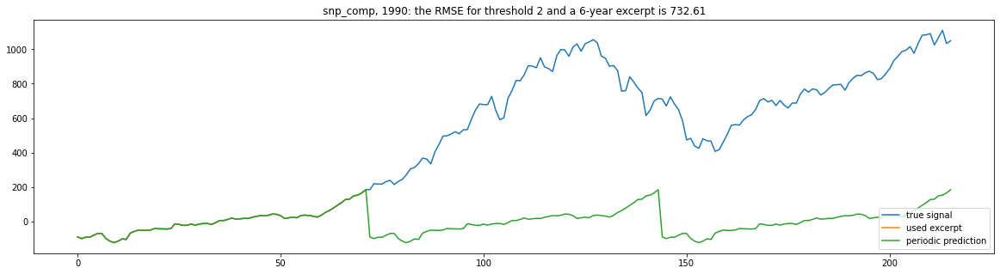

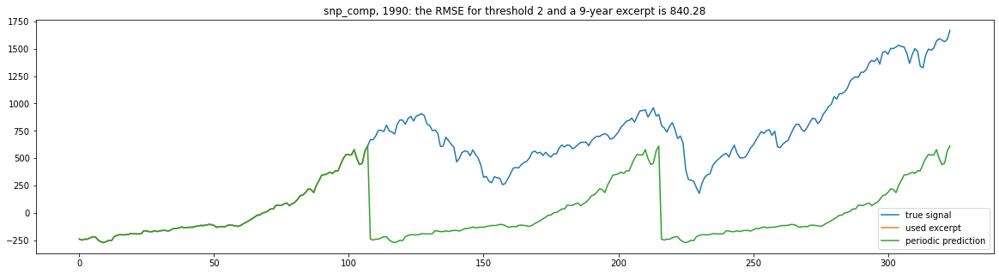

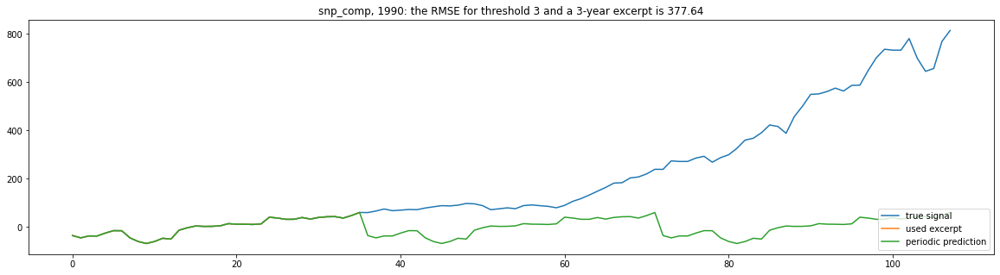

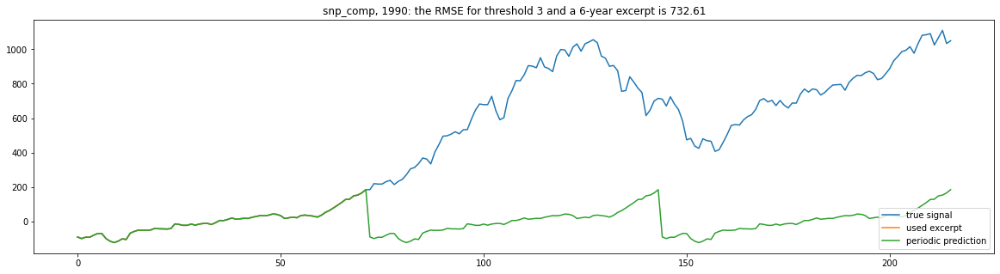

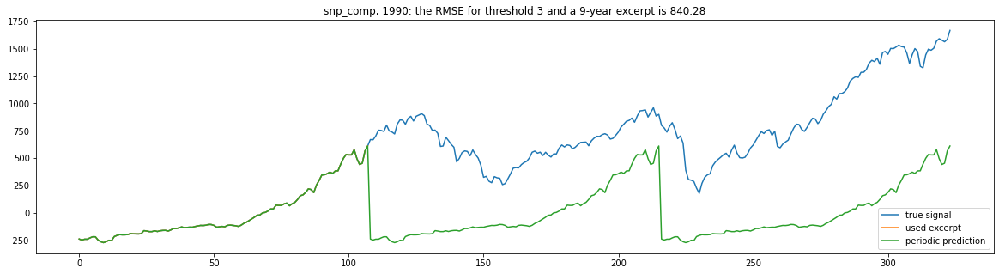

***********************
*** Start at year: 1940***
***********************


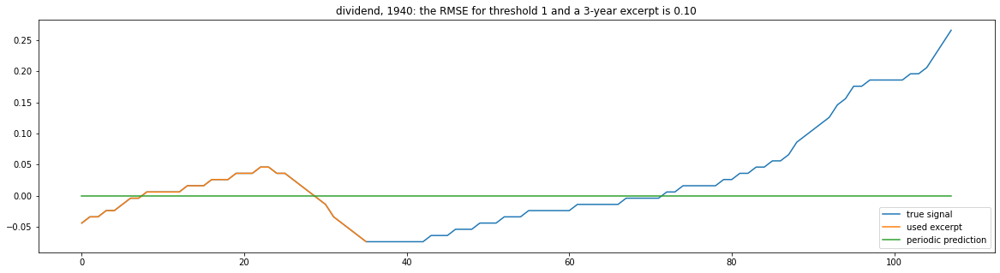

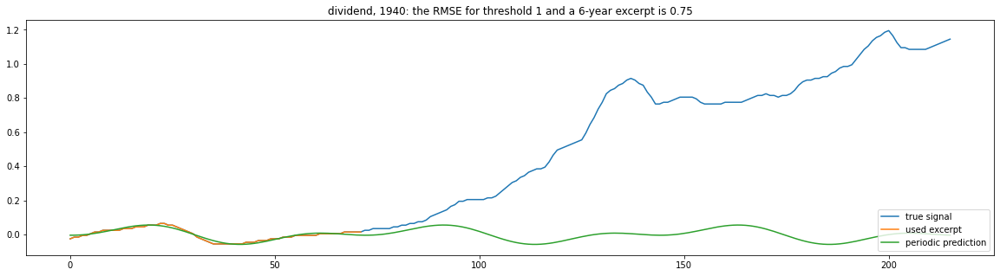

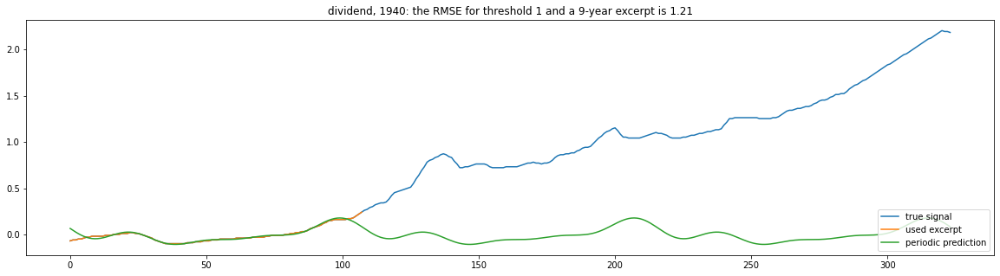

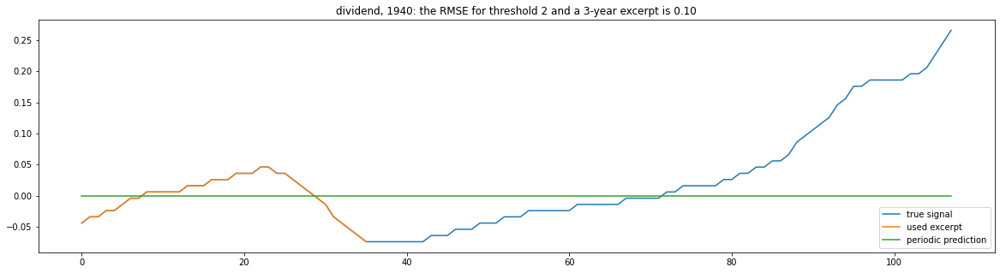

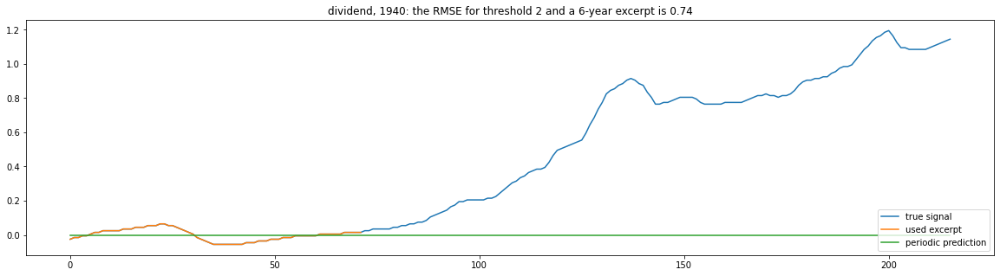

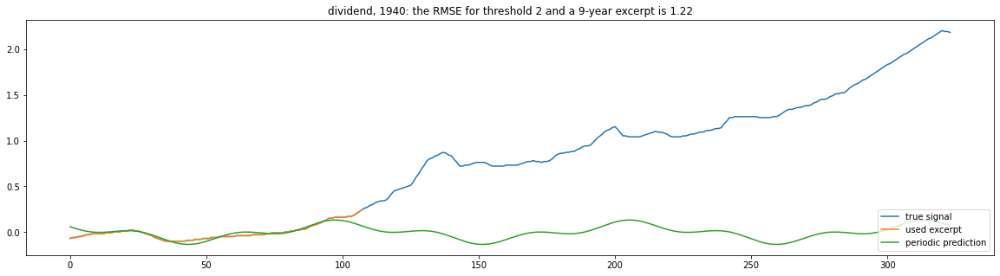

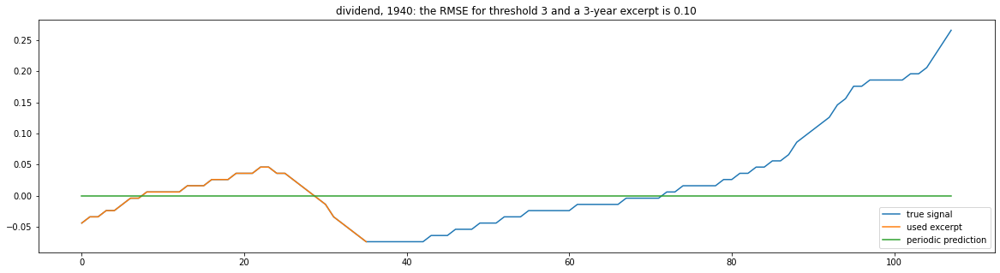

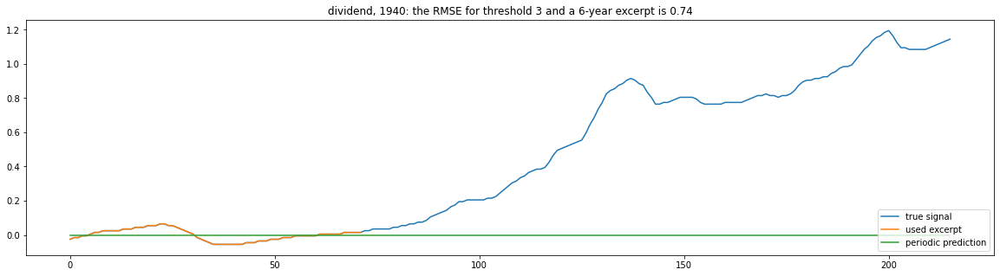

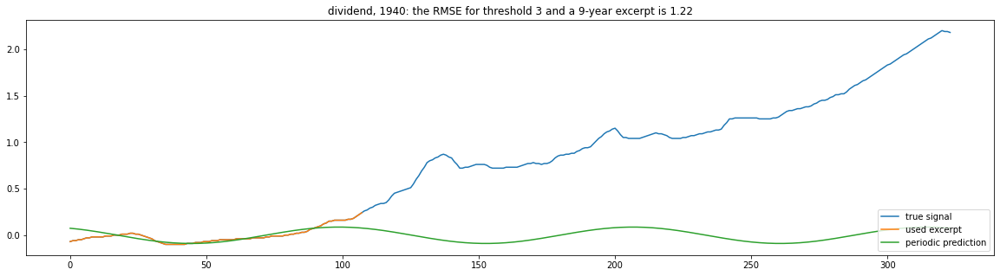

***********************
*** Start at year: 1950***
***********************


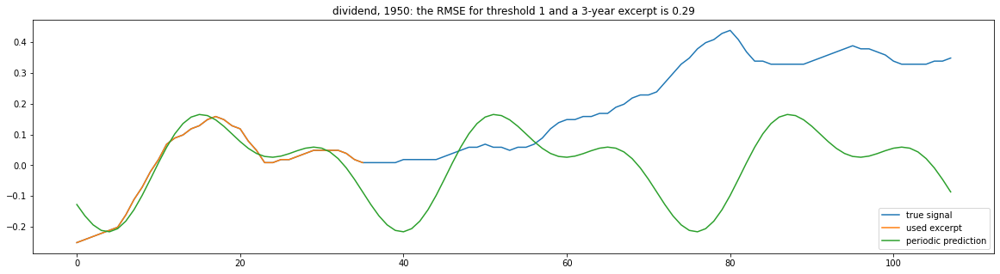

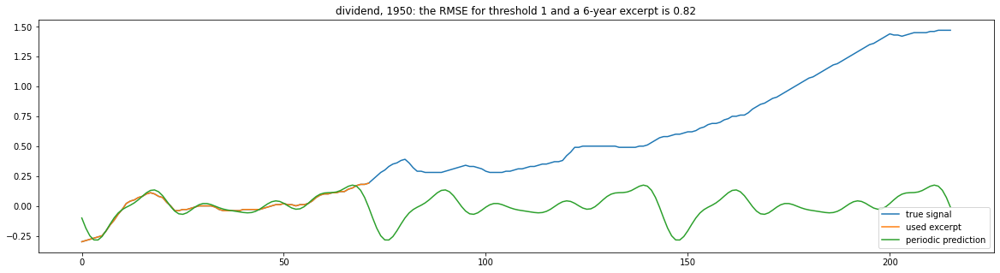

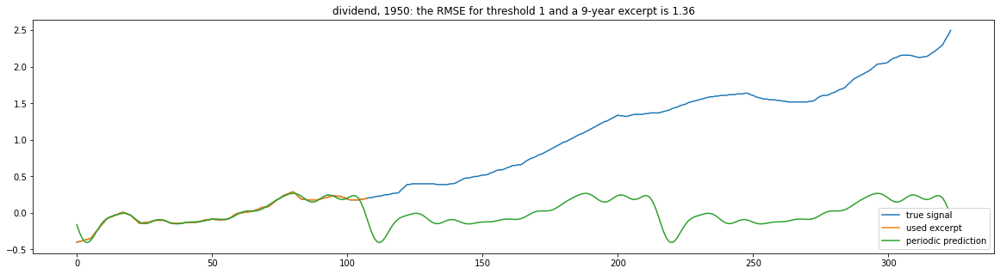

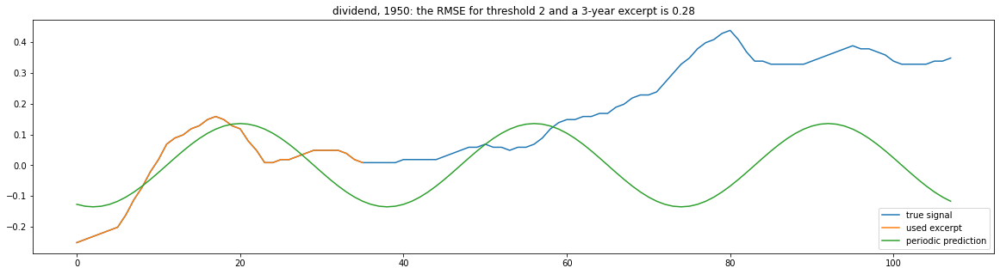

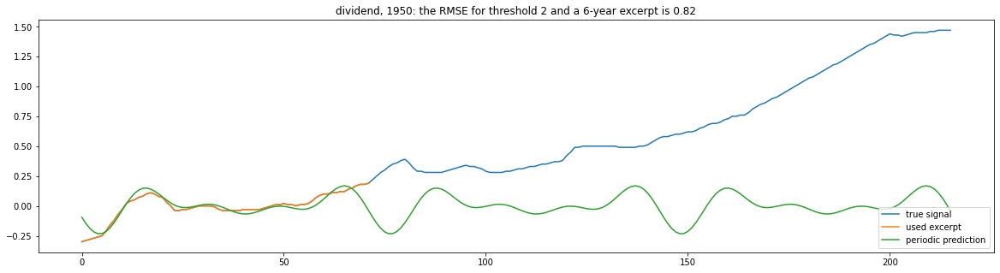

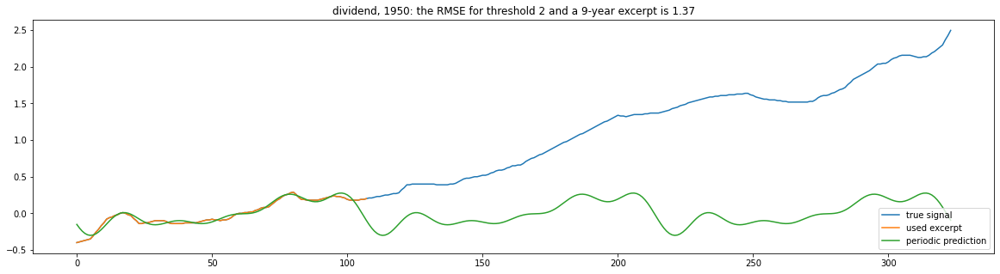

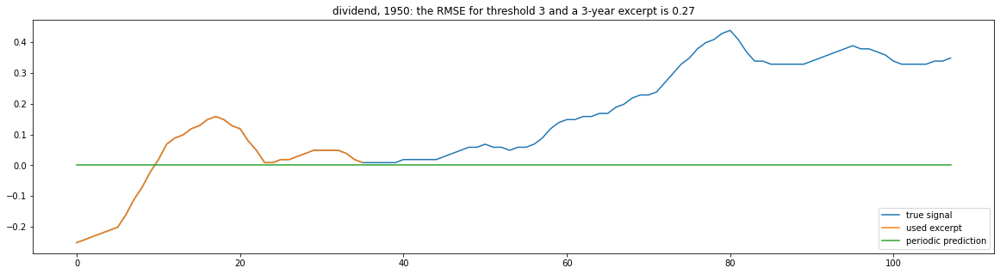

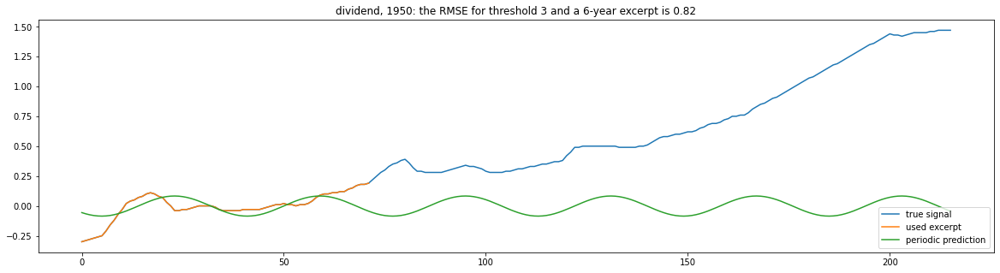

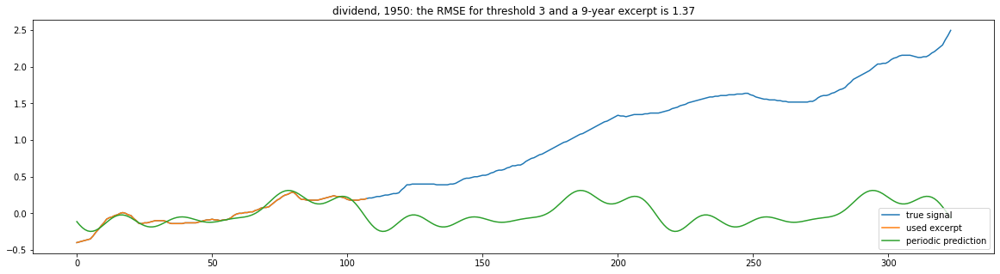

***********************
*** Start at year: 1960***
***********************


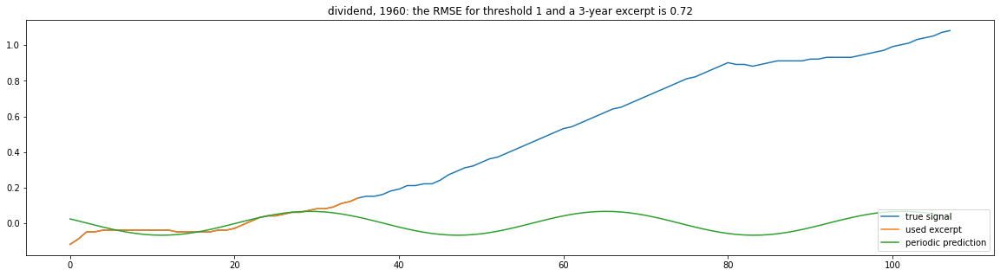

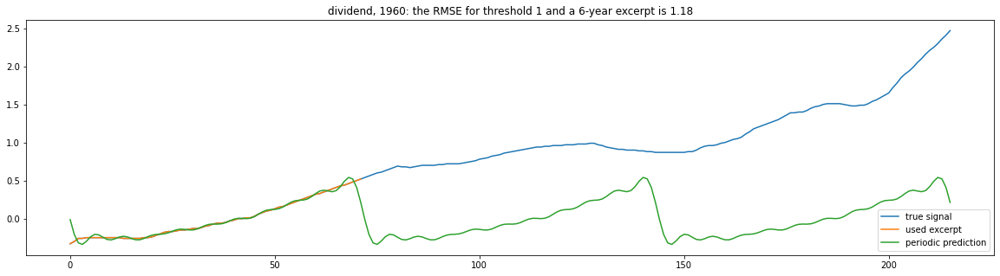

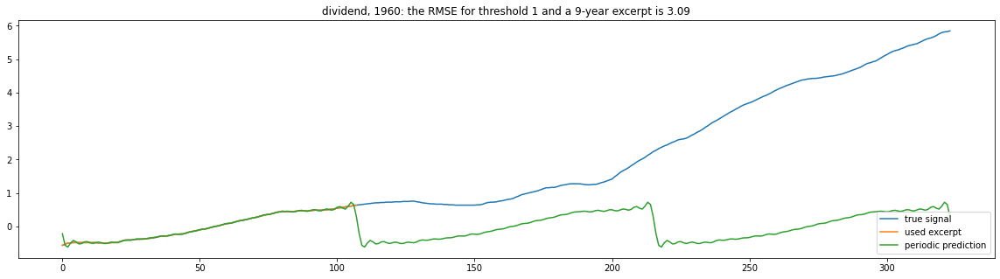

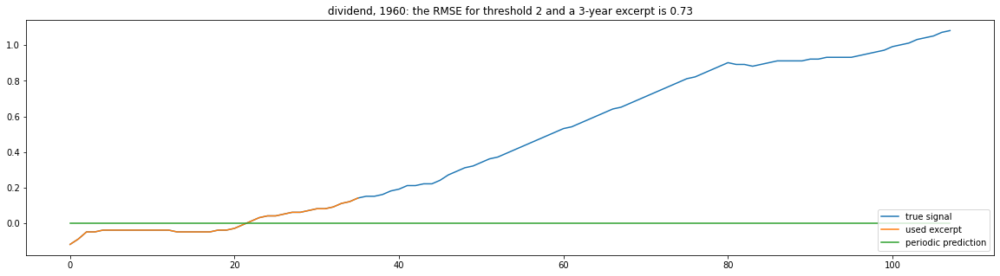

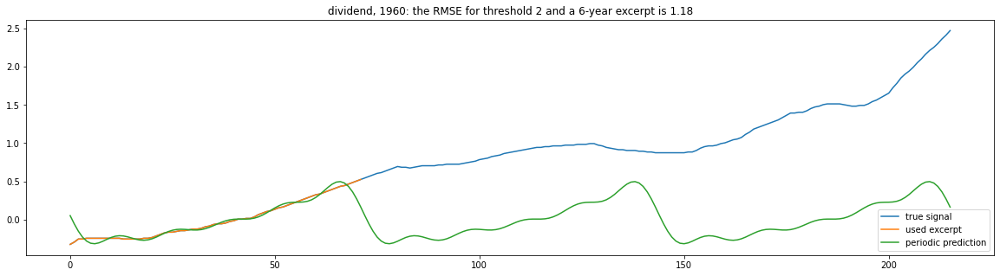

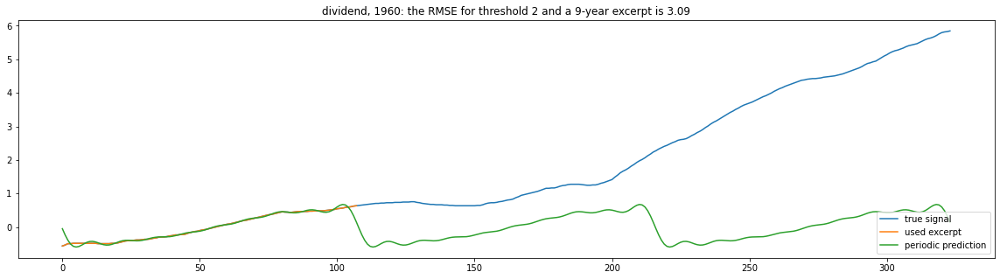

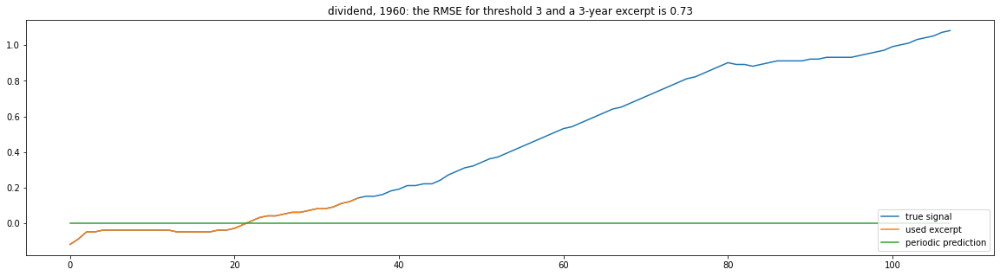

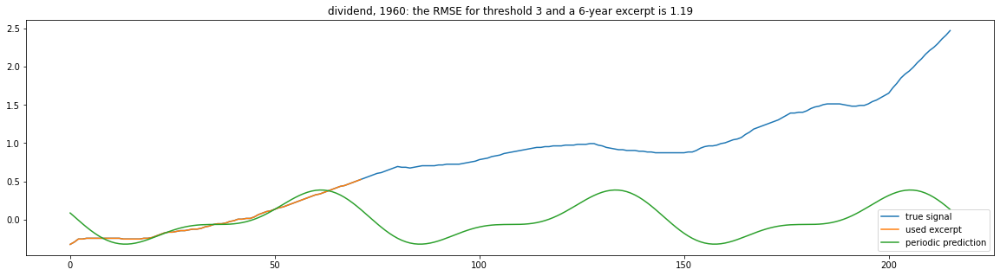

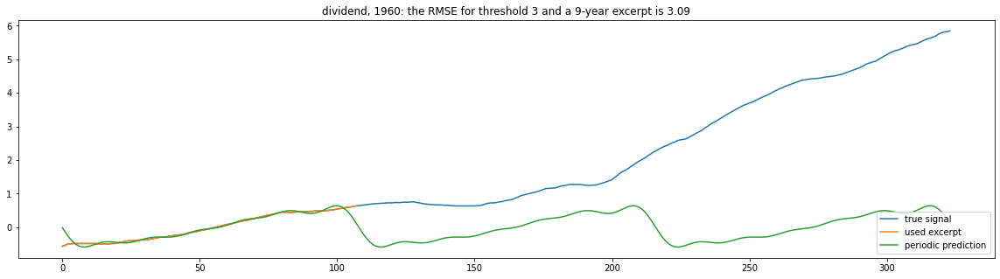

***********************
*** Start at year: 1970***
***********************


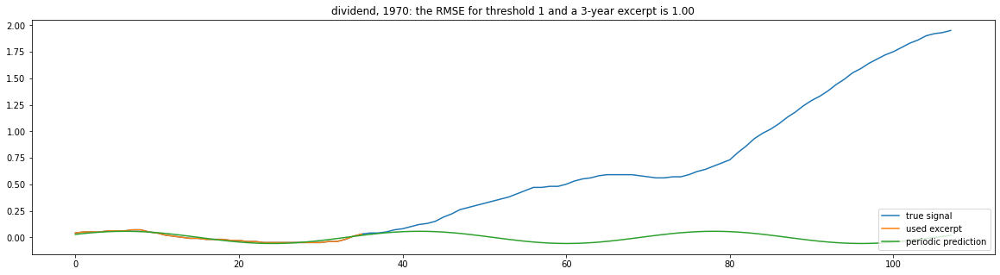

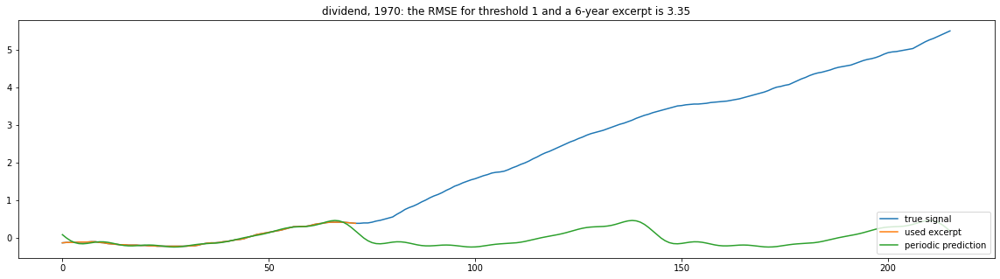

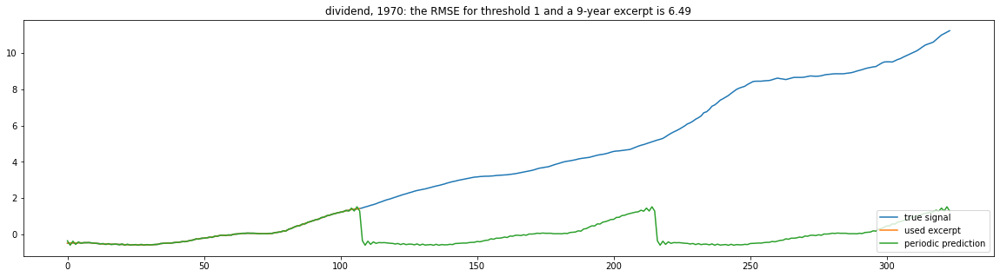

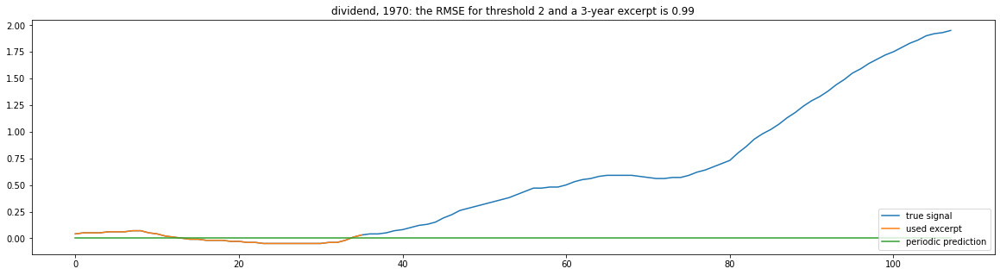

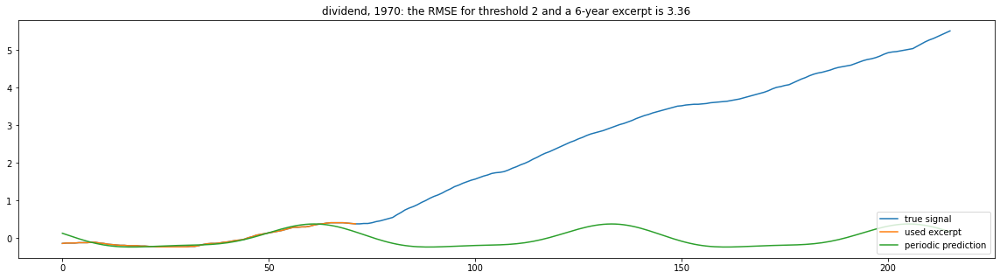

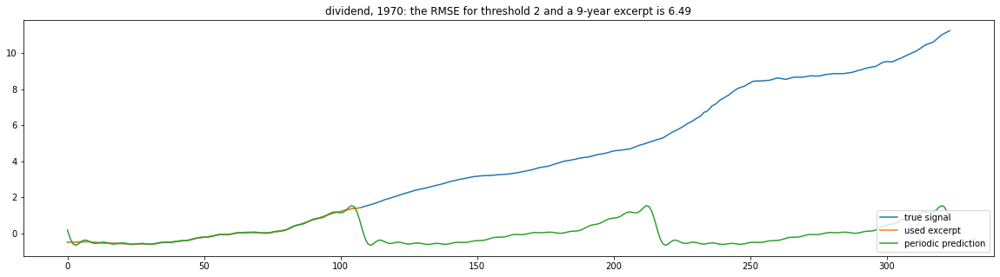

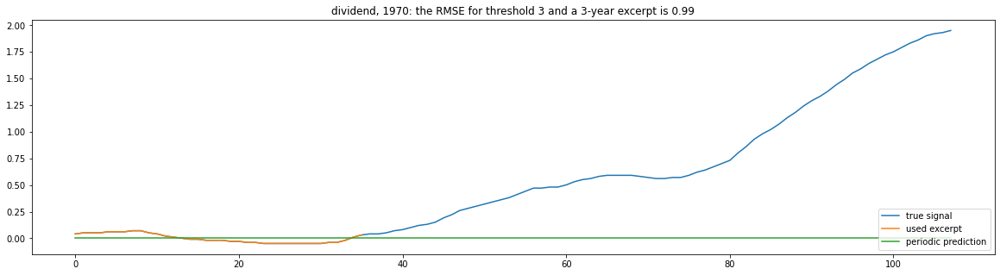

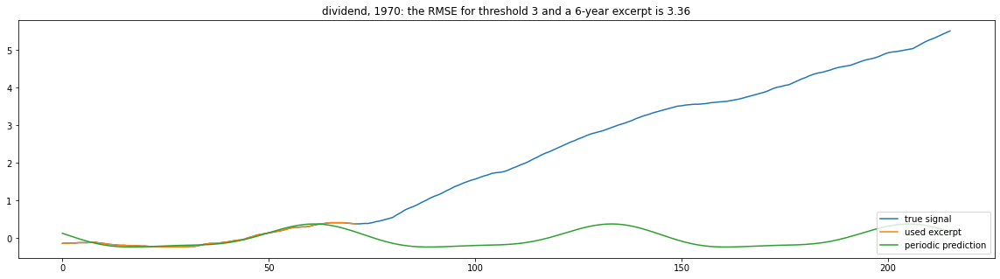

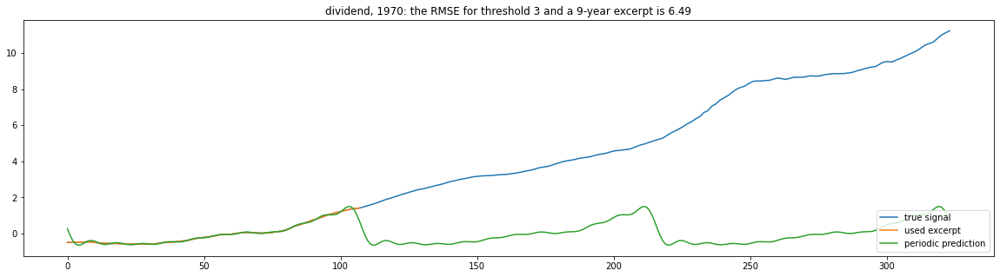

***********************
*** Start at year: 1980***
***********************


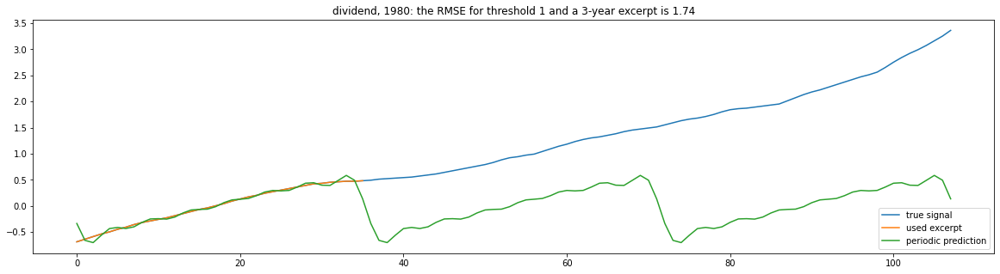

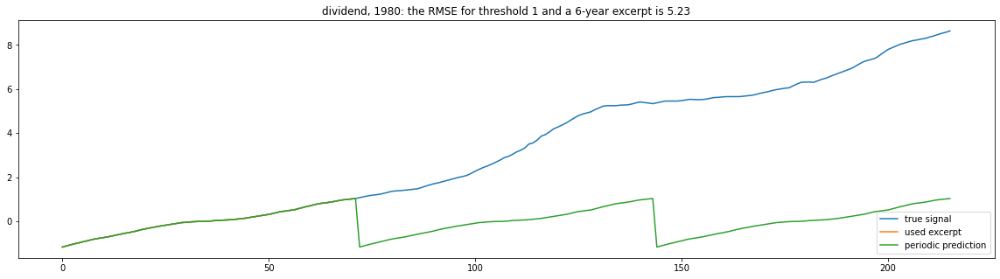

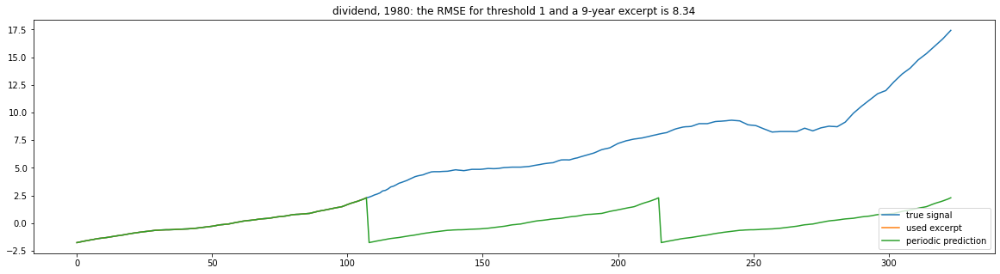

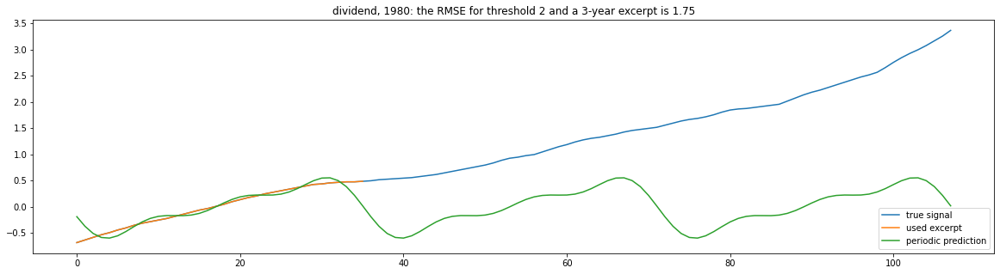

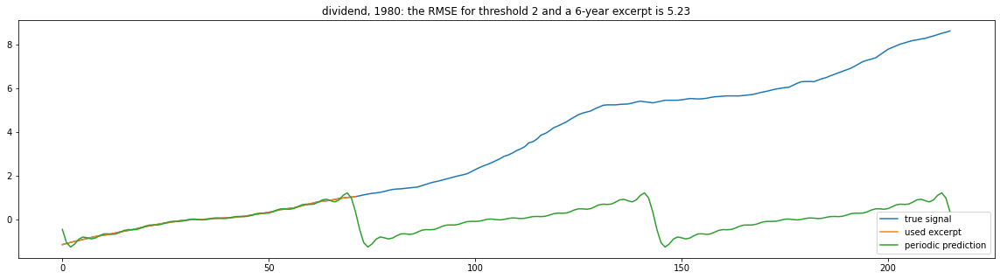

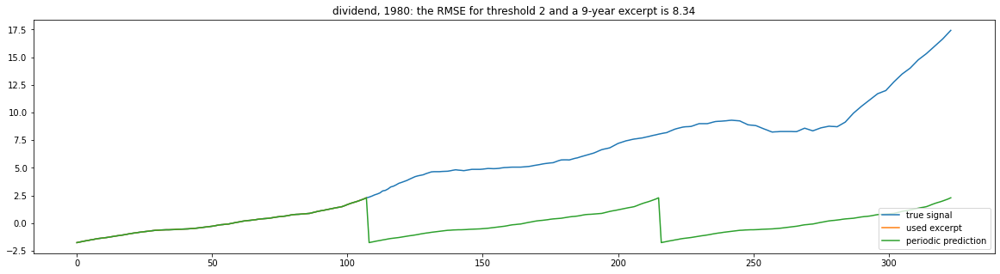

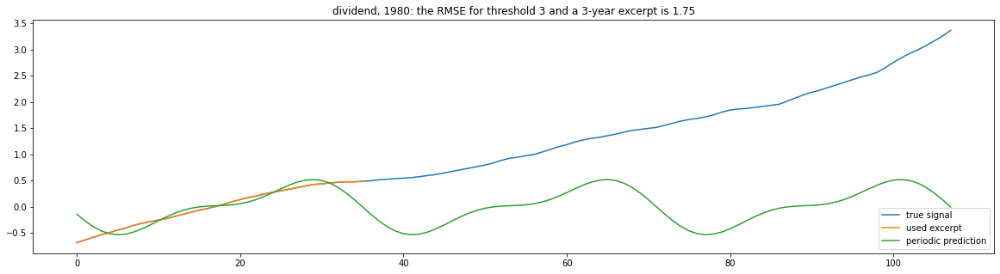

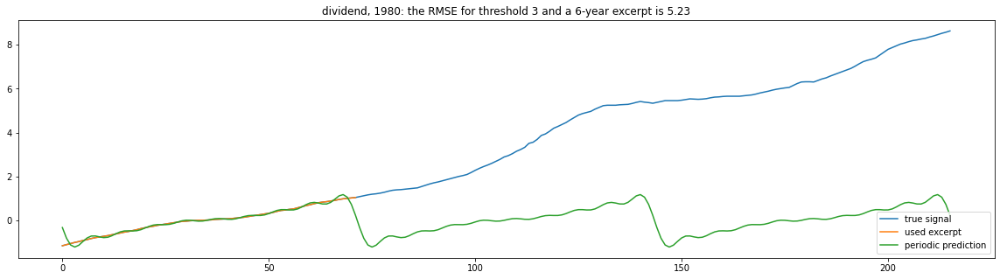

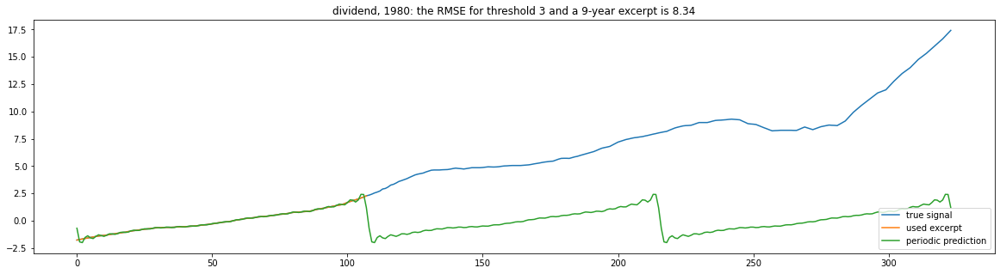

***********************
*** Start at year: 1990***
***********************


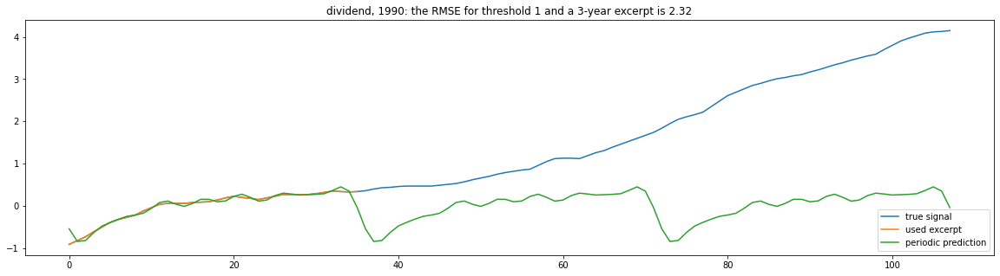

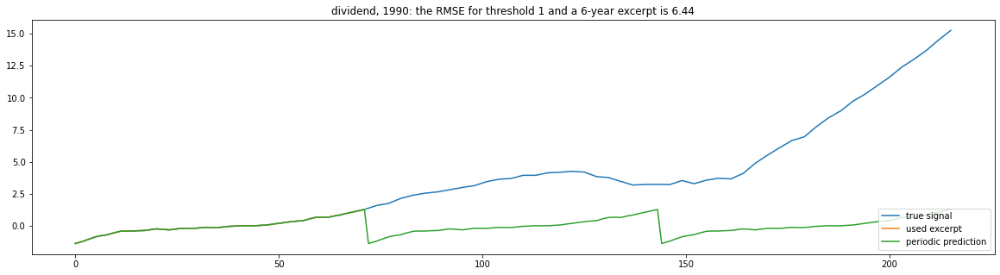

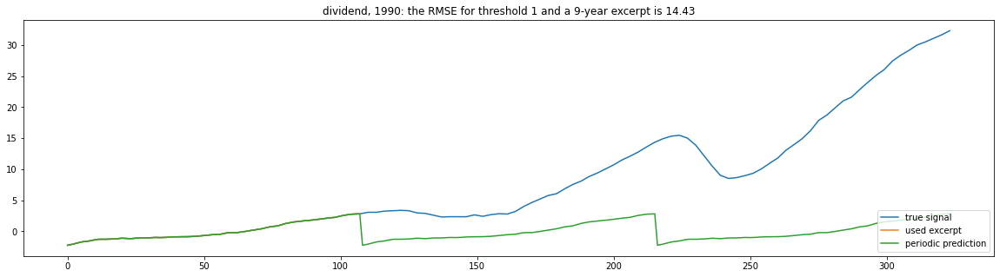

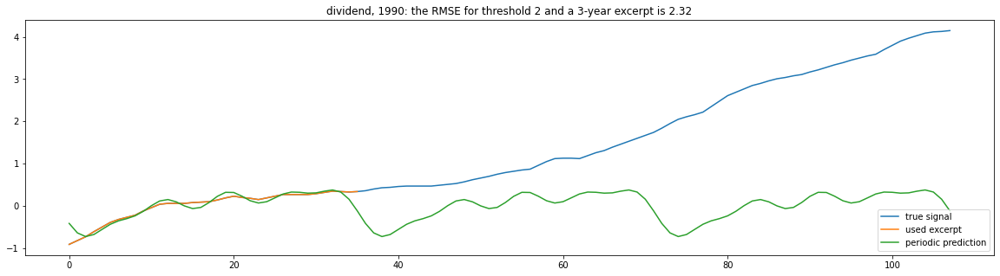

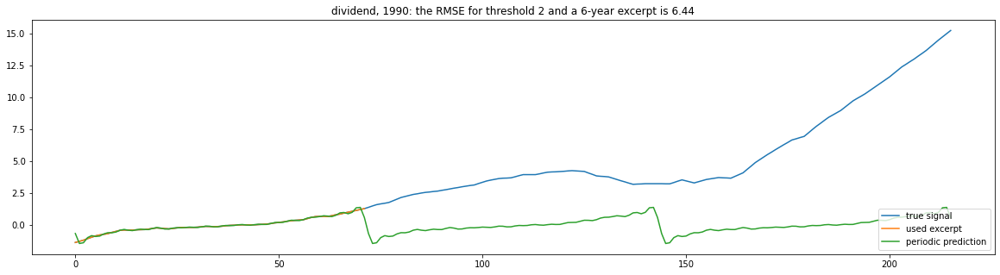

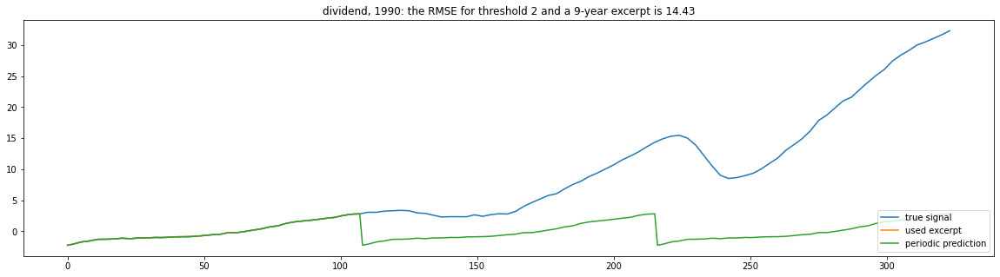

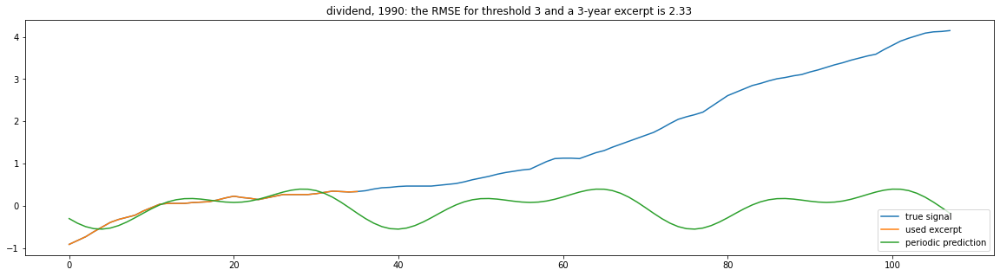

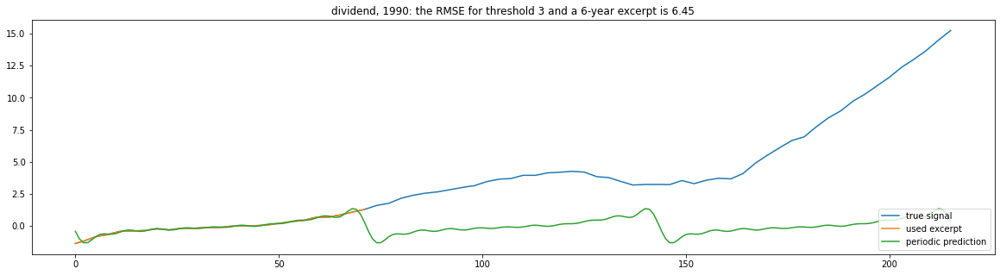

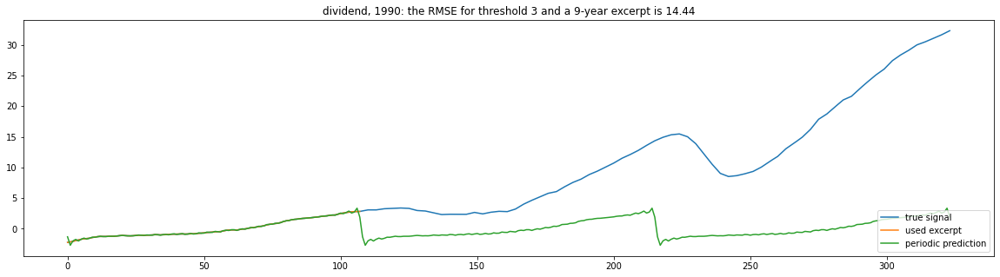

***********************
*** Start at year: 1940***
***********************


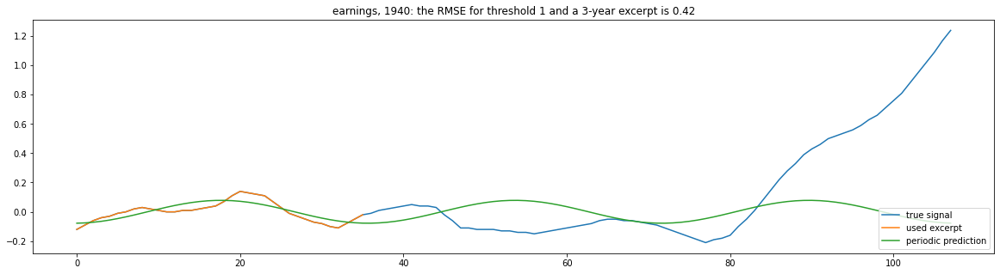

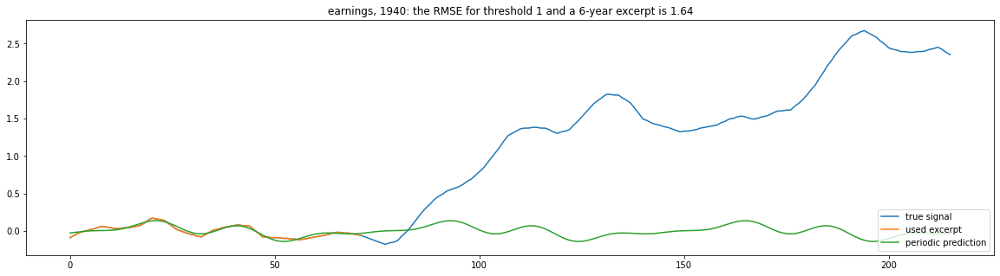

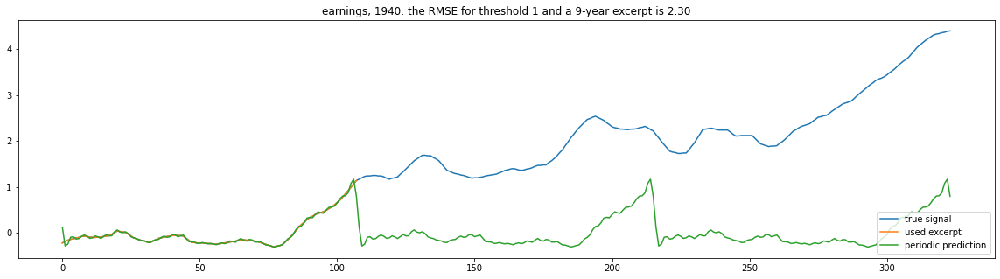

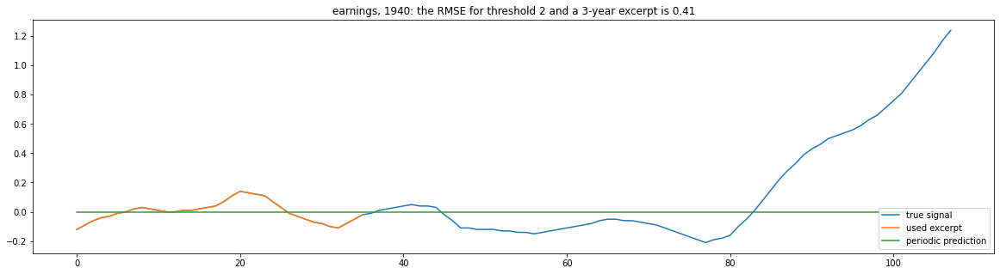

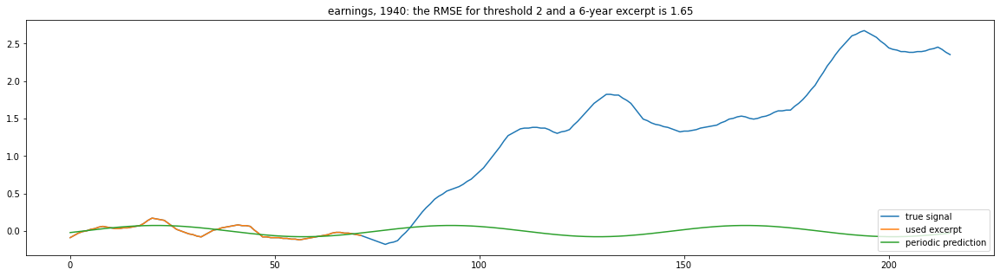

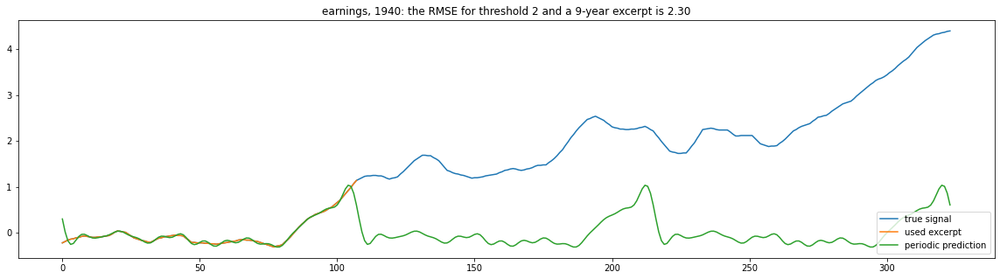

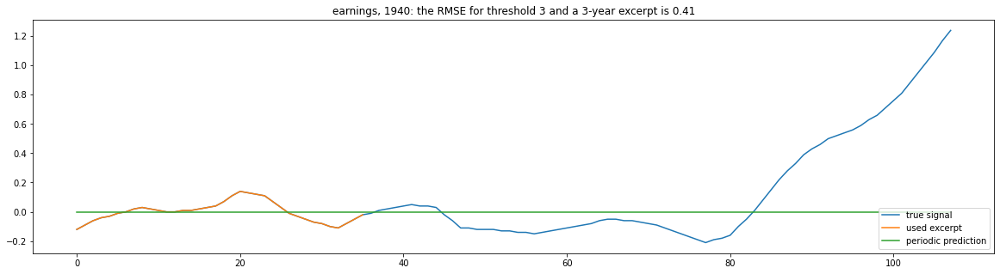

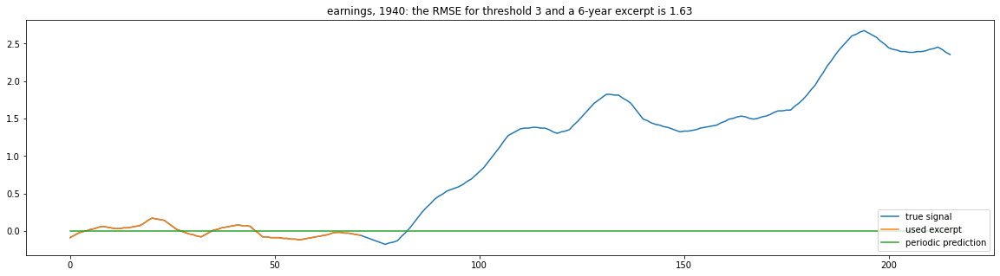

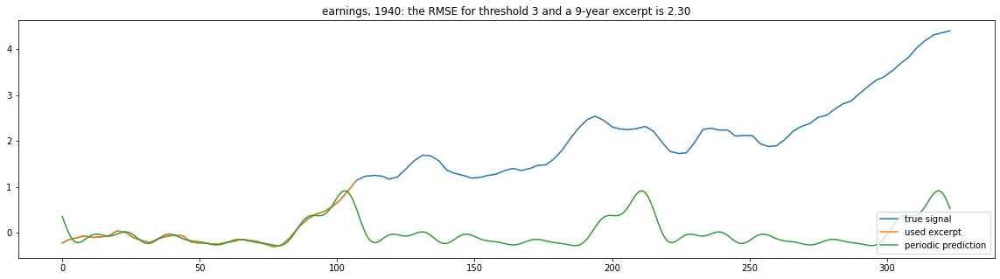

***********************
*** Start at year: 1950***
***********************


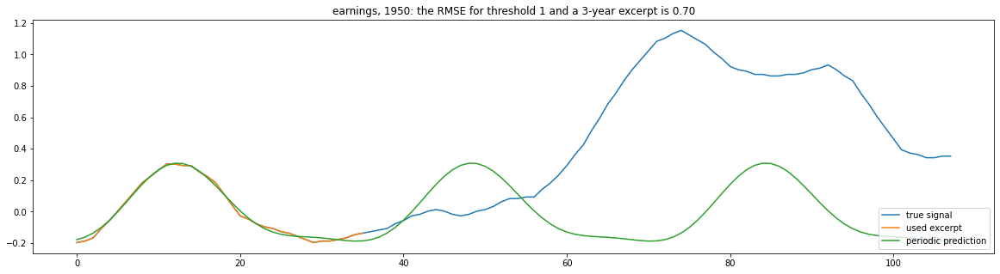

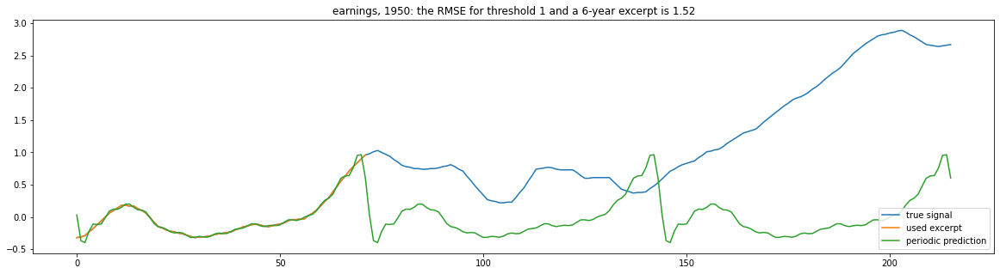

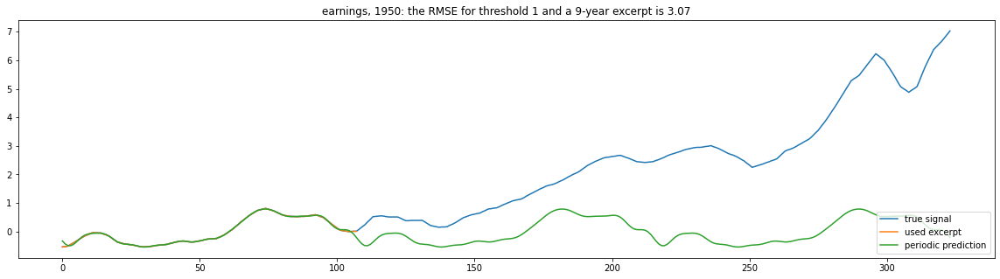

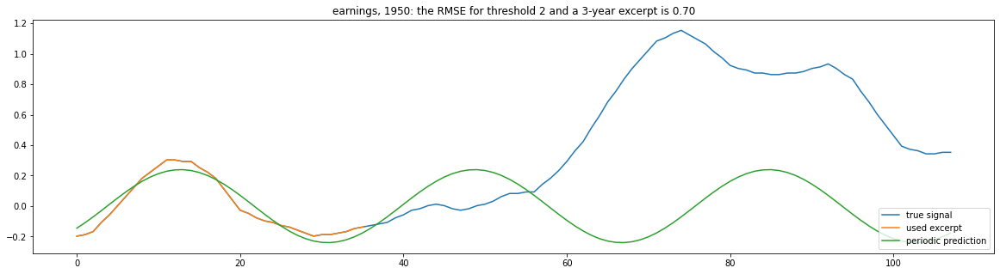

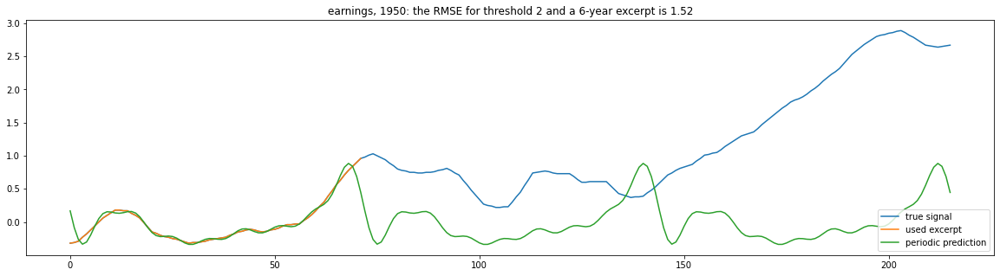

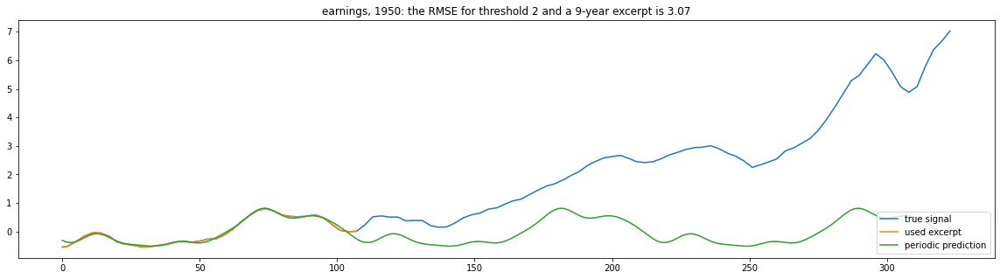

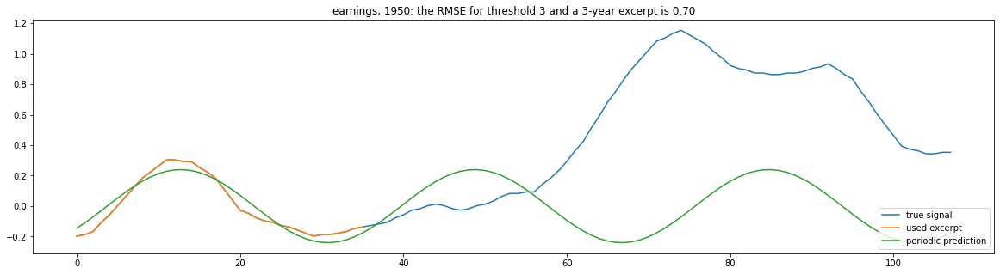

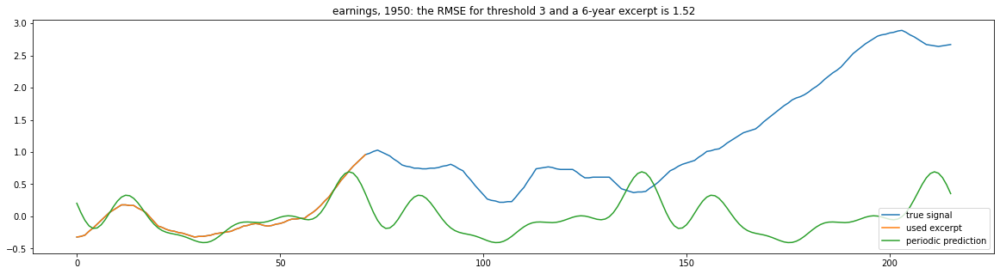

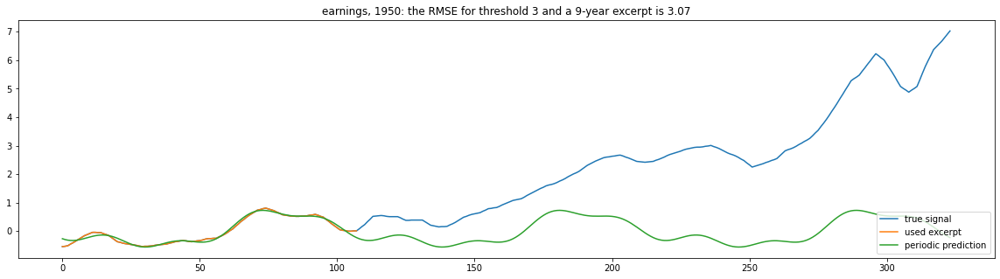

***********************
*** Start at year: 1960***
***********************


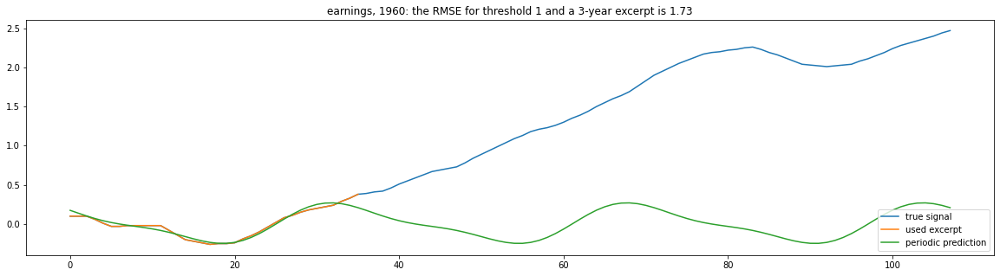

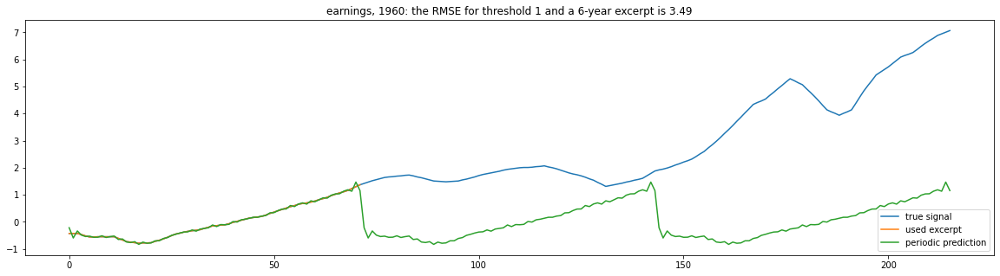

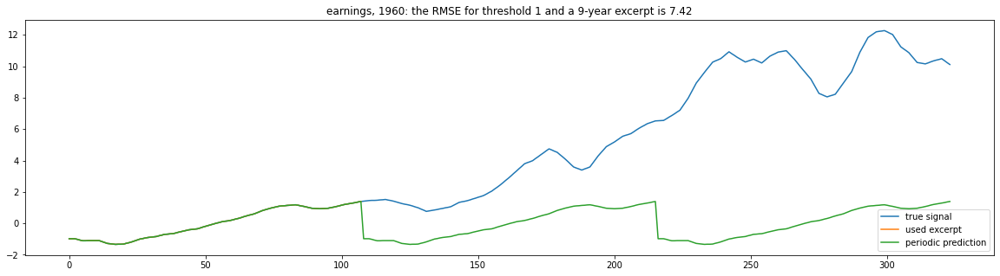

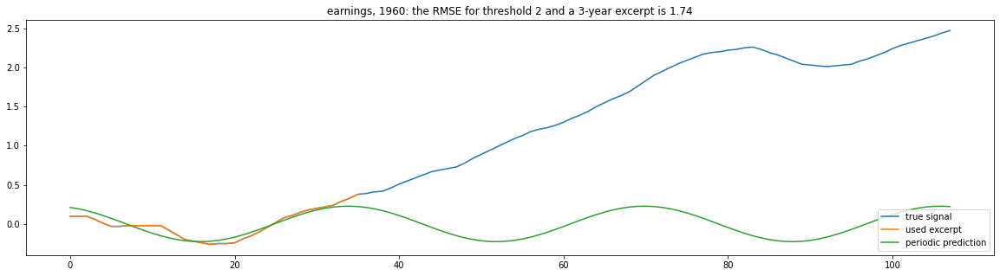

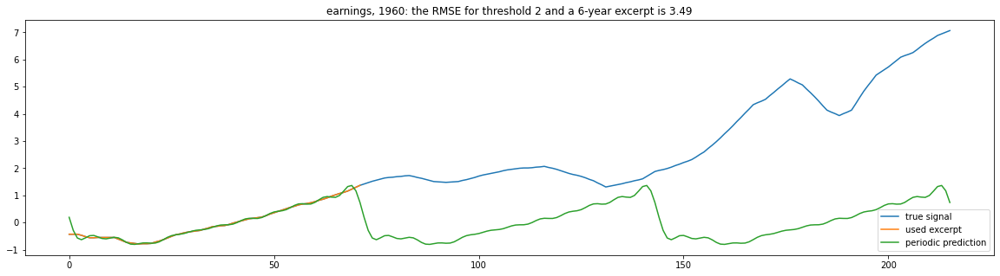

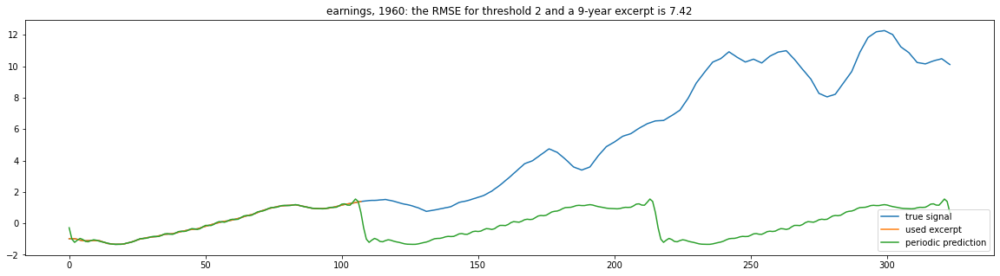

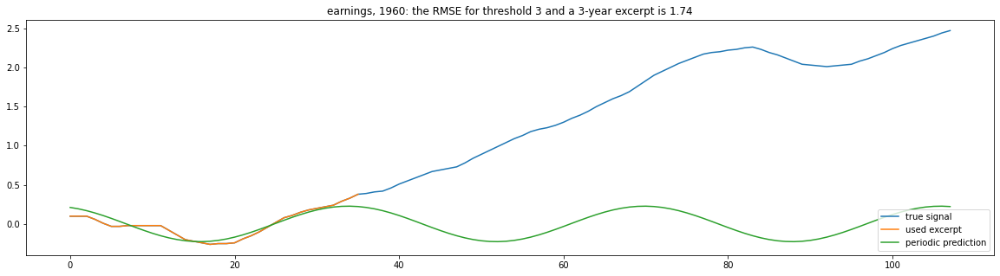

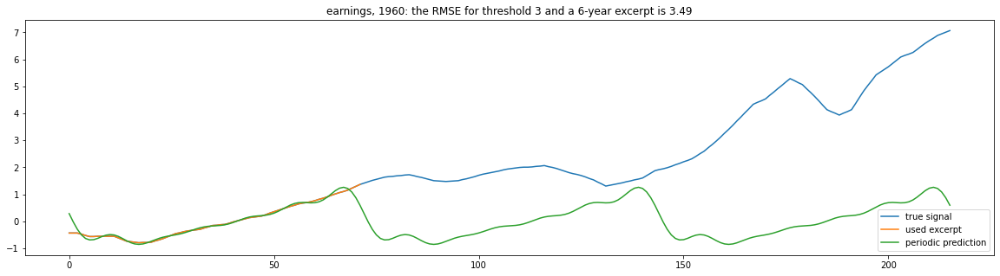

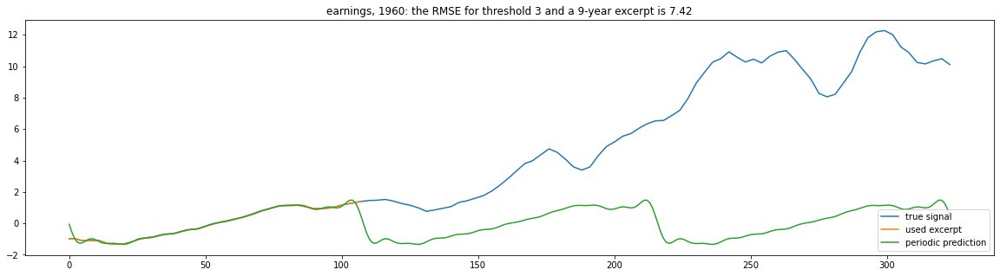

***********************
*** Start at year: 1970***
***********************


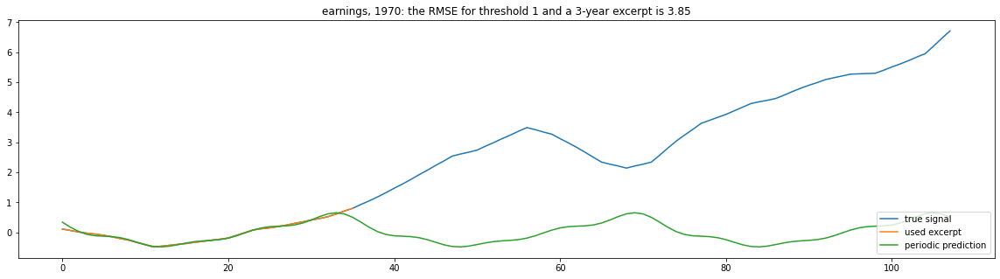

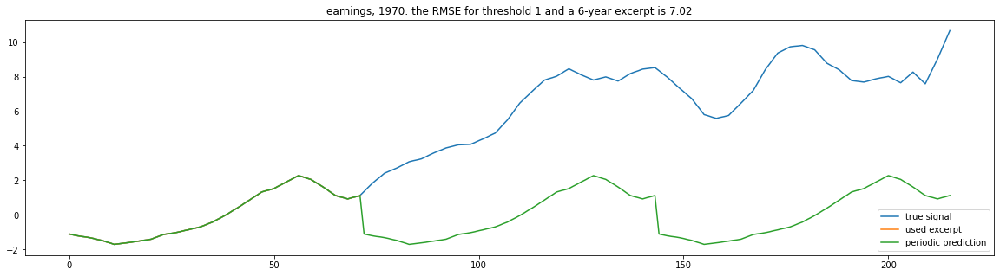

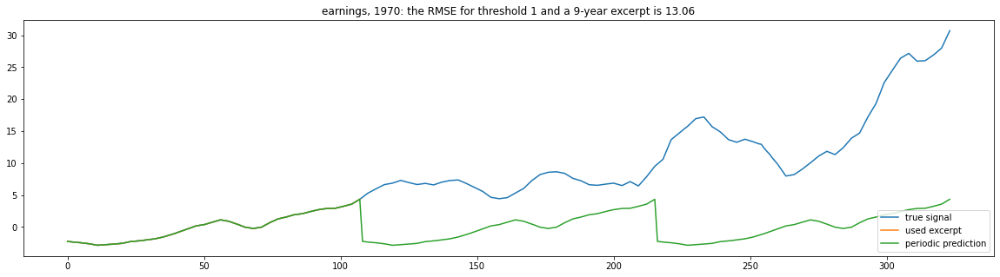

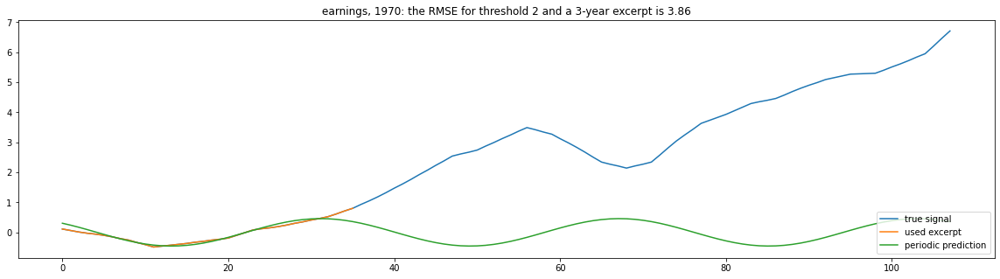

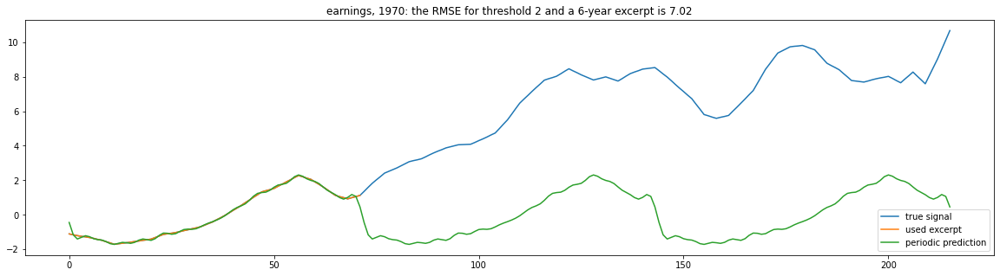

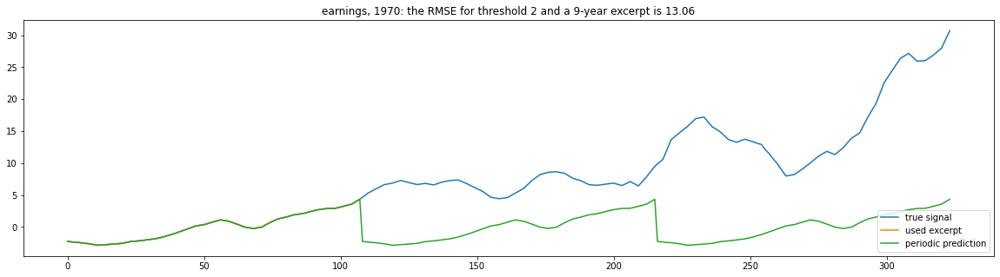

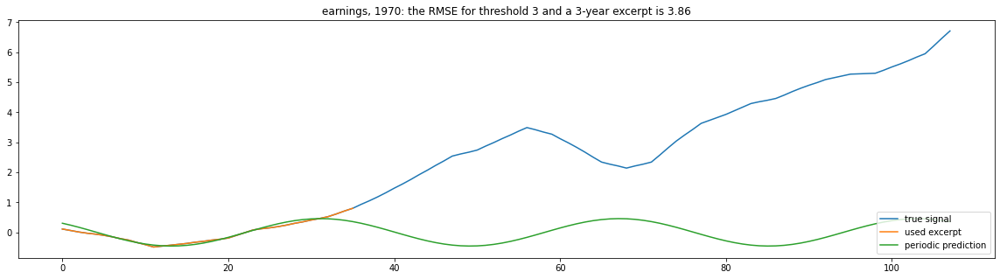

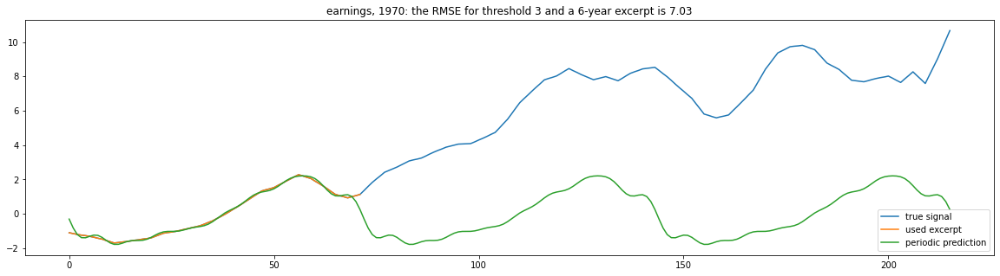

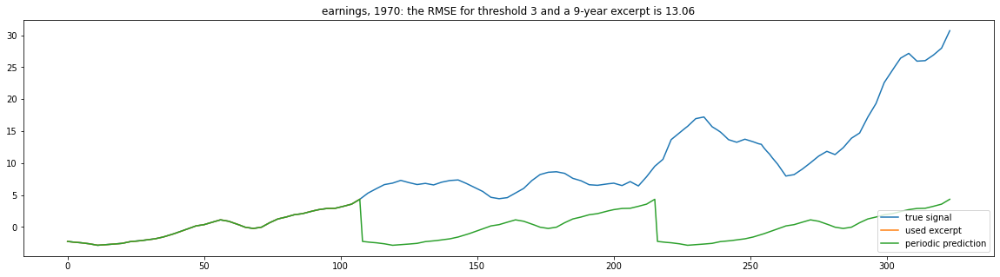

***********************
*** Start at year: 1980***
***********************


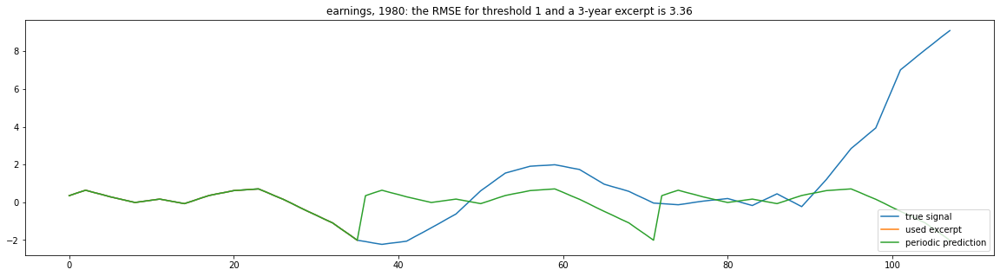

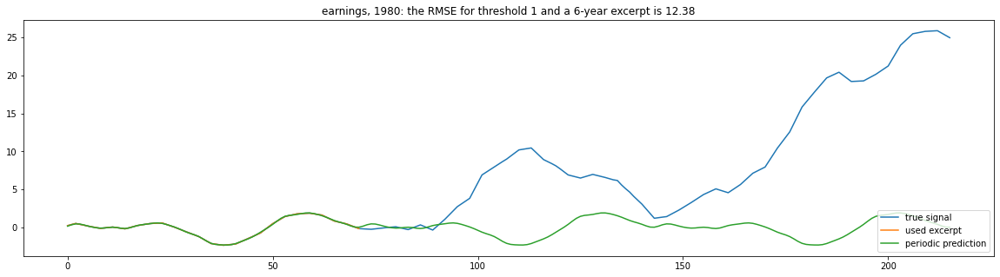

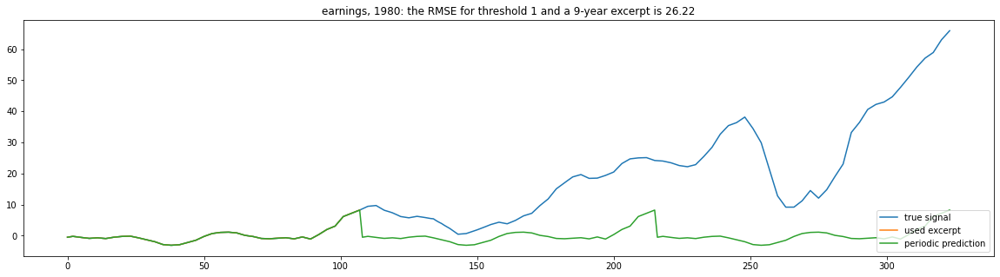

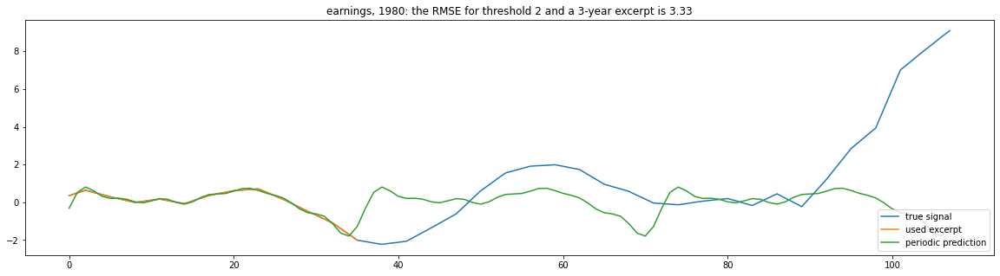

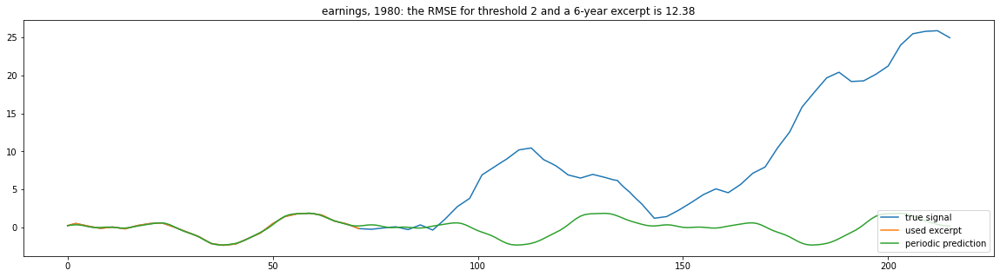

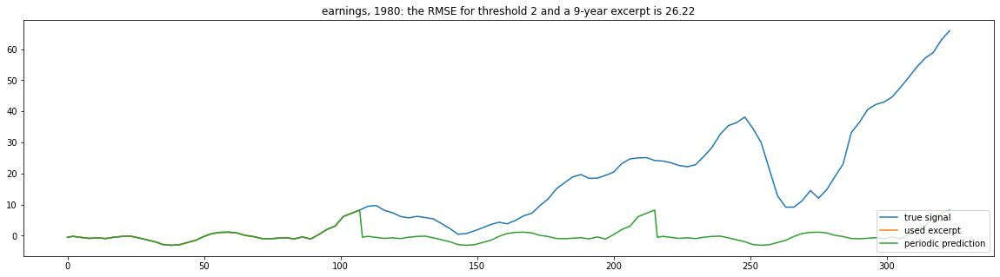

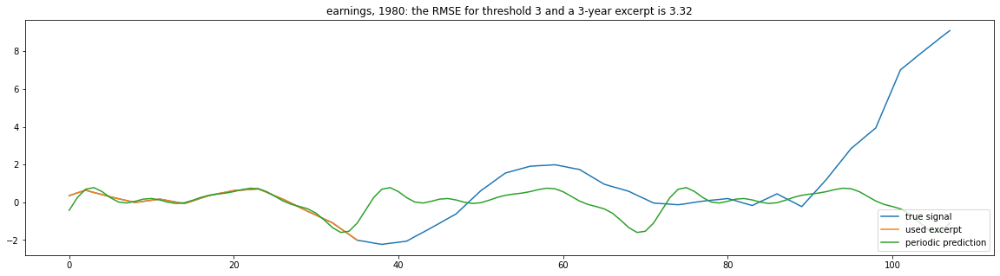

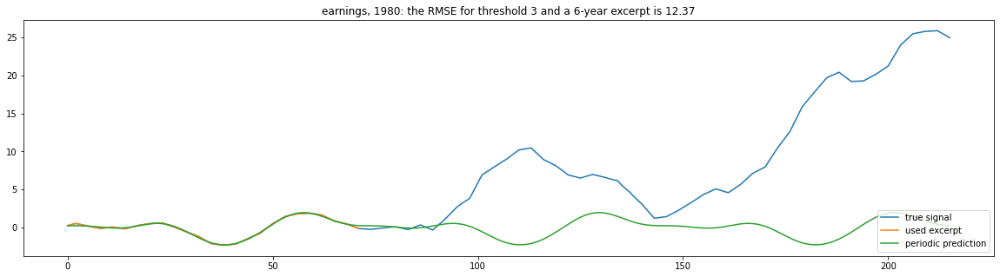

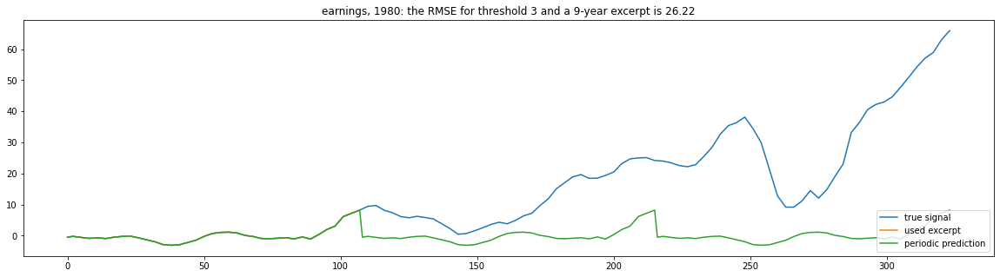

***********************
*** Start at year: 1990***
***********************


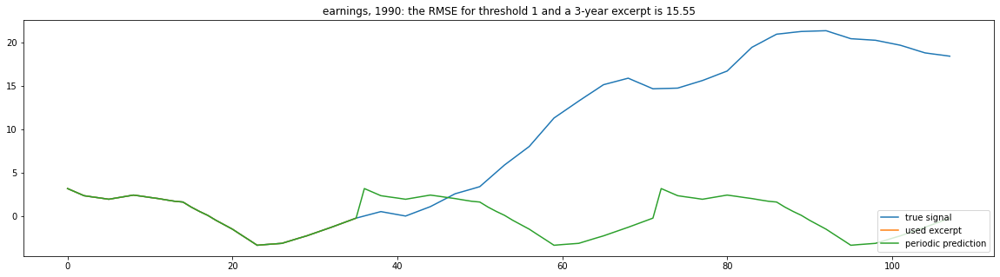

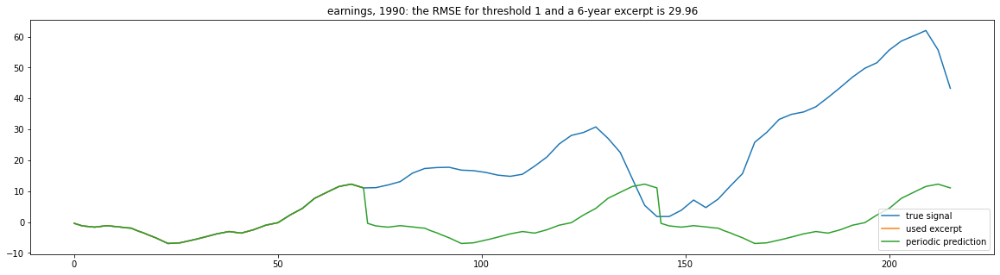

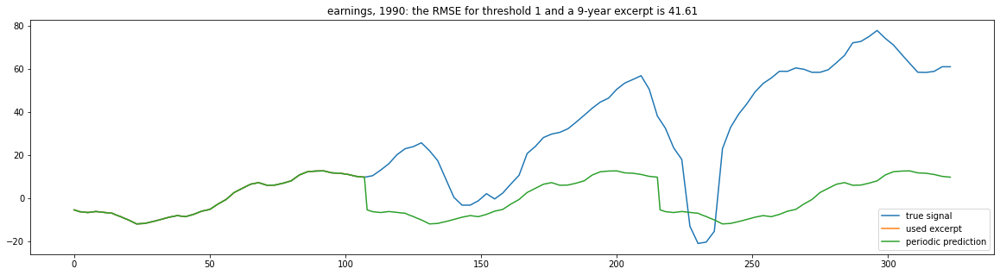

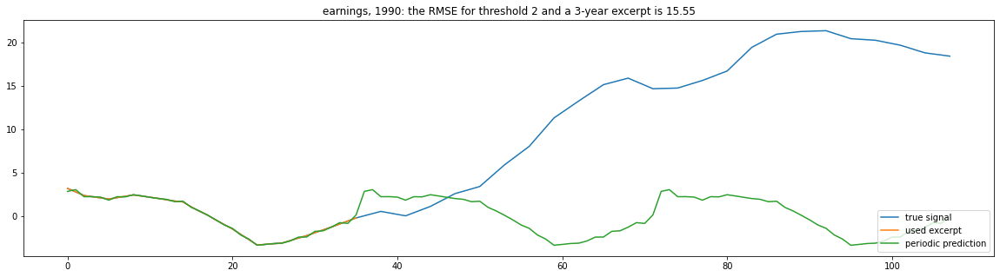

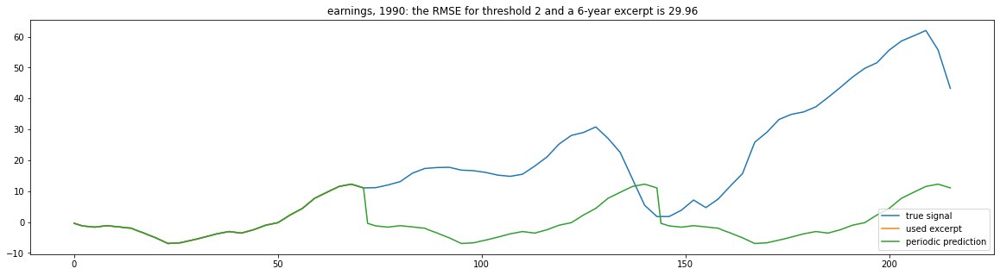

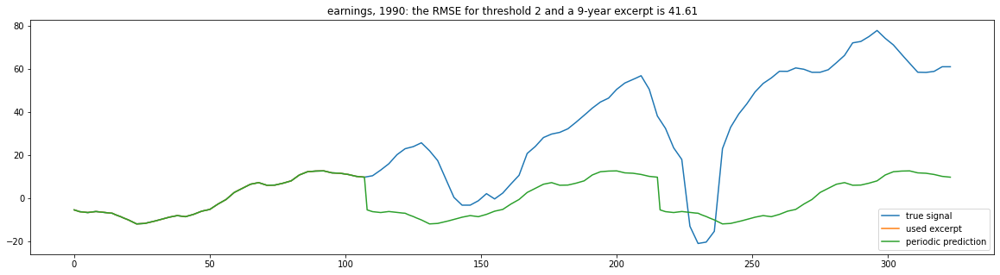

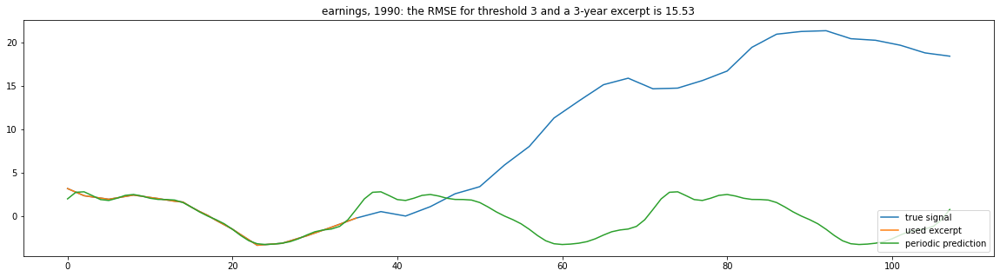

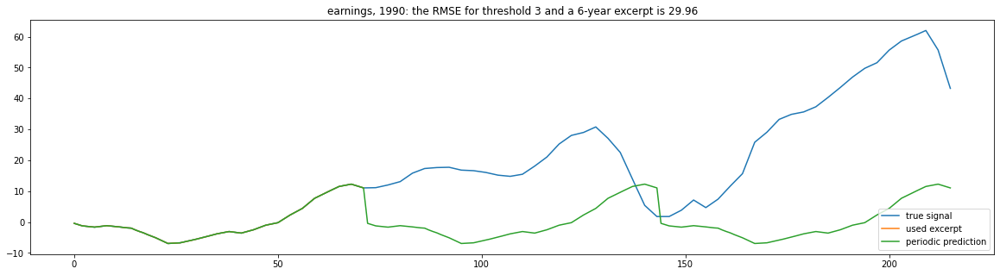

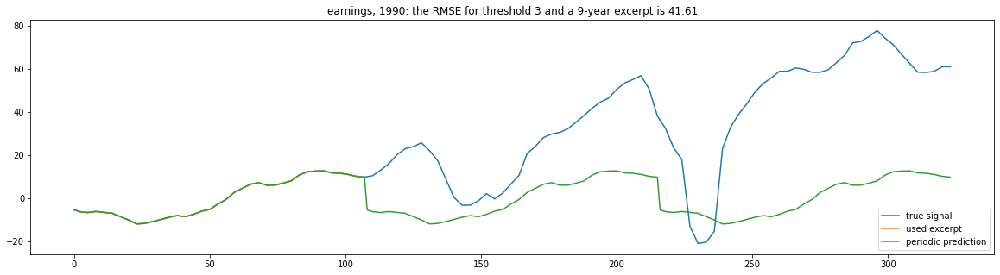

***********************
*** Start at year: 1940***
***********************


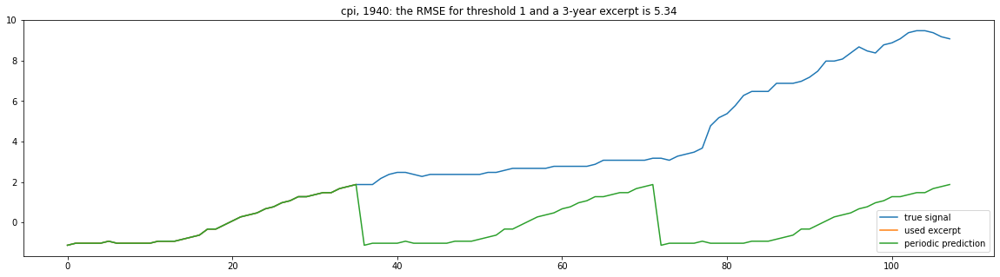

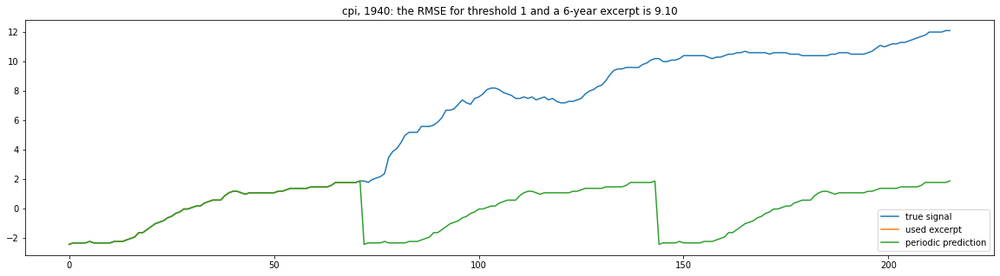

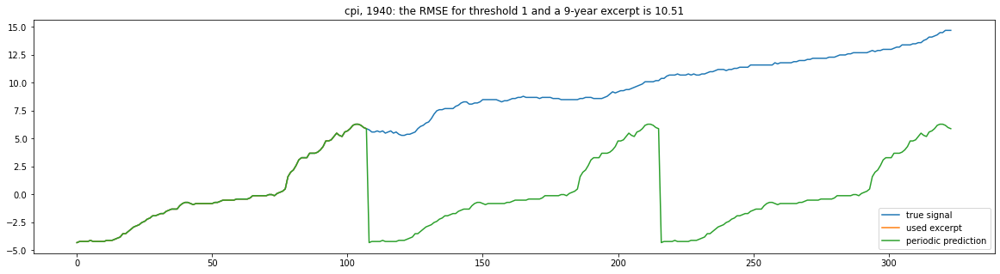

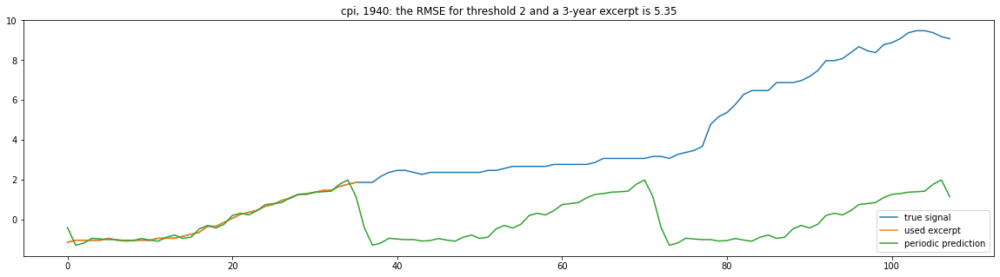

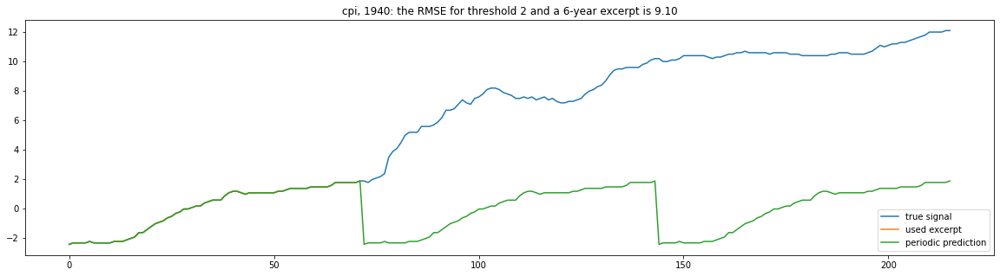

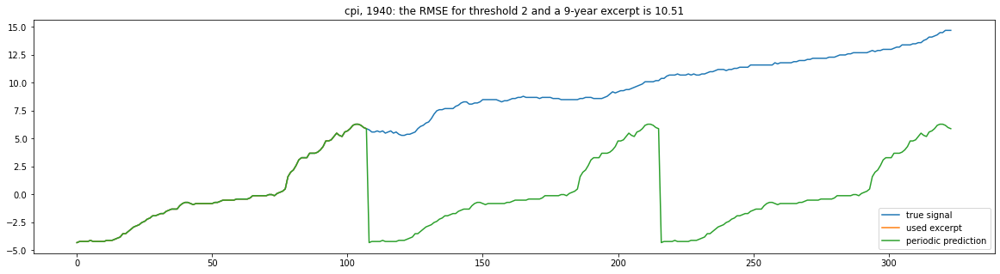

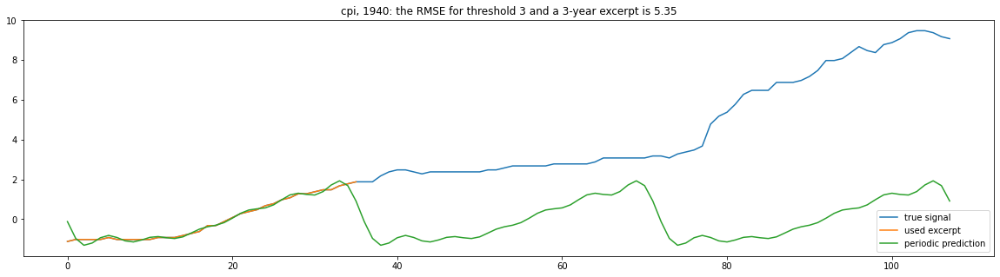

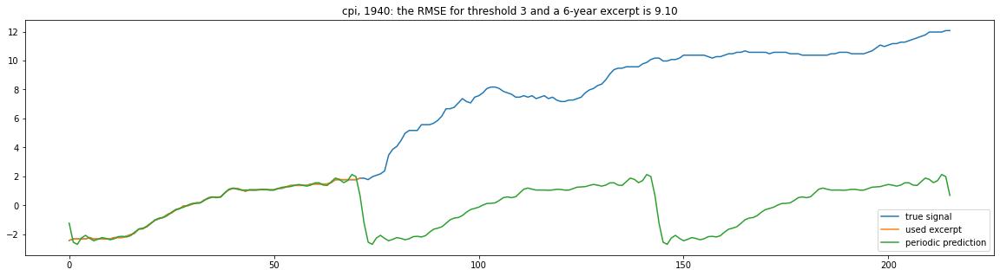

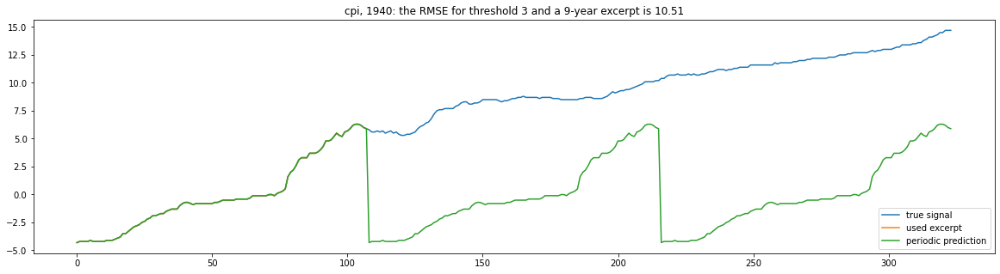

***********************
*** Start at year: 1950***
***********************


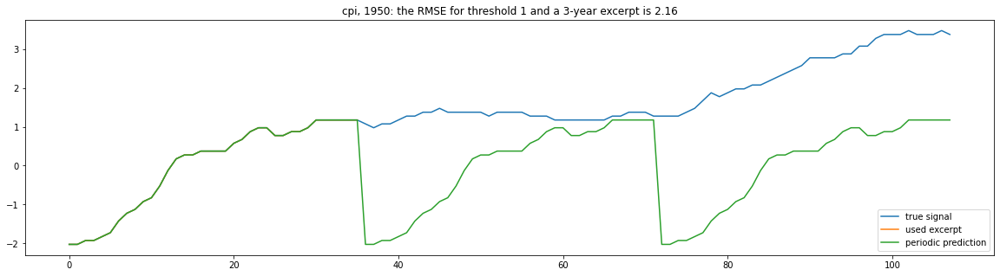

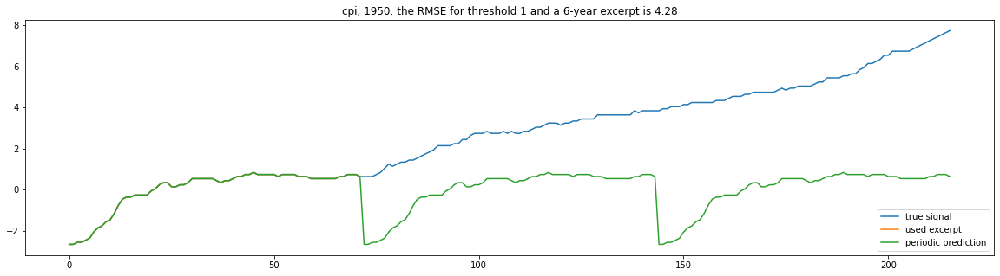

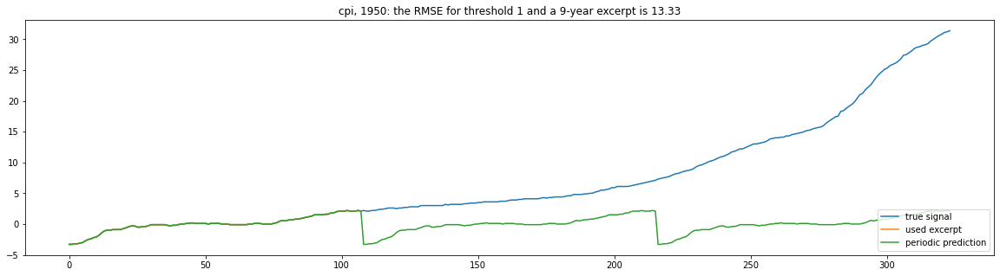

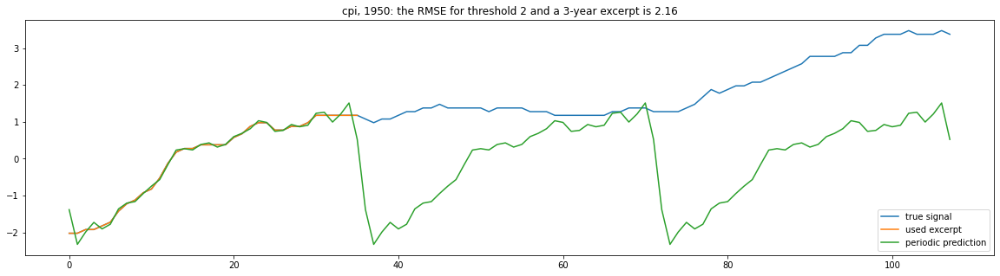

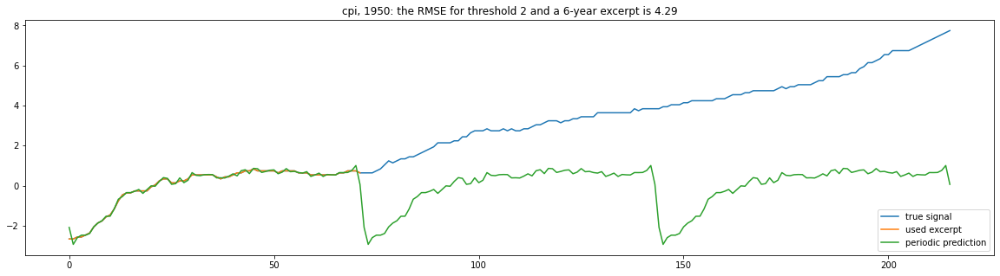

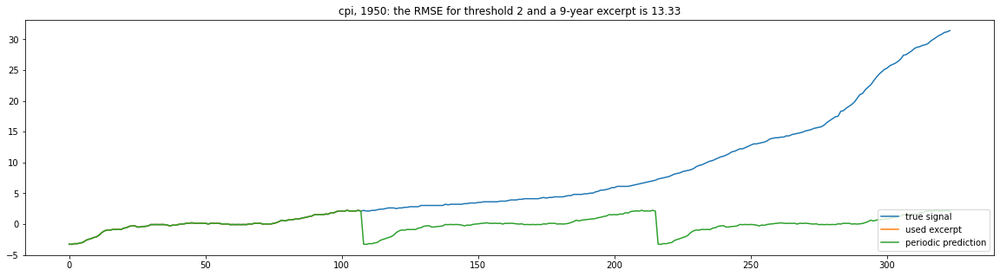

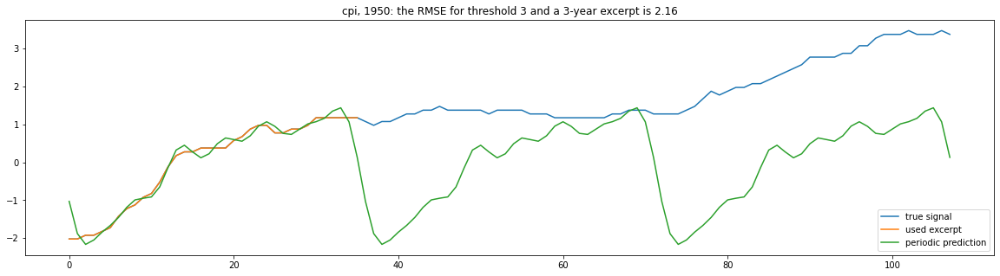

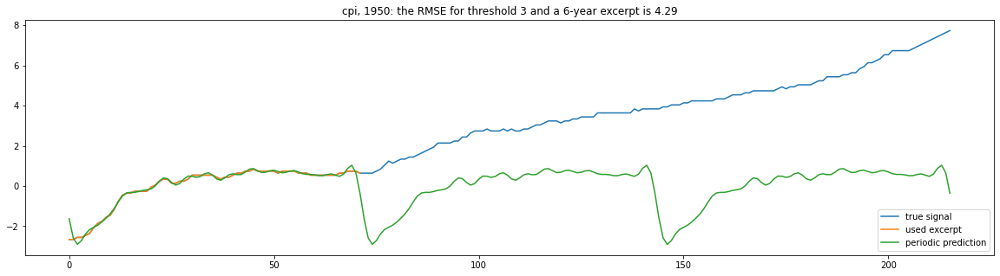

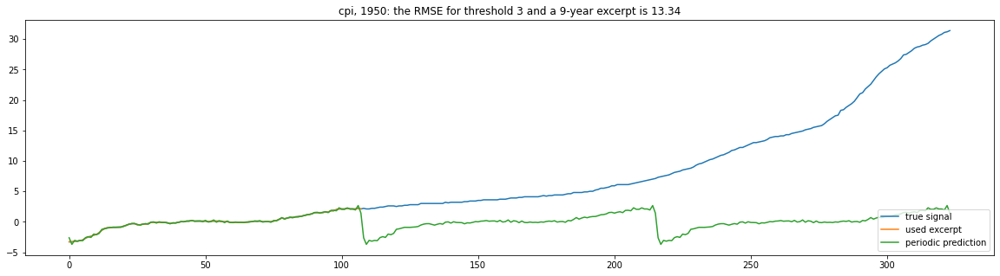

***********************
*** Start at year: 1960***
***********************


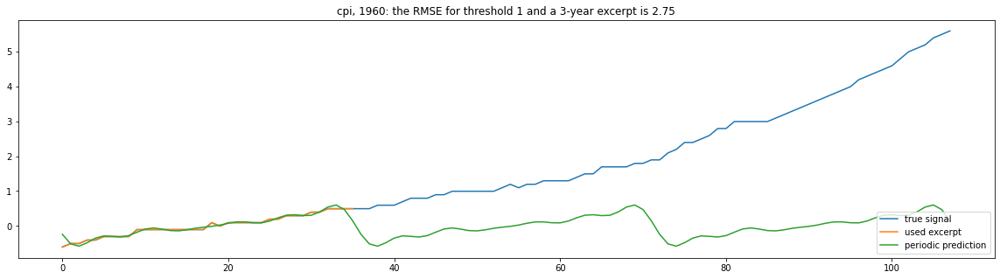

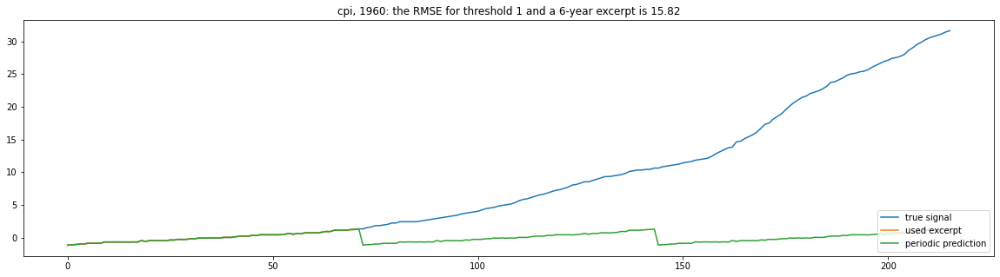

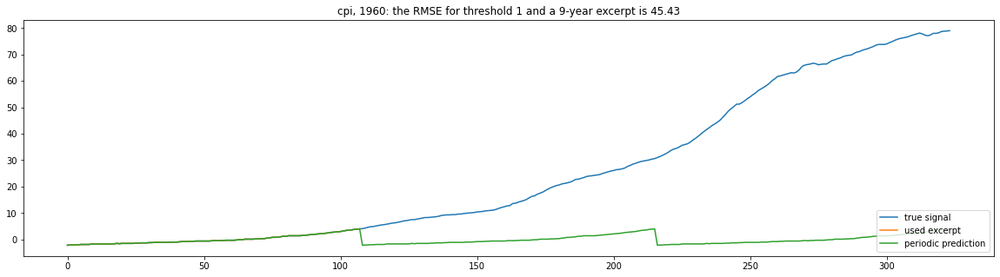

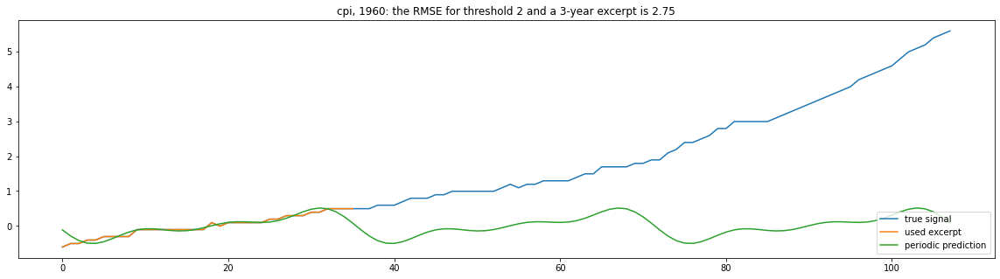

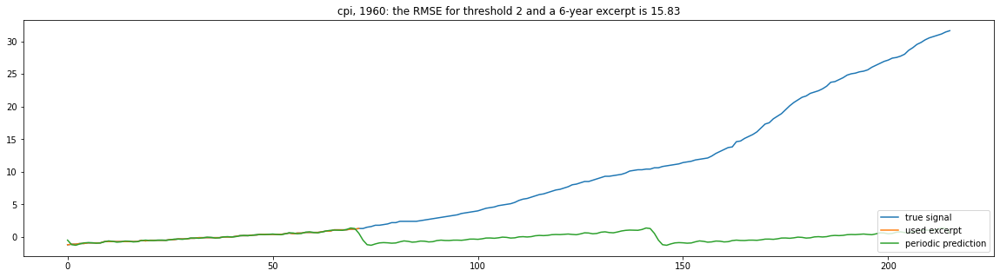

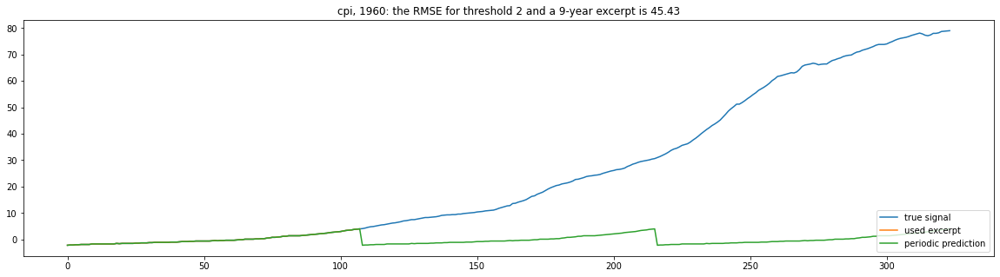

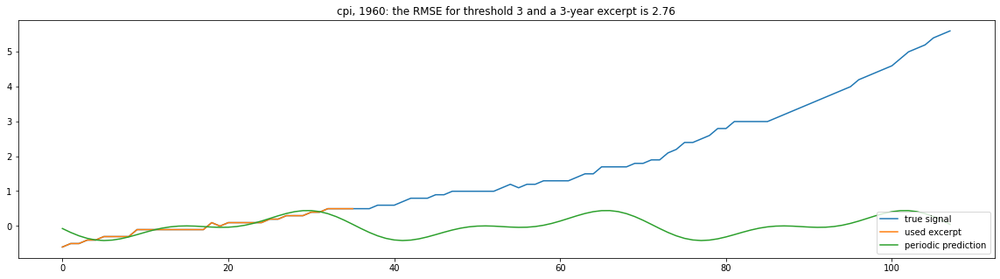

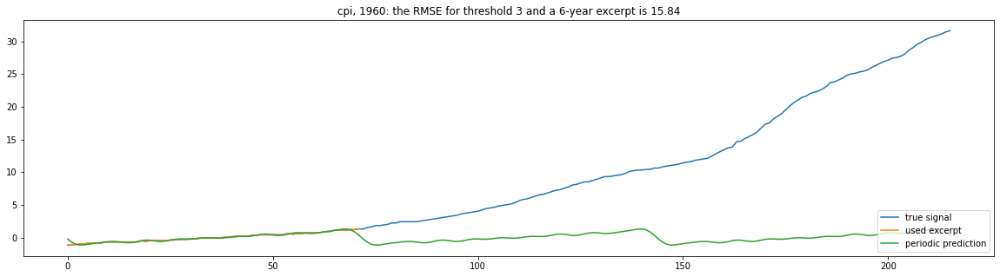

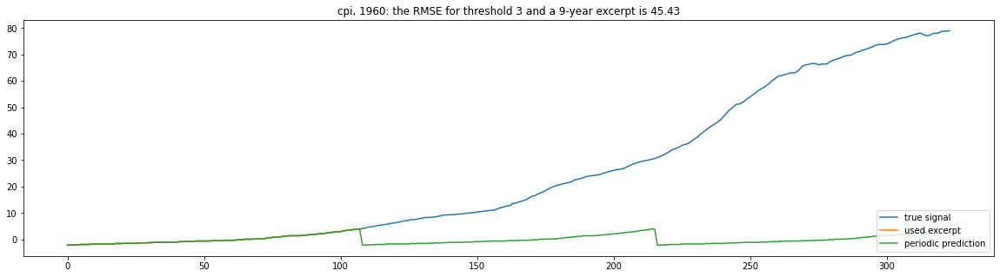

***********************
*** Start at year: 1970***
***********************


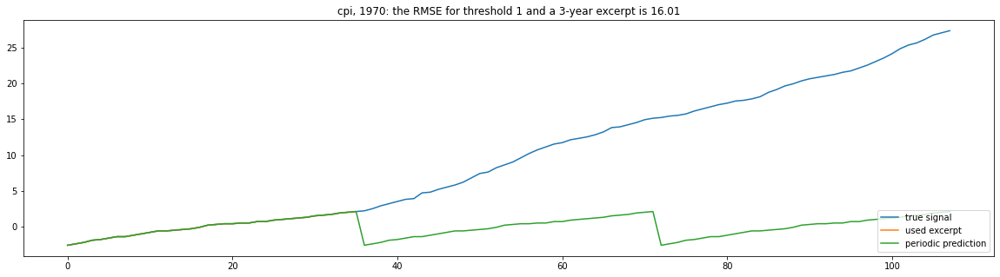

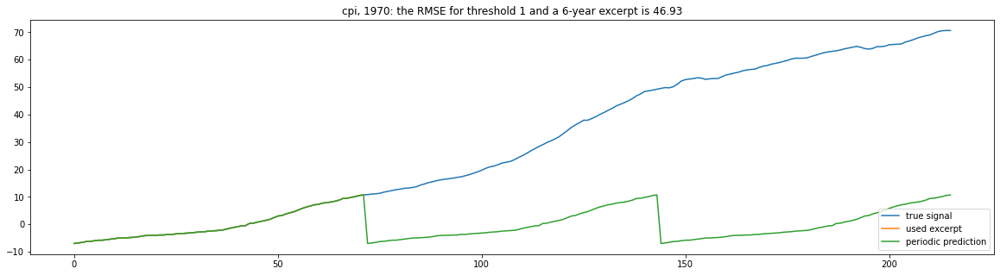

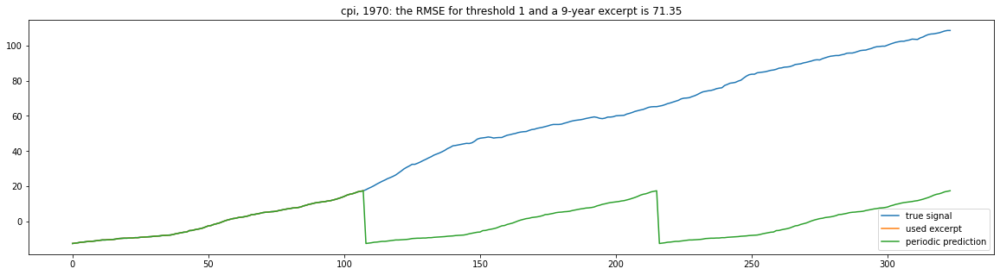

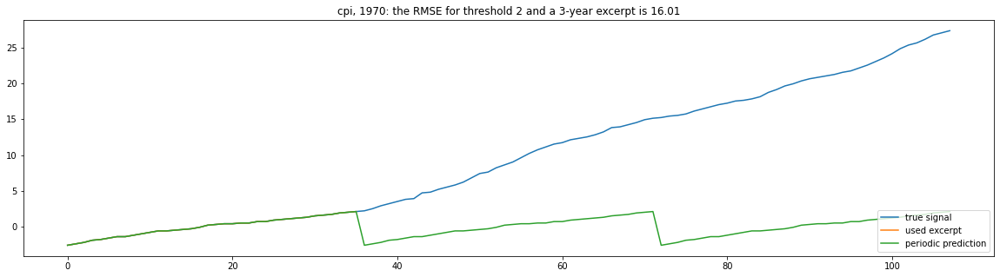

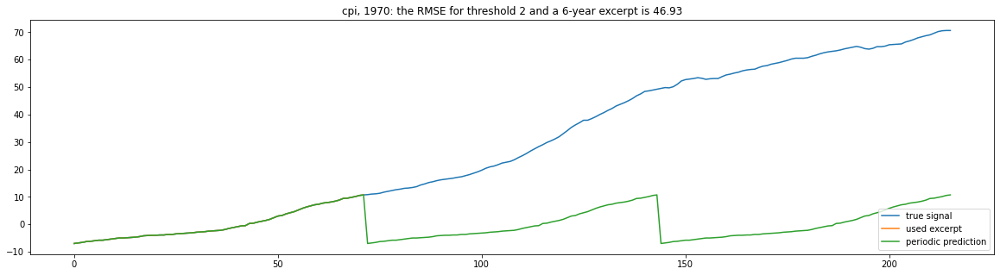

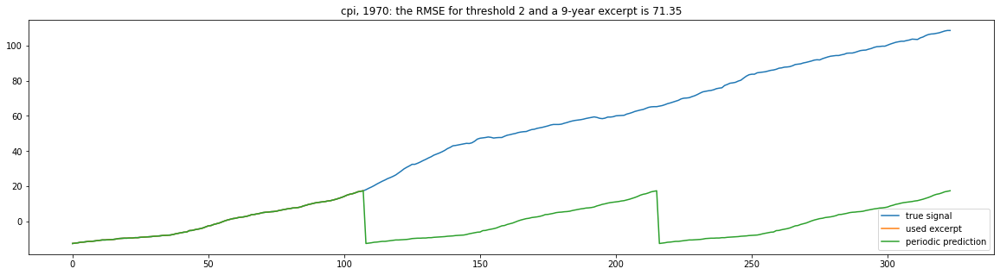

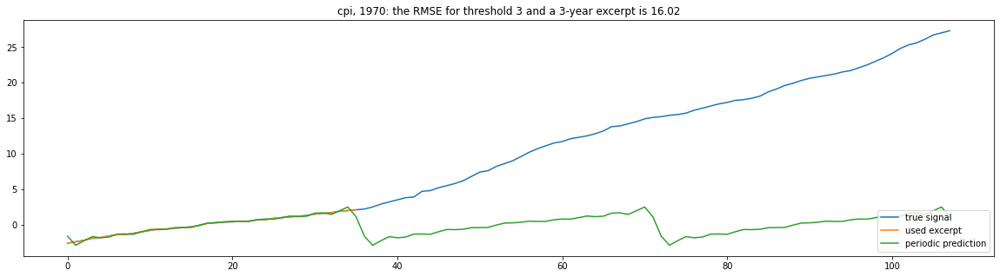

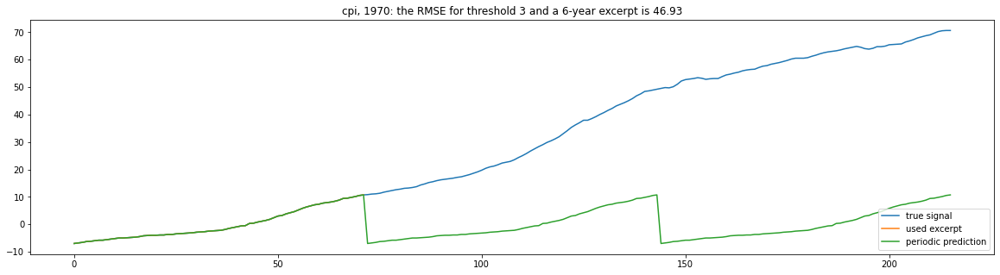

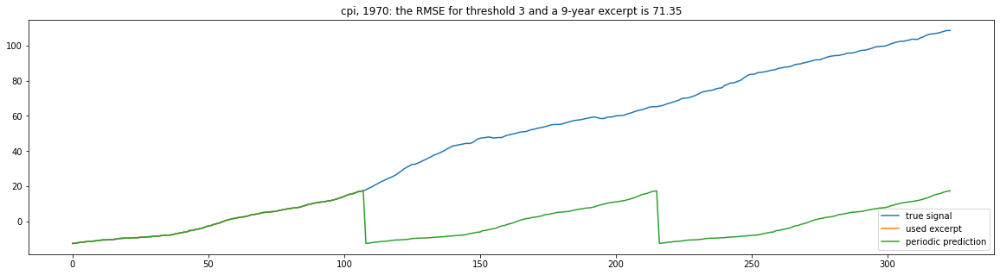

***********************
*** Start at year: 1980***
***********************


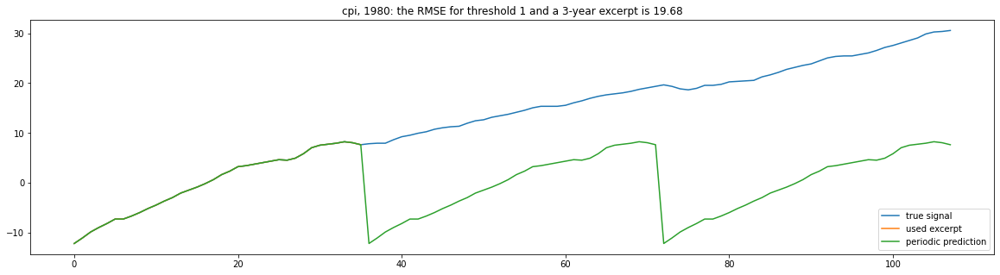

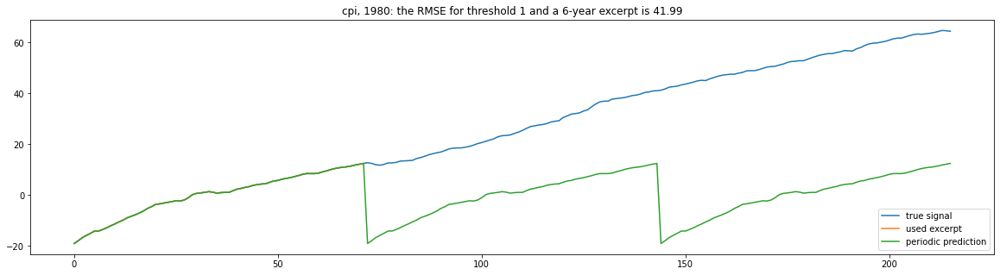

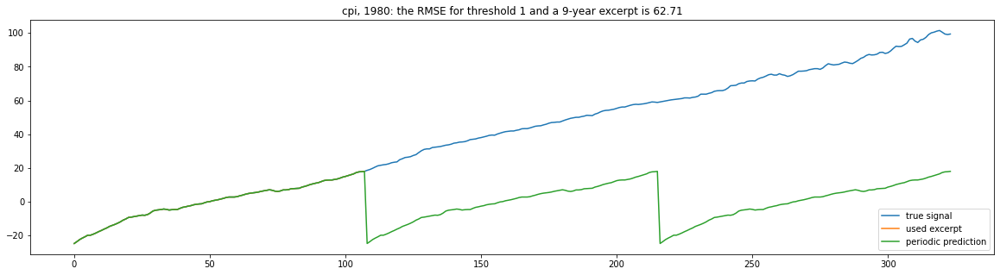

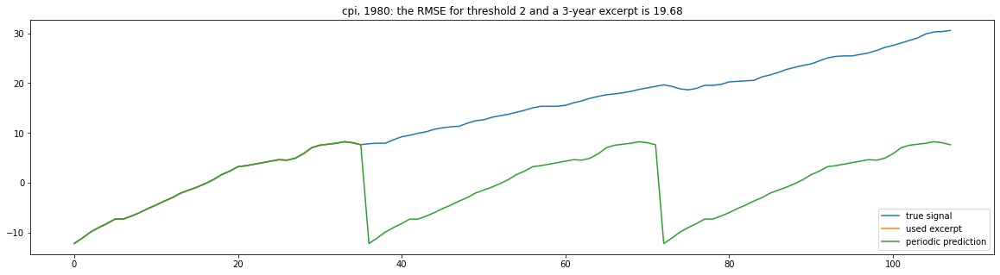

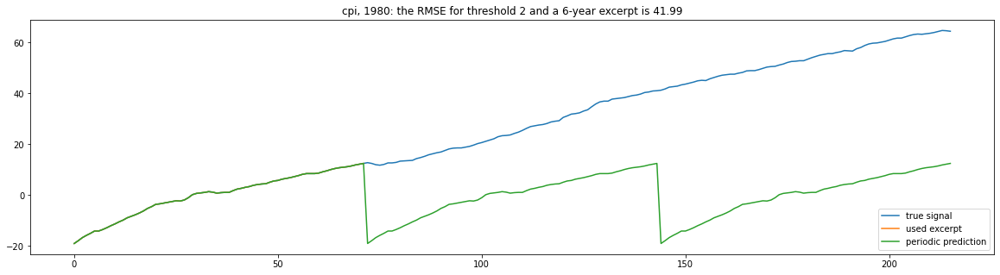

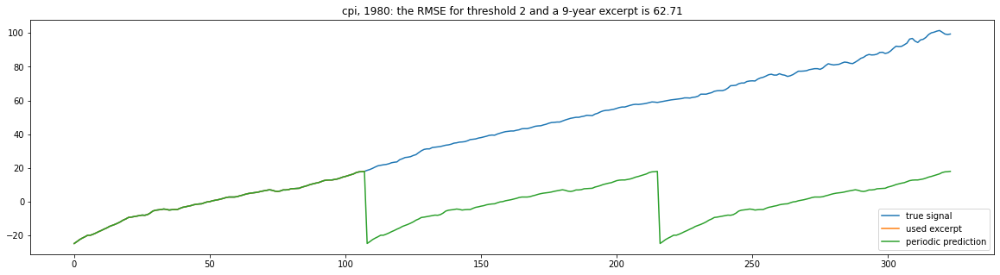

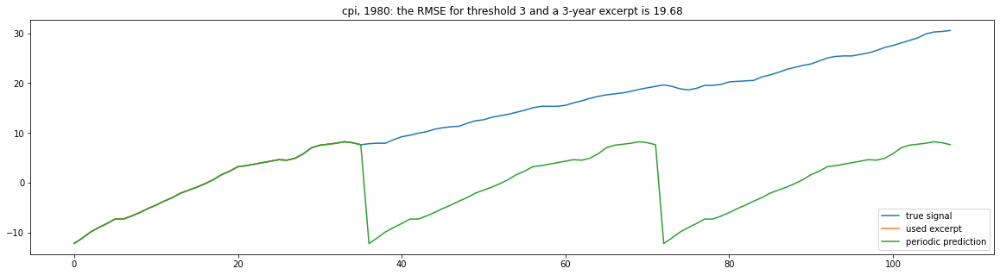

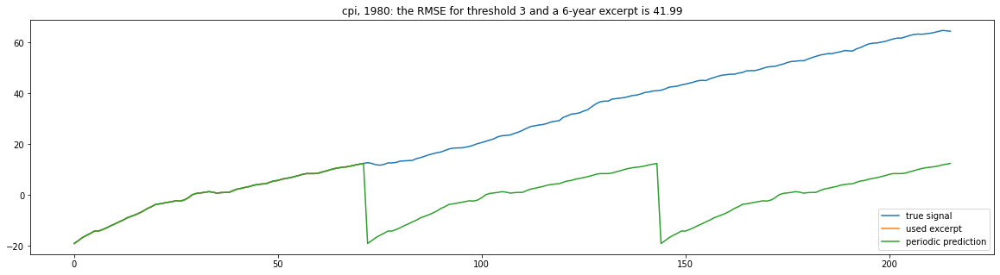

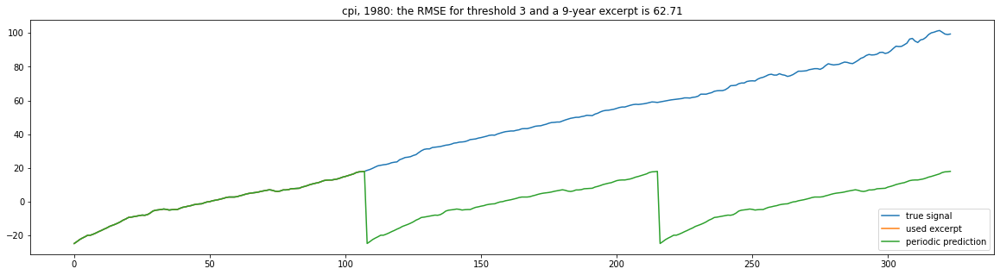

***********************
*** Start at year: 1990***
***********************


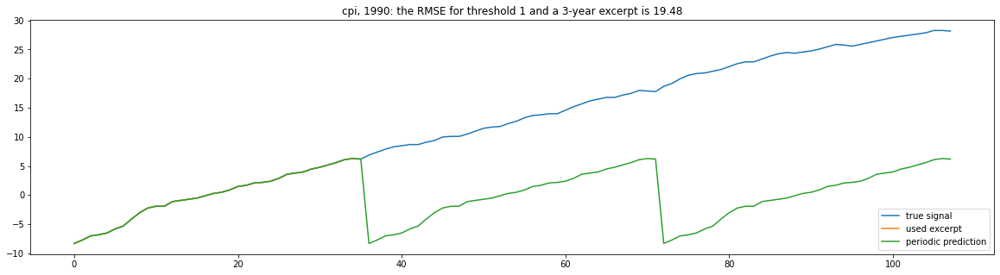

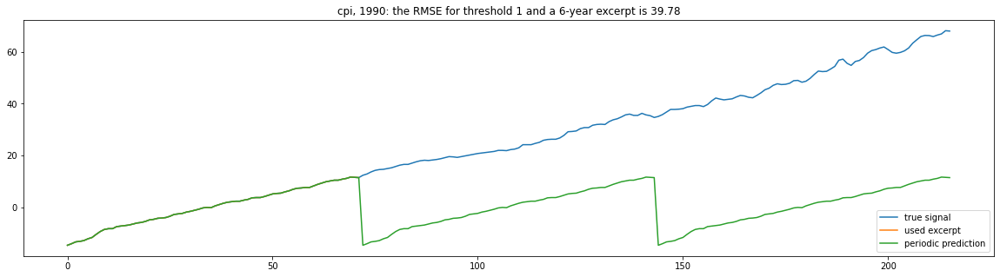

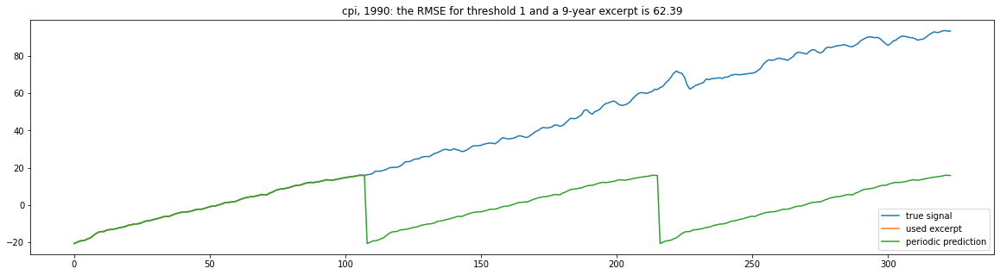

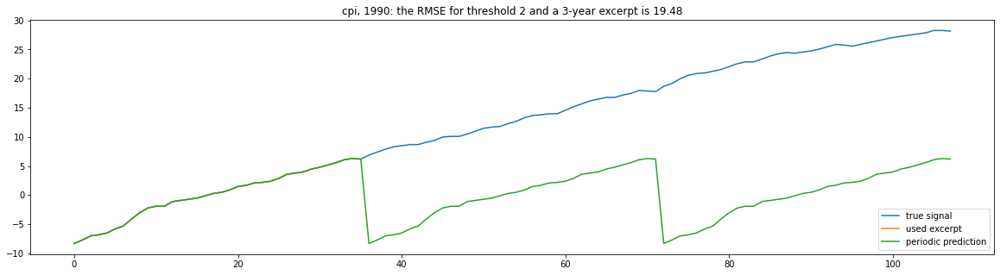

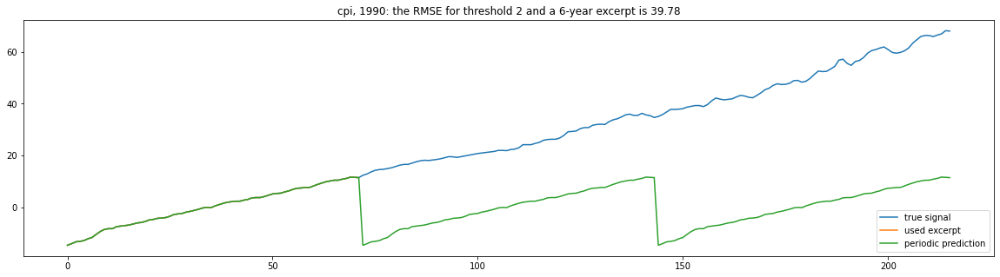

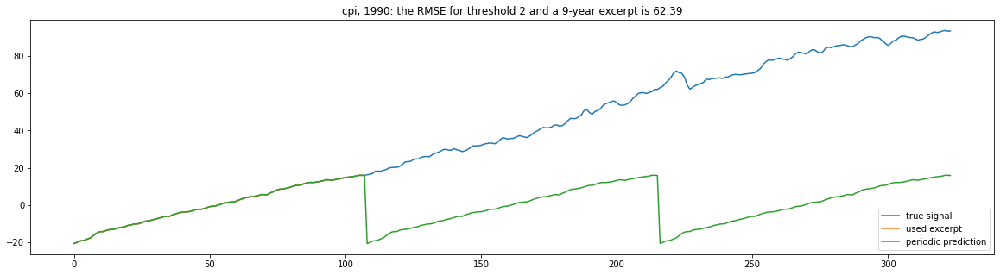

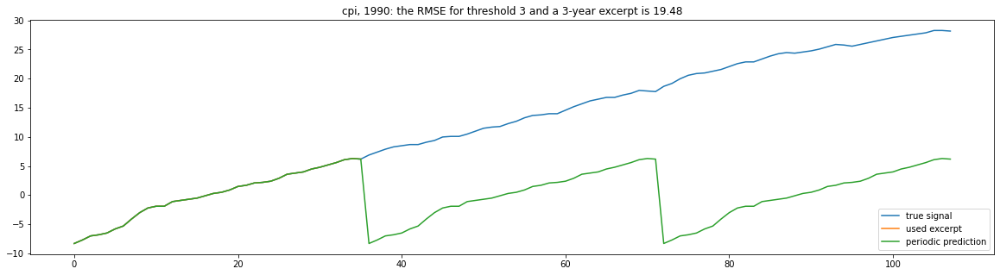

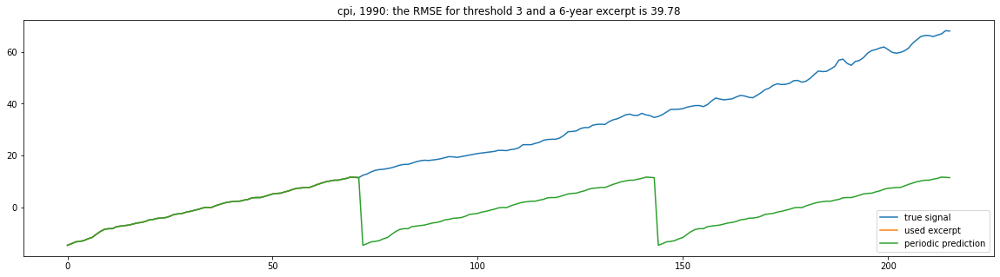

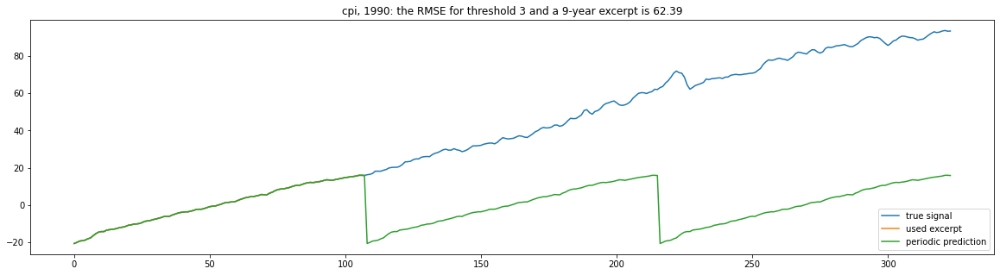

***********************
*** Start at year: 1940***
***********************


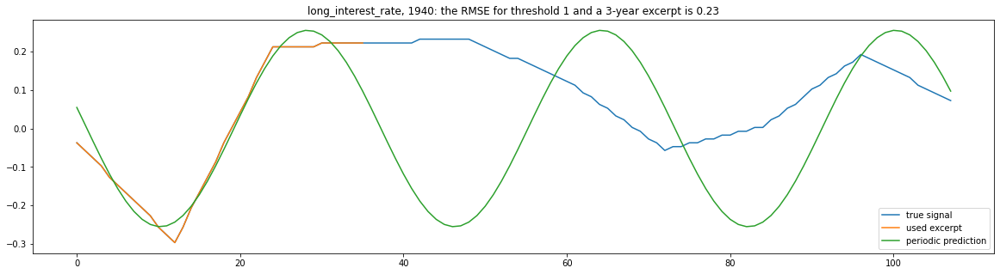

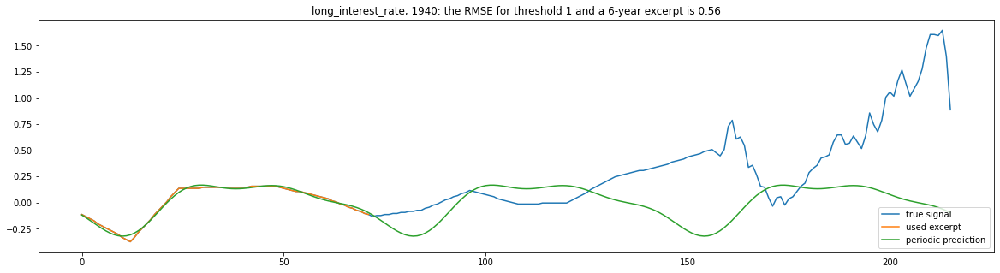

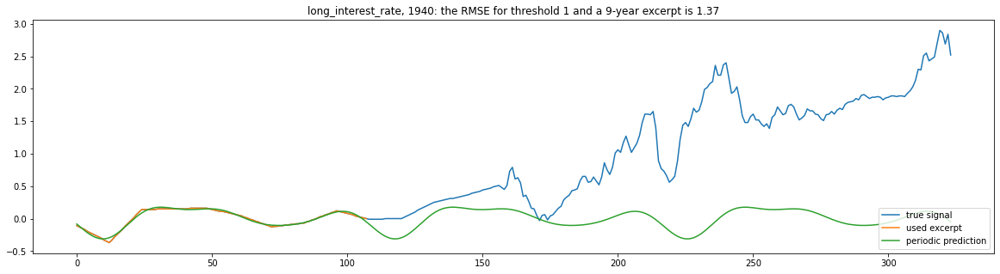

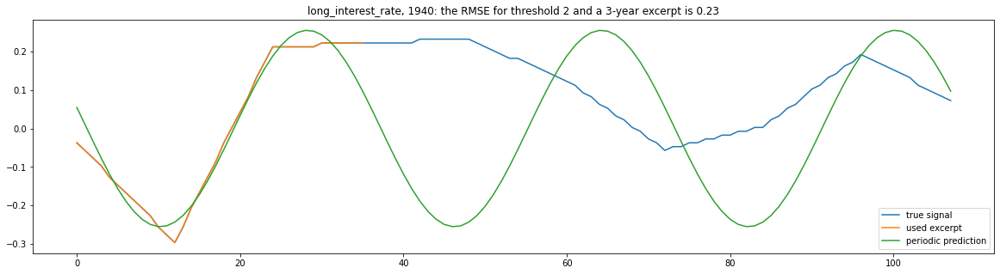

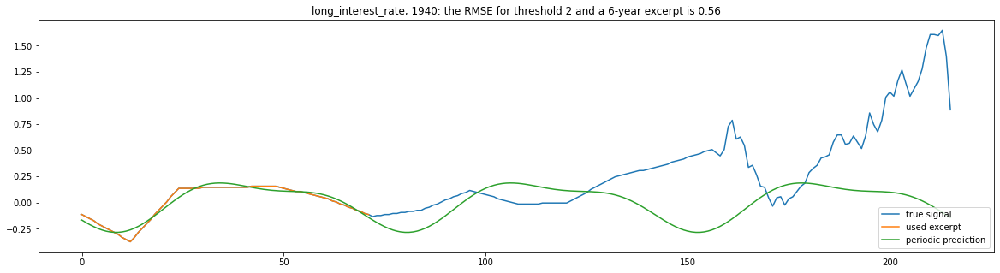

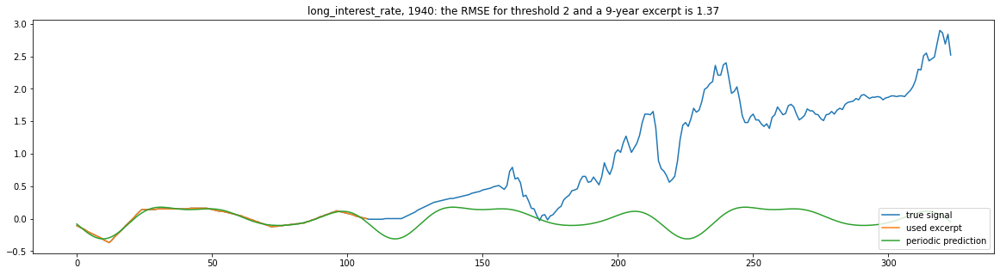

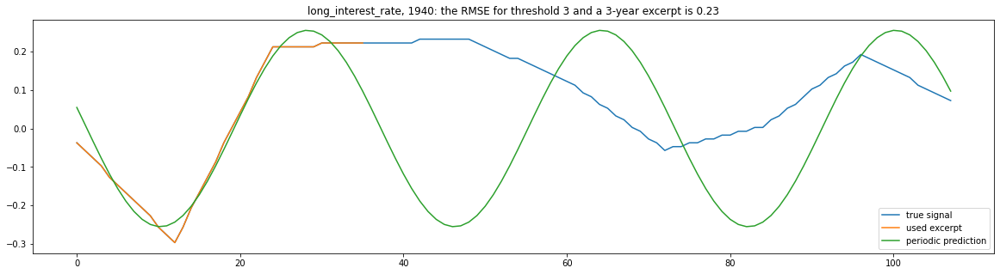

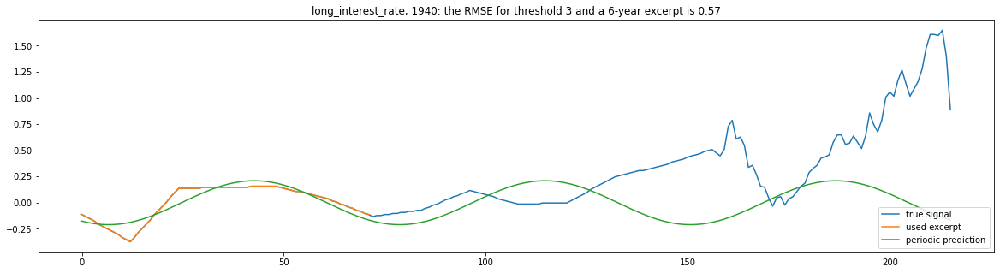

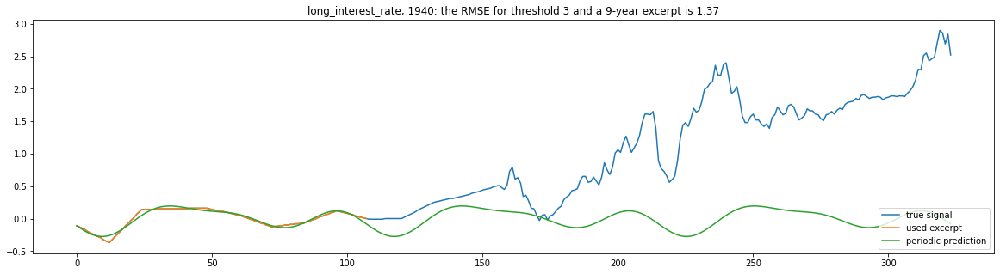

***********************
*** Start at year: 1950***
***********************


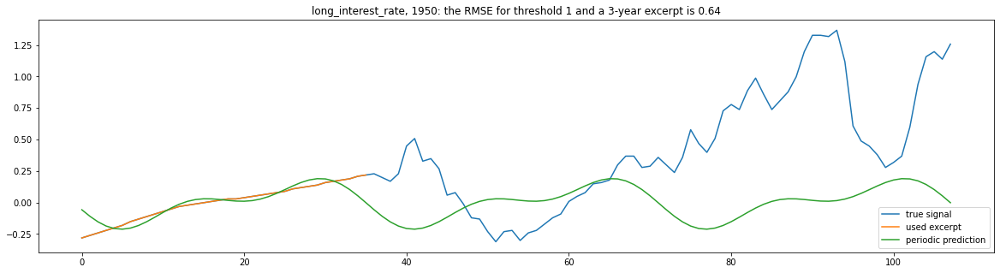

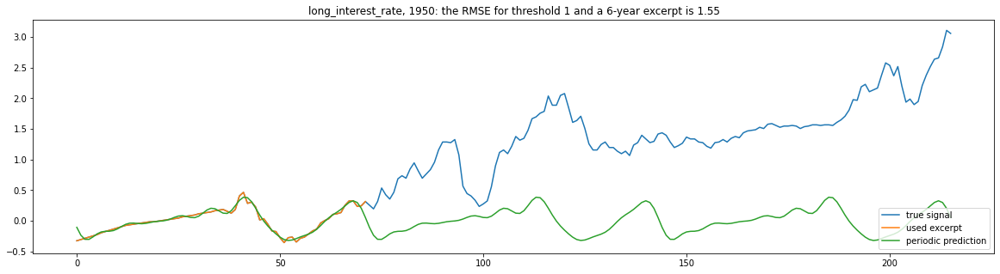

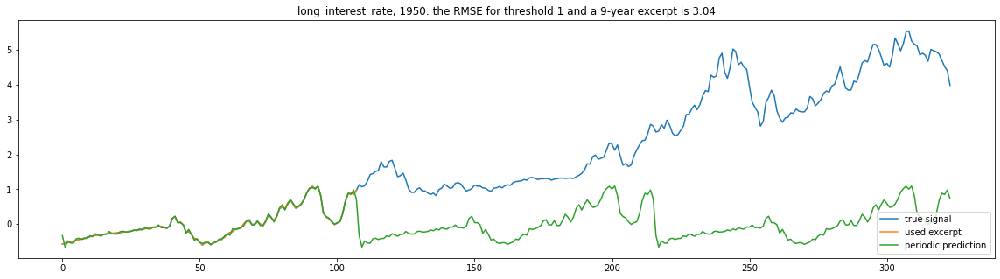

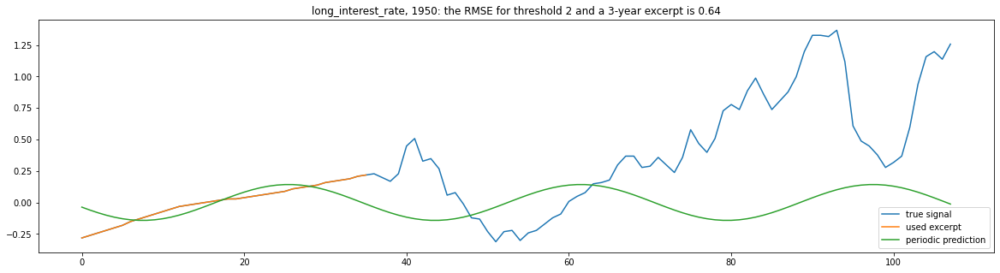

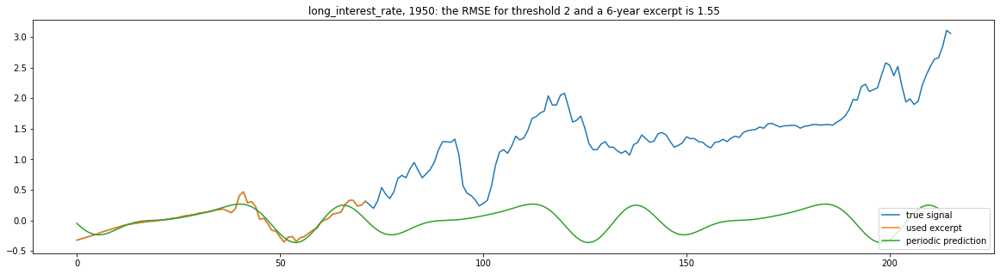

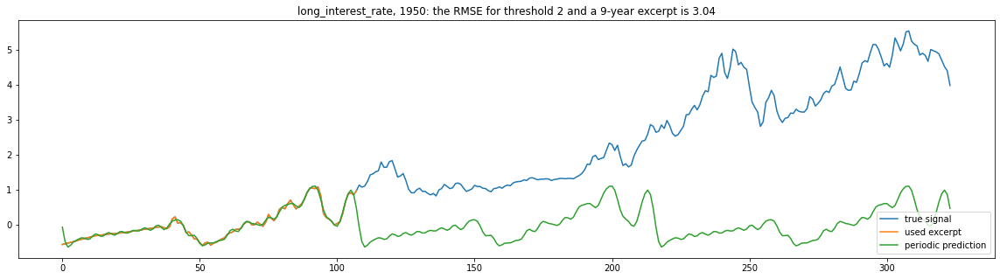

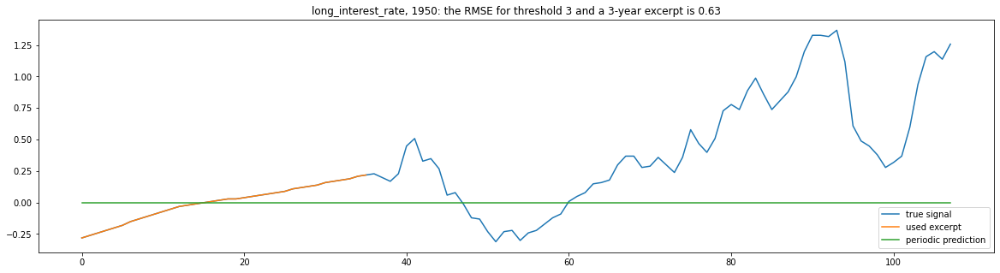

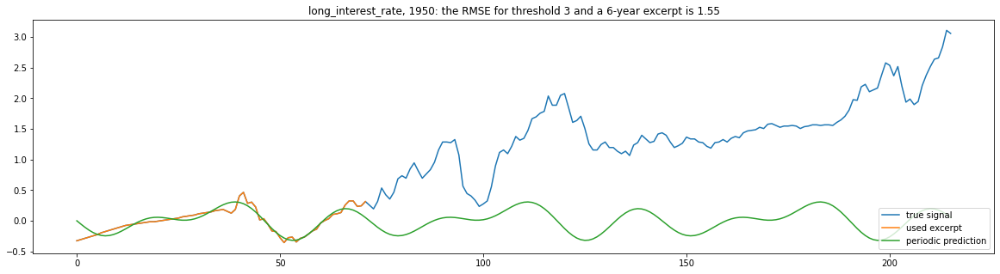

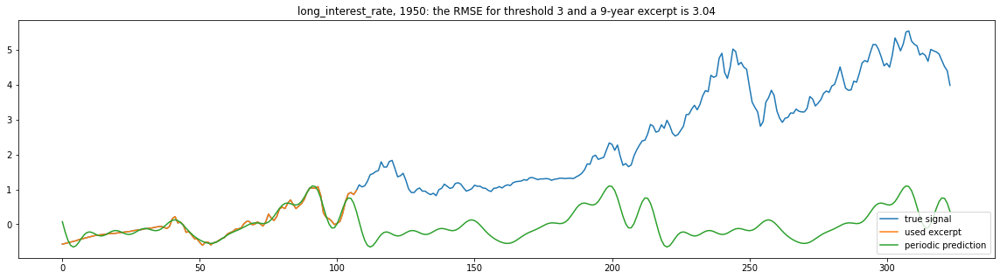

***********************
*** Start at year: 1960***
***********************


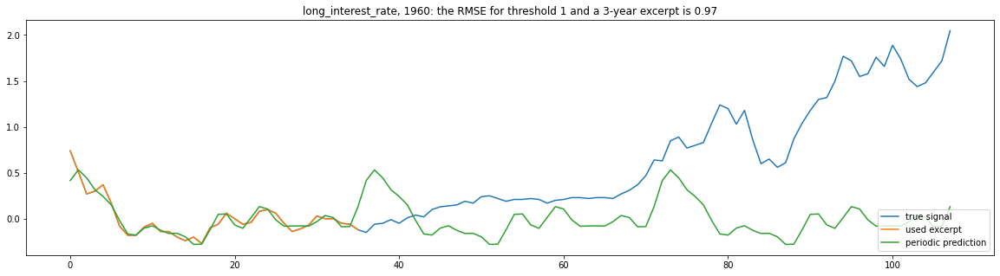

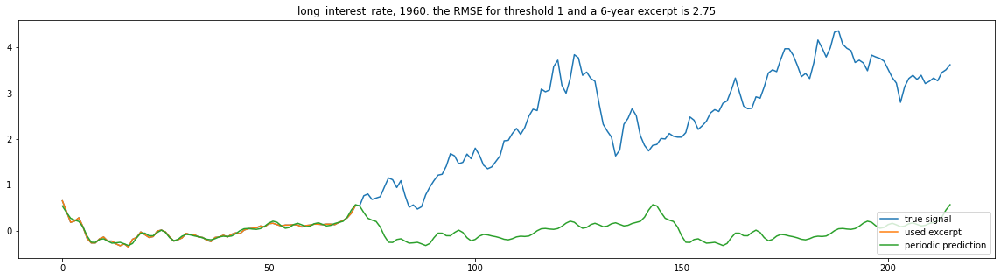

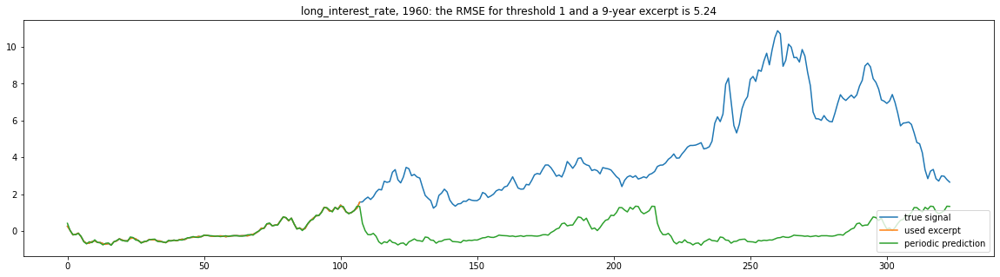

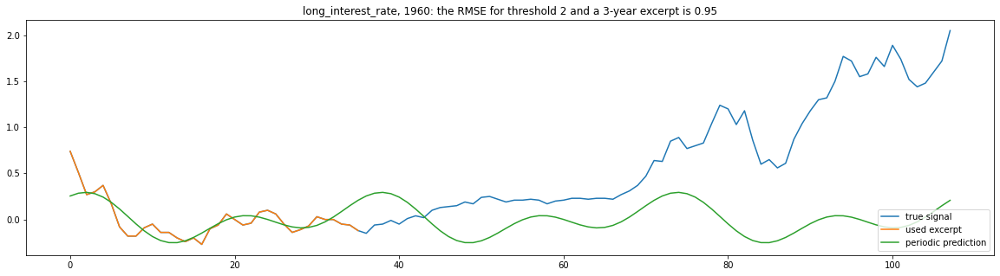

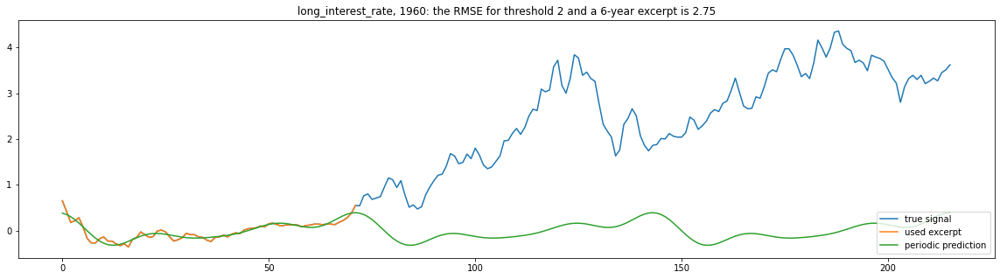

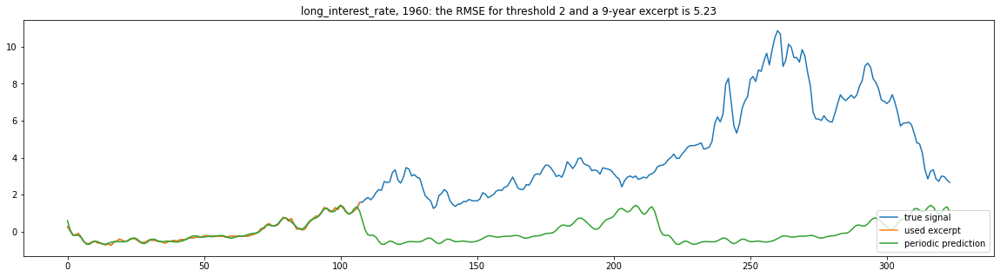

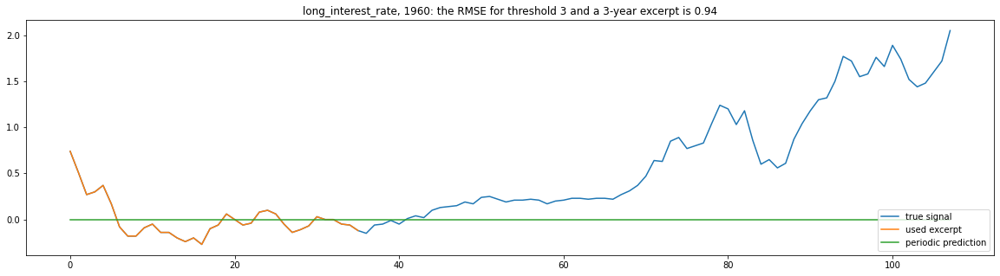

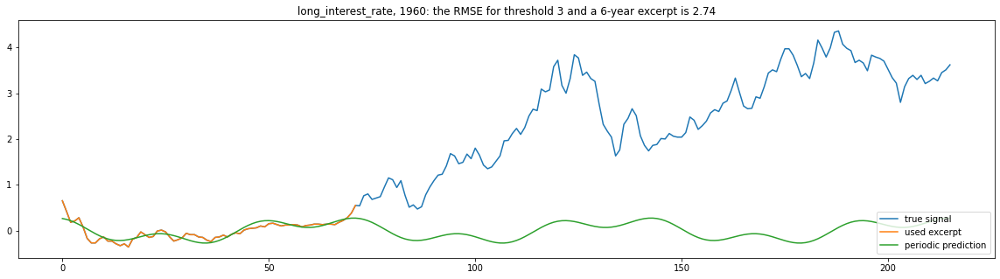

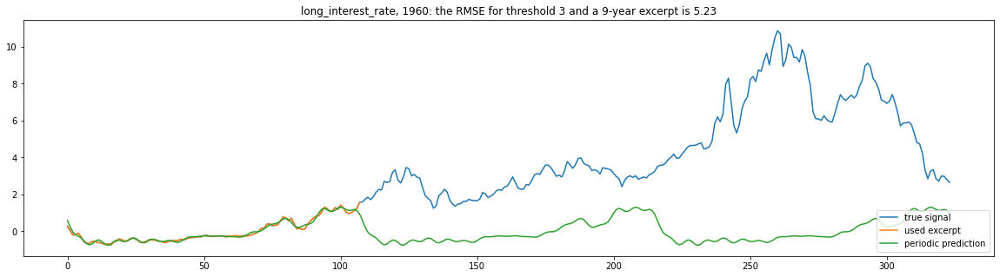

***********************
*** Start at year: 1970***
***********************


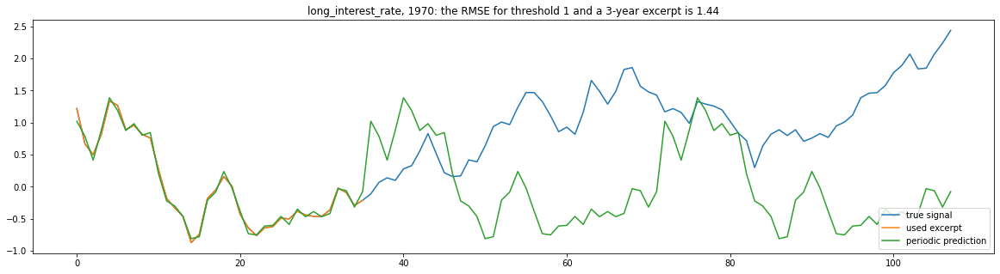

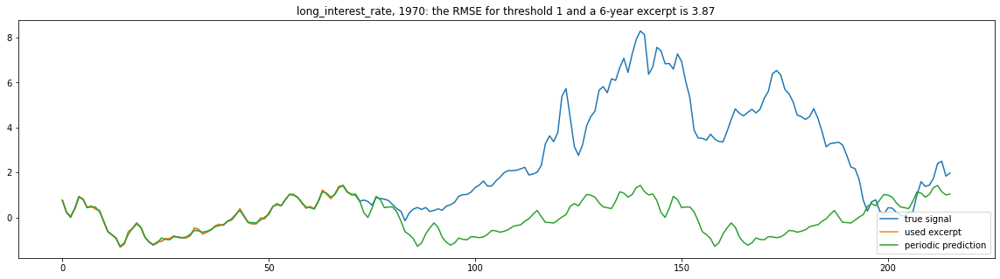

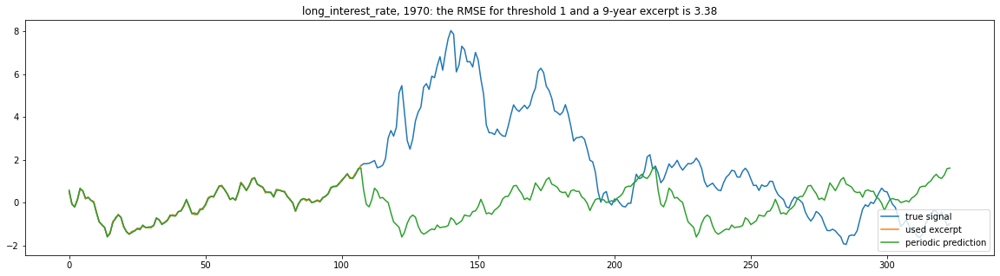

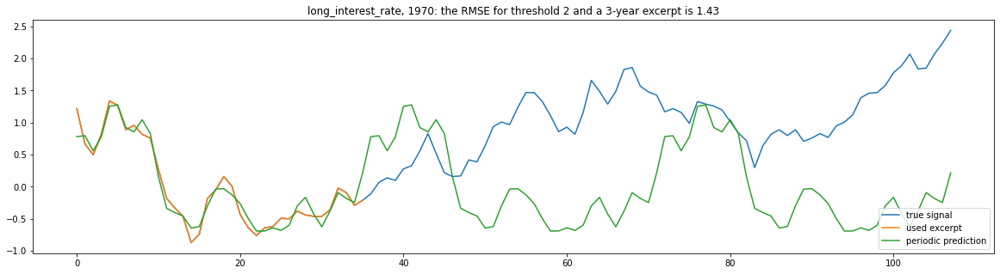

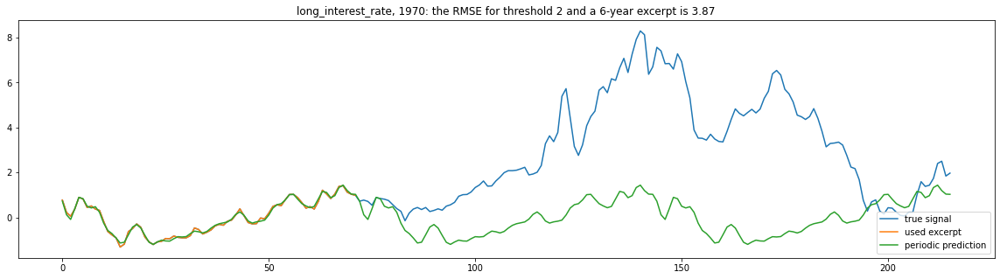

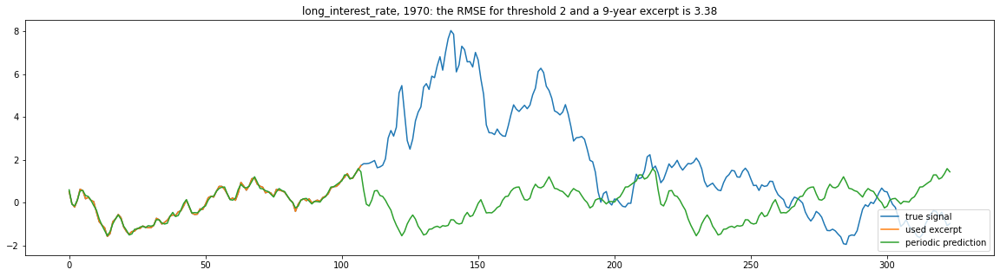

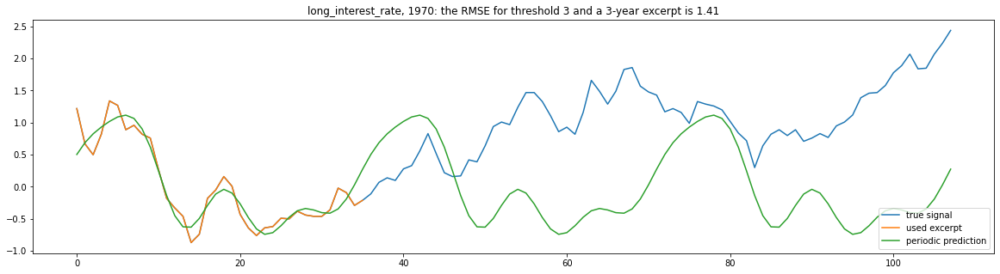

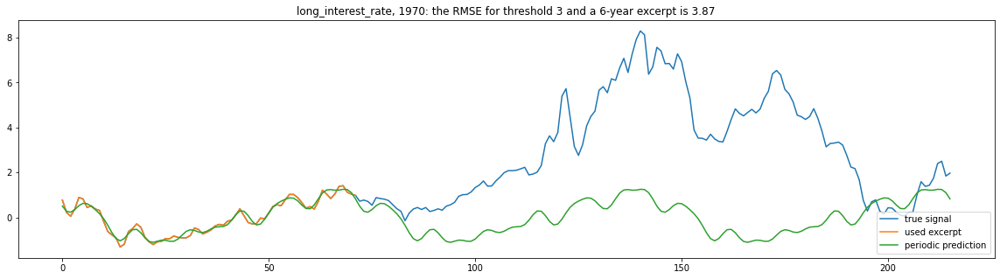

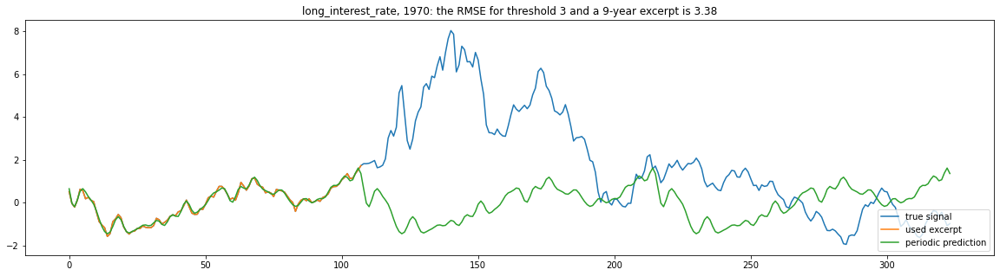

***********************
*** Start at year: 1980***
***********************


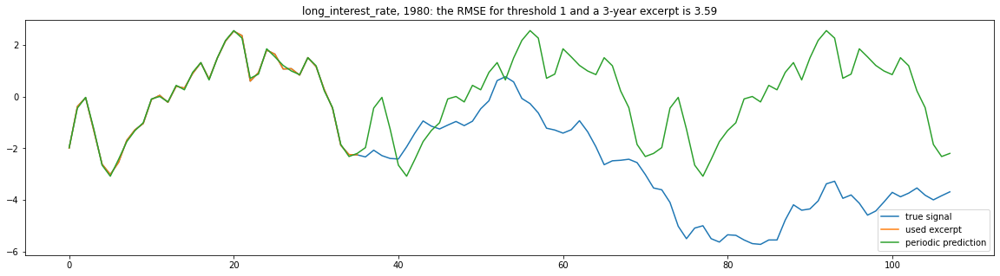

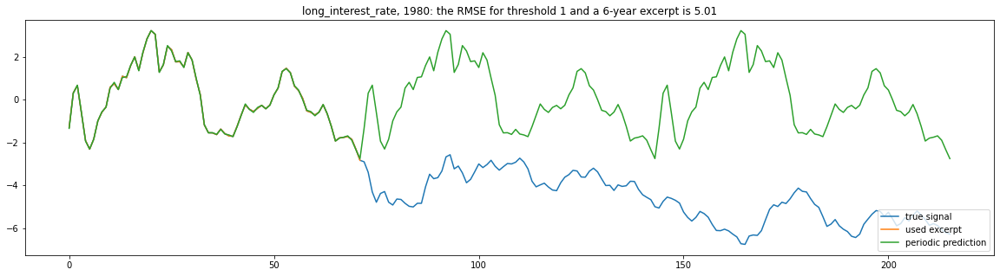

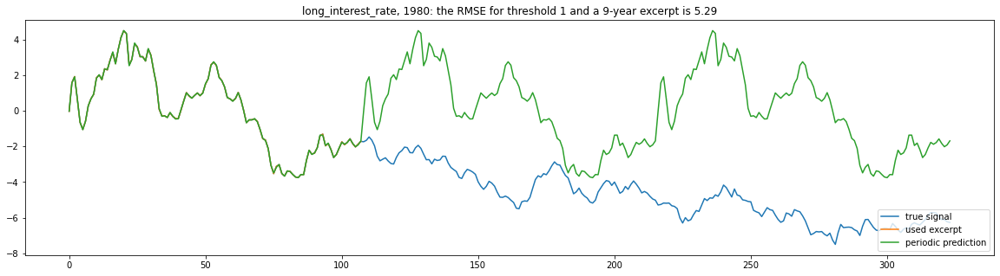

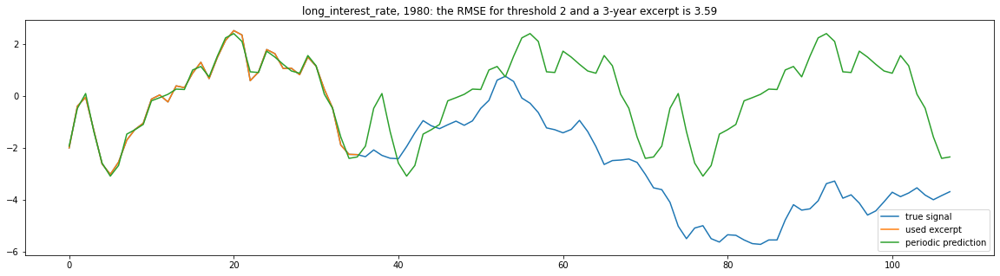

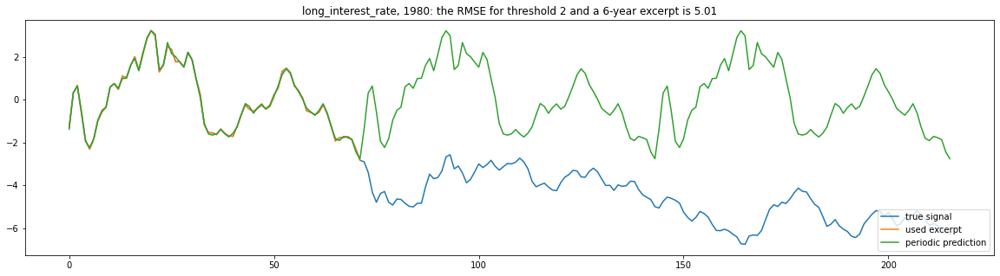

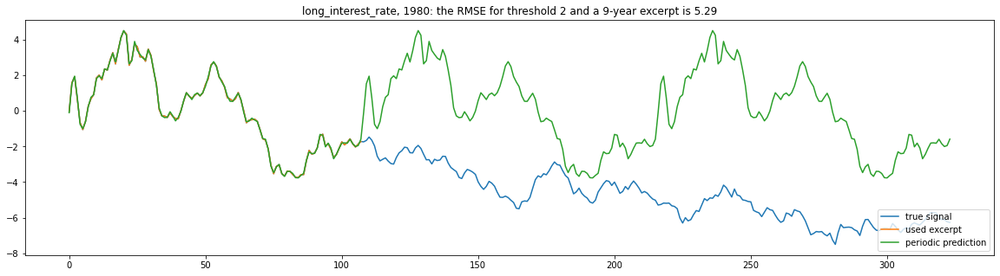

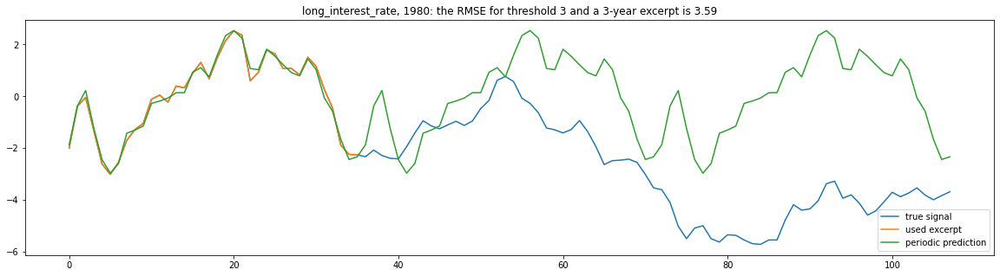

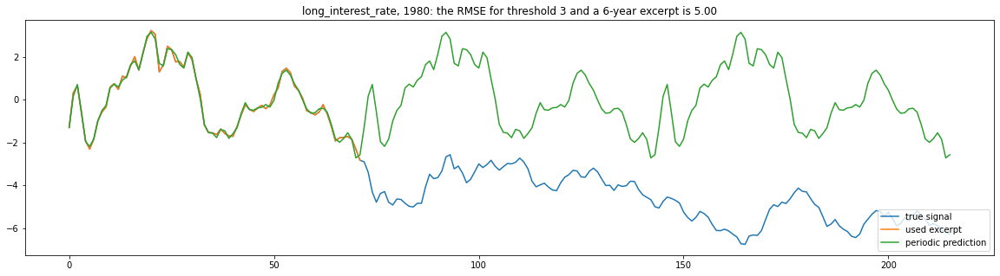

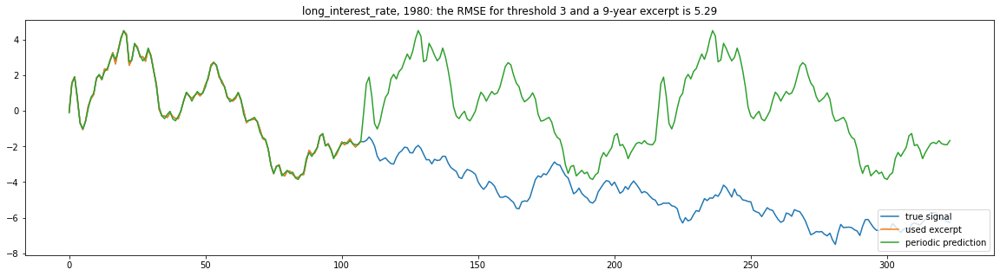

***********************
*** Start at year: 1990***
***********************


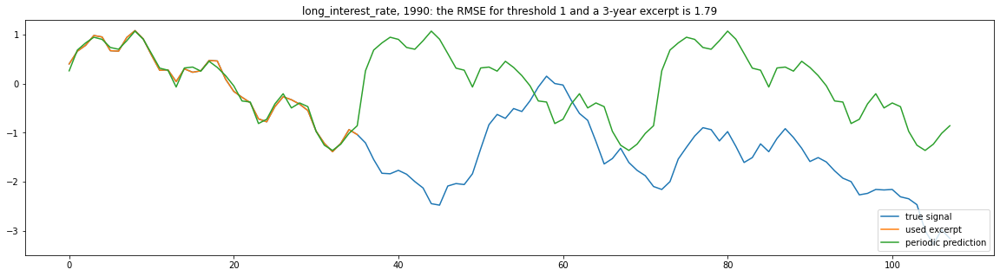

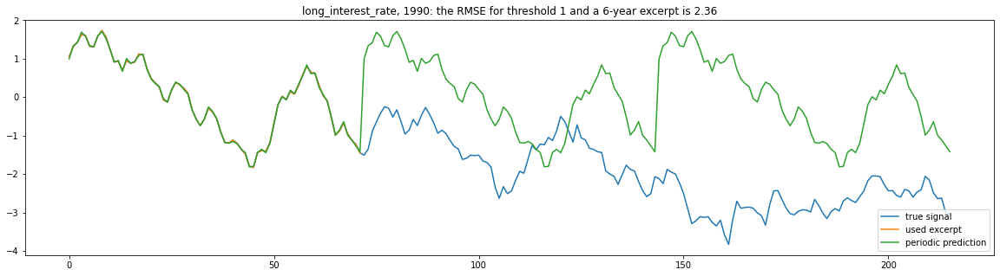

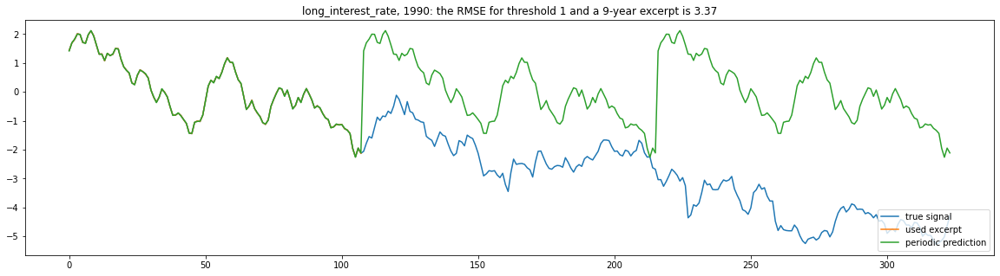

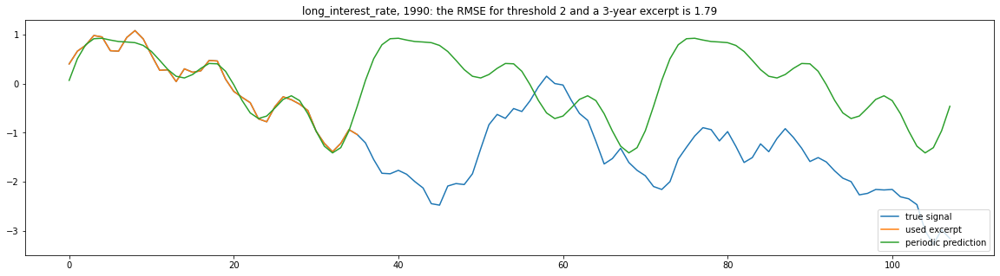

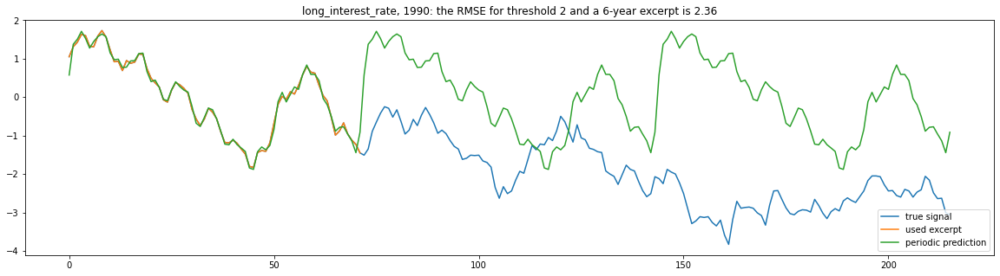

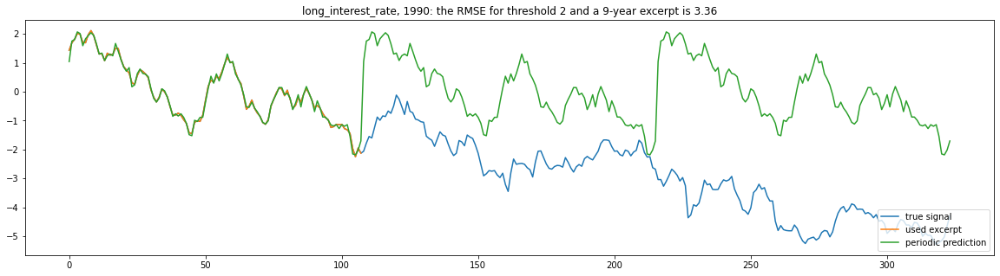

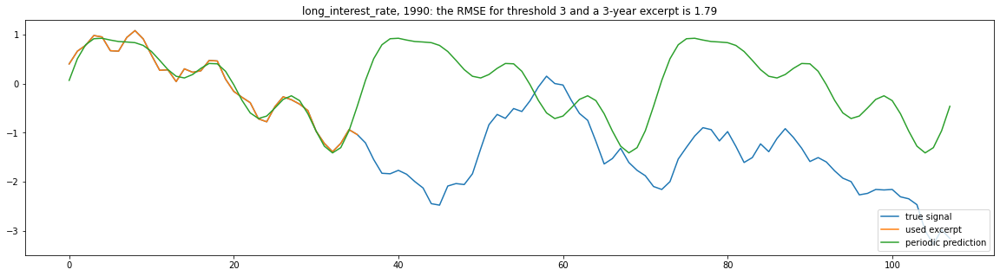

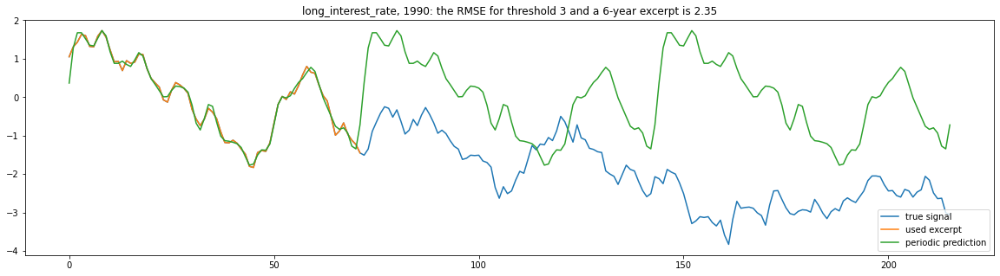

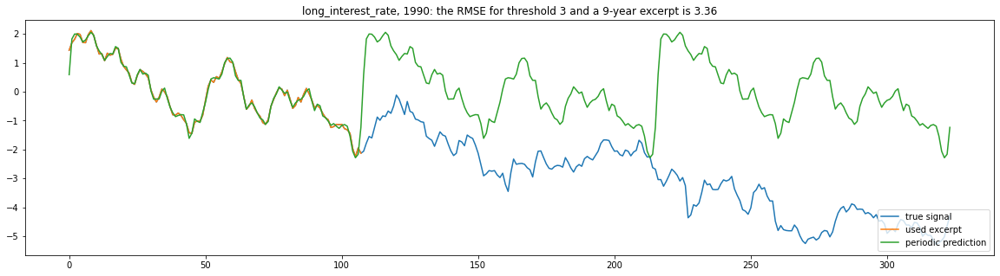

***********************
*** Start at year: 1940***
***********************


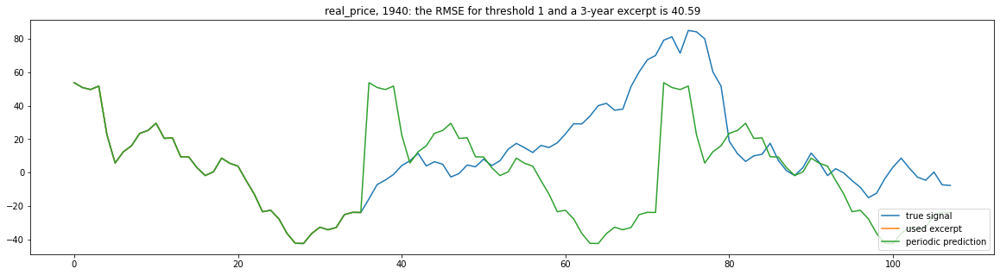

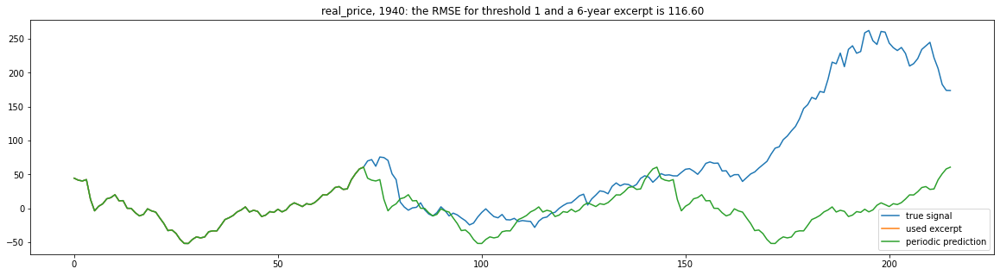

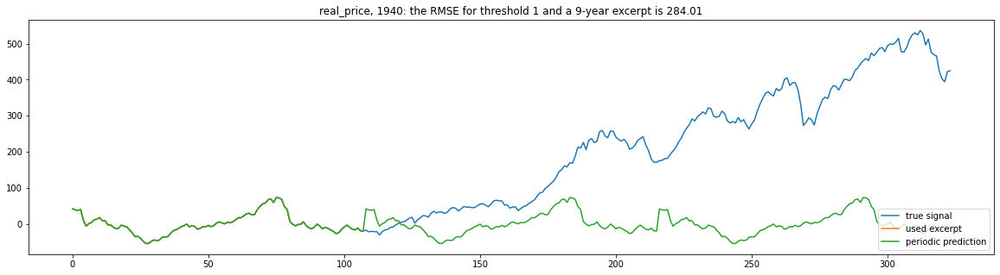

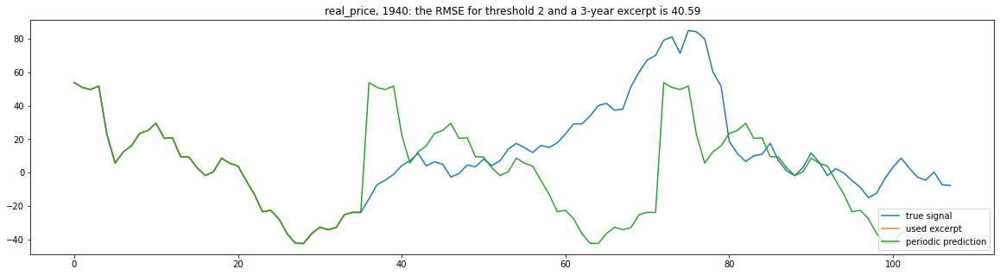

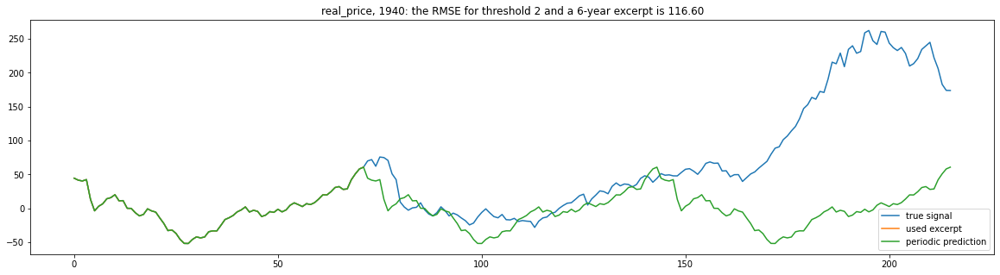

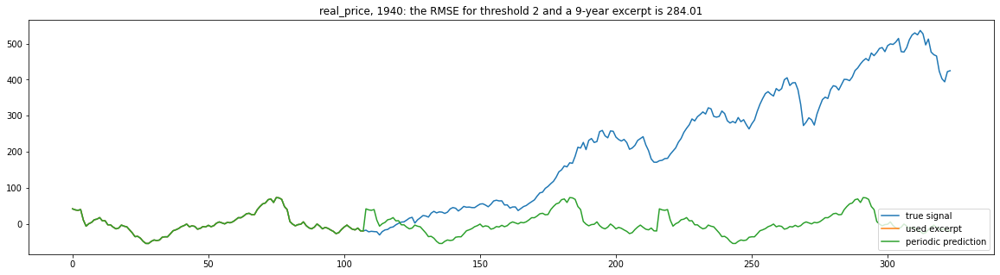

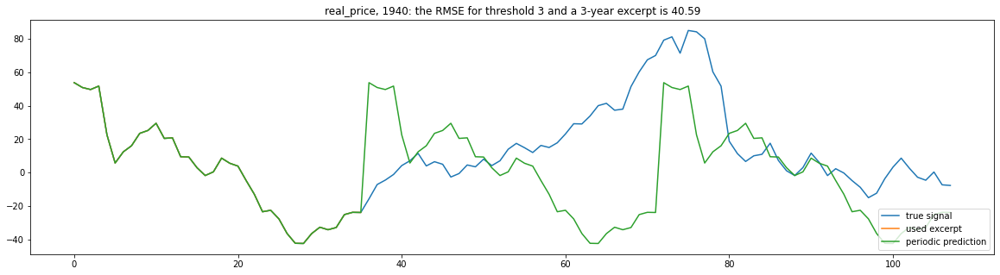

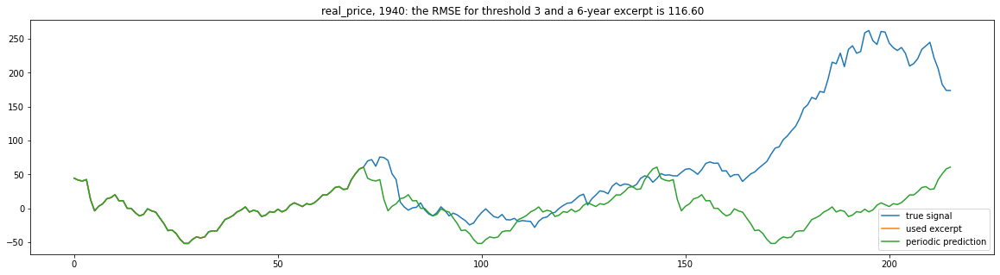

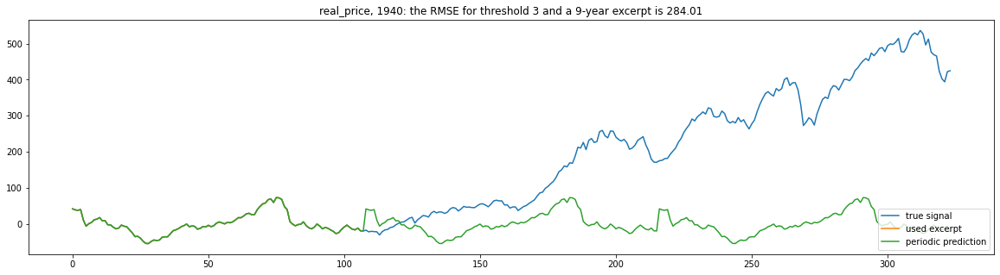

***********************
*** Start at year: 1950***
***********************


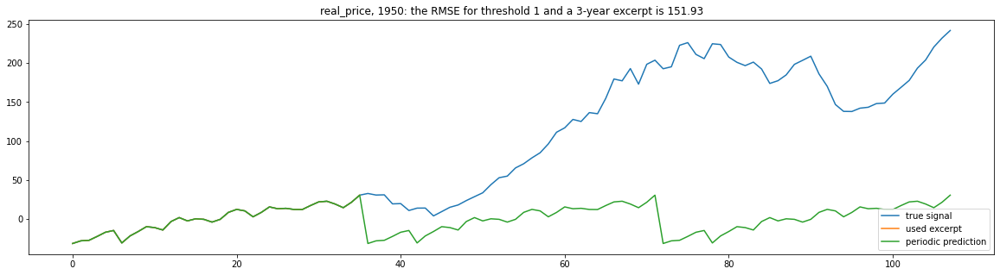

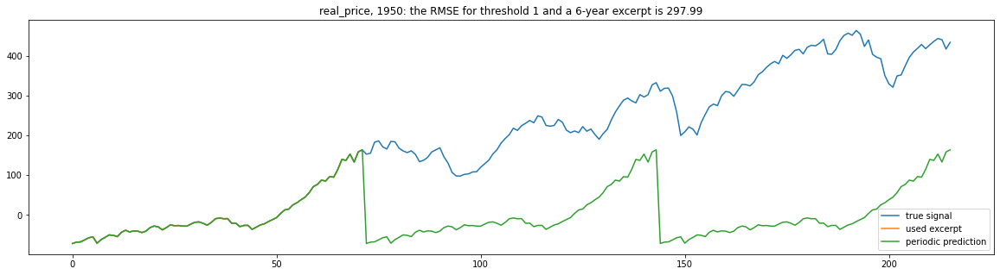

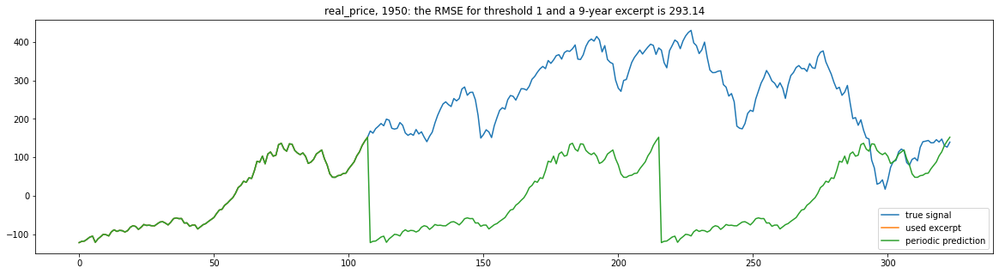

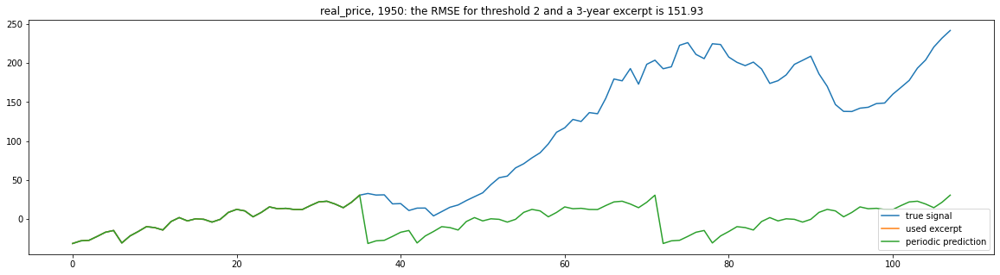

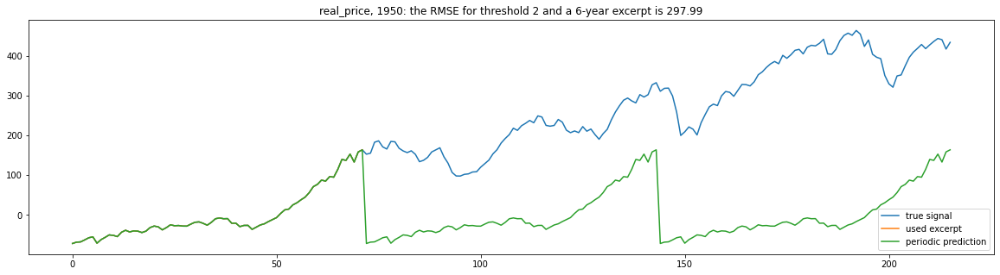

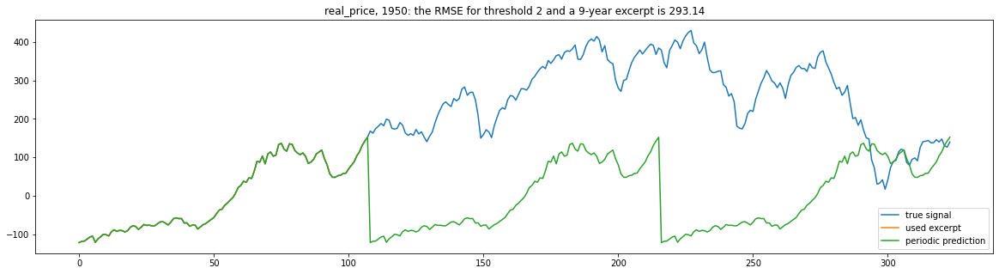

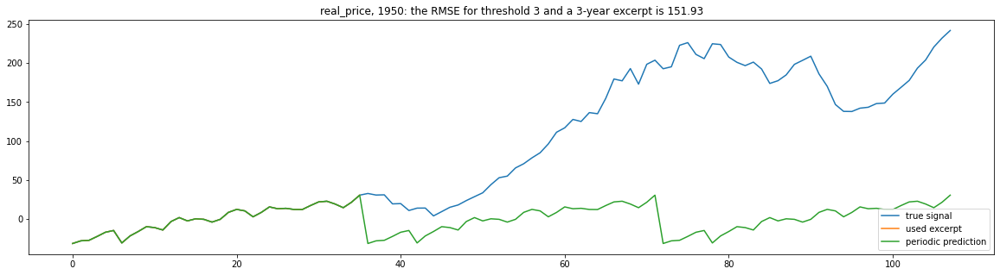

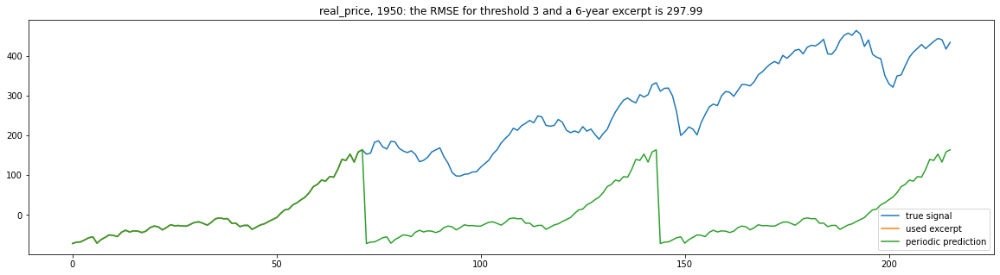

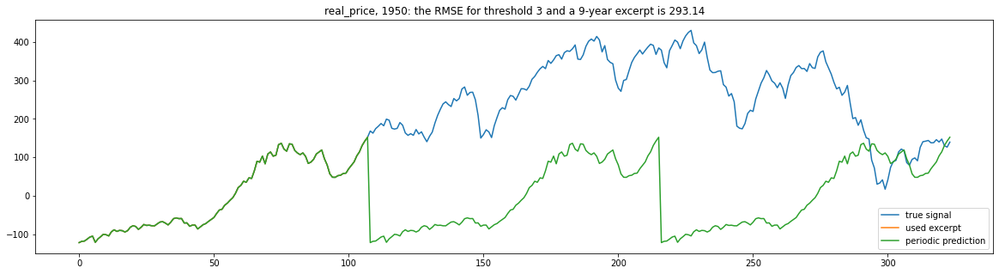

***********************
*** Start at year: 1960***
***********************


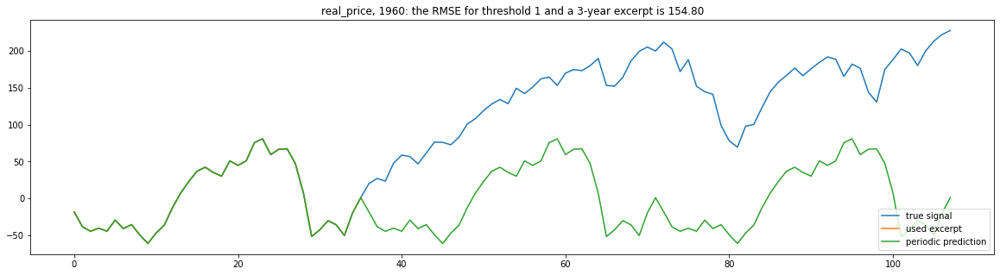

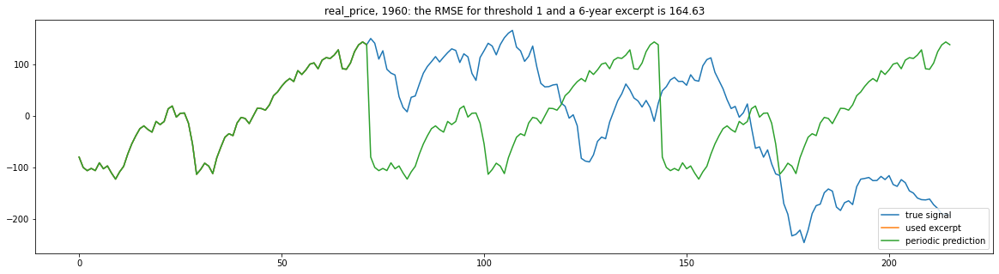

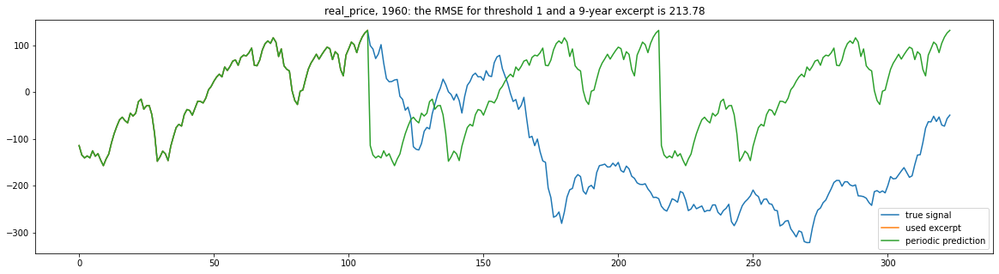

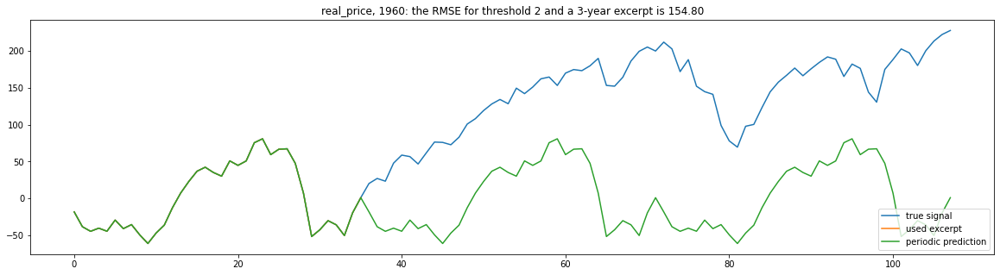

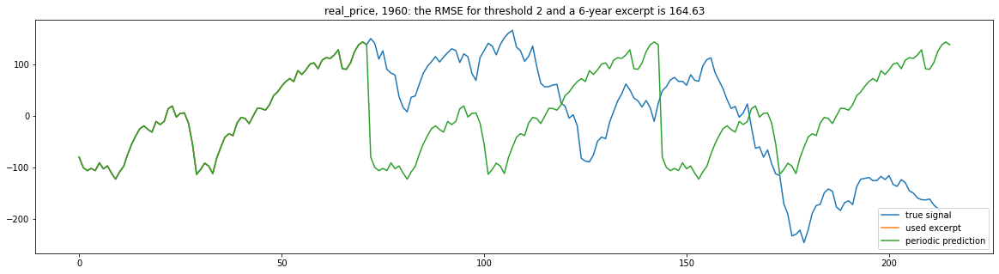

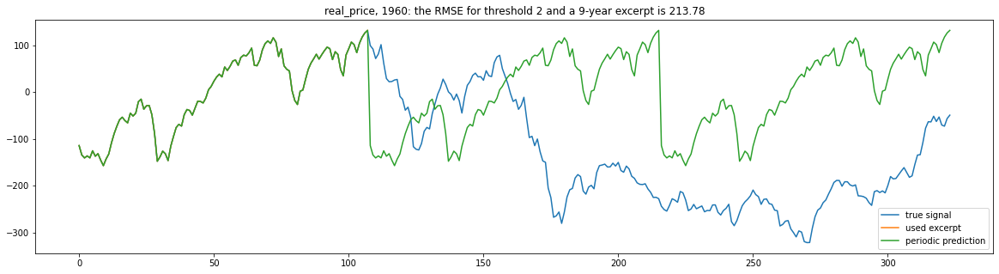

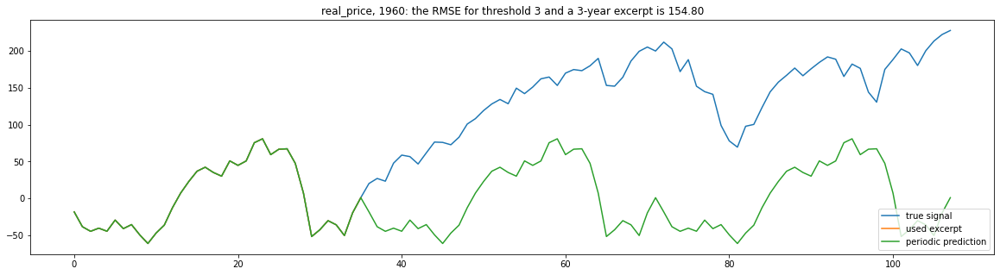

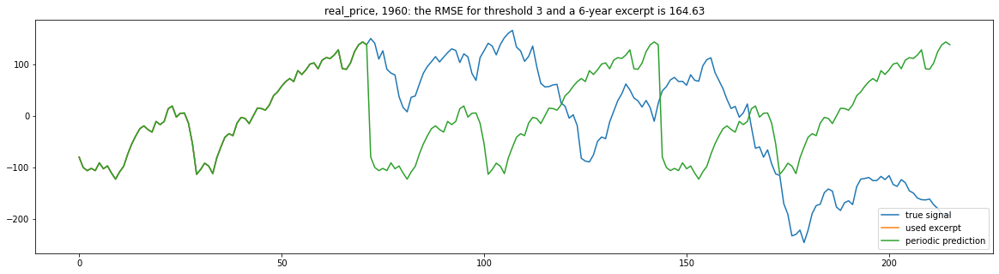

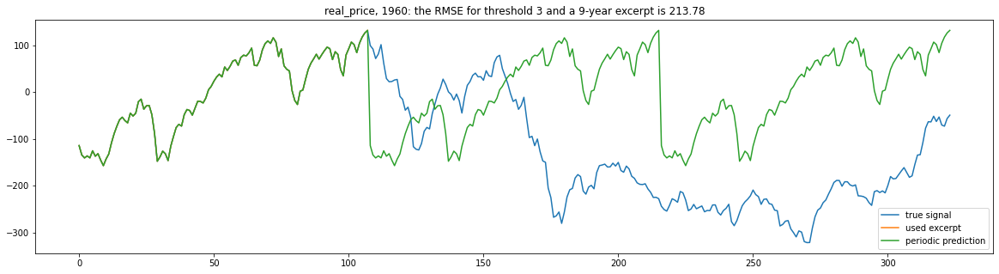

***********************
*** Start at year: 1970***
***********************


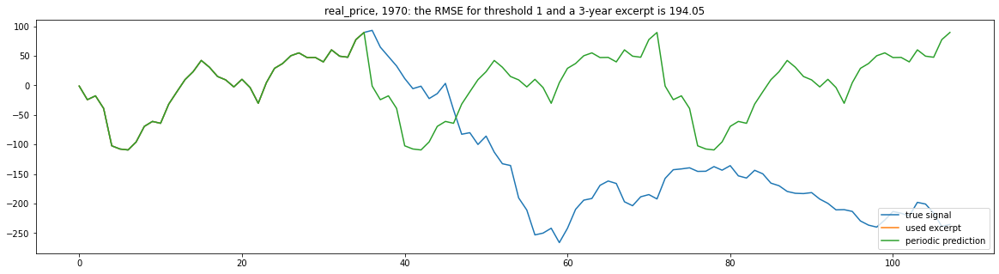

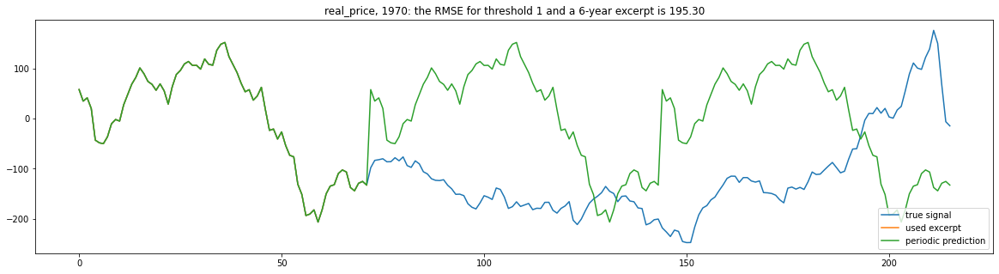

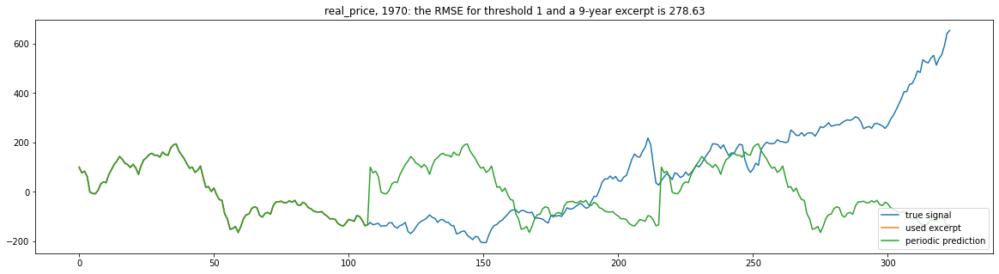

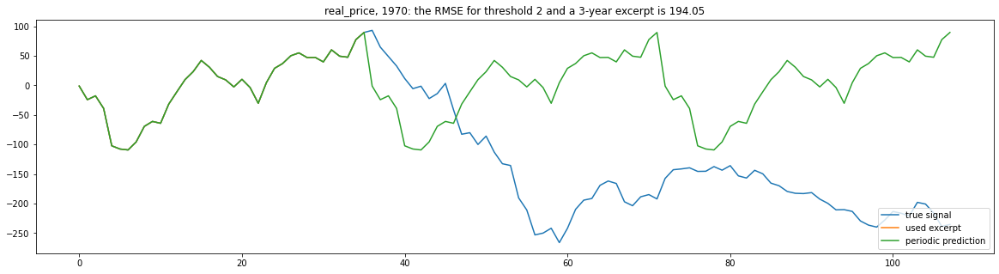

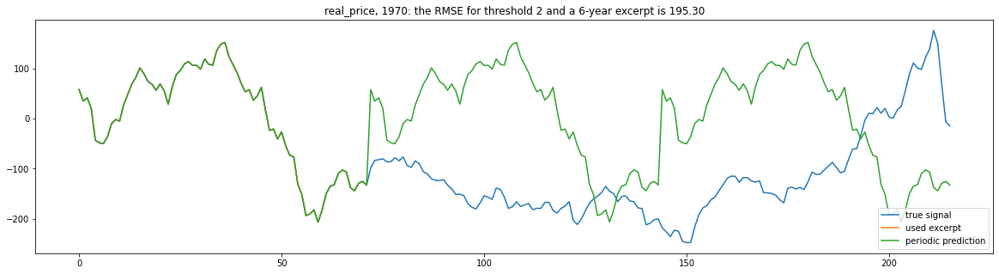

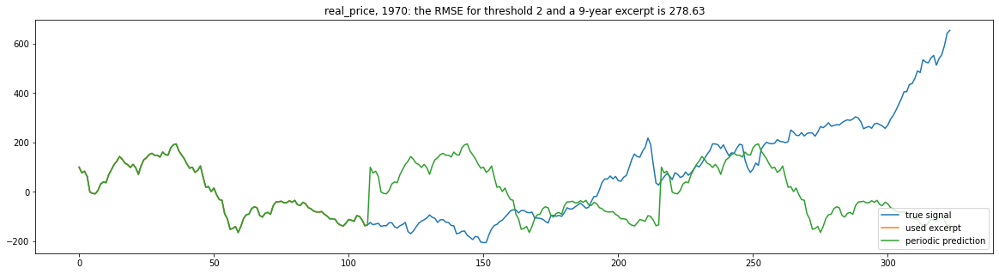

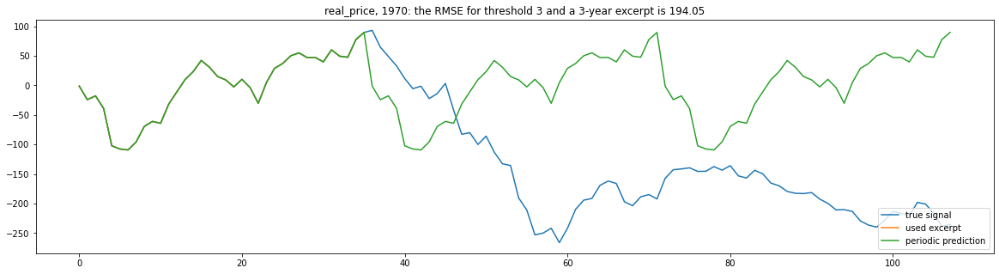

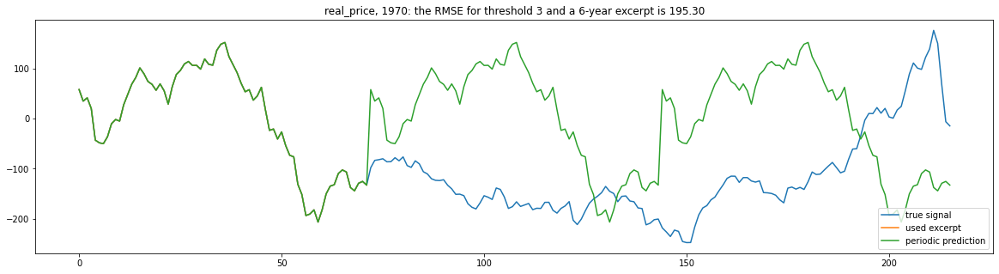

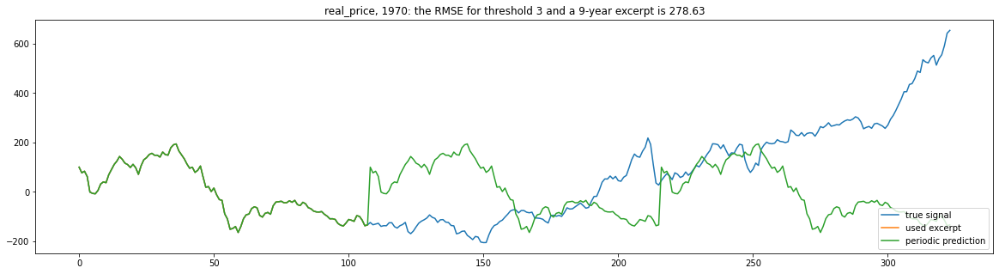

***********************
*** Start at year: 1980***
***********************


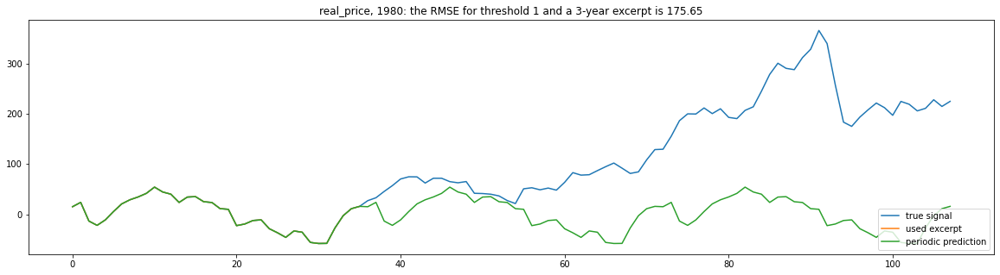

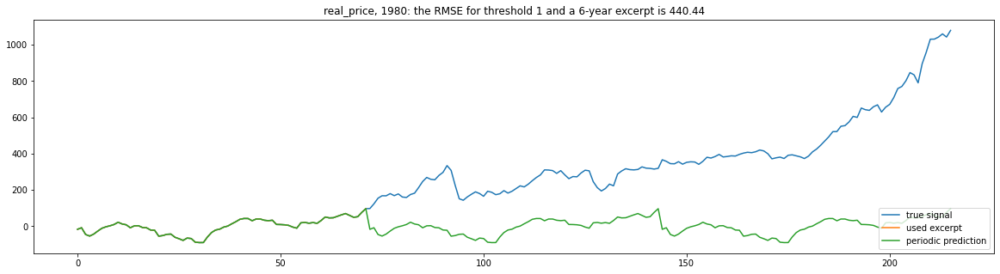

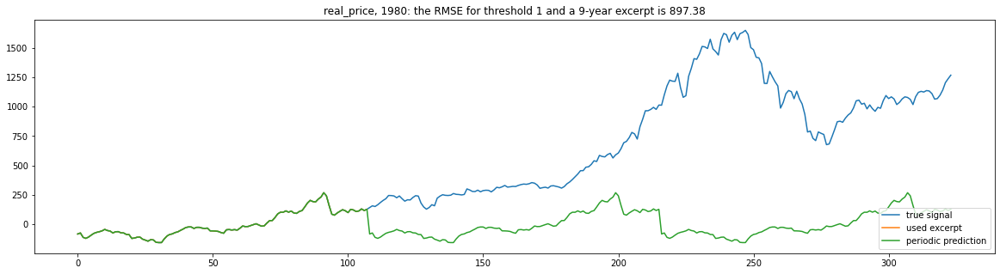

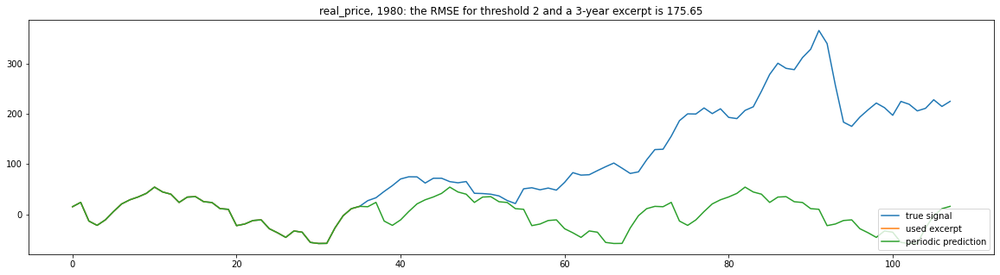

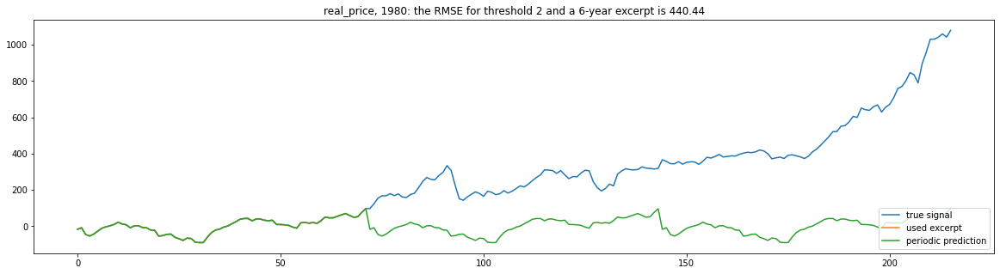

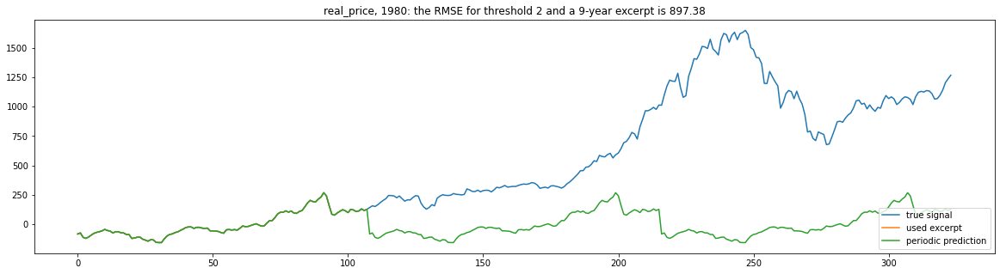

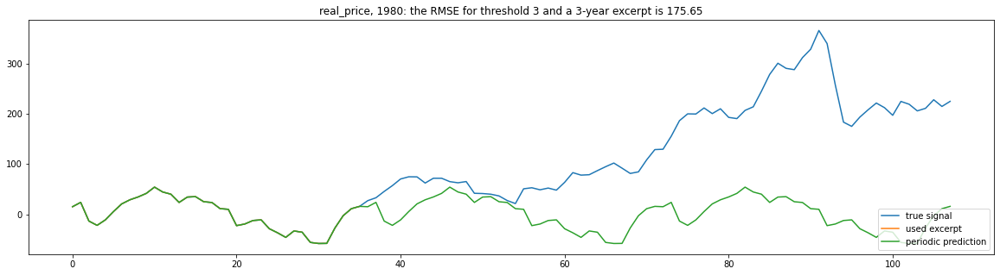

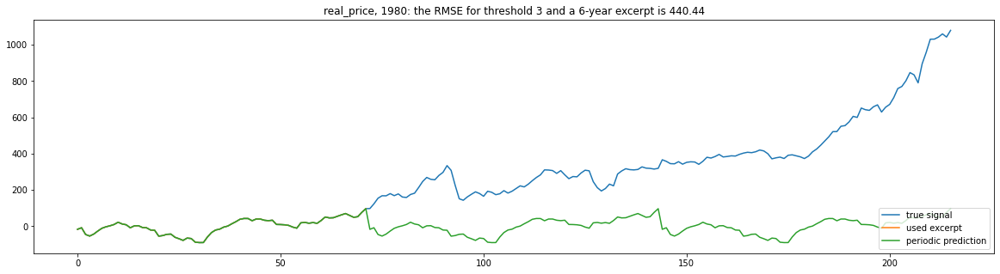

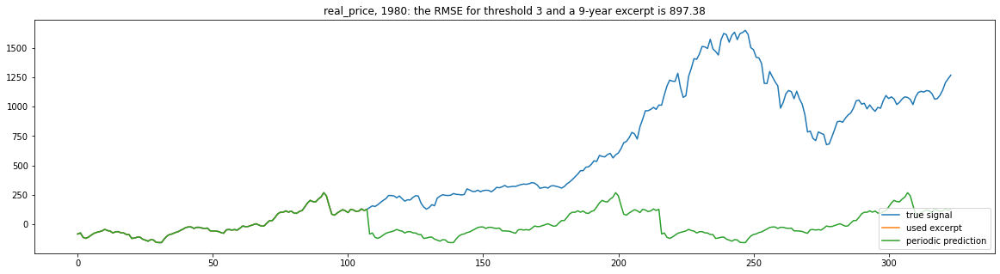

***********************
*** Start at year: 1990***
***********************


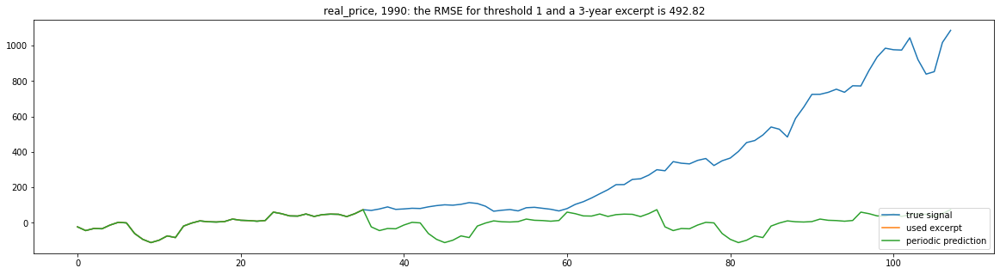

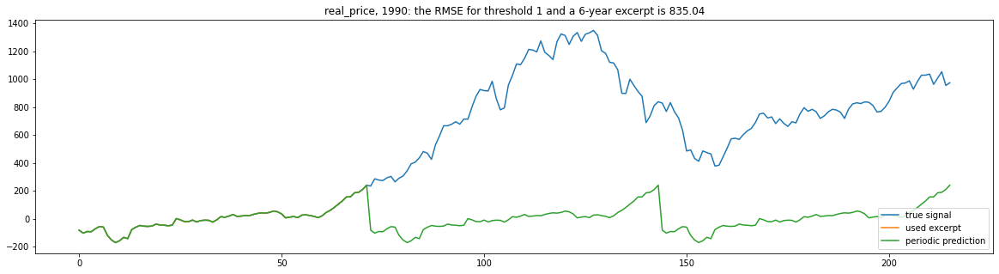

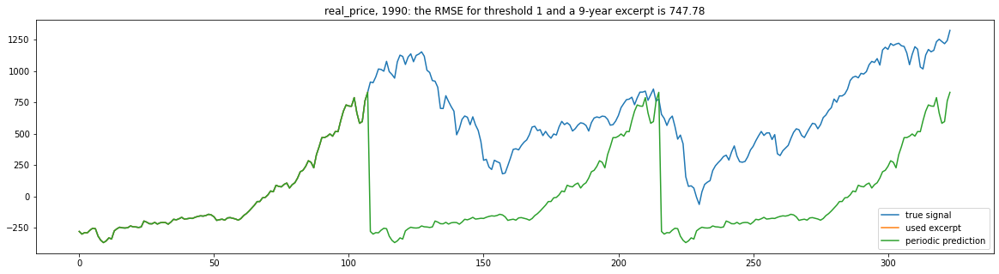

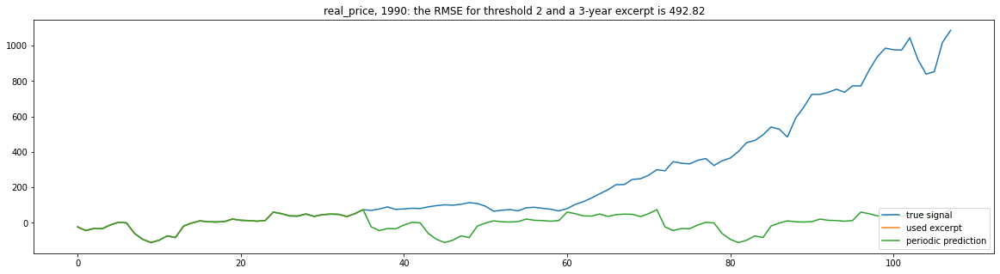

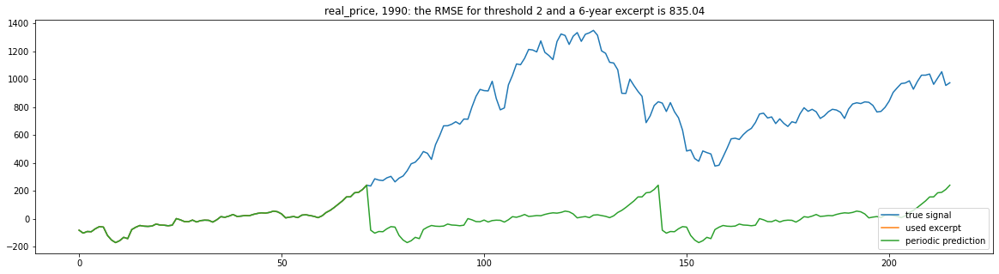

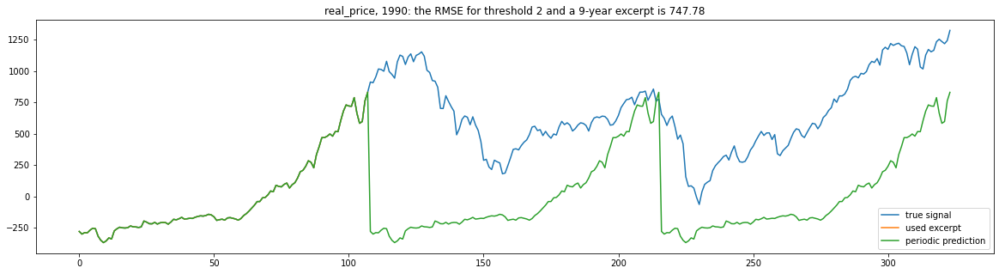

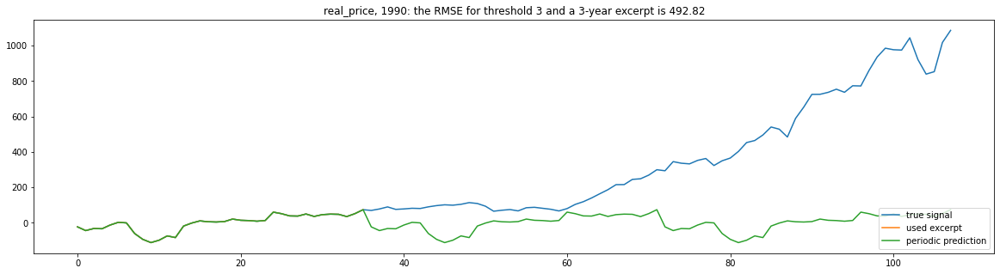

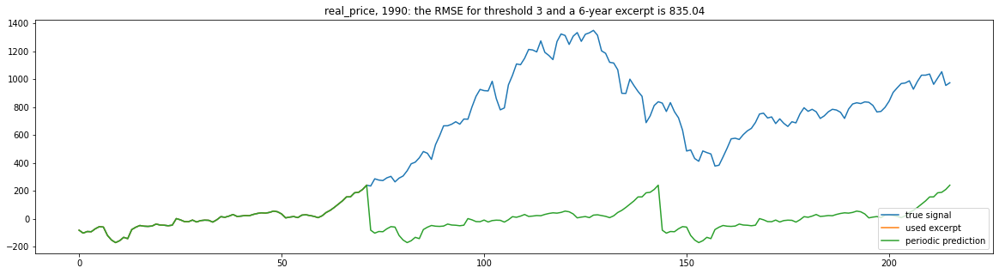

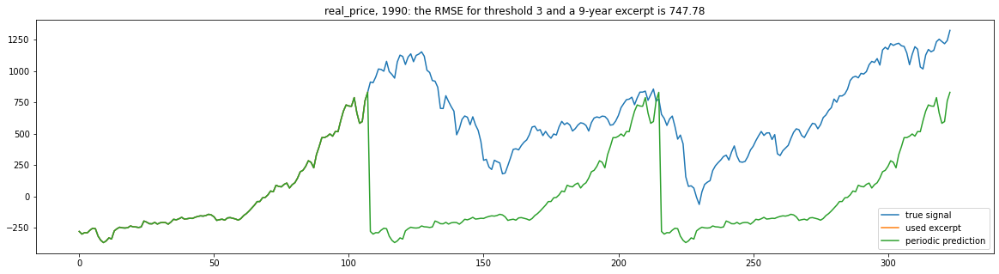

***********************
*** Start at year: 1940***
***********************


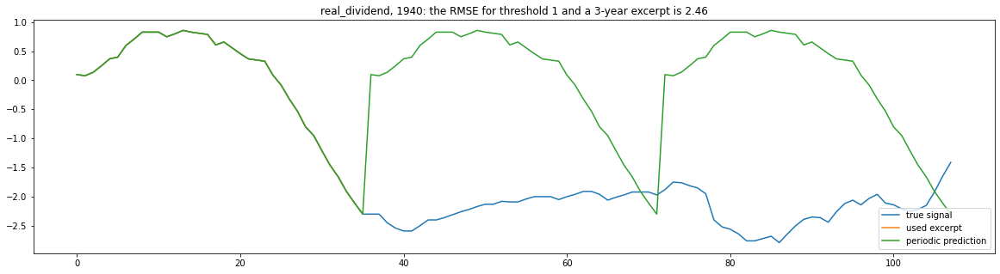

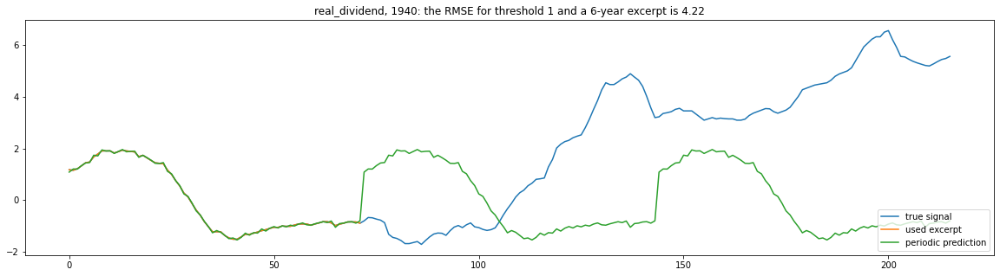

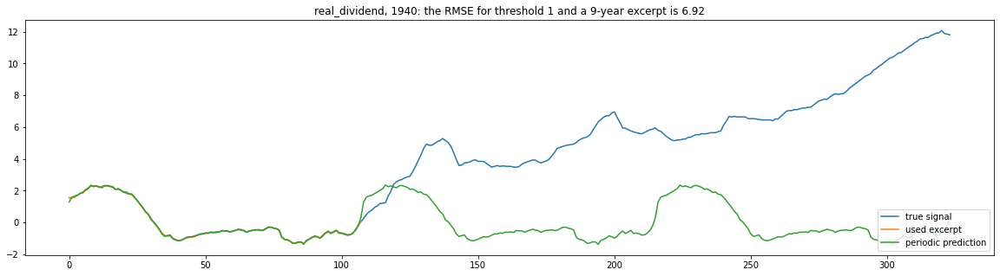

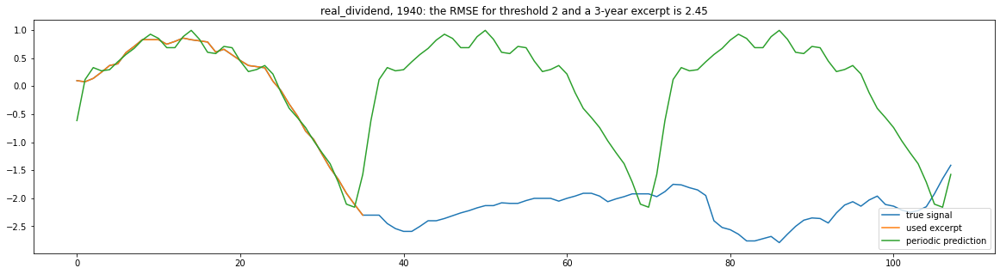

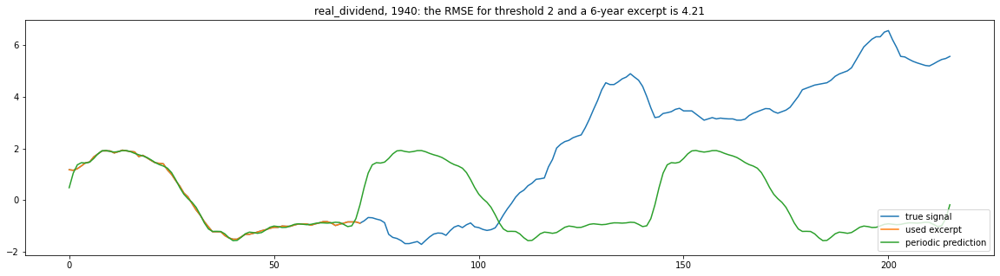

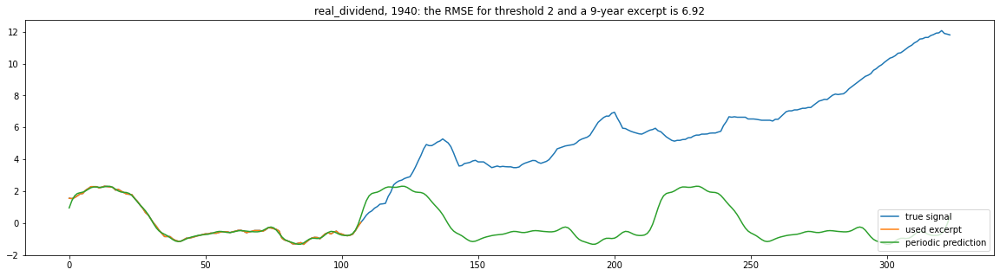

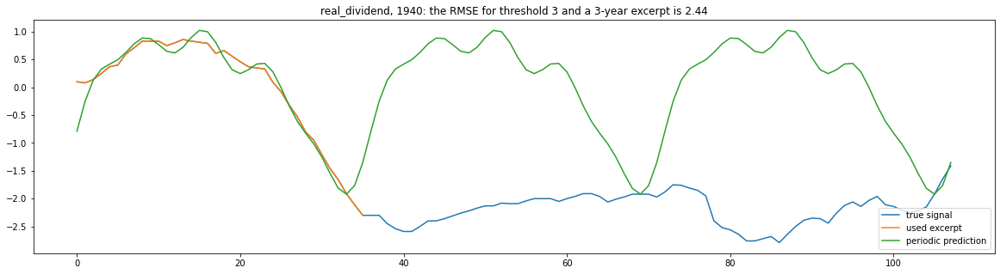

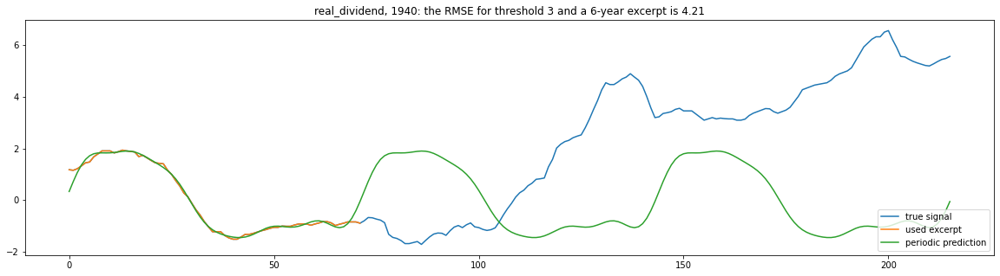

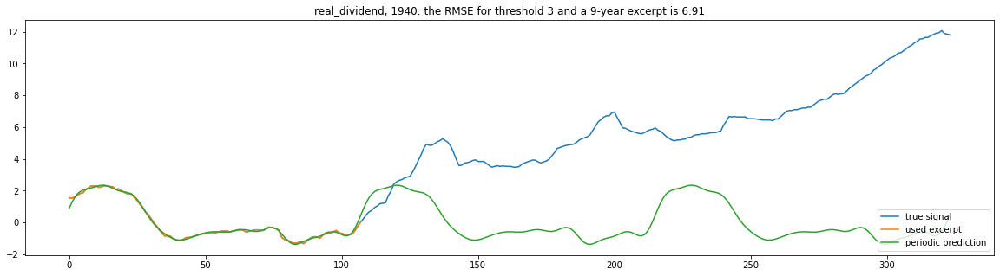

***********************
*** Start at year: 1950***
***********************


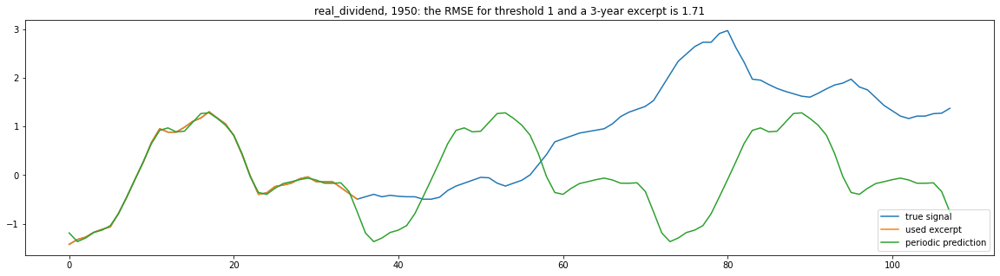

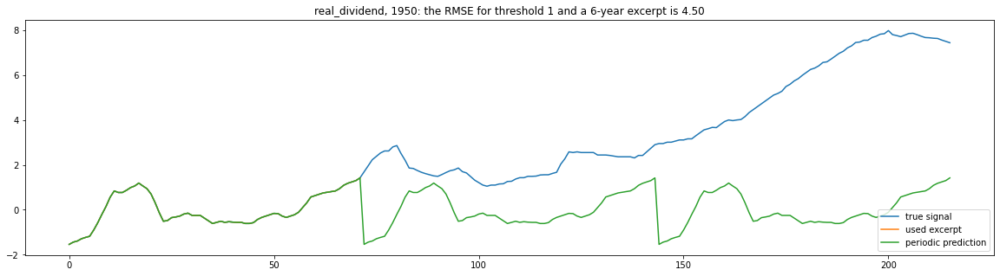

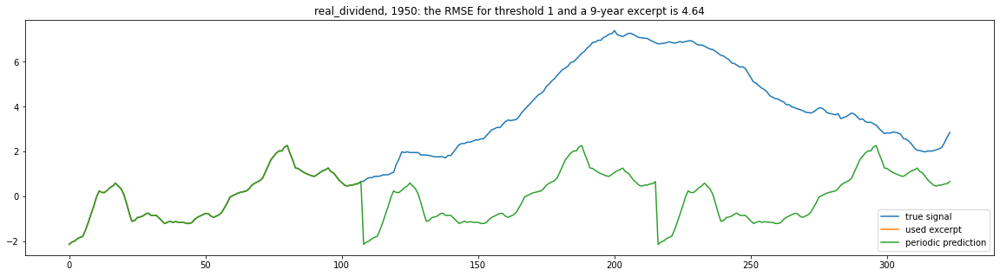

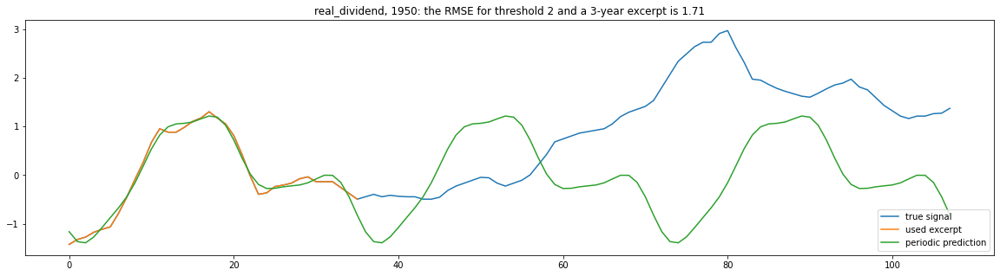

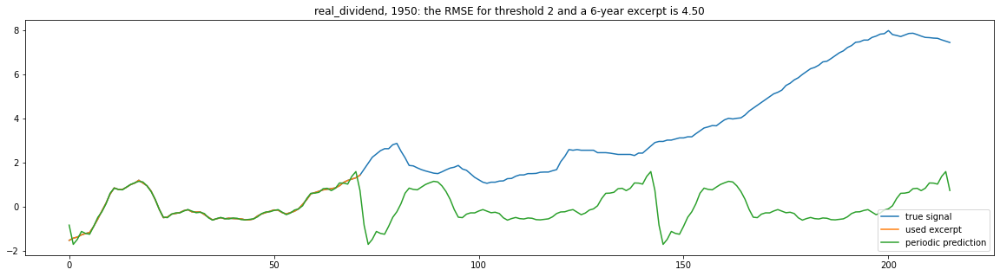

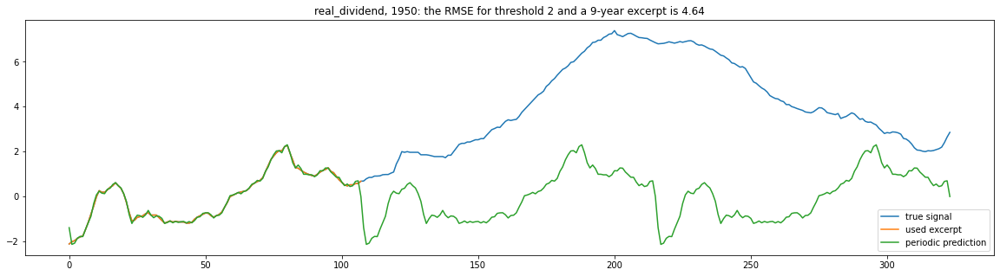

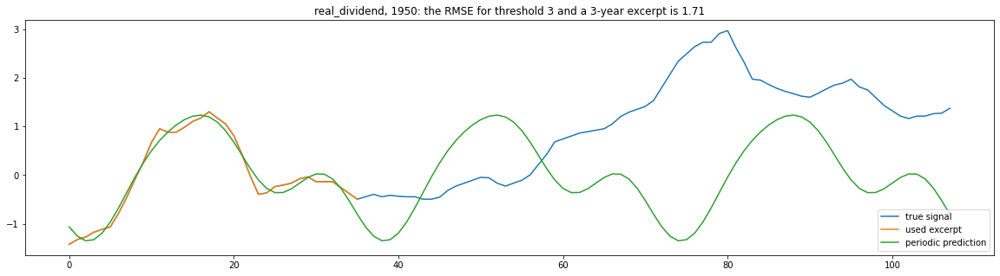

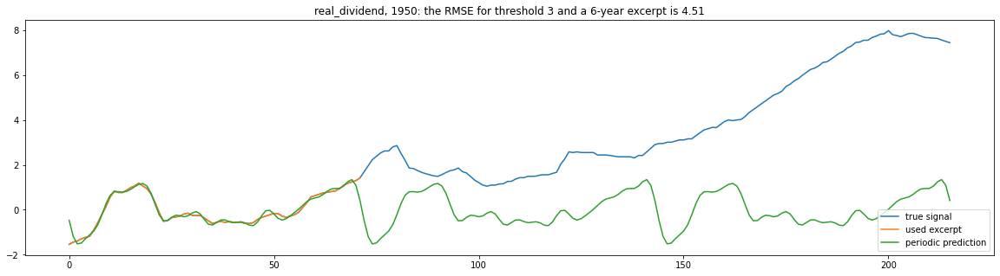

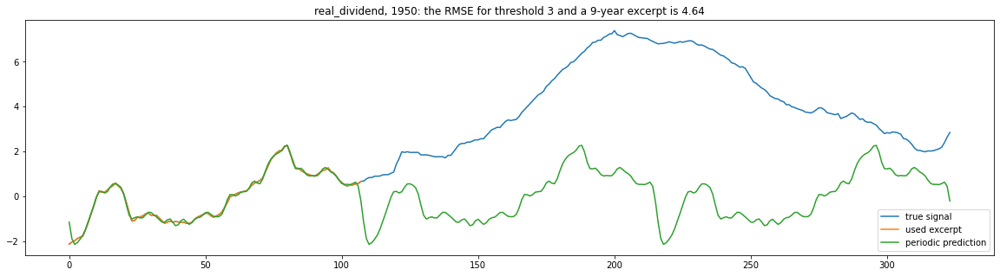

***********************
*** Start at year: 1960***
***********************


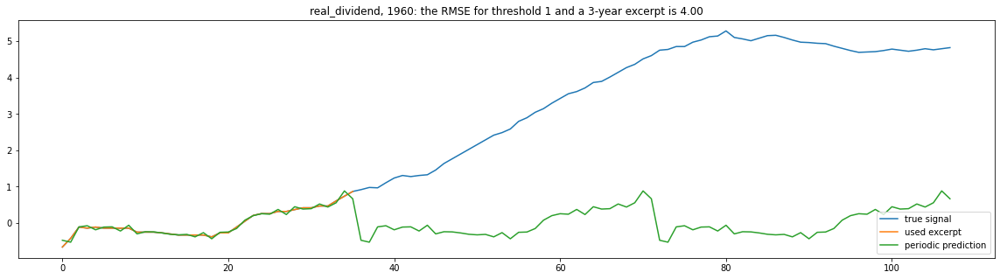

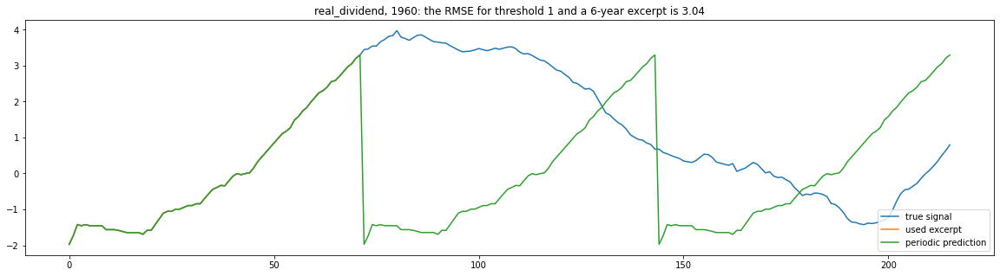

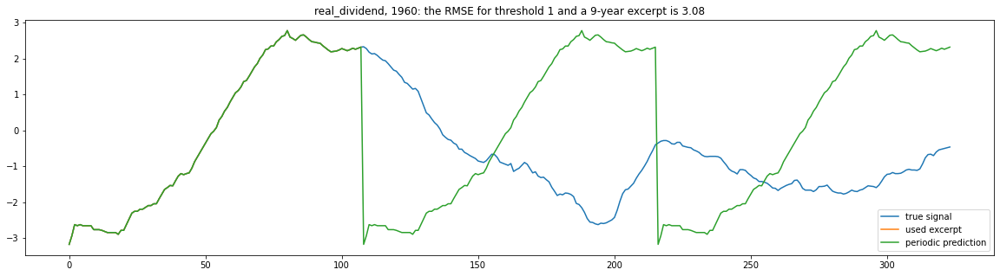

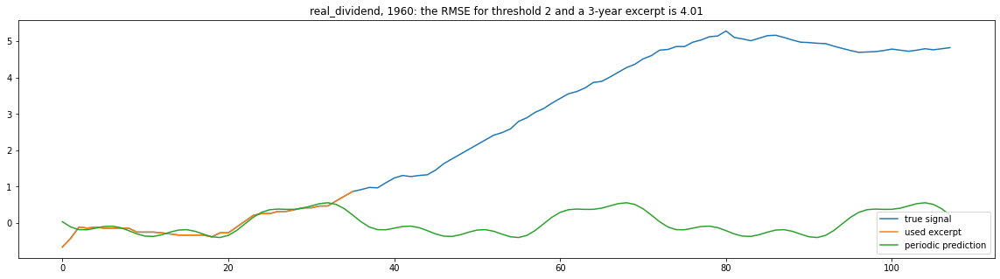

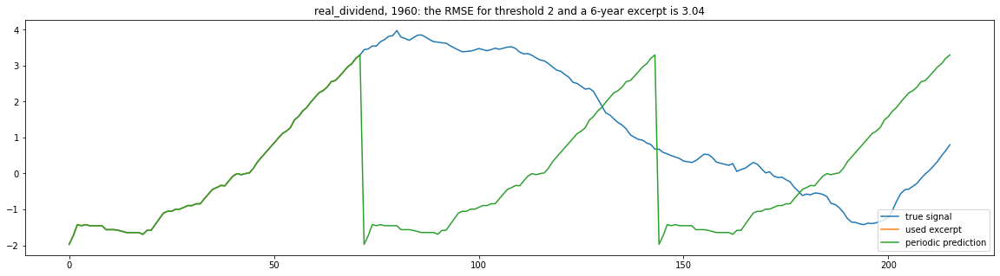

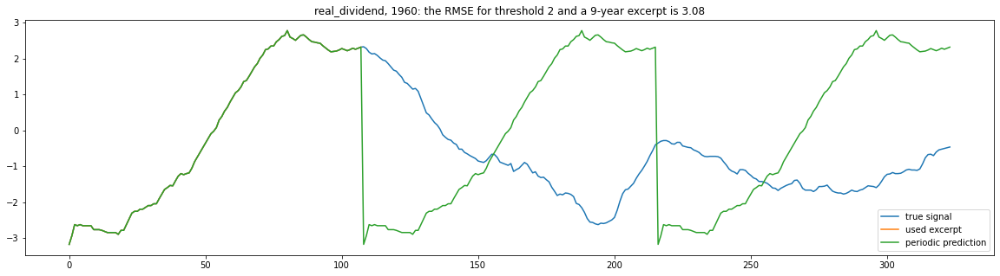

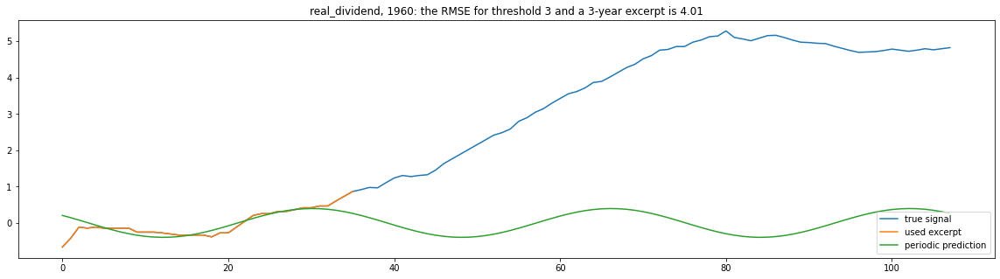

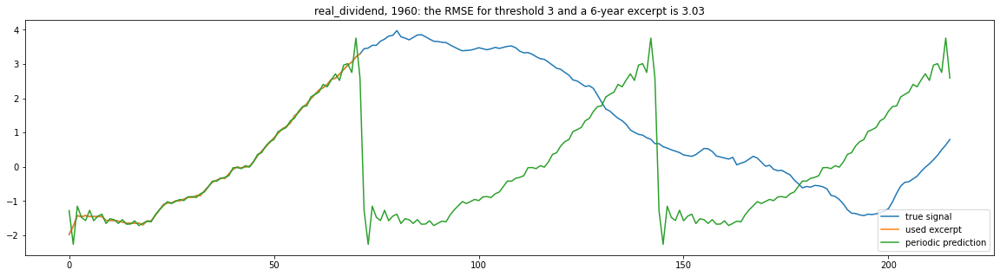

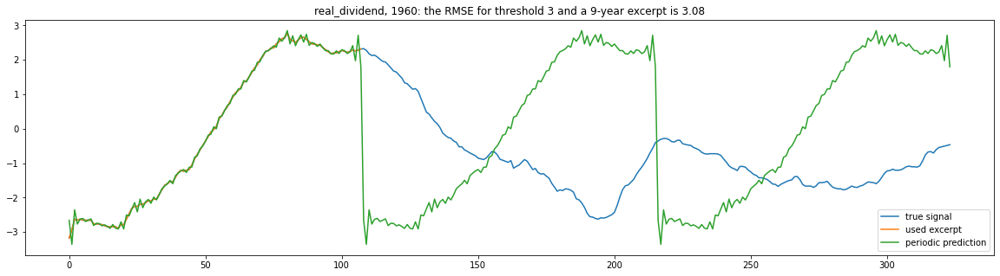

***********************
*** Start at year: 1970***
***********************


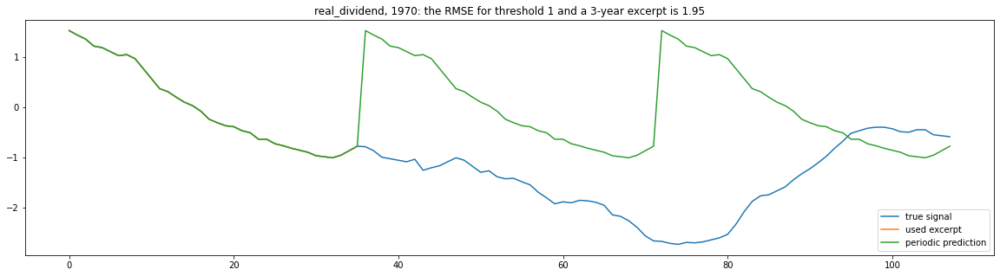

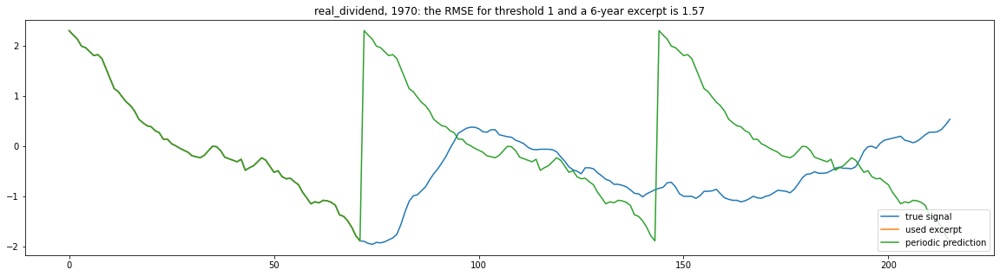

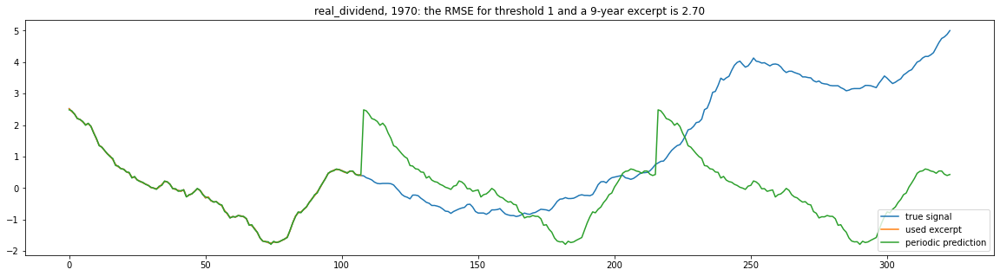

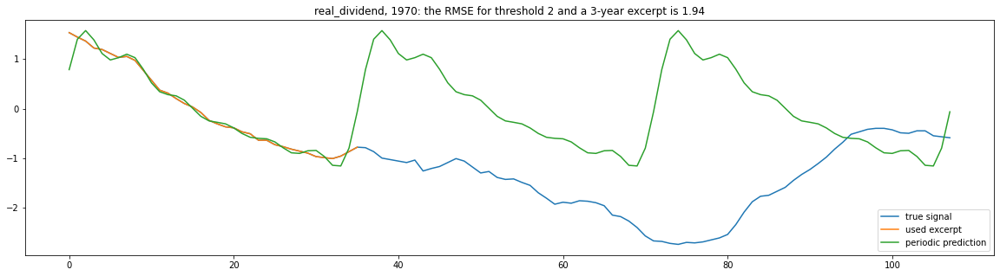

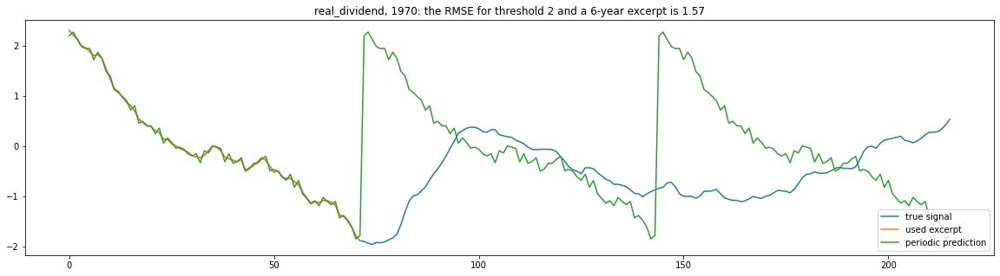

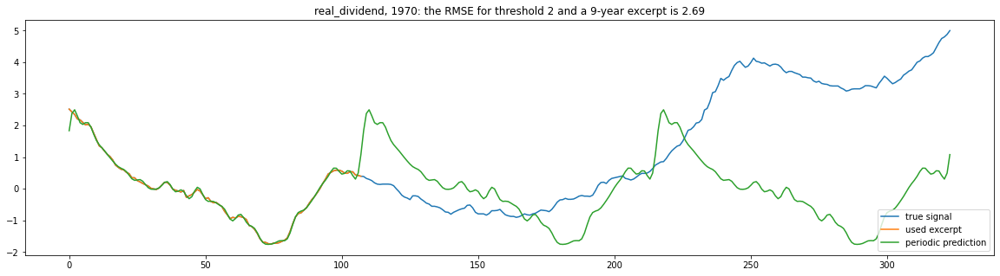

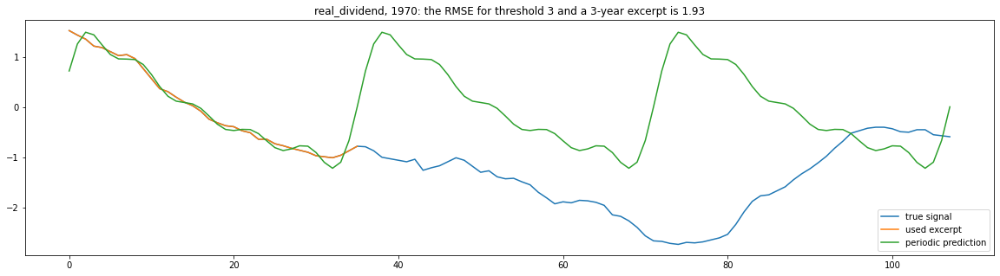

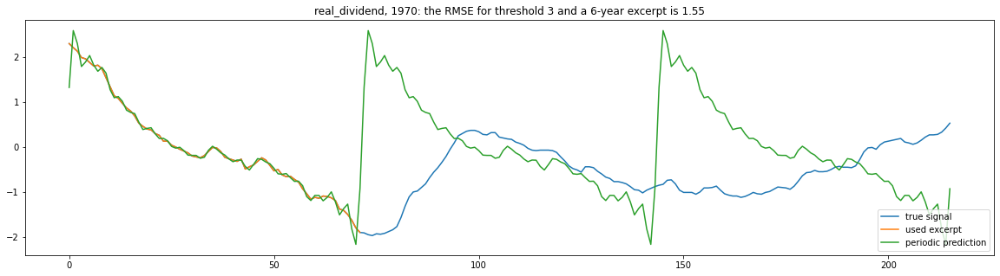

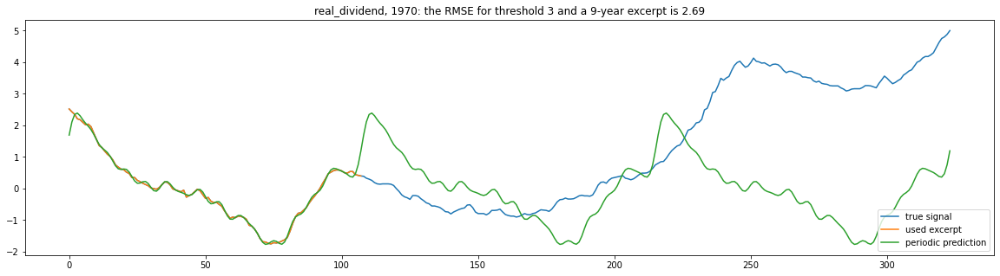

***********************
*** Start at year: 1980***
***********************


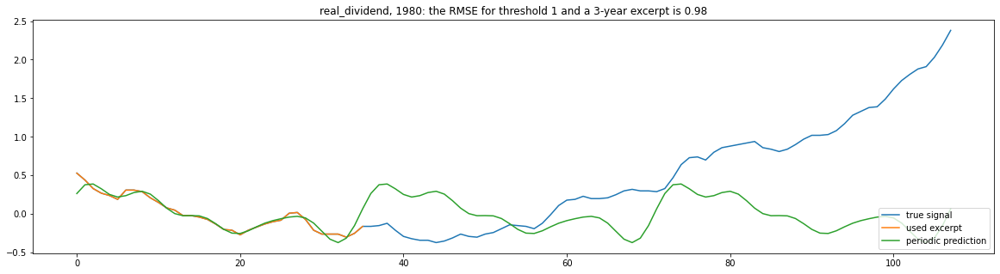

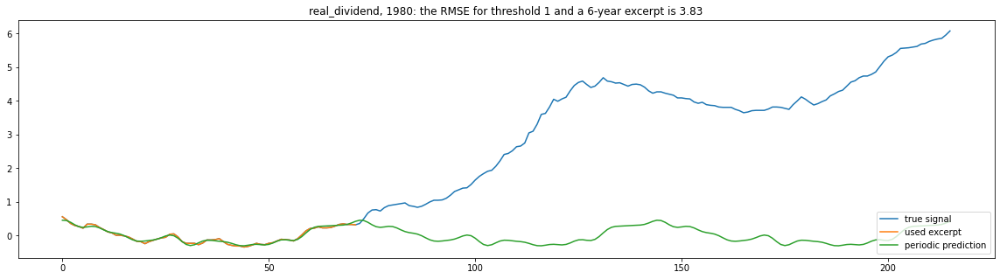

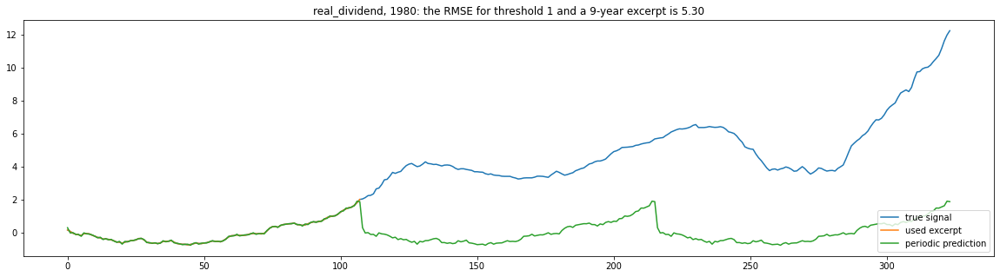

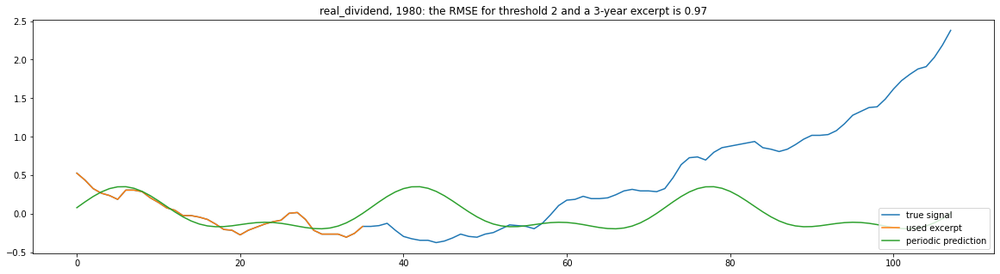

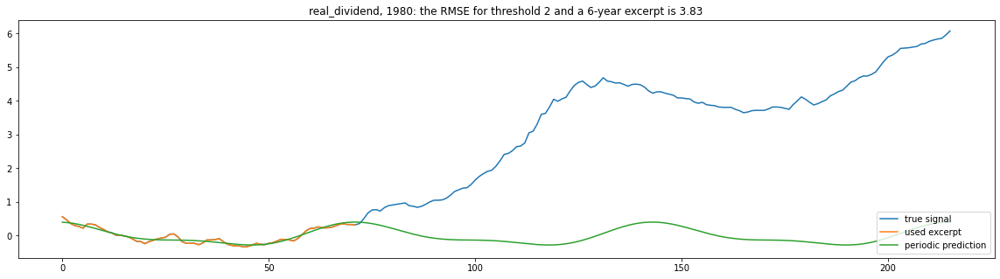

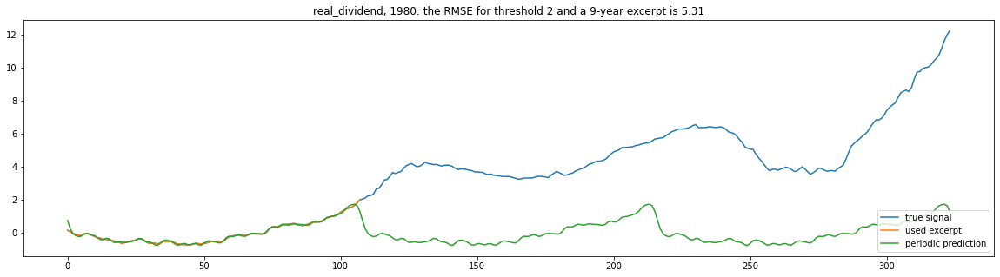

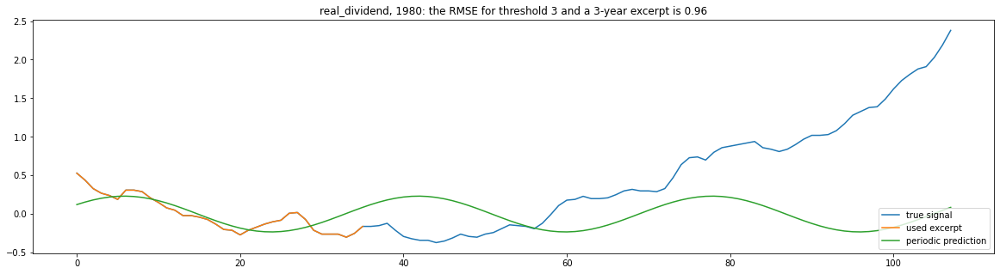

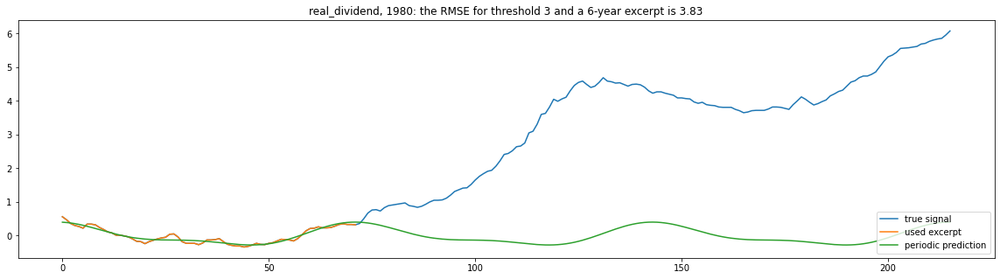

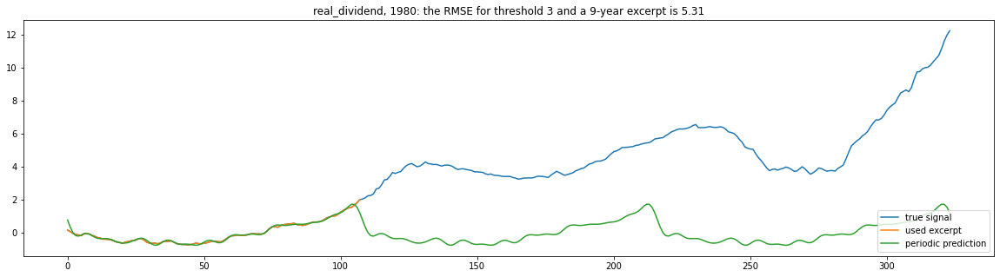

***********************
*** Start at year: 1990***
***********************


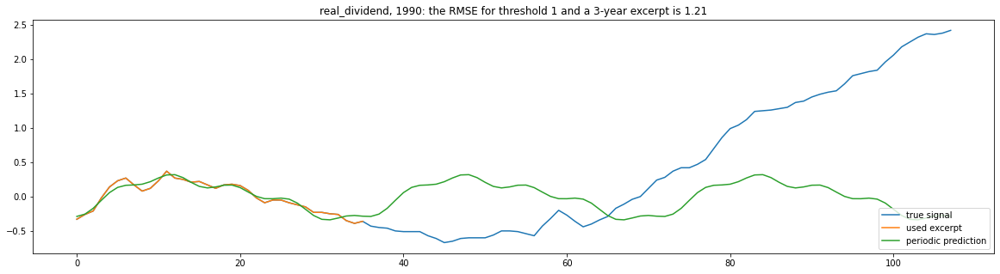

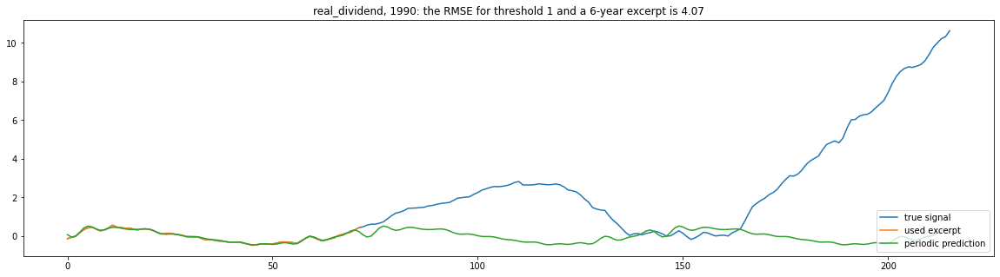

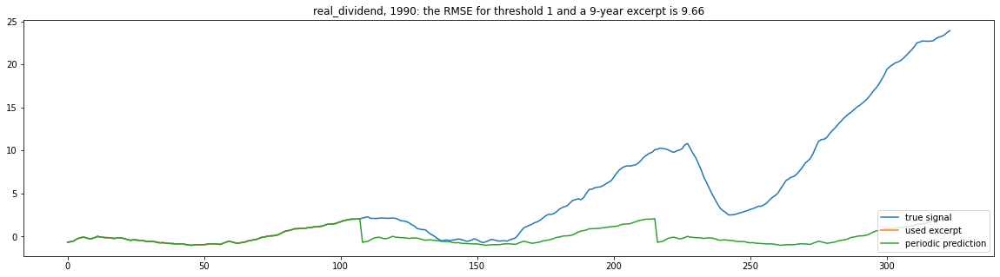

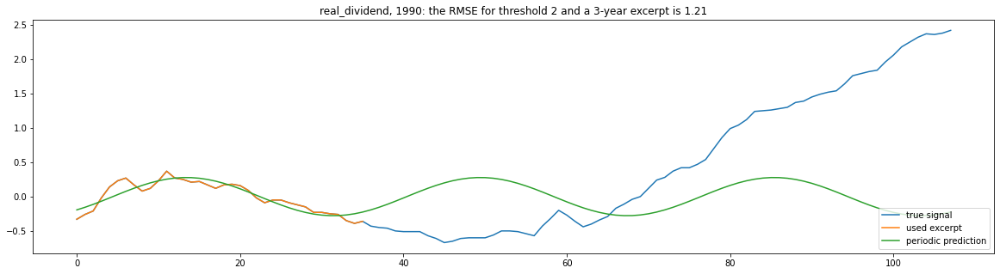

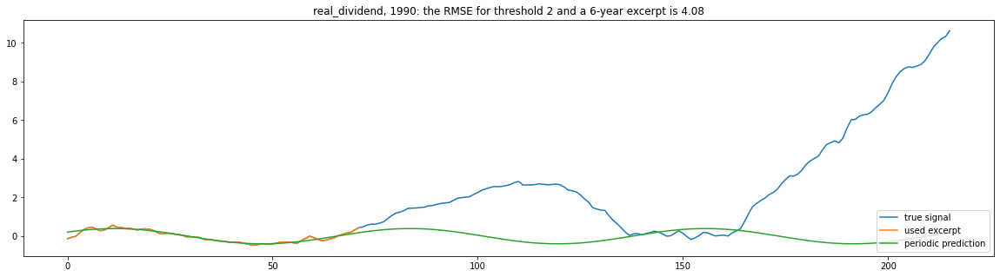

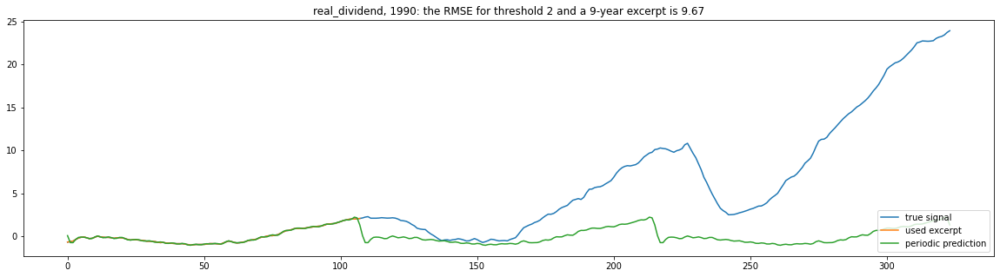

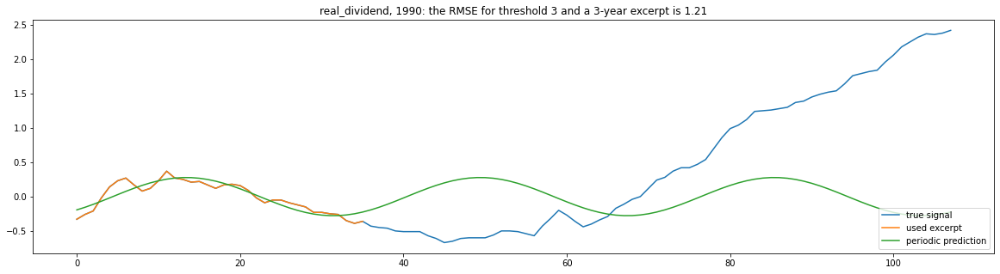

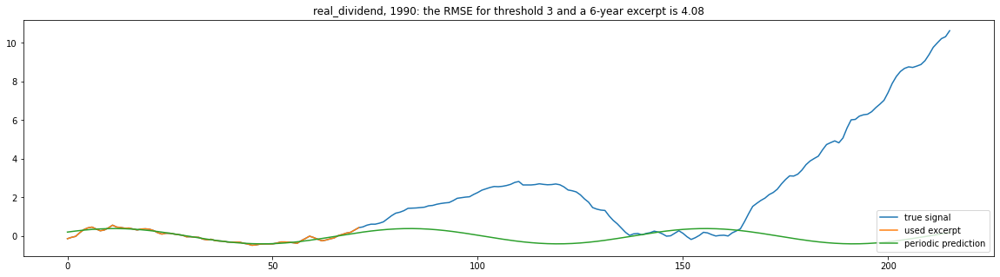

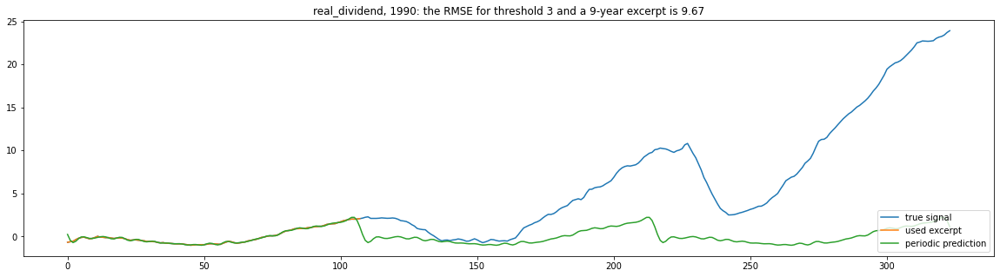

***********************
*** Start at year: 1940***
***********************


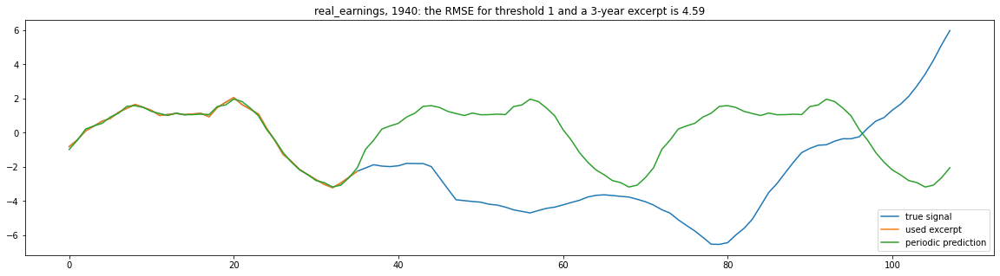

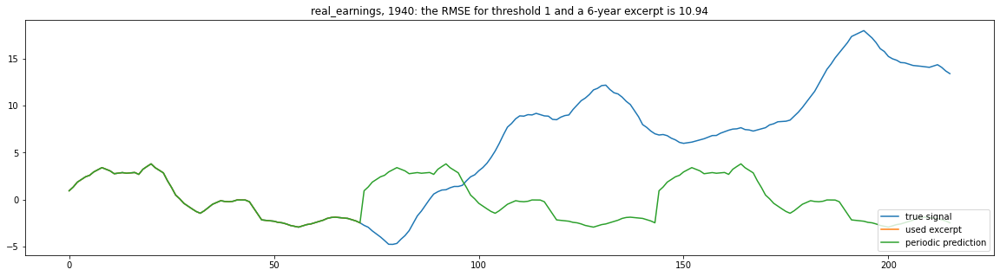

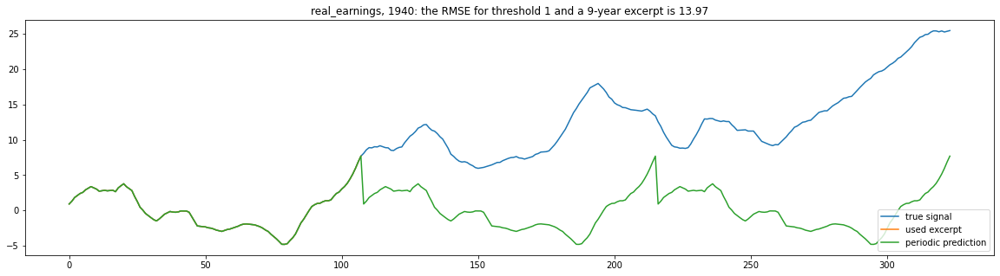

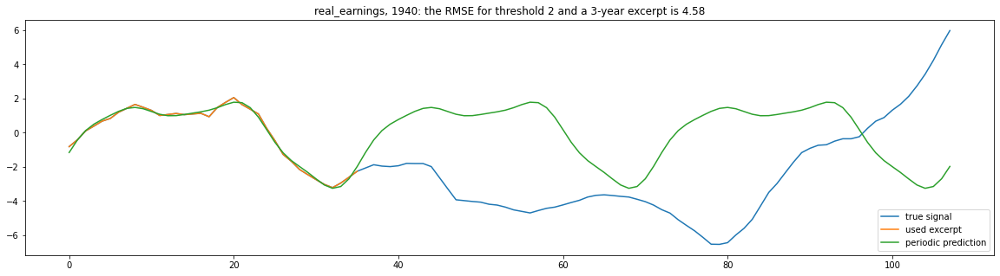

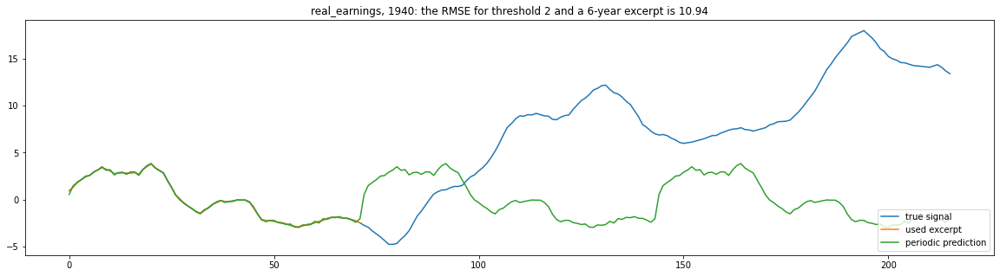

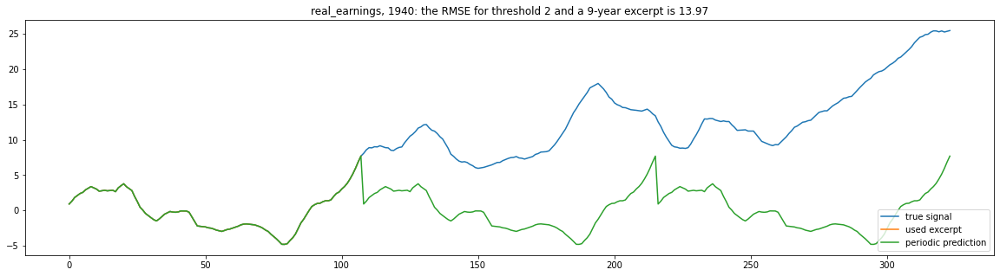

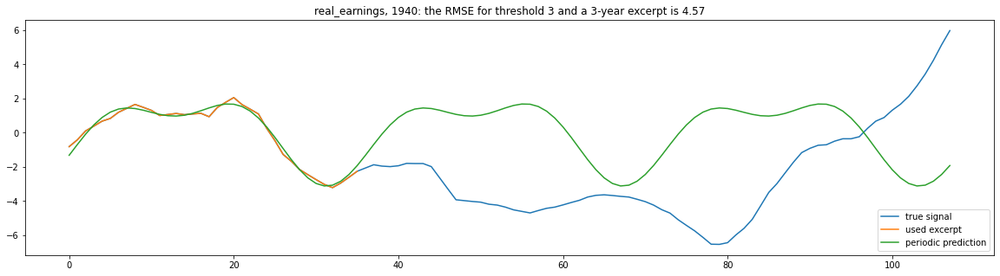

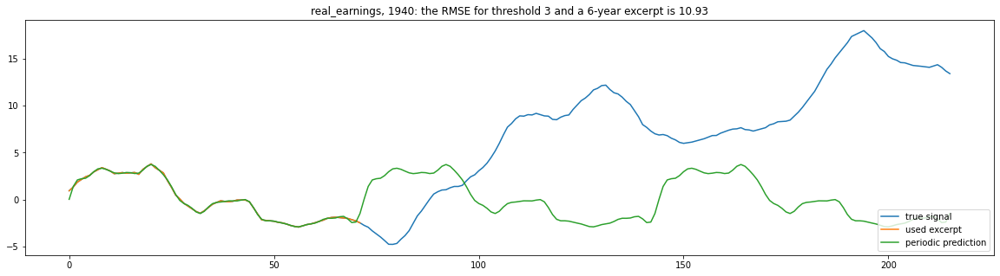

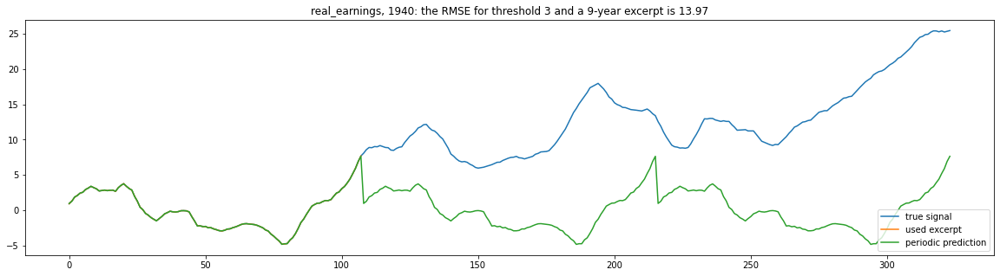

***********************
*** Start at year: 1950***
***********************


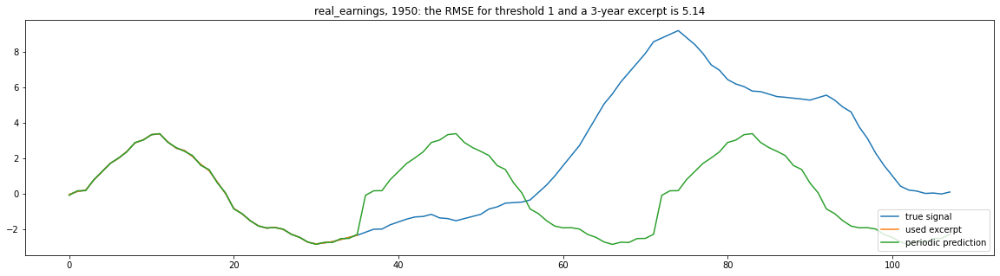

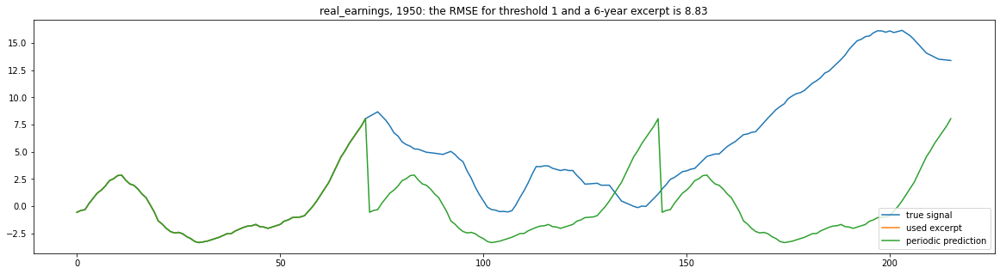

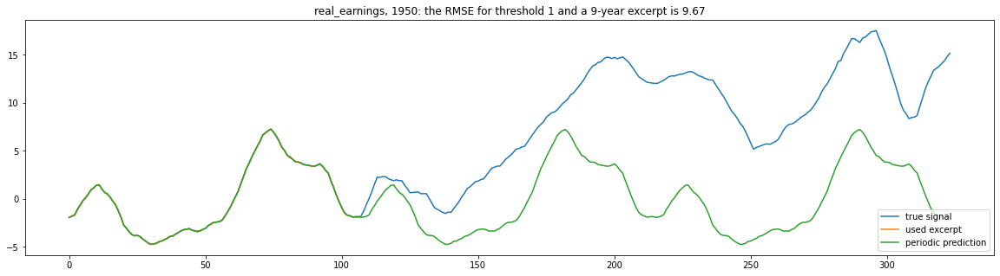

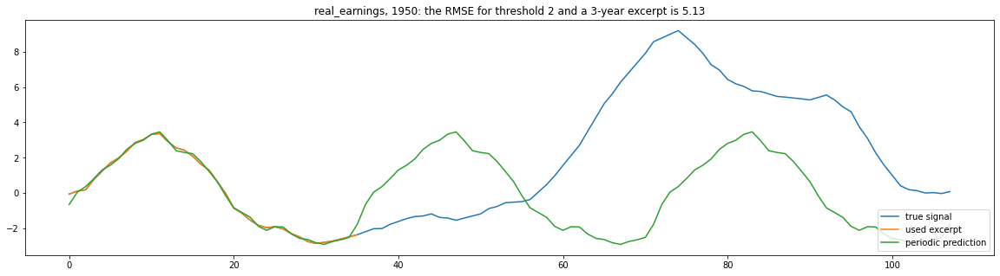

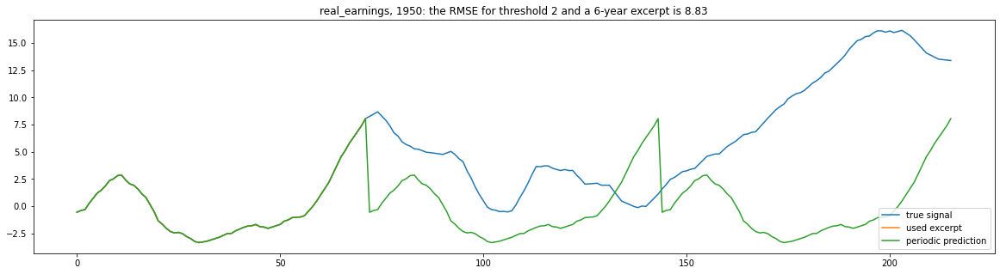

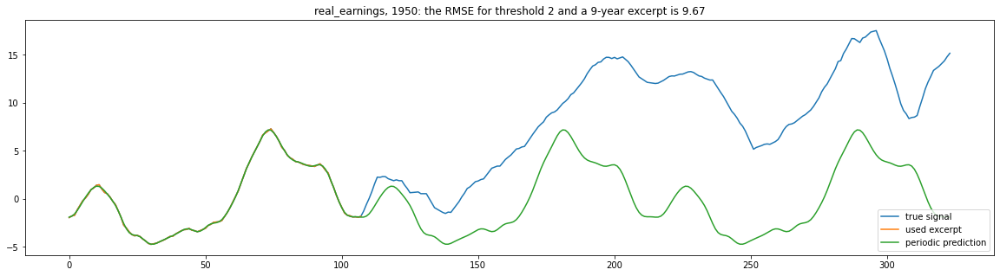

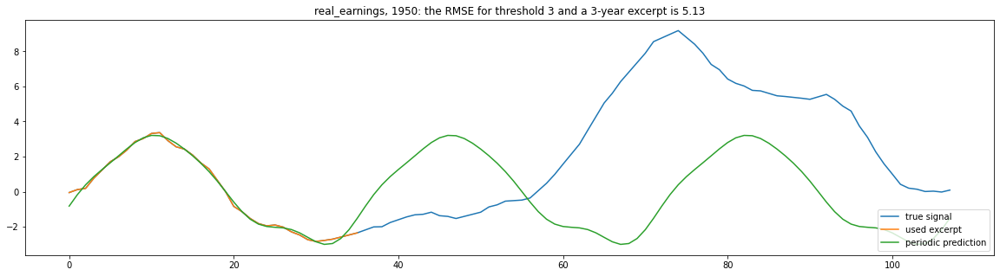

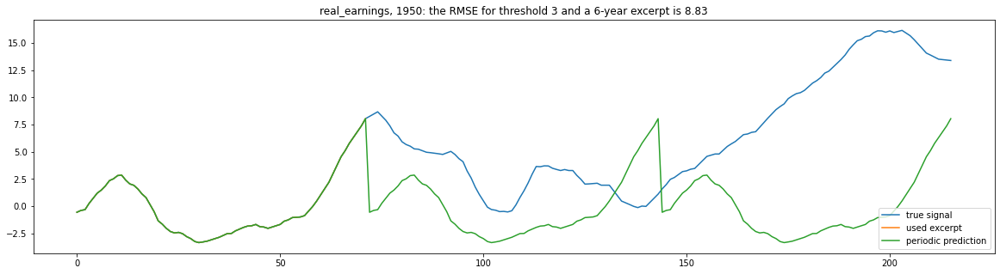

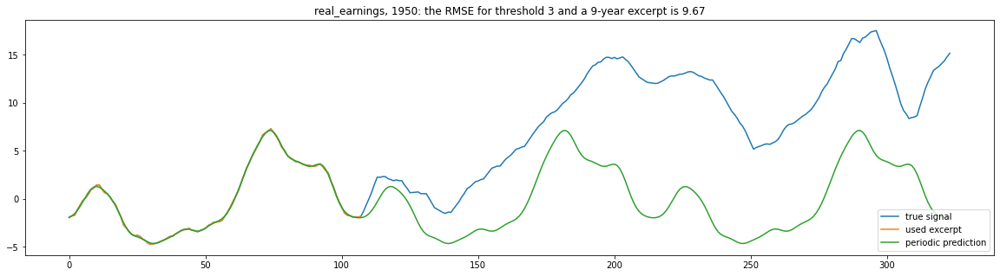

***********************
*** Start at year: 1960***
***********************


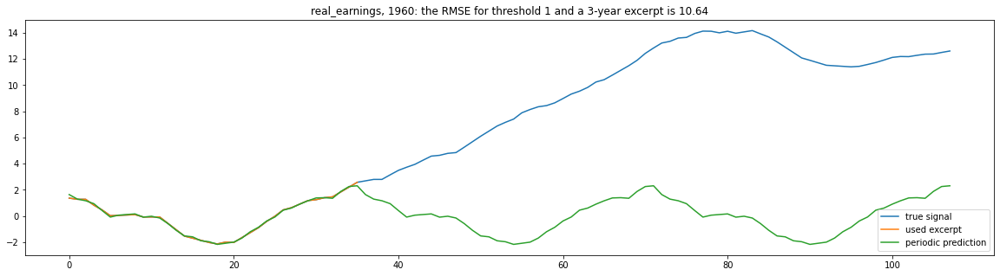

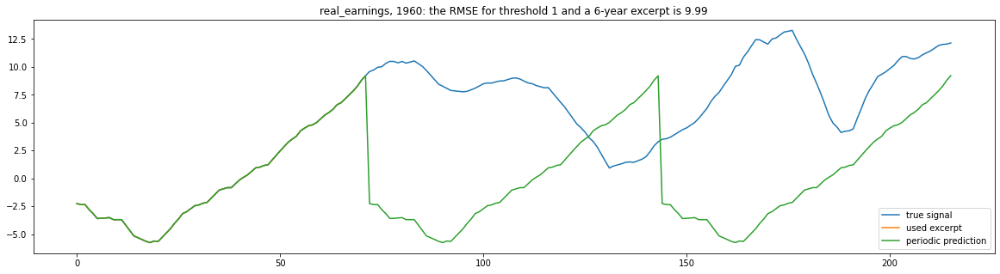

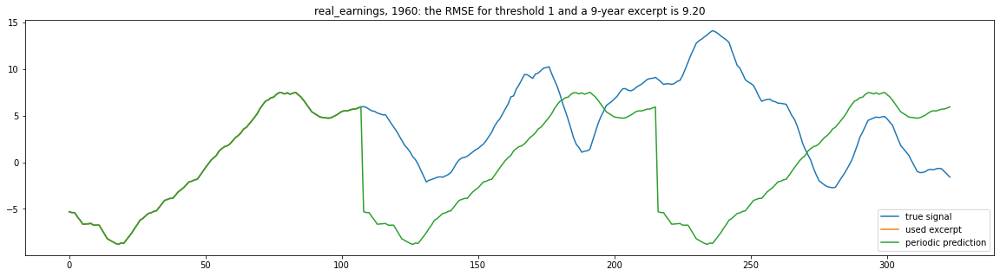

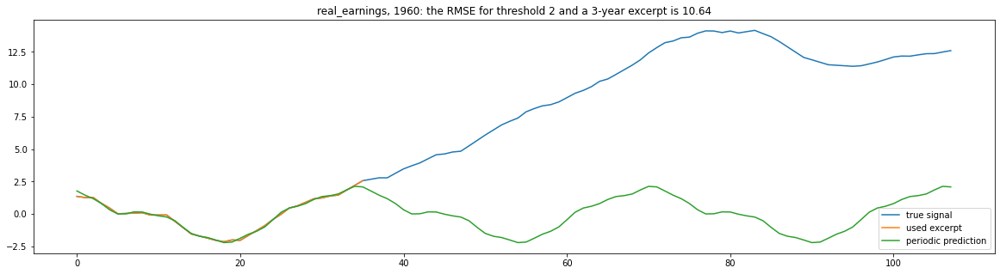

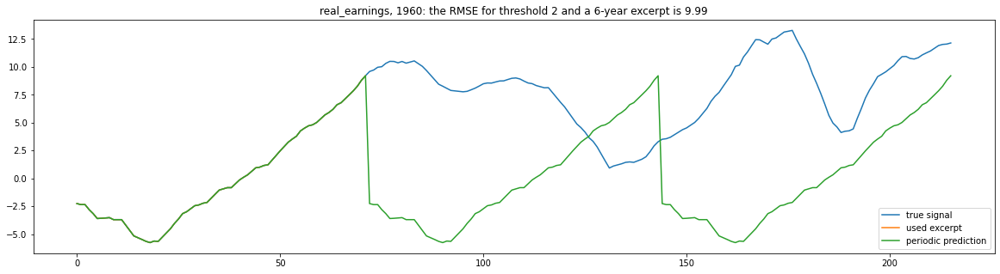

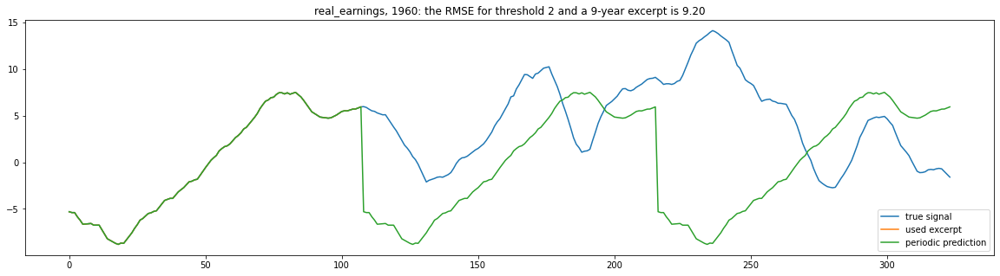

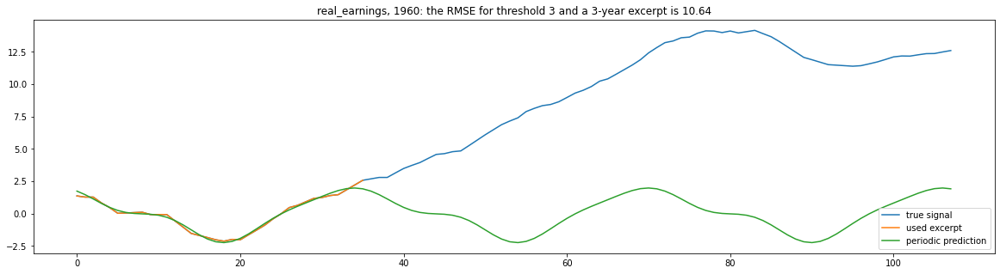

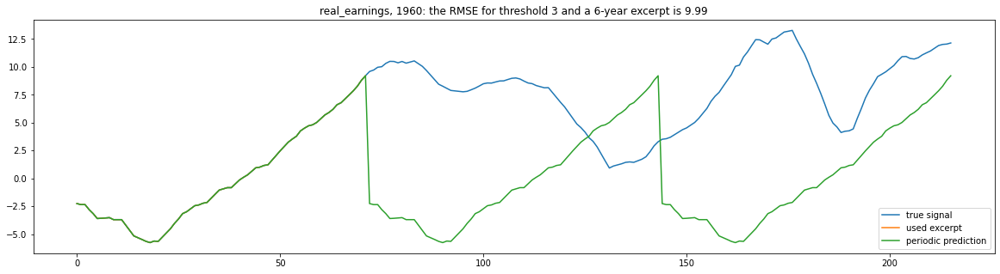

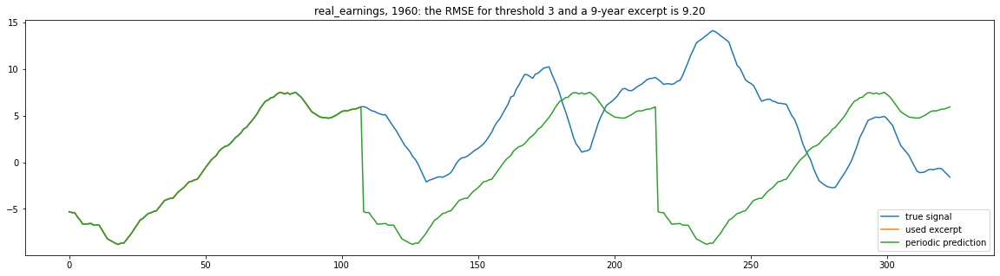

***********************
*** Start at year: 1970***
***********************


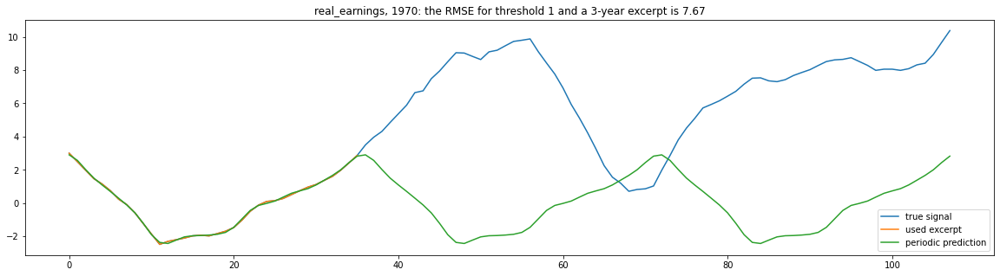

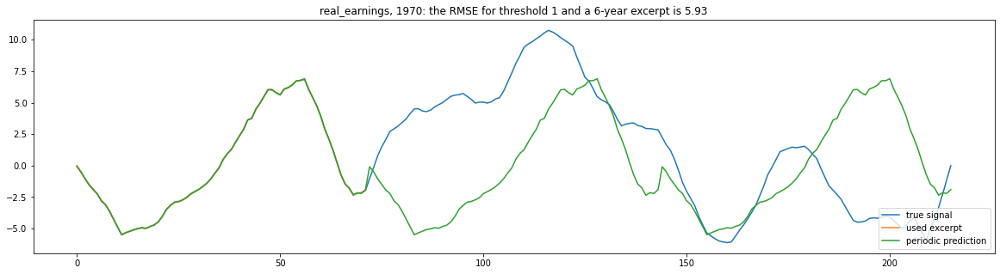

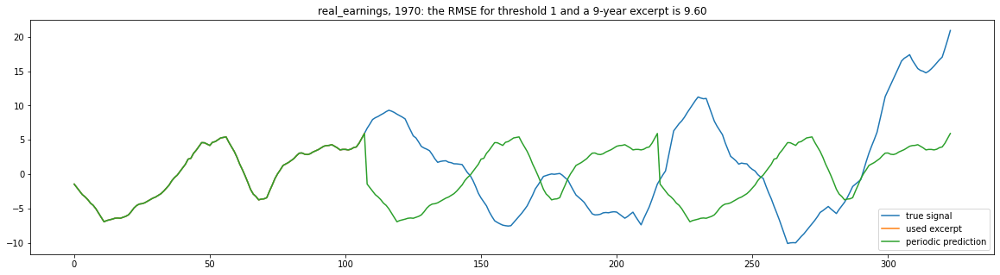

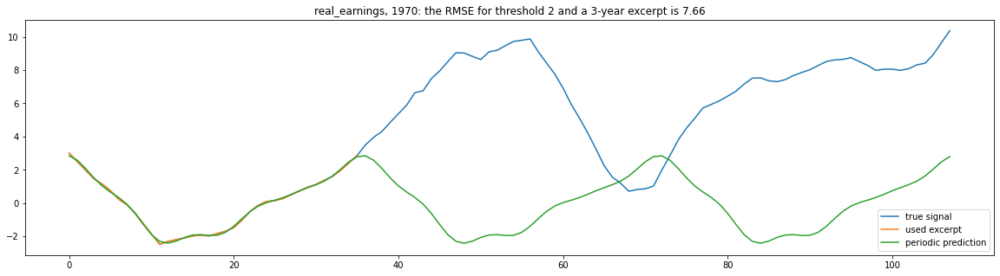

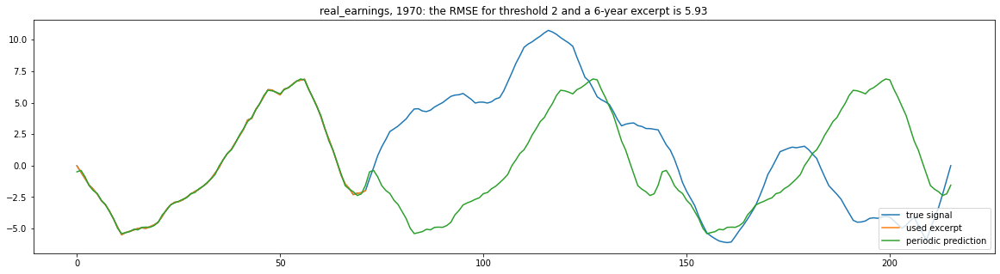

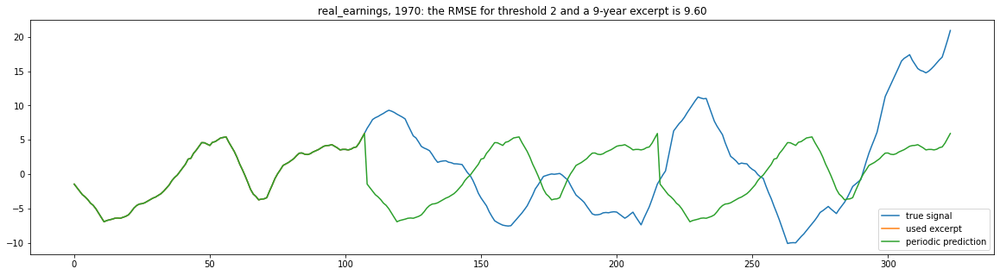

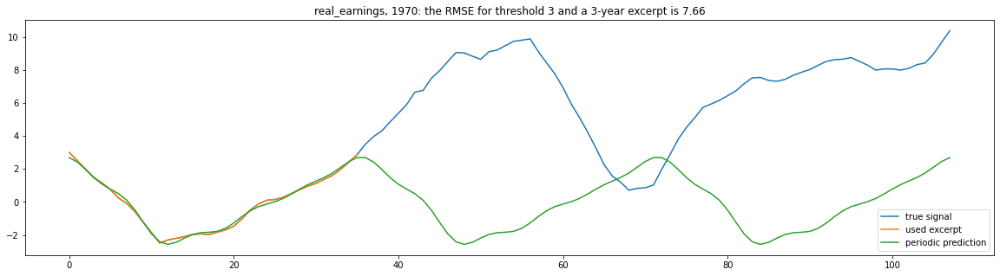

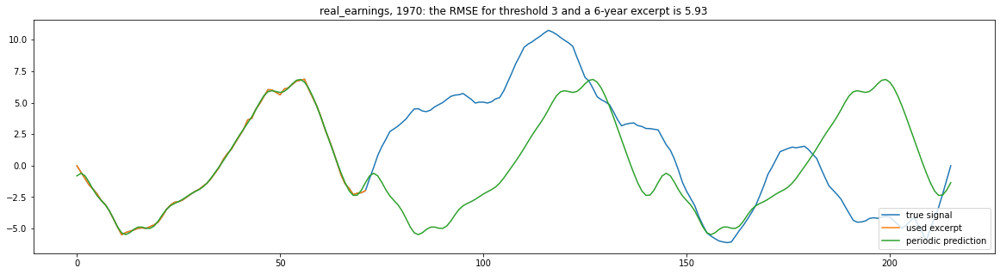

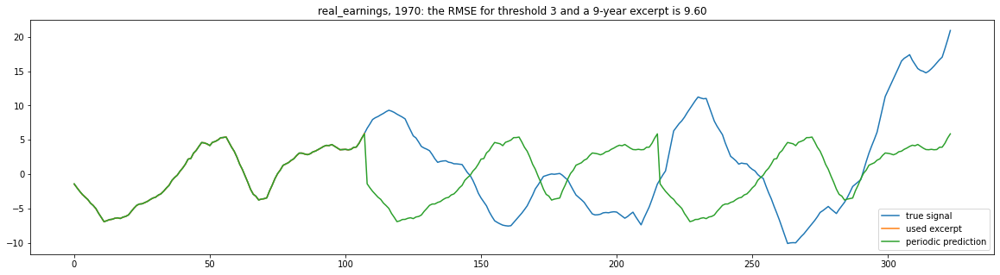

***********************
*** Start at year: 1980***
***********************


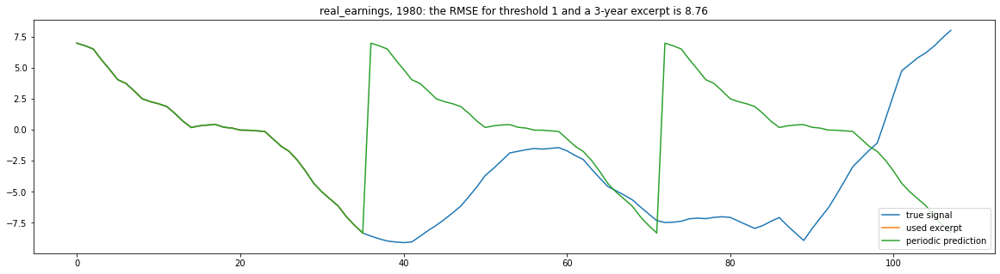

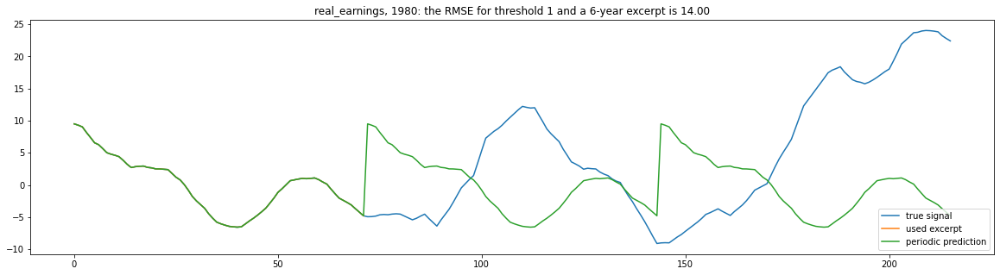

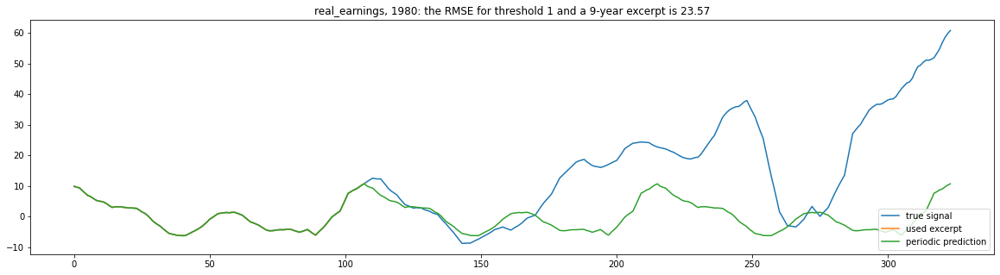

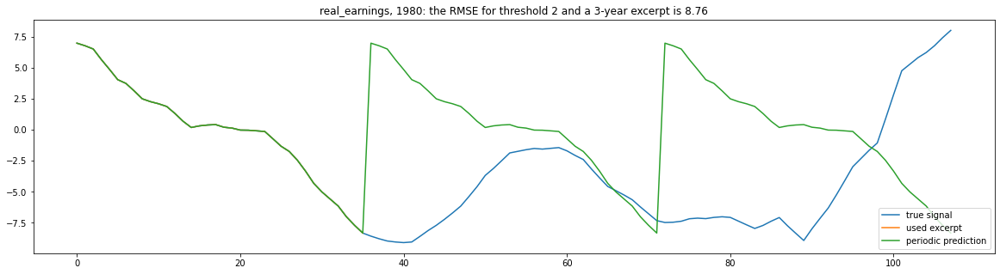

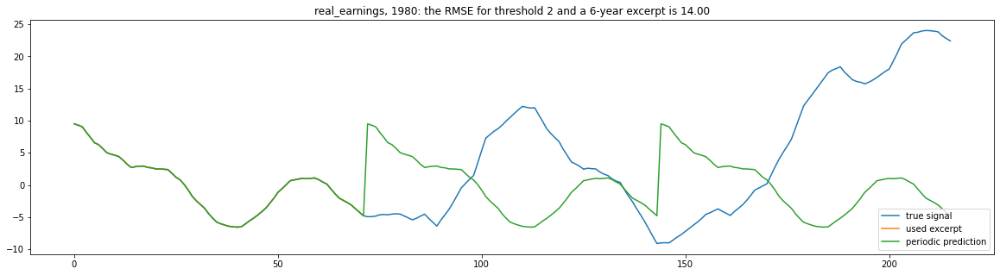

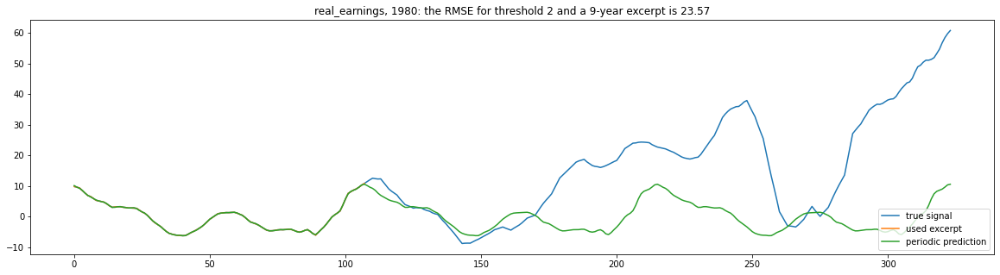

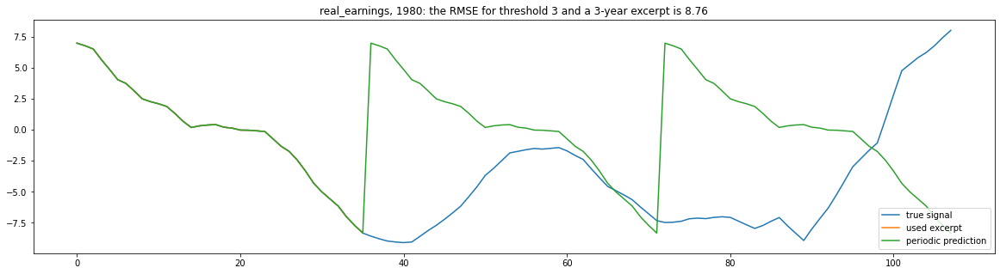

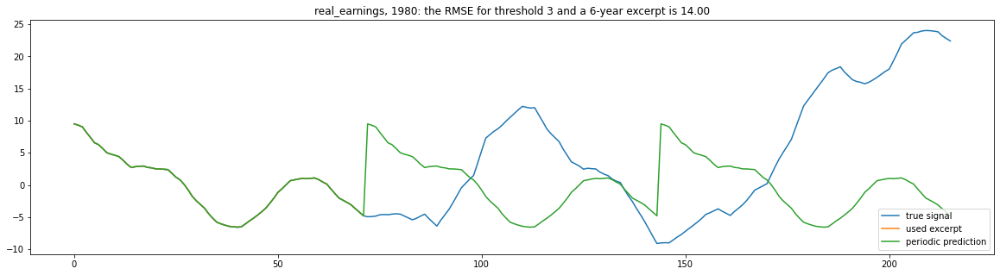

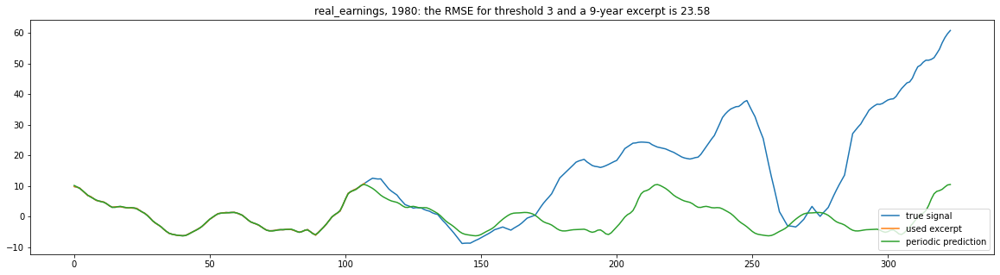

***********************
*** Start at year: 1990***
***********************


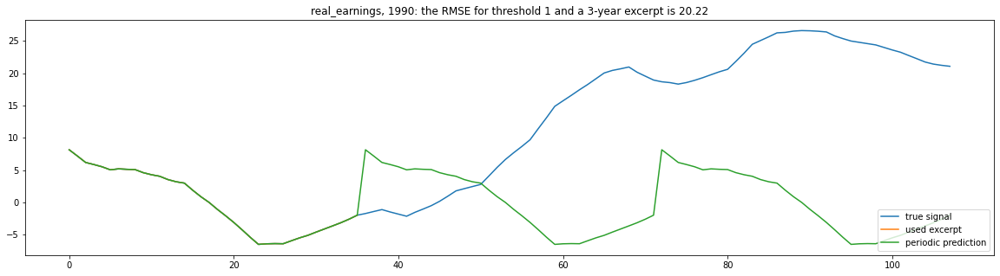

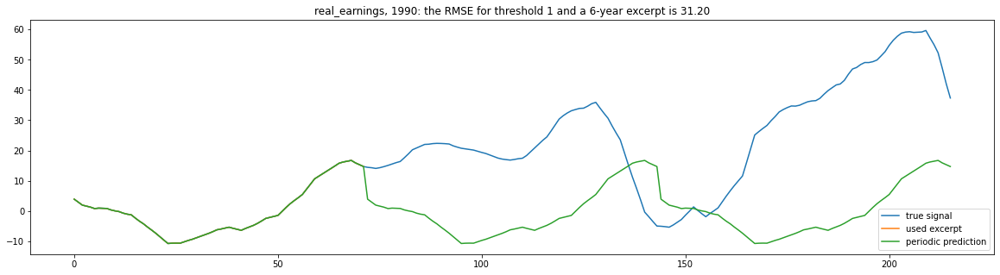

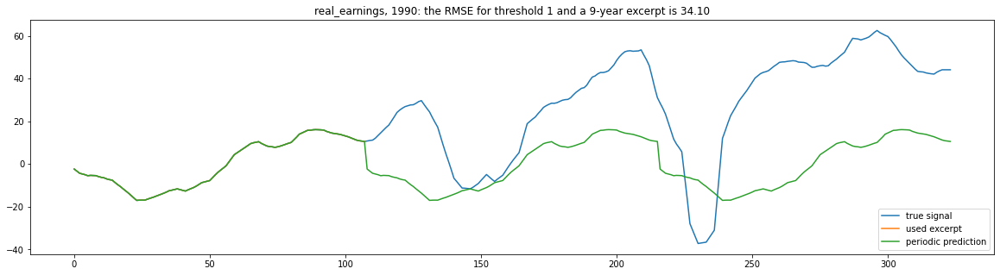

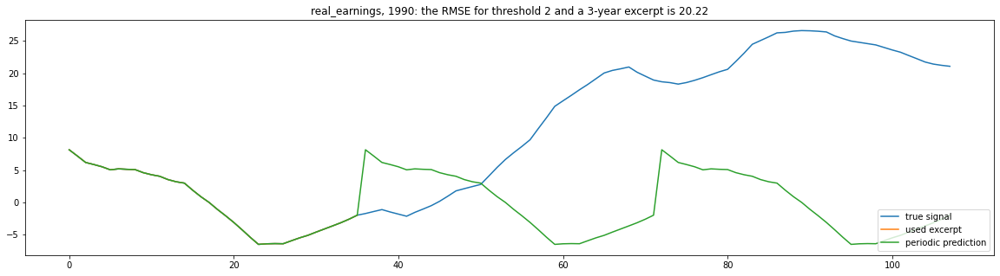

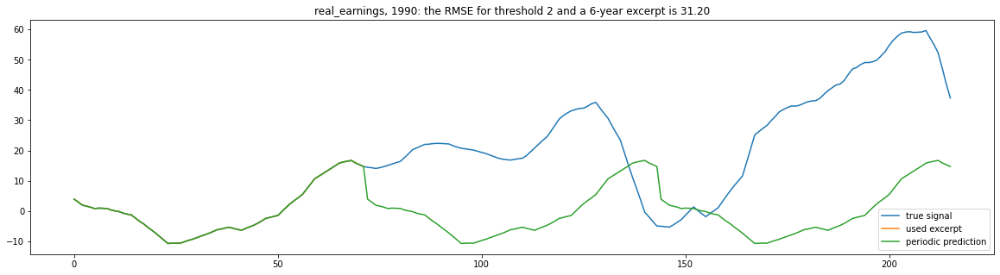

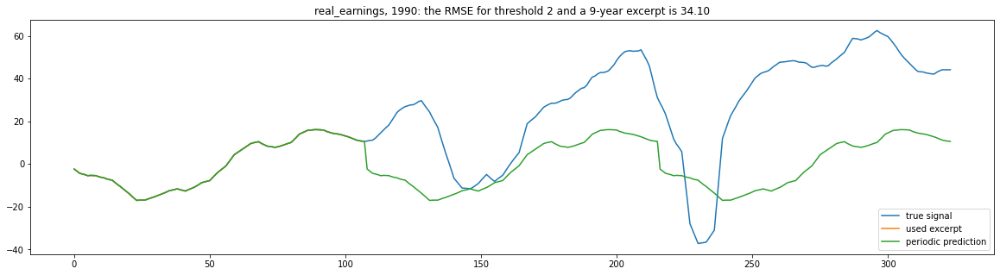

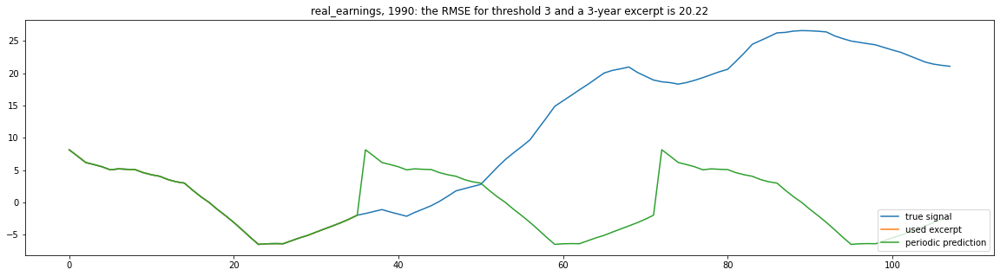

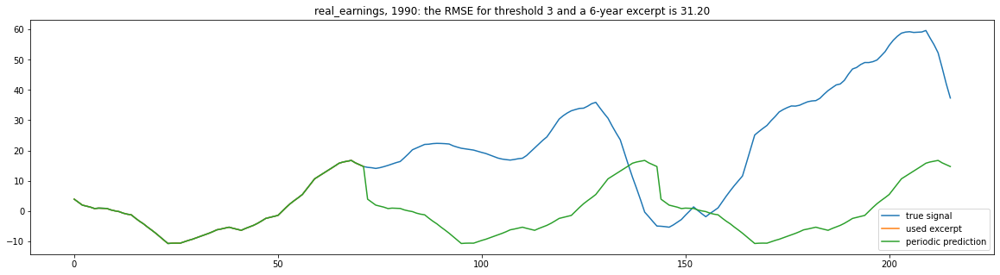

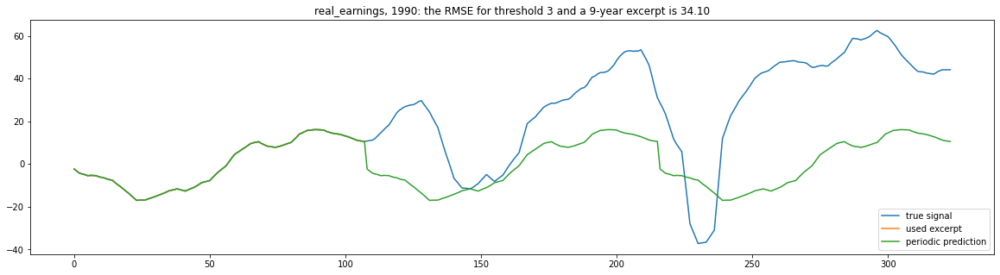

***********************
*** Start at year: 1940***
***********************


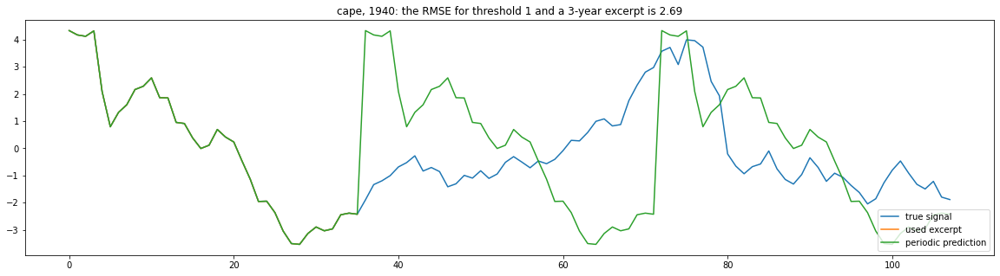

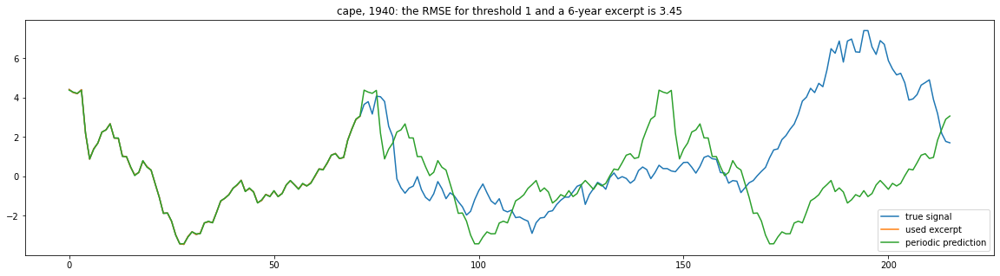

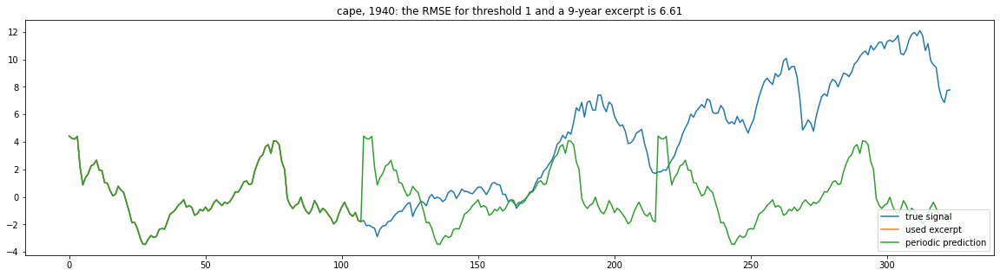

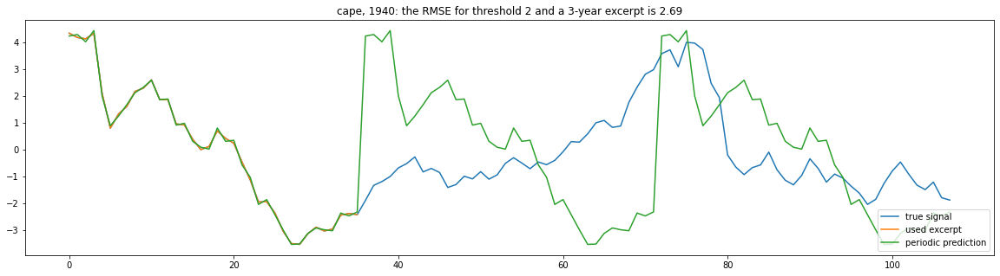

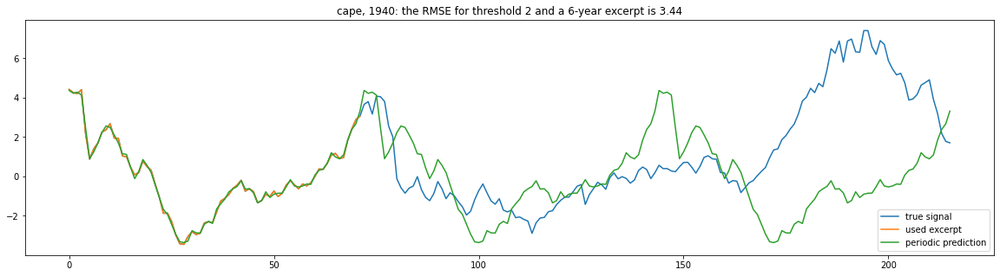

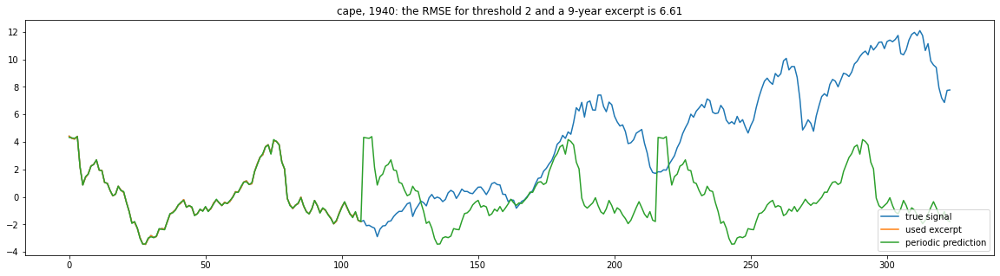

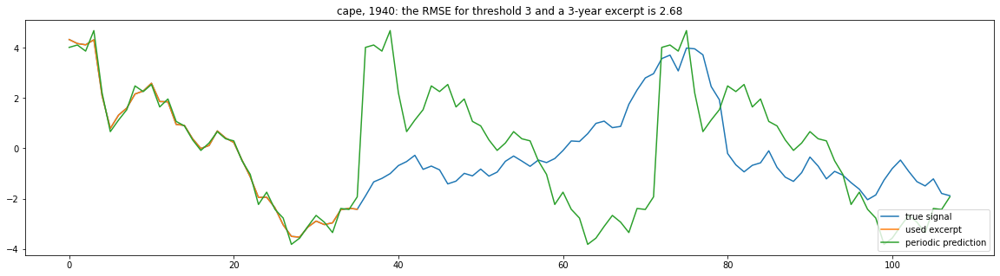

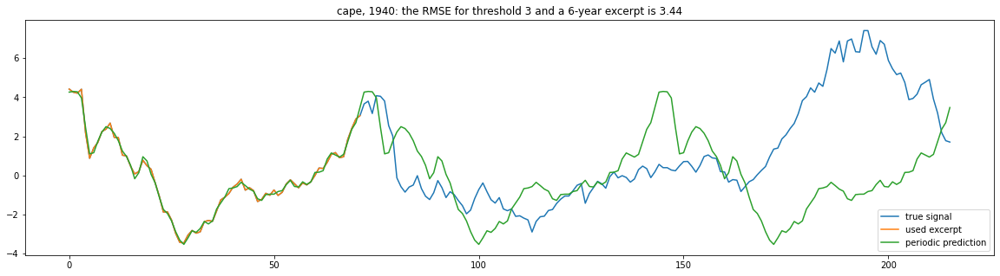

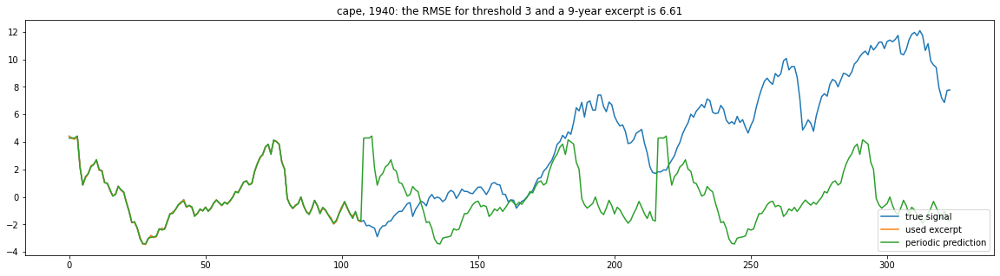

***********************
*** Start at year: 1950***
***********************


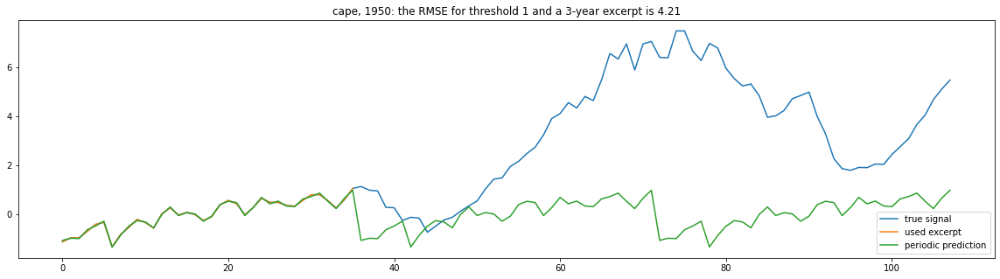

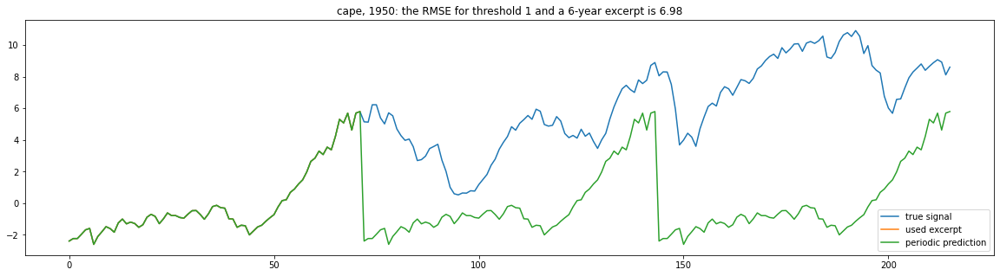

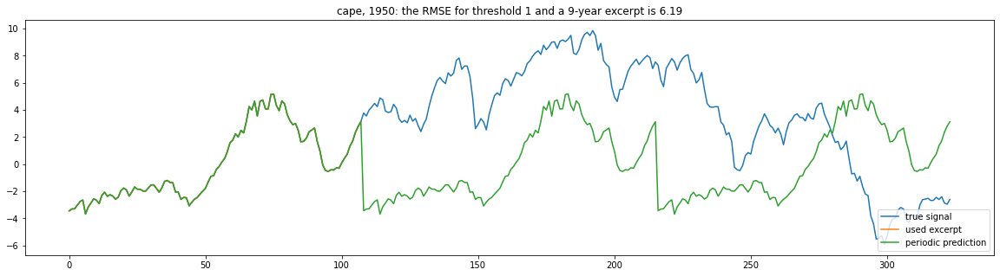

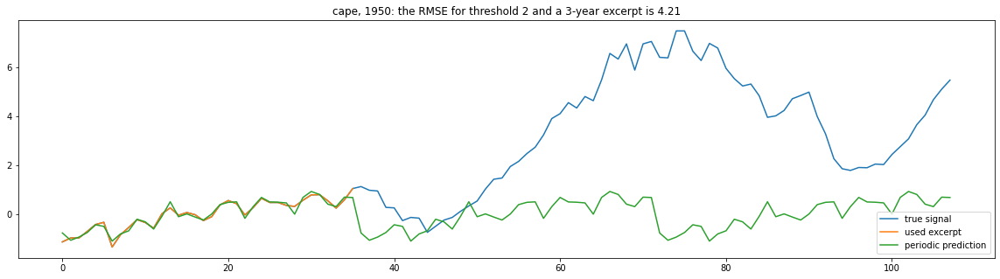

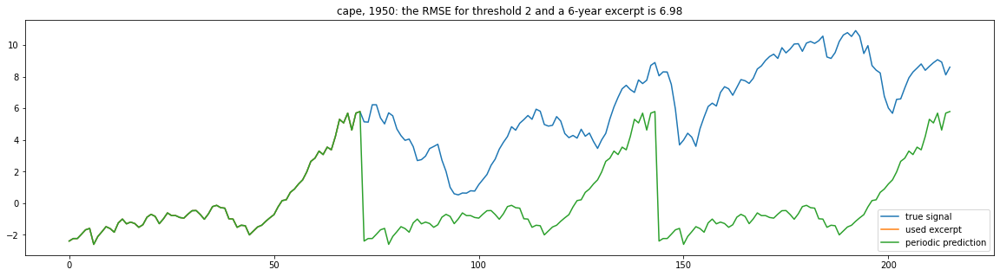

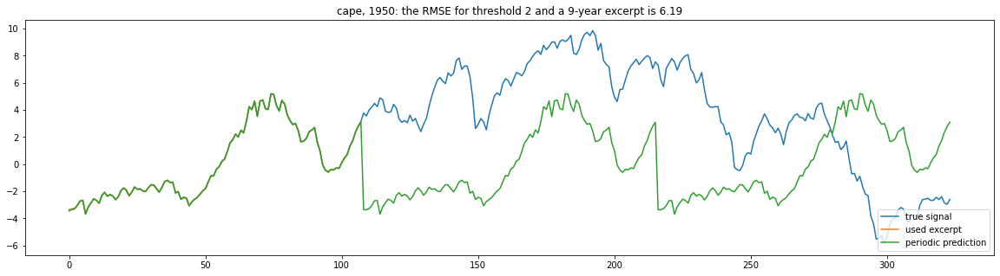

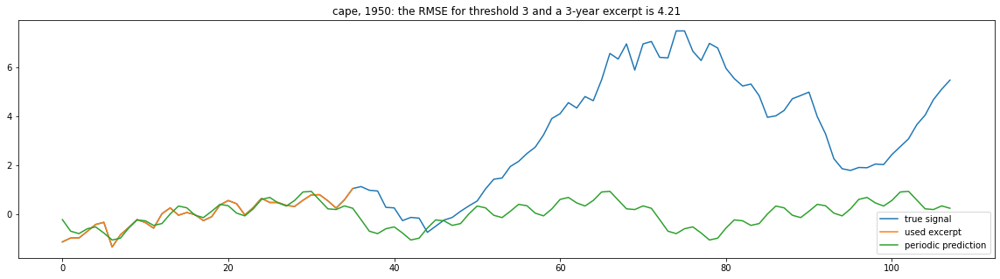

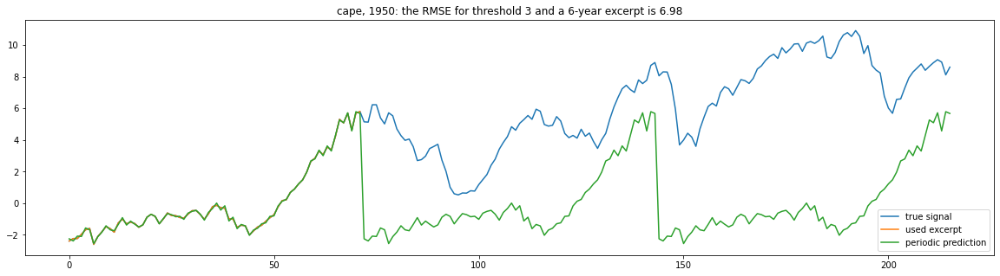

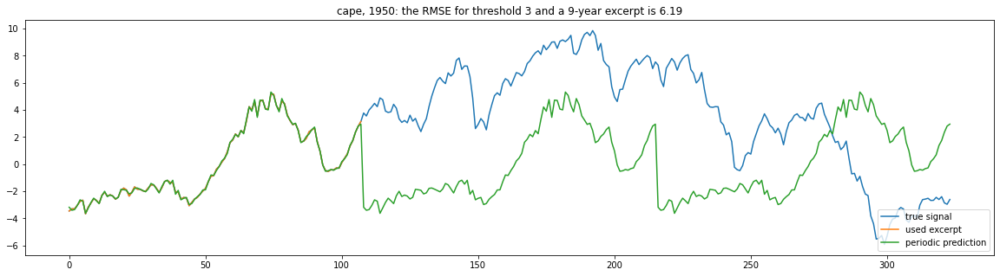

***********************
*** Start at year: 1960***
***********************


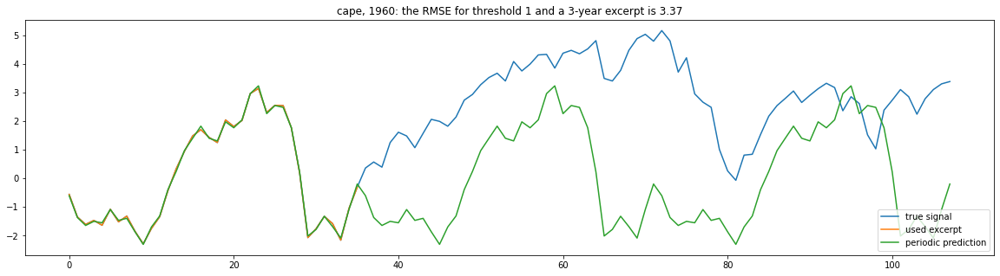

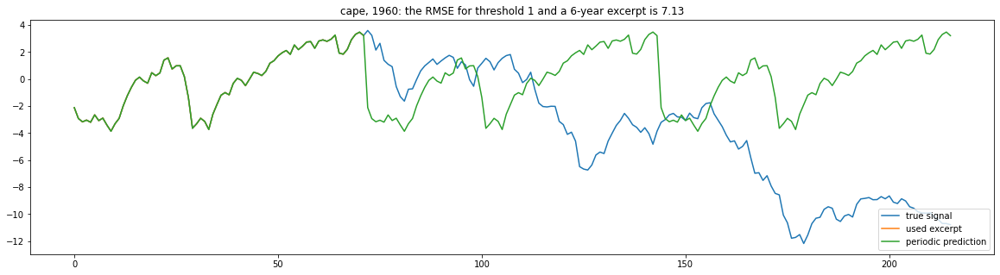

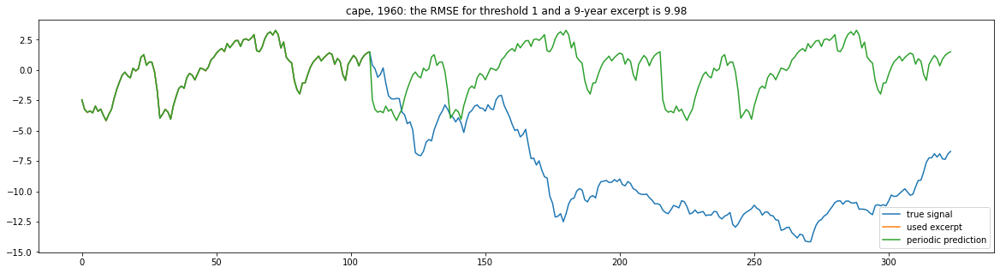

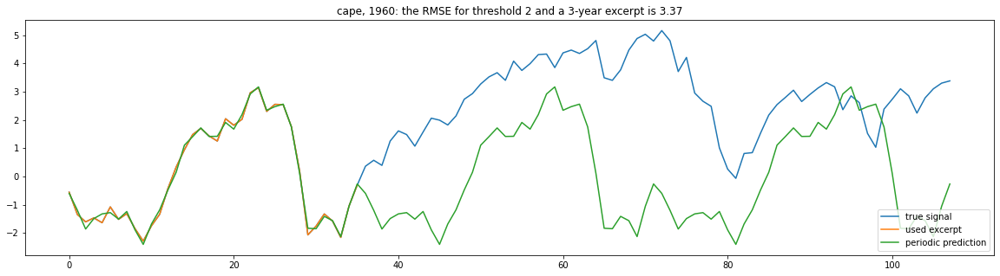

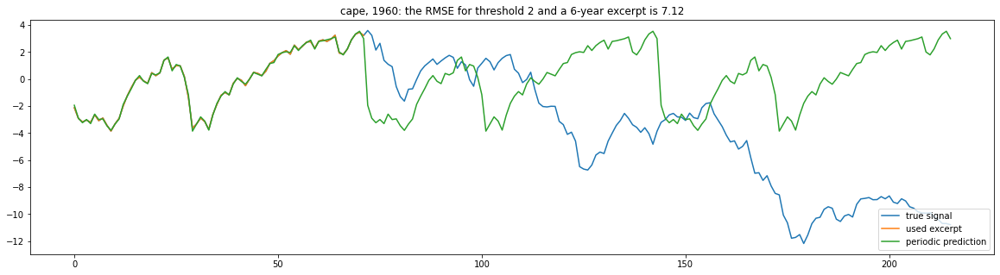

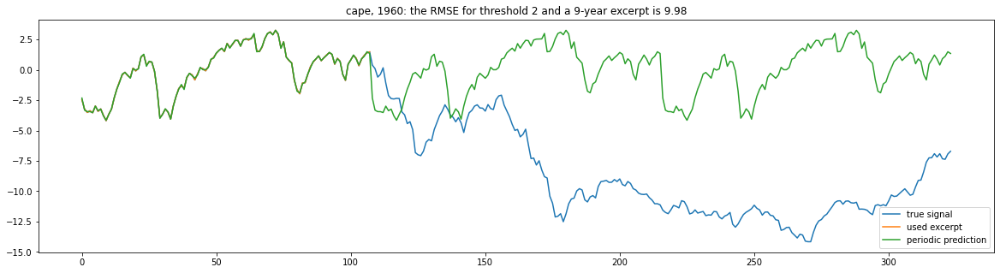

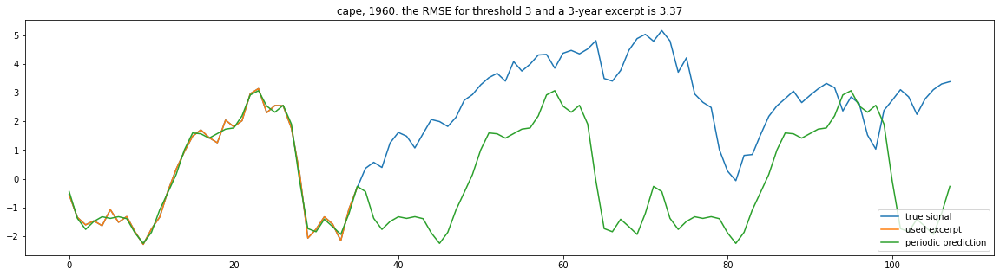

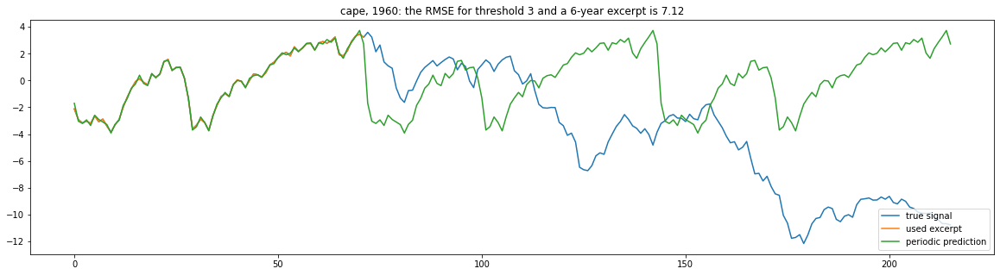

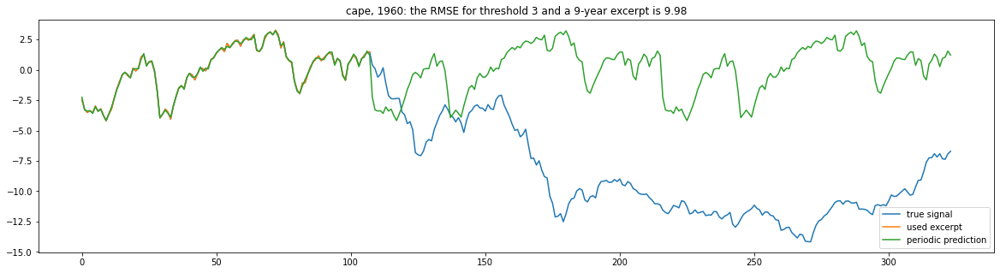

***********************
*** Start at year: 1970***
***********************


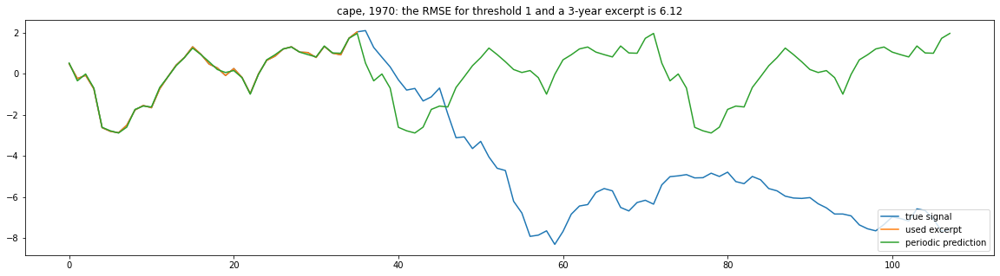

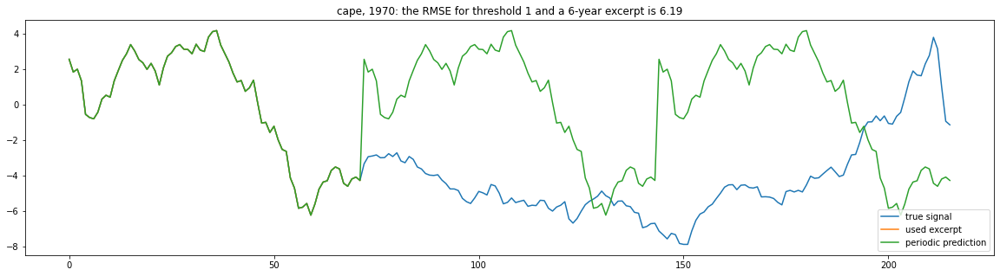

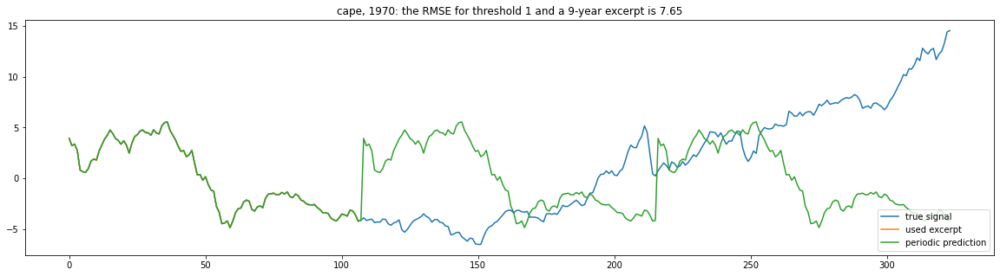

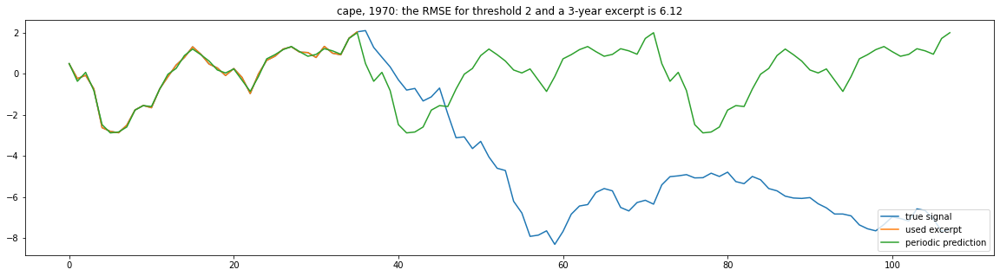

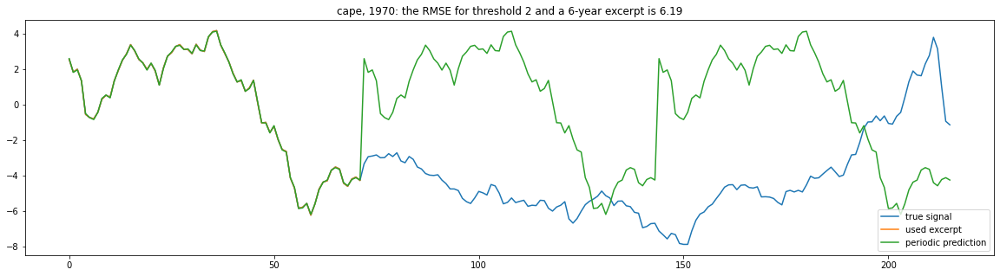

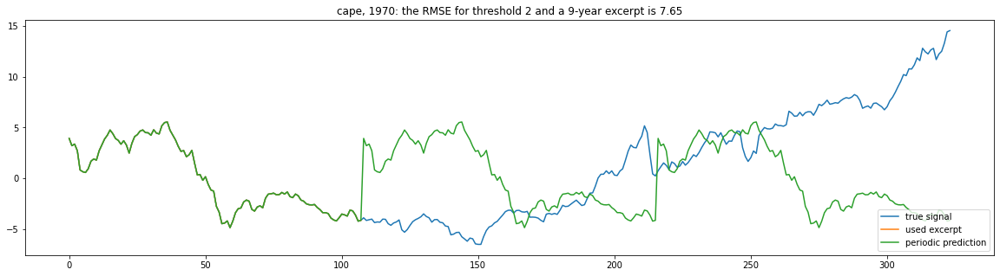

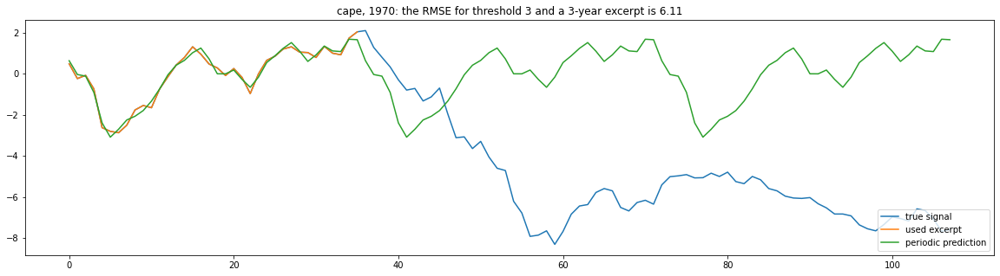

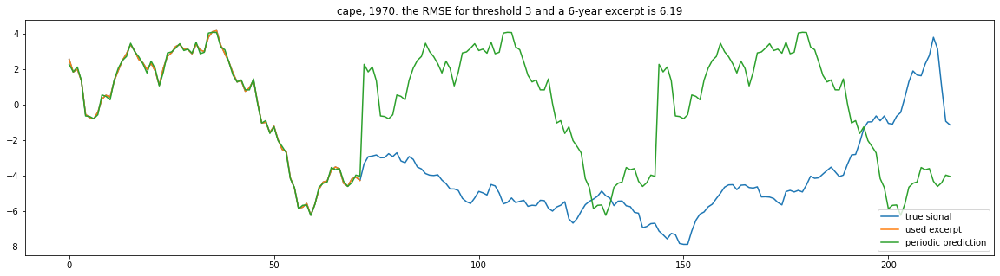

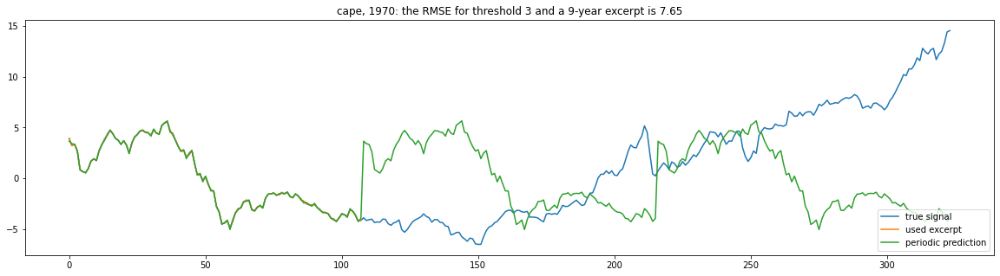

***********************
*** Start at year: 1980***
***********************


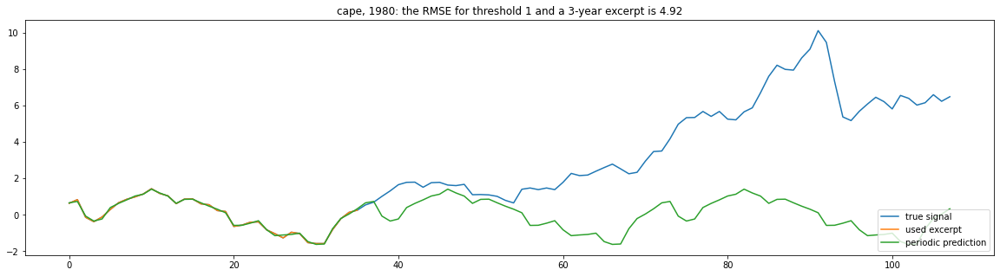

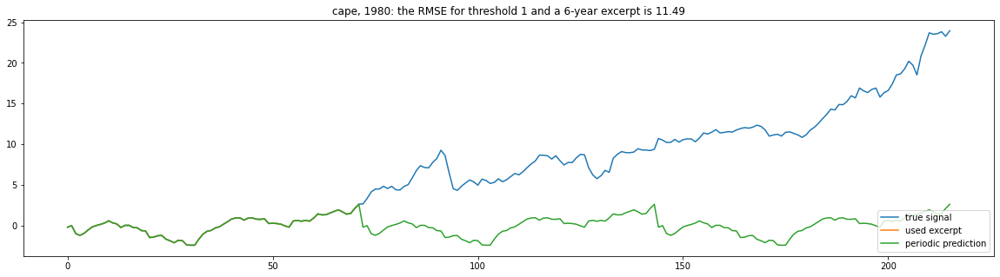

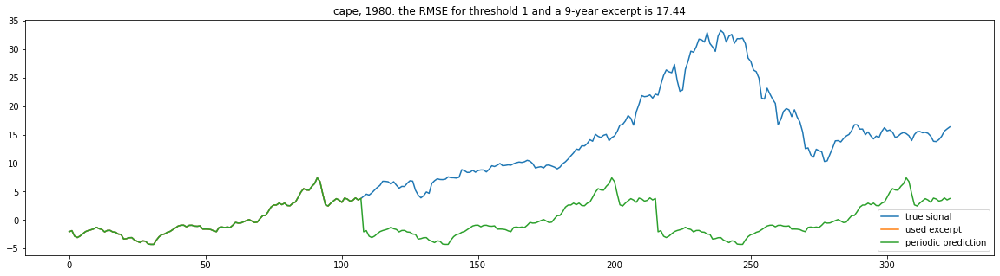

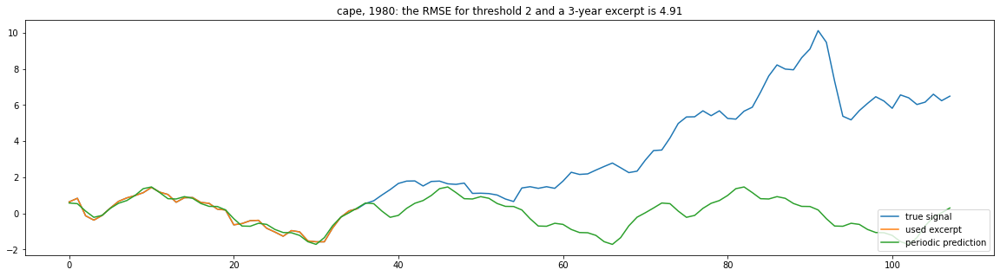

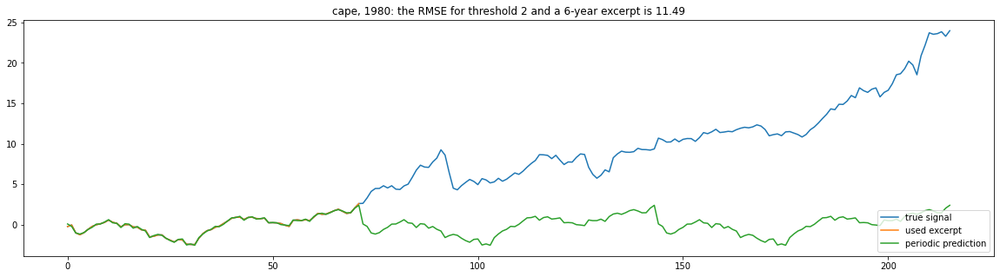

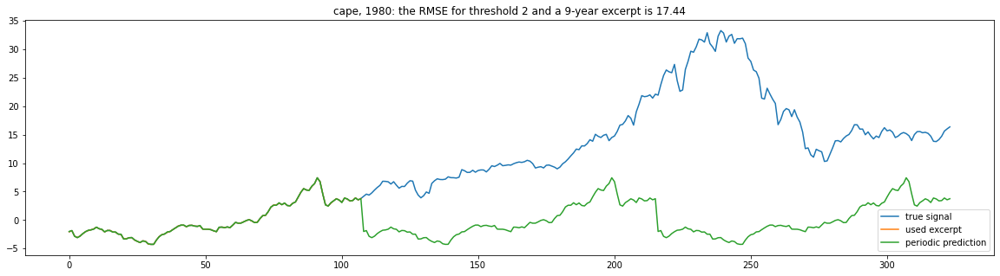

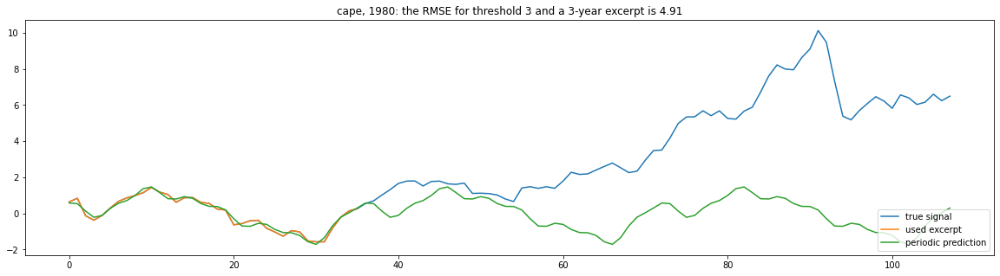

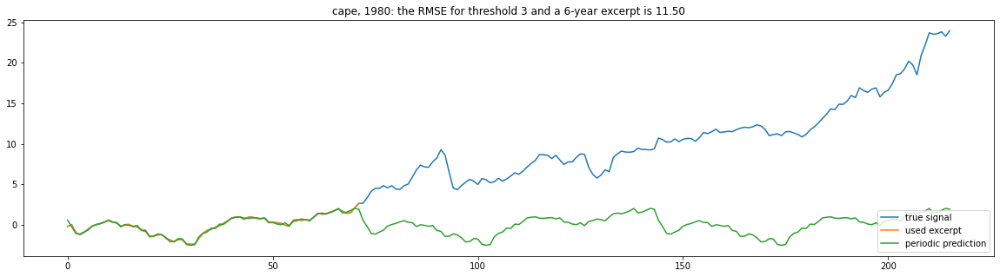

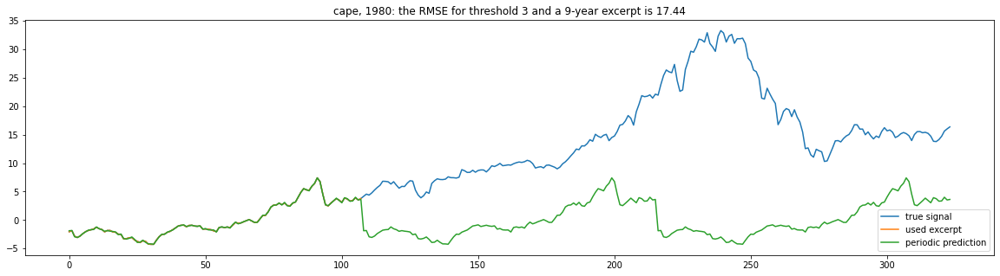

***********************
*** Start at year: 1990***
***********************


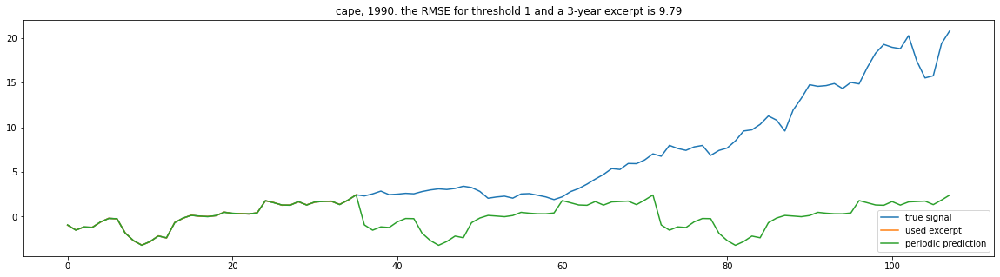

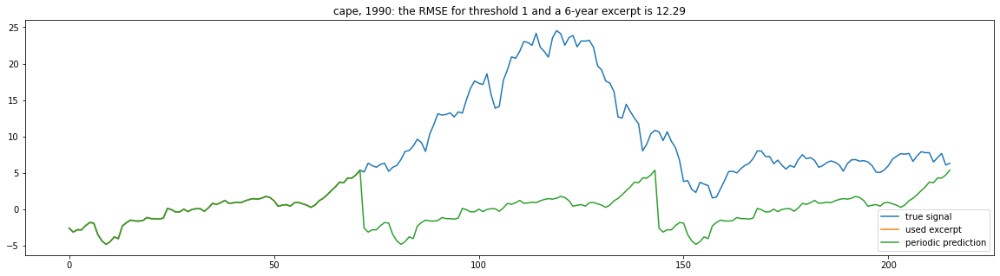

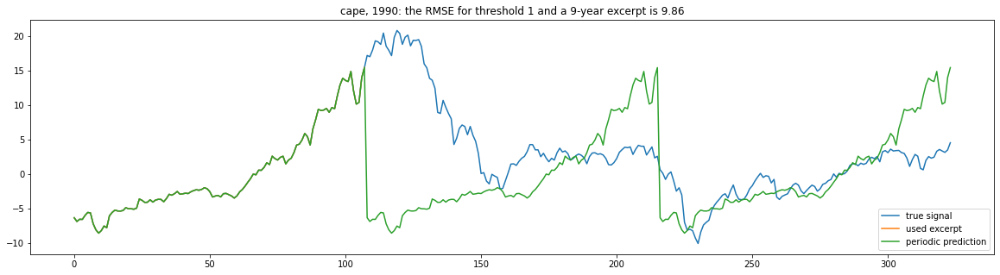

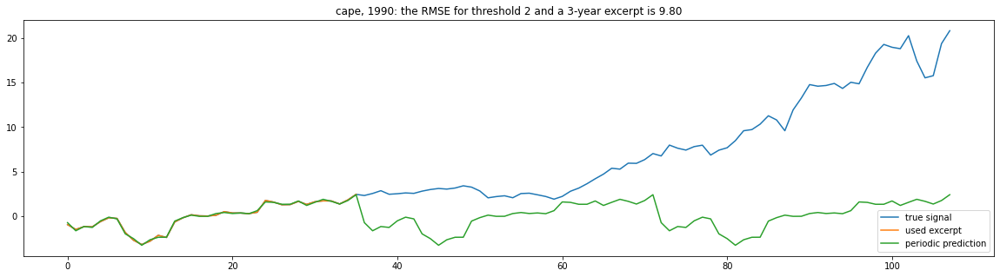

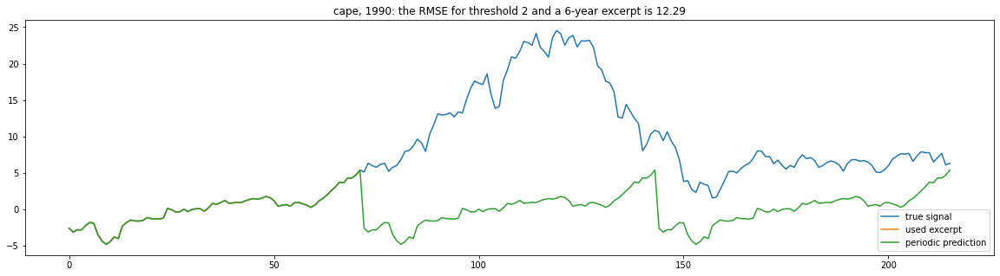

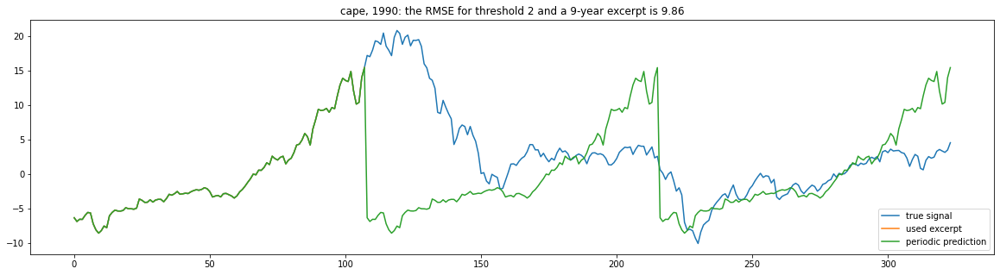

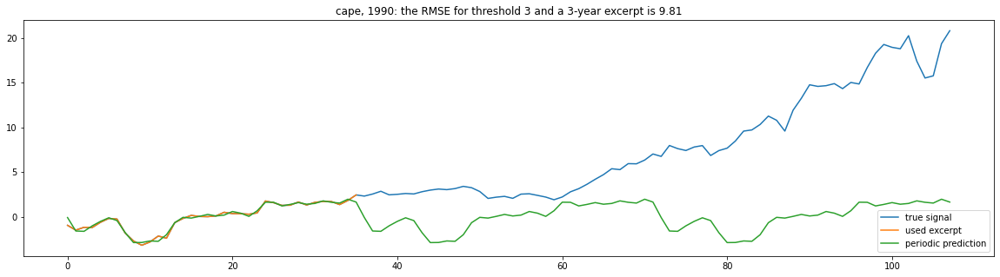

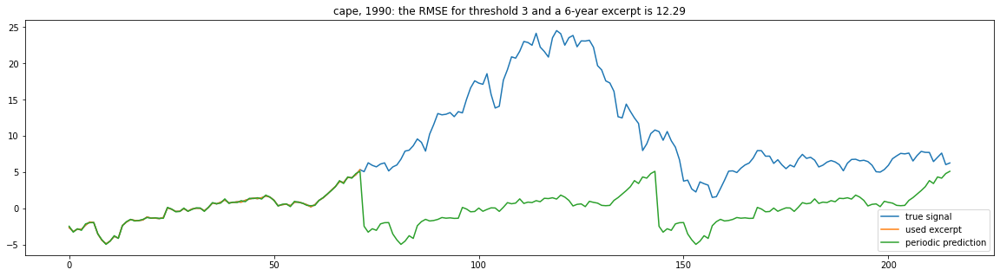

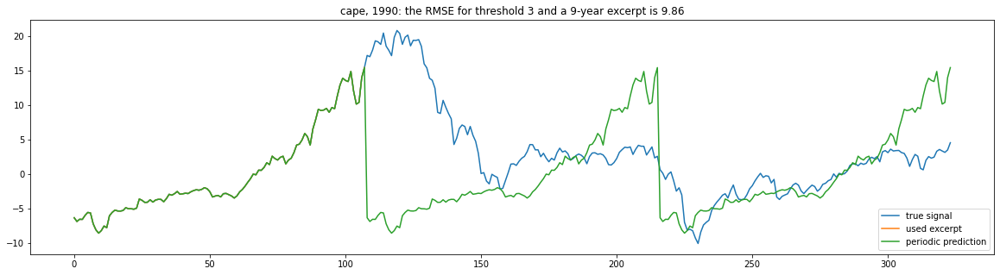

In [176]:
def kitchen_sink():
  """
  Run prediction on financial data, show plots and return markdown table.

  Hardcoded parameters:

  1. Sliding window from 1940 till 1990
  2. 3, 6 and 9 excerpt lengths for every sliding window
  3. 1,2 and 3 thresholds

  Parameters
  ----------
  None

  Output
  ------
  results_table

  Example
  -------
  >>> results = kitchen_sink()
  """

  # load data
  import numpy as np
  # from http://www.econ.yale.edu/~shiller/data/ie_data.xls
  financial = np.genfromtxt('data/financial_data.csv', delimiter=',', skip_header=2, names=True)

  date = financial['Date']
  snp_comp = financial['SP_Comp_P']
  dividend = financial['Dividend_D'] 
  earnings = financial['Earnings_E']
  cpi = financial['Consumer_Price_Index_CPI']
  # date_fraction = financial['Date_Fraction']
  long_interest_rate = financial['Long_Interest_Rate_GS10']
  real_price = financial['Real_Price']
  real_dividend = financial['Real_Dividend']
  real_earnings = financial['Real_Earnings']
  cape = financial['Cyclically_Adjusted_Price_Earnings_Ratio_PE10_or_CAPE']

  # datasets we will look at
  datadict = {
      "snp_comp" : snp_comp,
      "dividend" : dividend,
      "earnings" : earnings,
      "cpi" : cpi,
      "long_interest_rate" : long_interest_rate,
      "real_price" : real_price,
      "real_dividend" : real_dividend,
      "real_earnings" : real_earnings,
      "cape" : cape  
  }

  # our report table
  table = "";

  for key in datadict:
    sof = datadict[key]

    # sliding window
    # go from 1940 to 1990, sliding the start 10 years at a time and covering 9 years
    # in three year excerpts
    # 828 - Jan 1940 - date[828], 10 years = 120 months
    offsets = np.arange(828, 1548, 120)

    for offset in offsets:
      # reload data
      sof = datadict[key];
      sof = sof[offset:]

      # human readable date
      strdate = str(int(date[offset]));

      print("***********************")
      print("*** Start at year: " + strdate + "***")
      print("***********************")  

      # cleanse data
      sof = prep_data(sof);
      
      # copied from lab 8
      for threshold in np.arange(1, 4, 1):

          for years in np.arange(3, 12, 3): # 3, 6, and 9 year widths
              excerpt_length = years * 12
              excerpt = sof[:excerpt_length]
              avg = np.mean(excerpt)
              norm_excerpt = excerpt - avg
              harmonic_model = fft.rfft(norm_excerpt)
              predict_spectrum = np.where(np.abs(harmonic_model) < threshold, 0, harmonic_model)
              prediction = fft.irfft(predict_spectrum)
              
              test_length = 2 # expressed as number of times the excerpt length
              total_length = (test_length + 1) * excerpt_length
              true_signal = sof[:total_length] - avg
              periodic_prediction = np.tile(prediction, test_length+1)
              rmse = np.sqrt(np.mean(np.power(true_signal[excerpt_length:] - periodic_prediction[excerpt_length:], 2)))
              
              plt.figure(figsize=(20,5))
              plt.plot(true_signal, label='true signal')
              plt.plot(norm_excerpt, label='used excerpt')
              plt.plot(periodic_prediction, label='periodic prediction')
              plt_title = key + ", " + strdate;
              plt_title = plt_title + ': the RMSE for threshold {} and a {}-year excerpt is {:.2f}'.format(threshold, years, rmse);
              # plt.title('The RMSE f or threshold {} and a {}-year excerpt is {:.2f}'.format(threshold, years, rmse))
              plt.title(plt_title);
              plt.legend(loc='lower right')
              plt.show()

              # output table for our report
              table = table + key + " | " + strdate + " | "+ str(threshold) + " | " + str(years) + " | " + "{:.2f}".format(rmse) + " \n";

  # build header for markdown report table
  header = "Data | Start Year | Threshold | Excerpt length (years) | RMSE \n ";
  header += "--- | --- | --- | --- | --- \n ";
  results_table = header + table;
  return results_table;

results_table = kitchen_sink();

# Appendix - full results table

Data | Start Year | Threshold | Excerpt length (years) | RMSE 
 --- | --- | --- | --- | --- 
 snp_comp | 1940 | 1 | 3 | 5.31 
snp_comp | 1940 | 1 | 6 | 18.16 
snp_comp | 1940 | 1 | 9 | 42.09 
snp_comp | 1940 | 2 | 3 | 5.31 
snp_comp | 1940 | 2 | 6 | 18.16 
snp_comp | 1940 | 2 | 9 | 42.09 
snp_comp | 1940 | 3 | 3 | 5.30 
snp_comp | 1940 | 3 | 6 | 18.16 
snp_comp | 1940 | 3 | 9 | 42.09 
snp_comp | 1950 | 1 | 3 | 18.92 
snp_comp | 1950 | 1 | 6 | 42.35 
snp_comp | 1950 | 1 | 9 | 54.24 
snp_comp | 1950 | 2 | 3 | 18.92 
snp_comp | 1950 | 2 | 6 | 42.35 
snp_comp | 1950 | 2 | 9 | 54.24 
snp_comp | 1950 | 3 | 3 | 18.92 
snp_comp | 1950 | 3 | 6 | 42.35 
snp_comp | 1950 | 3 | 9 | 54.24 
snp_comp | 1960 | 1 | 3 | 26.18 
snp_comp | 1960 | 1 | 6 | 28.74 
snp_comp | 1960 | 1 | 9 | 56.12 
snp_comp | 1960 | 2 | 3 | 26.18 
snp_comp | 1960 | 2 | 6 | 28.74 
snp_comp | 1960 | 2 | 9 | 56.12 
snp_comp | 1960 | 3 | 3 | 26.18 
snp_comp | 1960 | 3 | 6 | 28.74 
snp_comp | 1960 | 3 | 9 | 56.12 
snp_comp | 1970 | 1 | 3 | 19.01 
snp_comp | 1970 | 1 | 6 | 83.58 
snp_comp | 1970 | 1 | 9 | 257.05 
snp_comp | 1970 | 2 | 3 | 19.01 
snp_comp | 1970 | 2 | 6 | 83.58 
snp_comp | 1970 | 2 | 9 | 257.05 
snp_comp | 1970 | 3 | 3 | 19.01 
snp_comp | 1970 | 3 | 6 | 83.58 
snp_comp | 1970 | 3 | 9 | 257.06 
snp_comp | 1980 | 1 | 3 | 107.08 
snp_comp | 1980 | 1 | 6 | 335.07 
snp_comp | 1980 | 1 | 9 | 753.27 
snp_comp | 1980 | 2 | 3 | 107.08 
snp_comp | 1980 | 2 | 6 | 335.07 
snp_comp | 1980 | 2 | 9 | 753.27 
snp_comp | 1980 | 3 | 3 | 107.08 
snp_comp | 1980 | 3 | 6 | 335.07 
snp_comp | 1980 | 3 | 9 | 753.27 
snp_comp | 1990 | 1 | 3 | 377.64 
snp_comp | 1990 | 1 | 6 | 732.61 
snp_comp | 1990 | 1 | 9 | 840.28 
snp_comp | 1990 | 2 | 3 | 377.64 
snp_comp | 1990 | 2 | 6 | 732.61 
snp_comp | 1990 | 2 | 9 | 840.28 
snp_comp | 1990 | 3 | 3 | 377.64 
snp_comp | 1990 | 3 | 6 | 732.61 
snp_comp | 1990 | 3 | 9 | 840.28 
dividend | 1940 | 1 | 3 | 0.10 
dividend | 1940 | 1 | 6 | 0.75 
dividend | 1940 | 1 | 9 | 1.21 
dividend | 1940 | 2 | 3 | 0.10 
dividend | 1940 | 2 | 6 | 0.74 
dividend | 1940 | 2 | 9 | 1.22 
dividend | 1940 | 3 | 3 | 0.10 
dividend | 1940 | 3 | 6 | 0.74 
dividend | 1940 | 3 | 9 | 1.22 
dividend | 1950 | 1 | 3 | 0.29 
dividend | 1950 | 1 | 6 | 0.82 
dividend | 1950 | 1 | 9 | 1.36 
dividend | 1950 | 2 | 3 | 0.28 
dividend | 1950 | 2 | 6 | 0.82 
dividend | 1950 | 2 | 9 | 1.37 
dividend | 1950 | 3 | 3 | 0.27 
dividend | 1950 | 3 | 6 | 0.82 
dividend | 1950 | 3 | 9 | 1.37 
dividend | 1960 | 1 | 3 | 0.72 
dividend | 1960 | 1 | 6 | 1.18 
dividend | 1960 | 1 | 9 | 3.09 
dividend | 1960 | 2 | 3 | 0.73 
dividend | 1960 | 2 | 6 | 1.18 
dividend | 1960 | 2 | 9 | 3.09 
dividend | 1960 | 3 | 3 | 0.73 
dividend | 1960 | 3 | 6 | 1.19 
dividend | 1960 | 3 | 9 | 3.09 
dividend | 1970 | 1 | 3 | 1.00 
dividend | 1970 | 1 | 6 | 3.35 
dividend | 1970 | 1 | 9 | 6.49 
dividend | 1970 | 2 | 3 | 0.99 
dividend | 1970 | 2 | 6 | 3.36 
dividend | 1970 | 2 | 9 | 6.49 
dividend | 1970 | 3 | 3 | 0.99 
dividend | 1970 | 3 | 6 | 3.36 
dividend | 1970 | 3 | 9 | 6.49 
dividend | 1980 | 1 | 3 | 1.74 
dividend | 1980 | 1 | 6 | 5.23 
dividend | 1980 | 1 | 9 | 8.34 
dividend | 1980 | 2 | 3 | 1.75 
dividend | 1980 | 2 | 6 | 5.23 
dividend | 1980 | 2 | 9 | 8.34 
dividend | 1980 | 3 | 3 | 1.75 
dividend | 1980 | 3 | 6 | 5.23 
dividend | 1980 | 3 | 9 | 8.34 
dividend | 1990 | 1 | 3 | 2.32 
dividend | 1990 | 1 | 6 | 6.44 
dividend | 1990 | 1 | 9 | 14.43 
dividend | 1990 | 2 | 3 | 2.32 
dividend | 1990 | 2 | 6 | 6.44 
dividend | 1990 | 2 | 9 | 14.43 
dividend | 1990 | 3 | 3 | 2.33 
dividend | 1990 | 3 | 6 | 6.45 
dividend | 1990 | 3 | 9 | 14.44 
earnings | 1940 | 1 | 3 | 0.42 
earnings | 1940 | 1 | 6 | 1.64 
earnings | 1940 | 1 | 9 | 2.30 
earnings | 1940 | 2 | 3 | 0.41 
earnings | 1940 | 2 | 6 | 1.65 
earnings | 1940 | 2 | 9 | 2.30 
earnings | 1940 | 3 | 3 | 0.41 
earnings | 1940 | 3 | 6 | 1.63 
earnings | 1940 | 3 | 9 | 2.30 
earnings | 1950 | 1 | 3 | 0.70 
earnings | 1950 | 1 | 6 | 1.52 
earnings | 1950 | 1 | 9 | 3.07 
earnings | 1950 | 2 | 3 | 0.70 
earnings | 1950 | 2 | 6 | 1.52 
earnings | 1950 | 2 | 9 | 3.07 
earnings | 1950 | 3 | 3 | 0.70 
earnings | 1950 | 3 | 6 | 1.52 
earnings | 1950 | 3 | 9 | 3.07 
earnings | 1960 | 1 | 3 | 1.73 
earnings | 1960 | 1 | 6 | 3.49 
earnings | 1960 | 1 | 9 | 7.42 
earnings | 1960 | 2 | 3 | 1.74 
earnings | 1960 | 2 | 6 | 3.49 
earnings | 1960 | 2 | 9 | 7.42 
earnings | 1960 | 3 | 3 | 1.74 
earnings | 1960 | 3 | 6 | 3.49 
earnings | 1960 | 3 | 9 | 7.42 
earnings | 1970 | 1 | 3 | 3.85 
earnings | 1970 | 1 | 6 | 7.02 
earnings | 1970 | 1 | 9 | 13.06 
earnings | 1970 | 2 | 3 | 3.86 
earnings | 1970 | 2 | 6 | 7.02 
earnings | 1970 | 2 | 9 | 13.06 
earnings | 1970 | 3 | 3 | 3.86 
earnings | 1970 | 3 | 6 | 7.03 
earnings | 1970 | 3 | 9 | 13.06 
earnings | 1980 | 1 | 3 | 3.36 
earnings | 1980 | 1 | 6 | 12.38 
earnings | 1980 | 1 | 9 | 26.22 
earnings | 1980 | 2 | 3 | 3.33 
earnings | 1980 | 2 | 6 | 12.38 
earnings | 1980 | 2 | 9 | 26.22 
earnings | 1980 | 3 | 3 | 3.32 
earnings | 1980 | 3 | 6 | 12.37 
earnings | 1980 | 3 | 9 | 26.22 
earnings | 1990 | 1 | 3 | 15.55 
earnings | 1990 | 1 | 6 | 29.96 
earnings | 1990 | 1 | 9 | 41.61 
earnings | 1990 | 2 | 3 | 15.55 
earnings | 1990 | 2 | 6 | 29.96 
earnings | 1990 | 2 | 9 | 41.61 
earnings | 1990 | 3 | 3 | 15.53 
earnings | 1990 | 3 | 6 | 29.96 
earnings | 1990 | 3 | 9 | 41.61 
cpi | 1940 | 1 | 3 | 5.34 
cpi | 1940 | 1 | 6 | 9.10 
cpi | 1940 | 1 | 9 | 10.51 
cpi | 1940 | 2 | 3 | 5.35 
cpi | 1940 | 2 | 6 | 9.10 
cpi | 1940 | 2 | 9 | 10.51 
cpi | 1940 | 3 | 3 | 5.35 
cpi | 1940 | 3 | 6 | 9.10 
cpi | 1940 | 3 | 9 | 10.51 
cpi | 1950 | 1 | 3 | 2.16 
cpi | 1950 | 1 | 6 | 4.28 
cpi | 1950 | 1 | 9 | 13.33 
cpi | 1950 | 2 | 3 | 2.16 
cpi | 1950 | 2 | 6 | 4.29 
cpi | 1950 | 2 | 9 | 13.33 
cpi | 1950 | 3 | 3 | 2.16 
cpi | 1950 | 3 | 6 | 4.29 
cpi | 1950 | 3 | 9 | 13.34 
cpi | 1960 | 1 | 3 | 2.75 
cpi | 1960 | 1 | 6 | 15.82 
cpi | 1960 | 1 | 9 | 45.43 
cpi | 1960 | 2 | 3 | 2.75 
cpi | 1960 | 2 | 6 | 15.83 
cpi | 1960 | 2 | 9 | 45.43 
cpi | 1960 | 3 | 3 | 2.76 
cpi | 1960 | 3 | 6 | 15.84 
cpi | 1960 | 3 | 9 | 45.43 
cpi | 1970 | 1 | 3 | 16.01 
cpi | 1970 | 1 | 6 | 46.93 
cpi | 1970 | 1 | 9 | 71.35 
cpi | 1970 | 2 | 3 | 16.01 
cpi | 1970 | 2 | 6 | 46.93 
cpi | 1970 | 2 | 9 | 71.35 
cpi | 1970 | 3 | 3 | 16.02 
cpi | 1970 | 3 | 6 | 46.93 
cpi | 1970 | 3 | 9 | 71.35 
cpi | 1980 | 1 | 3 | 19.68 
cpi | 1980 | 1 | 6 | 41.99 
cpi | 1980 | 1 | 9 | 62.71 
cpi | 1980 | 2 | 3 | 19.68 
cpi | 1980 | 2 | 6 | 41.99 
cpi | 1980 | 2 | 9 | 62.71 
cpi | 1980 | 3 | 3 | 19.68 
cpi | 1980 | 3 | 6 | 41.99 
cpi | 1980 | 3 | 9 | 62.71 
cpi | 1990 | 1 | 3 | 19.48 
cpi | 1990 | 1 | 6 | 39.78 
cpi | 1990 | 1 | 9 | 62.39 
cpi | 1990 | 2 | 3 | 19.48 
cpi | 1990 | 2 | 6 | 39.78 
cpi | 1990 | 2 | 9 | 62.39 
cpi | 1990 | 3 | 3 | 19.48 
cpi | 1990 | 3 | 6 | 39.78 
cpi | 1990 | 3 | 9 | 62.39 
long_interest_rate | 1940 | 1 | 3 | 0.23 
long_interest_rate | 1940 | 1 | 6 | 0.56 
long_interest_rate | 1940 | 1 | 9 | 1.37 
long_interest_rate | 1940 | 2 | 3 | 0.23 
long_interest_rate | 1940 | 2 | 6 | 0.56 
long_interest_rate | 1940 | 2 | 9 | 1.37 
long_interest_rate | 1940 | 3 | 3 | 0.23 
long_interest_rate | 1940 | 3 | 6 | 0.57 
long_interest_rate | 1940 | 3 | 9 | 1.37 
long_interest_rate | 1950 | 1 | 3 | 0.64 
long_interest_rate | 1950 | 1 | 6 | 1.55 
long_interest_rate | 1950 | 1 | 9 | 3.04 
long_interest_rate | 1950 | 2 | 3 | 0.64 
long_interest_rate | 1950 | 2 | 6 | 1.55 
long_interest_rate | 1950 | 2 | 9 | 3.04 
long_interest_rate | 1950 | 3 | 3 | 0.63 
long_interest_rate | 1950 | 3 | 6 | 1.55 
long_interest_rate | 1950 | 3 | 9 | 3.04 
long_interest_rate | 1960 | 1 | 3 | 0.97 
long_interest_rate | 1960 | 1 | 6 | 2.75 
long_interest_rate | 1960 | 1 | 9 | 5.24 
long_interest_rate | 1960 | 2 | 3 | 0.95 
long_interest_rate | 1960 | 2 | 6 | 2.75 
long_interest_rate | 1960 | 2 | 9 | 5.23 
long_interest_rate | 1960 | 3 | 3 | 0.94 
long_interest_rate | 1960 | 3 | 6 | 2.74 
long_interest_rate | 1960 | 3 | 9 | 5.23 
long_interest_rate | 1970 | 1 | 3 | 1.44 
long_interest_rate | 1970 | 1 | 6 | 3.87 
long_interest_rate | 1970 | 1 | 9 | 3.38 
long_interest_rate | 1970 | 2 | 3 | 1.43 
long_interest_rate | 1970 | 2 | 6 | 3.87 
long_interest_rate | 1970 | 2 | 9 | 3.38 
long_interest_rate | 1970 | 3 | 3 | 1.41 
long_interest_rate | 1970 | 3 | 6 | 3.87 
long_interest_rate | 1970 | 3 | 9 | 3.38 
long_interest_rate | 1980 | 1 | 3 | 3.59 
long_interest_rate | 1980 | 1 | 6 | 5.01 
long_interest_rate | 1980 | 1 | 9 | 5.29 
long_interest_rate | 1980 | 2 | 3 | 3.59 
long_interest_rate | 1980 | 2 | 6 | 5.01 
long_interest_rate | 1980 | 2 | 9 | 5.29 
long_interest_rate | 1980 | 3 | 3 | 3.59 
long_interest_rate | 1980 | 3 | 6 | 5.00 
long_interest_rate | 1980 | 3 | 9 | 5.29 
long_interest_rate | 1990 | 1 | 3 | 1.79 
long_interest_rate | 1990 | 1 | 6 | 2.36 
long_interest_rate | 1990 | 1 | 9 | 3.37 
long_interest_rate | 1990 | 2 | 3 | 1.79 
long_interest_rate | 1990 | 2 | 6 | 2.36 
long_interest_rate | 1990 | 2 | 9 | 3.36 
long_interest_rate | 1990 | 3 | 3 | 1.79 
long_interest_rate | 1990 | 3 | 6 | 2.35 
long_interest_rate | 1990 | 3 | 9 | 3.36 
real_price | 1940 | 1 | 3 | 40.59 
real_price | 1940 | 1 | 6 | 116.60 
real_price | 1940 | 1 | 9 | 284.01 
real_price | 1940 | 2 | 3 | 40.59 
real_price | 1940 | 2 | 6 | 116.60 
real_price | 1940 | 2 | 9 | 284.01 
real_price | 1940 | 3 | 3 | 40.59 
real_price | 1940 | 3 | 6 | 116.60 
real_price | 1940 | 3 | 9 | 284.01 
real_price | 1950 | 1 | 3 | 151.93 
real_price | 1950 | 1 | 6 | 297.99 
real_price | 1950 | 1 | 9 | 293.14 
real_price | 1950 | 2 | 3 | 151.93 
real_price | 1950 | 2 | 6 | 297.99 
real_price | 1950 | 2 | 9 | 293.14 
real_price | 1950 | 3 | 3 | 151.93 
real_price | 1950 | 3 | 6 | 297.99 
real_price | 1950 | 3 | 9 | 293.14 
real_price | 1960 | 1 | 3 | 154.80 
real_price | 1960 | 1 | 6 | 164.63 
real_price | 1960 | 1 | 9 | 213.78 
real_price | 1960 | 2 | 3 | 154.80 
real_price | 1960 | 2 | 6 | 164.63 
real_price | 1960 | 2 | 9 | 213.78 
real_price | 1960 | 3 | 3 | 154.80 
real_price | 1960 | 3 | 6 | 164.63 
real_price | 1960 | 3 | 9 | 213.78 
real_price | 1970 | 1 | 3 | 194.05 
real_price | 1970 | 1 | 6 | 195.30 
real_price | 1970 | 1 | 9 | 278.63 
real_price | 1970 | 2 | 3 | 194.05 
real_price | 1970 | 2 | 6 | 195.30 
real_price | 1970 | 2 | 9 | 278.63 
real_price | 1970 | 3 | 3 | 194.05 
real_price | 1970 | 3 | 6 | 195.30 
real_price | 1970 | 3 | 9 | 278.63 
real_price | 1980 | 1 | 3 | 175.65 
real_price | 1980 | 1 | 6 | 440.44 
real_price | 1980 | 1 | 9 | 897.38 
real_price | 1980 | 2 | 3 | 175.65 
real_price | 1980 | 2 | 6 | 440.44 
real_price | 1980 | 2 | 9 | 897.38 
real_price | 1980 | 3 | 3 | 175.65 
real_price | 1980 | 3 | 6 | 440.44 
real_price | 1980 | 3 | 9 | 897.38 
real_price | 1990 | 1 | 3 | 492.82 
real_price | 1990 | 1 | 6 | 835.04 
real_price | 1990 | 1 | 9 | 747.78 
real_price | 1990 | 2 | 3 | 492.82 
real_price | 1990 | 2 | 6 | 835.04 
real_price | 1990 | 2 | 9 | 747.78 
real_price | 1990 | 3 | 3 | 492.82 
real_price | 1990 | 3 | 6 | 835.04 
real_price | 1990 | 3 | 9 | 747.78 
real_dividend | 1940 | 1 | 3 | 2.46 
real_dividend | 1940 | 1 | 6 | 4.22 
real_dividend | 1940 | 1 | 9 | 6.92 
real_dividend | 1940 | 2 | 3 | 2.45 
real_dividend | 1940 | 2 | 6 | 4.21 
real_dividend | 1940 | 2 | 9 | 6.92 
real_dividend | 1940 | 3 | 3 | 2.44 
real_dividend | 1940 | 3 | 6 | 4.21 
real_dividend | 1940 | 3 | 9 | 6.91 
real_dividend | 1950 | 1 | 3 | 1.71 
real_dividend | 1950 | 1 | 6 | 4.50 
real_dividend | 1950 | 1 | 9 | 4.64 
real_dividend | 1950 | 2 | 3 | 1.71 
real_dividend | 1950 | 2 | 6 | 4.50 
real_dividend | 1950 | 2 | 9 | 4.64 
real_dividend | 1950 | 3 | 3 | 1.71 
real_dividend | 1950 | 3 | 6 | 4.51 
real_dividend | 1950 | 3 | 9 | 4.64 
real_dividend | 1960 | 1 | 3 | 4.00 
real_dividend | 1960 | 1 | 6 | 3.04 
real_dividend | 1960 | 1 | 9 | 3.08 
real_dividend | 1960 | 2 | 3 | 4.01 
real_dividend | 1960 | 2 | 6 | 3.04 
real_dividend | 1960 | 2 | 9 | 3.08 
real_dividend | 1960 | 3 | 3 | 4.01 
real_dividend | 1960 | 3 | 6 | 3.03 
real_dividend | 1960 | 3 | 9 | 3.08 
real_dividend | 1970 | 1 | 3 | 1.95 
real_dividend | 1970 | 1 | 6 | 1.57 
real_dividend | 1970 | 1 | 9 | 2.70 
real_dividend | 1970 | 2 | 3 | 1.94 
real_dividend | 1970 | 2 | 6 | 1.57 
real_dividend | 1970 | 2 | 9 | 2.69 
real_dividend | 1970 | 3 | 3 | 1.93 
real_dividend | 1970 | 3 | 6 | 1.55 
real_dividend | 1970 | 3 | 9 | 2.69 
real_dividend | 1980 | 1 | 3 | 0.98 
real_dividend | 1980 | 1 | 6 | 3.83 
real_dividend | 1980 | 1 | 9 | 5.30 
real_dividend | 1980 | 2 | 3 | 0.97 
real_dividend | 1980 | 2 | 6 | 3.83 
real_dividend | 1980 | 2 | 9 | 5.31 
real_dividend | 1980 | 3 | 3 | 0.96 
real_dividend | 1980 | 3 | 6 | 3.83 
real_dividend | 1980 | 3 | 9 | 5.31 
real_dividend | 1990 | 1 | 3 | 1.21 
real_dividend | 1990 | 1 | 6 | 4.07 
real_dividend | 1990 | 1 | 9 | 9.66 
real_dividend | 1990 | 2 | 3 | 1.21 
real_dividend | 1990 | 2 | 6 | 4.08 
real_dividend | 1990 | 2 | 9 | 9.67 
real_dividend | 1990 | 3 | 3 | 1.21 
real_dividend | 1990 | 3 | 6 | 4.08 
real_dividend | 1990 | 3 | 9 | 9.67 
real_earnings | 1940 | 1 | 3 | 4.59 
real_earnings | 1940 | 1 | 6 | 10.94 
real_earnings | 1940 | 1 | 9 | 13.97 
real_earnings | 1940 | 2 | 3 | 4.58 
real_earnings | 1940 | 2 | 6 | 10.94 
real_earnings | 1940 | 2 | 9 | 13.97 
real_earnings | 1940 | 3 | 3 | 4.57 
real_earnings | 1940 | 3 | 6 | 10.93 
real_earnings | 1940 | 3 | 9 | 13.97 
real_earnings | 1950 | 1 | 3 | 5.14 
real_earnings | 1950 | 1 | 6 | 8.83 
real_earnings | 1950 | 1 | 9 | 9.67 
real_earnings | 1950 | 2 | 3 | 5.13 
real_earnings | 1950 | 2 | 6 | 8.83 
real_earnings | 1950 | 2 | 9 | 9.67 
real_earnings | 1950 | 3 | 3 | 5.13 
real_earnings | 1950 | 3 | 6 | 8.83 
real_earnings | 1950 | 3 | 9 | 9.67 
real_earnings | 1960 | 1 | 3 | 10.64 
real_earnings | 1960 | 1 | 6 | 9.99 
real_earnings | 1960 | 1 | 9 | 9.20 
real_earnings | 1960 | 2 | 3 | 10.64 
real_earnings | 1960 | 2 | 6 | 9.99 
real_earnings | 1960 | 2 | 9 | 9.20 
real_earnings | 1960 | 3 | 3 | 10.64 
real_earnings | 1960 | 3 | 6 | 9.99 
real_earnings | 1960 | 3 | 9 | 9.20 
real_earnings | 1970 | 1 | 3 | 7.67 
real_earnings | 1970 | 1 | 6 | 5.93 
real_earnings | 1970 | 1 | 9 | 9.60 
real_earnings | 1970 | 2 | 3 | 7.66 
real_earnings | 1970 | 2 | 6 | 5.93 
real_earnings | 1970 | 2 | 9 | 9.60 
real_earnings | 1970 | 3 | 3 | 7.66 
real_earnings | 1970 | 3 | 6 | 5.93 
real_earnings | 1970 | 3 | 9 | 9.60 
real_earnings | 1980 | 1 | 3 | 8.76 
real_earnings | 1980 | 1 | 6 | 14.00 
real_earnings | 1980 | 1 | 9 | 23.57 
real_earnings | 1980 | 2 | 3 | 8.76 
real_earnings | 1980 | 2 | 6 | 14.00 
real_earnings | 1980 | 2 | 9 | 23.57 
real_earnings | 1980 | 3 | 3 | 8.76 
real_earnings | 1980 | 3 | 6 | 14.00 
real_earnings | 1980 | 3 | 9 | 23.58 
real_earnings | 1990 | 1 | 3 | 20.22 
real_earnings | 1990 | 1 | 6 | 31.20 
real_earnings | 1990 | 1 | 9 | 34.10 
real_earnings | 1990 | 2 | 3 | 20.22 
real_earnings | 1990 | 2 | 6 | 31.20 
real_earnings | 1990 | 2 | 9 | 34.10 
real_earnings | 1990 | 3 | 3 | 20.22 
real_earnings | 1990 | 3 | 6 | 31.20 
real_earnings | 1990 | 3 | 9 | 34.10 
cape | 1940 | 1 | 3 | 2.69 
cape | 1940 | 1 | 6 | 3.45 
cape | 1940 | 1 | 9 | 6.61 
cape | 1940 | 2 | 3 | 2.69 
cape | 1940 | 2 | 6 | 3.44 
cape | 1940 | 2 | 9 | 6.61 
cape | 1940 | 3 | 3 | 2.68 
cape | 1940 | 3 | 6 | 3.44 
cape | 1940 | 3 | 9 | 6.61 
cape | 1950 | 1 | 3 | 4.21 
cape | 1950 | 1 | 6 | 6.98 
cape | 1950 | 1 | 9 | 6.19 
cape | 1950 | 2 | 3 | 4.21 
cape | 1950 | 2 | 6 | 6.98 
cape | 1950 | 2 | 9 | 6.19 
cape | 1950 | 3 | 3 | 4.21 
cape | 1950 | 3 | 6 | 6.98 
cape | 1950 | 3 | 9 | 6.19 
cape | 1960 | 1 | 3 | 3.37 
cape | 1960 | 1 | 6 | 7.13 
cape | 1960 | 1 | 9 | 9.98 
cape | 1960 | 2 | 3 | 3.37 
cape | 1960 | 2 | 6 | 7.12 
cape | 1960 | 2 | 9 | 9.98 
cape | 1960 | 3 | 3 | 3.37 
cape | 1960 | 3 | 6 | 7.12 
cape | 1960 | 3 | 9 | 9.98 
cape | 1970 | 1 | 3 | 6.12 
cape | 1970 | 1 | 6 | 6.19 
cape | 1970 | 1 | 9 | 7.65 
cape | 1970 | 2 | 3 | 6.12 
cape | 1970 | 2 | 6 | 6.19 
cape | 1970 | 2 | 9 | 7.65 
cape | 1970 | 3 | 3 | 6.11 
cape | 1970 | 3 | 6 | 6.19 
cape | 1970 | 3 | 9 | 7.65 
cape | 1980 | 1 | 3 | 4.92 
cape | 1980 | 1 | 6 | 11.49 
cape | 1980 | 1 | 9 | 17.44 
cape | 1980 | 2 | 3 | 4.91 
cape | 1980 | 2 | 6 | 11.49 
cape | 1980 | 2 | 9 | 17.44 
cape | 1980 | 3 | 3 | 4.91 
cape | 1980 | 3 | 6 | 11.50 
cape | 1980 | 3 | 9 | 17.44 
cape | 1990 | 1 | 3 | 9.79 
cape | 1990 | 1 | 6 | 12.29 
cape | 1990 | 1 | 9 | 9.86 
cape | 1990 | 2 | 3 | 9.80 
cape | 1990 | 2 | 6 | 12.29 
cape | 1990 | 2 | 9 | 9.86 
cape | 1990 | 3 | 3 | 9.81 
cape | 1990 | 3 | 6 | 12.29 
cape | 1990 | 3 | 9 | 9.86 
